In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days

%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("~/Desktop/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

31


In [518]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_R.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: Richards')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("covid%s%s%d_Q.txt"%(cases,Cntr,int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logisticQ')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("S.Korea scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("S.Korea scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_QR.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [40]:
dfp = pd.read_csv("~/Desktop/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [41]:
sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

445250514

In [42]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("~/Desktop/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [43]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,North America,NaN,1515.0,148.0,16562.0,NaN,1120629,64412.0,176247.0,NaN,NaN
1,733553,Europe,Europe,NaN,116.0,12.0,24627.0,NaN,1322822,126434.0,462835.0,NaN,NaN
2,230933,Asia,Asia,NaN,358.0,17.0,5832.0,NaN,495132,17927.0,246272.0,NaN,NaN
3,93708,South America,South America,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
4,1274,Australia/Oceania,Oceania,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN


In [44]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
222,93708,South America,Total:,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
223,1274,Australia/Oceania,Total:,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN
224,22400,Africa,Total:,NaN,121.0,1.0,120.0,NaN,35799,1528.0,11871.0,NaN,NaN
225,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
226,467363,Europe,European Union,227.029496,116.0,12.0,19976.0,19478.362691,989757,101085.0,421059.0,8672751.0,2222.921634


In [45]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,North America,NaN,1515.0,148.0,16562.0,NaN,1120629,64412.0,176247.0,NaN,NaN
1,733553,Europe,Europe,NaN,116.0,12.0,24627.0,NaN,1322822,126434.0,462835.0,NaN,NaN
2,230933,Asia,Asia,NaN,358.0,17.0,5832.0,NaN,495132,17927.0,246272.0,NaN,NaN
3,93708,South America,South America,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
4,1274,Australia/Oceania,Oceania,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN


In [46]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
87,764,Europe,Lithuania,16.0,0.0,0.0,17.0,41072.0,1344,44.0,536.0,111809.0,494.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


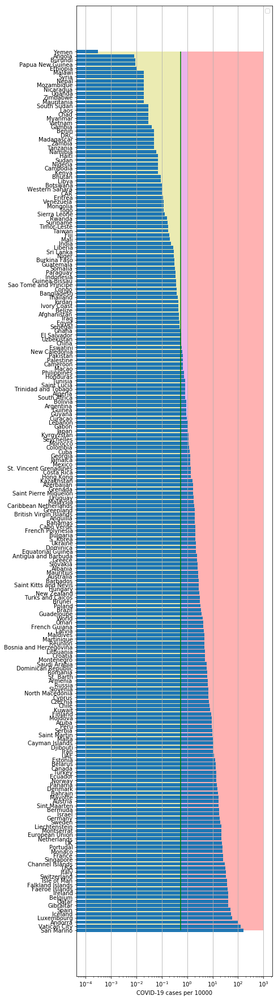

In [47]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


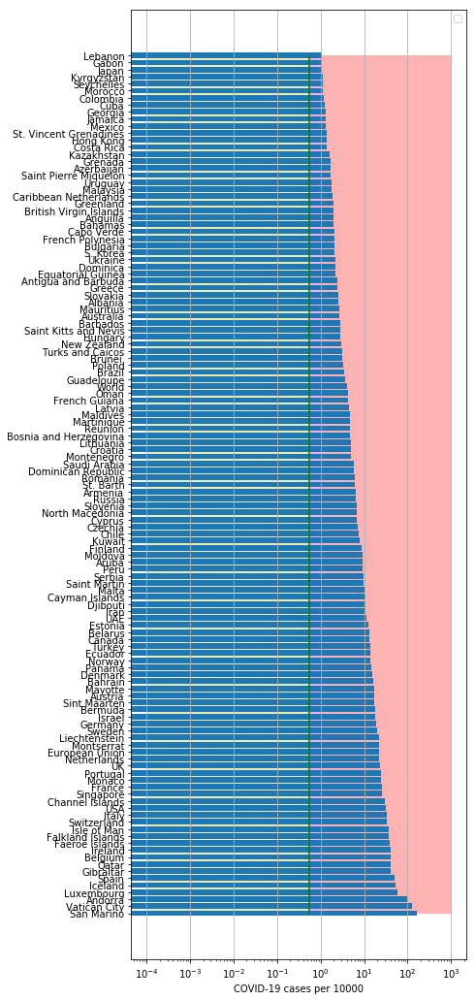

In [48]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="coronage1.png")

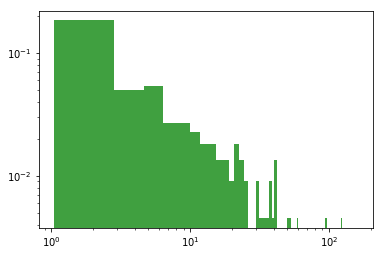

In [49]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [50]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
59 2020-04-24  219764  104885  23120.0
60 2020-04-25  223759  105149  23487.0
61 2020-04-26  226629   85712  23867.0
62 2020-04-27  229422   85069  24198.0
63 2020-04-28  232128   84403  23822.0
GB
          date   cases  active    death
58 2020-04-24  143464  123614  19506.0
59 2020-04-25  148377  127714  20319.0
60 2020-04-26  152840  131764  20732.0
61 2020-04-27  157149  135713  21092.0
62 2020-04-28  161145  139123  21678.0
IT
          date   cases  active    death
61 2020-04-24  192994  106527  25969.0
62 2020-04-25  195351  105847  26384.0
63 2020-04-26  197675  106103  26644.0
64 2020-04-27  199414  105813  26977.0
65 2020-04-28  201505  105205  27359.0
LT
          date  cases  active  death     tests
46 2020-04-24   1426     925   41.0   98948.0
47 2020-04-25   1438     930   41.2  104488.0
48 2020-04-26   1449     934   41.3  106775.0
49 2020-04-27   1454     931   41.4  111806.0
50 2020-04-28   1344     764   44.0       NaN
Ukr
  

IE
          date  cases  active  death
46 2020-04-24   8211  6520.0  689.0
47 2020-04-25   8607  6845.0  720.0
48 2020-04-26   8882  7032.0  743.0
49 2020-04-27   9096  7180.0  765.0
50 2020-04-28   9511  7484.0  773.0
MX
          date  cases  active   death
47 2020-04-24  12872  4502.0  1221.0
48 2020-04-25  13842  5388.0  1305.0
49 2020-04-26  14677  4972.0  1351.0
50 2020-04-27  15529  5009.0  1434.0
51 2020-04-28  16752  3760.0  1569.0
PM
          date  cases  active  death
45 2020-04-24   5338  4865.0  154.0
46 2020-04-25   5538  5041.0  159.0
47 2020-04-26   5779  5245.0  165.0
48 2020-04-27   6021  5399.0  167.0
49 2020-04-28   6200  5540.0  176.0
PU
          date  cases   active  death
48 2020-04-24  21648  13518.0  634.0
49 2020-04-25  25331  16834.0  700.0
50 2020-04-26  27517  18701.0  728.0
51 2020-04-27  28699  19492.0  782.0
52 2020-04-28  31190  21157.0  854.0
SB
          date  cases  active  death
45 2020-04-24   7483  6245.0  144.0
46 2020-04-25   7779  6476.0  15

In [51]:
#dfVU = pd.read_csv("~/Documents/coronaVU2.csv",",")
#dfVU['date'] = pd.to_datetime(dfVU['date'])
#print("VU\n",dfVU.tail())

In [52]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.8293543855040685
intercept: -3.3253181458568246
slope: [0.1455784]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


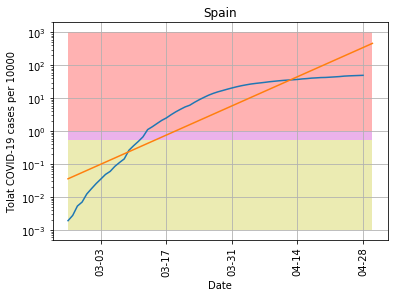

In [53]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-04-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("coronaSP.png")
plt.show()

In [54]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.9261955548293712
intercept: -4.807047686687571
slope: [0.15368526]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


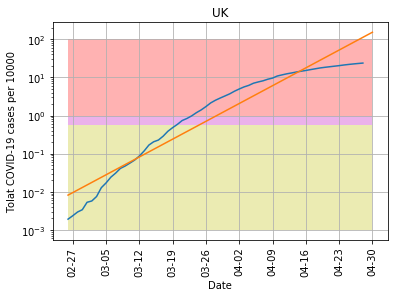

In [55]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-04-30', "coronaGB.png", model1, 'UK',100)

In [56]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9954067827902351
intercept: 1.9637785629511226
slope: [-0.05286258]


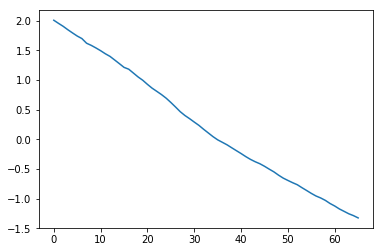

In [57]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


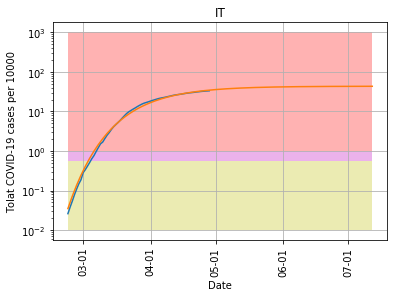

In [58]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("coronaIT.png")
plt.show()

In [59]:
cs=y_pred11[-1]/10000.*populationIT

In [60]:
cs

261634.7896731034

In [61]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT,populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7701594420714584
intercept: -3.0324032480456506
slope: [0.12142195]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


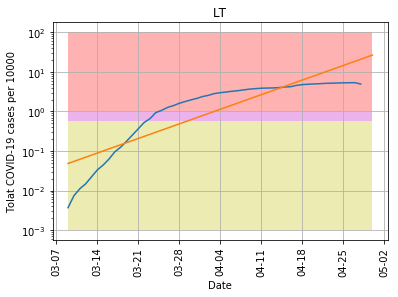

In [62]:
ss1t = plotpred(dfLT,populationLT,'2020-03-09', '2020-04-30', "coronaLT.png", model1, 'LT',100)

In [63]:
#ss1t

In [64]:
36*0.9665024109925366

34.79408679573132

In [65]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9954067827902351
intercept: -6.649308499810807
slope: [0.17748036]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


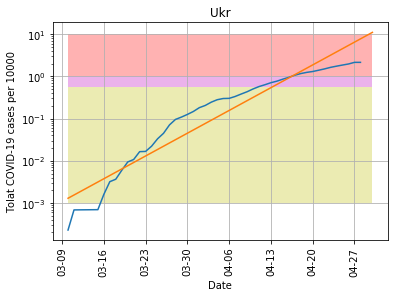

In [66]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-04-30', "coronaUkr.png", model11, 'Ukr',10)

In [67]:
#dfT = pd.read_csv("~/Desktop/coronaTests.csv",",")

In [68]:
#dfT.head()

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


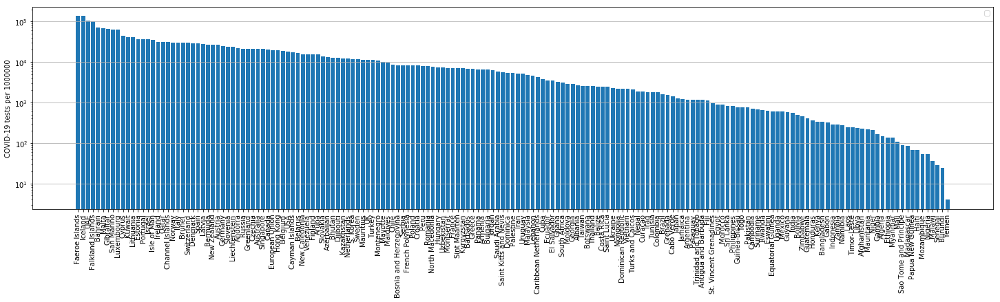

In [69]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("coronaTests.png")
plt.show()

In [70]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9954067827902351
intercept: -4.452778350153521
slope: [0.16604223]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


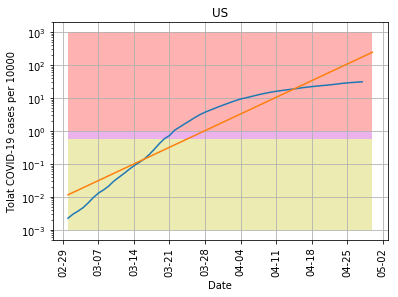

In [71]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-04-30', "coronaUS.png", model11, 'US',1000)

In [72]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
226  European Union  0.102131


(0, 0.15)

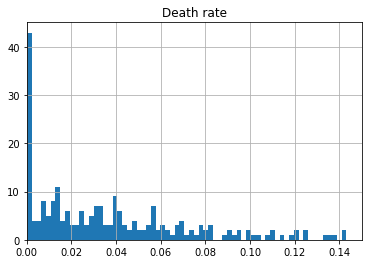

In [73]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh.hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

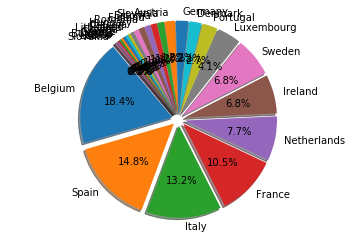

In [74]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [75]:
dfTTh.head()

,Country,Deathsper1Mpop
18,Belgium,633.0
8,Spain,510.0
9,Italy,453.0
10,France,362.0
19,Netherlands,266.0


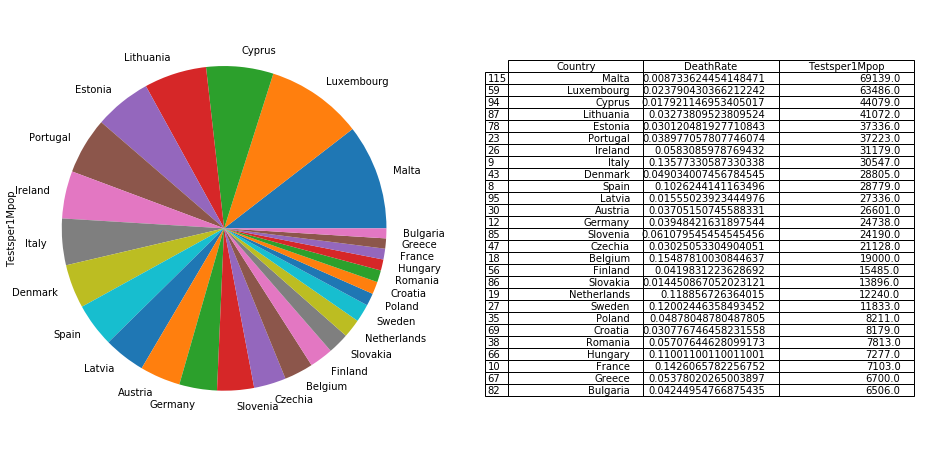

In [76]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate2.png")
plt.show()

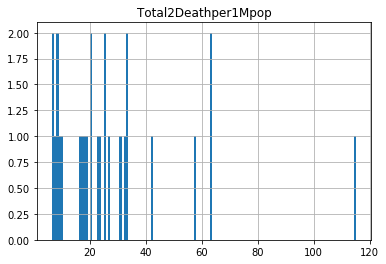

In [77]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [78]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,4965.0,510.0
9,Italy,3333.0,453.0
10,France,2542.0,362.0
12,Germany,1909.0,75.0
18,Belgium,4084.0,633.0


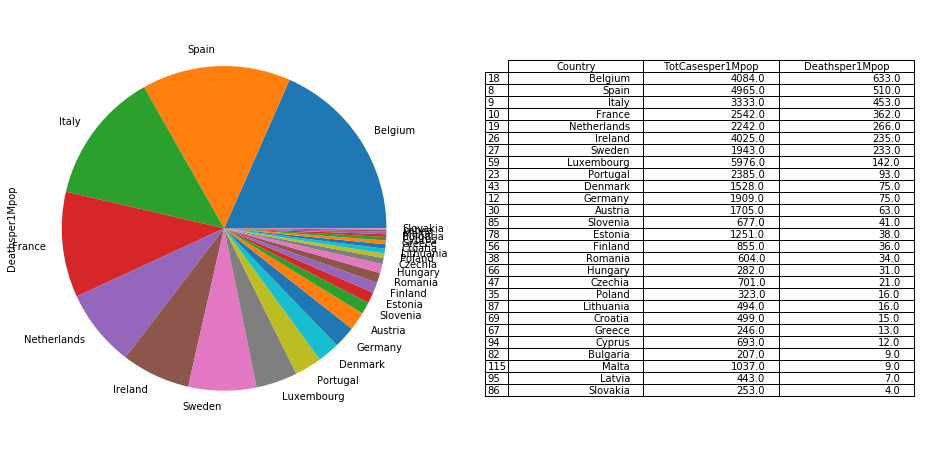

In [79]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate1.png")
plt.show()

In [80]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,North America,0.0,1515.0,148.0,16562.0,0.0,1120629,64412.0,176247.0,0.0,0.0
1,733553,Europe,Europe,0.0,116.0,12.0,24627.0,0.0,1322822,126434.0,462835.0,0.0,0.0
2,230933,Asia,Asia,0.0,358.0,17.0,5832.0,0.0,495132,17927.0,246272.0,0.0,0.0
3,93708,South America,South America,0.0,389.0,22.0,9775.0,0.0,155592,7590.0,54294.0,0.0,0.0
4,1274,Australia/Oceania,Oceania,0.0,2.0,0.0,45.0,0.0,8314,107.0,6933.0,0.0,0.0


In [81]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.172522
9,Italy,0.109111
10,France,0.357877
12,Germany,0.077169
18,Belgium,0.214947


In [82]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [83]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
      France             0.357877
     Belgium             0.214947
 Netherlands             0.183170
       Spain             0.172522
      Sweden             0.164202
     Ireland             0.129093
       Italy             0.109111
  Luxembourg             0.094131
     Romania             0.077307
     Germany             0.077169
     Austria             0.064095
    Portugal             0.064073
     Croatia             0.061010
     Finland             0.055215
     Denmark             0.053046
      Poland             0.039337
     Hungary             0.038752
      Greece             0.036716
     Estonia             0.033507
     Czechia             0.033179
    Bulgaria             0.031817
    Slovenia             0.027987
    Slovakia             0.018207
      Latvia             0.016206
      Cyprus             0.015722
       Malta             0.014999
   Lithuania             0.012028


In [84]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
37,Qatar,0.000839,30755.000000
31,Singapore,0.000936,20815.000000
90,Djibouti,0.001866,12724.000000
65,Bahrain,0.002846,71525.000000
128,Equatorial Guinea,0.003175,609.000000
92,Hong Kong,0.003854,19426.000000
70,Uzbekistan,0.004092,7247.000000
68,Oman,0.004693,0.000000
75,Iceland,0.005571,135906.000000
88,Guinea,0.005645,0.000000


In [85]:
#dfTst = pd.read_csv("~/Desktop/tests.csv",",")

In [86]:
#y = dfT['tests']
#x = np.array(range(dfTst['tests'].size)).reshape((-1, 1))
#model = LinearRegression().fit(x, y)
#r_sq = model.score(x, y)
#print('coefficient of determination:', r_sq)
#print('intercept:', model.intercept_)
#print('slope:', model.coef_)

In [87]:
#f = lambda t:128.01 + np.exp(0.36*(t + 2) - 5.21) - 38.95*t - 88.08

In [88]:
#f(54)

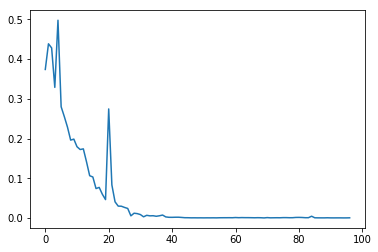

In [89]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [90]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log
  """Entry point for launching an IPython kernel.


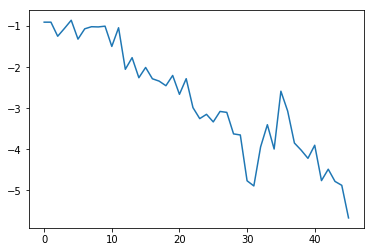

In [91]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))

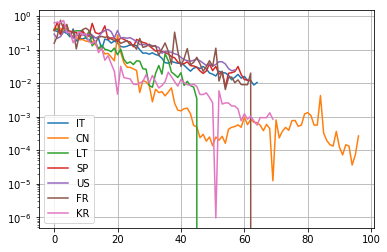

In [92]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

58 58
coefficient of determination: 0.9536797183729077
intercept: -7.1313995158019665
slope: [-0.2090198]


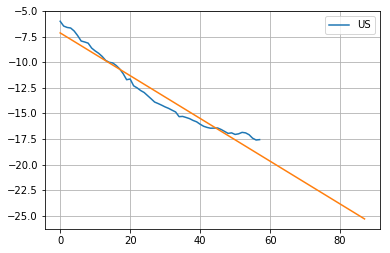

In [93]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("logdiffUS.png")
plt.show()

65 65
coefficient of determination: 0.931200901346858
intercept: -8.59132285850422
slope: [-0.14702581]


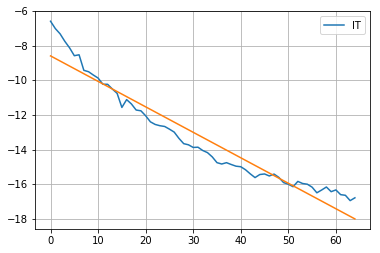

In [94]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [95]:
#model11.coef_

In [96]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

47 47
coefficient of determination: 0.9807375129122632
intercept: -14.29928303189488
slope: [-0.10154199]


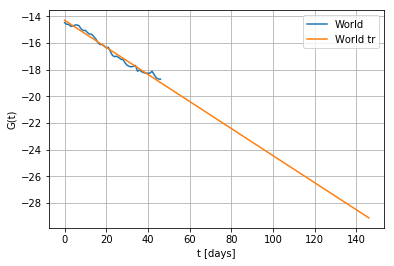

In [97]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("logdifflogcoronaW.png")

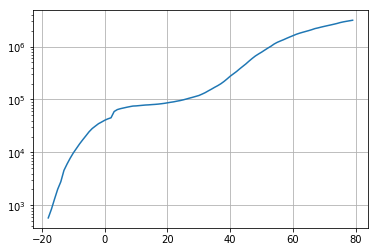

In [98]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [99]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 4.57720277e+06  2.68655948e+00 -1.32845187e+01  1.94210212e-02]


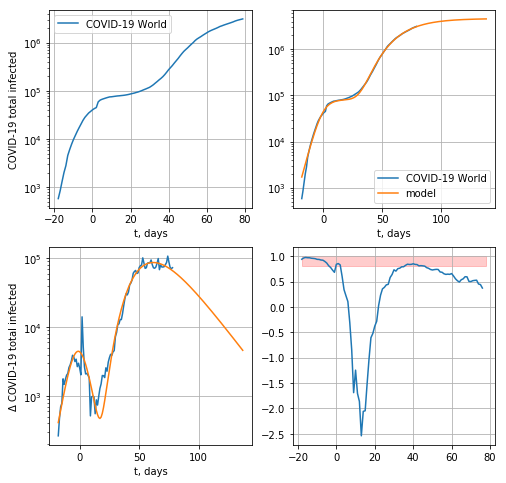

15194.316248800167


In [100]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

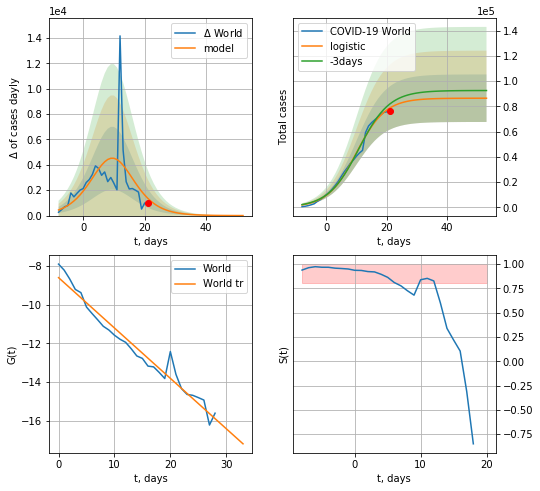

World data at: 2020-04-28
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +32 days
	 deltaDaycases:  2
	 total cases:  86463 ± 18832
	 total death:  6005 ± 3923
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


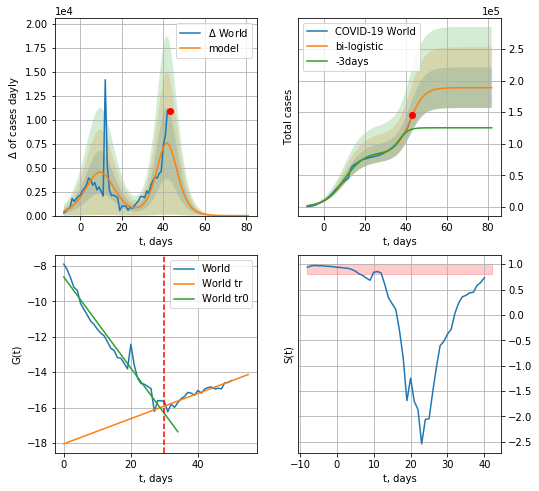

World data at: 2020-04-28
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  188700 ± 32065
	 total death:  13105 ± 6680
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


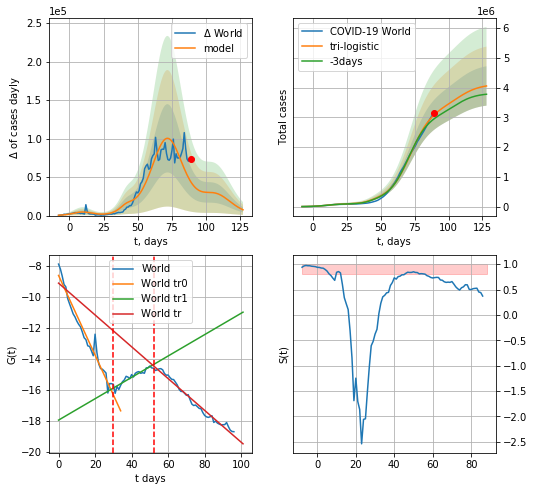

World data at: 2020-04-28
+3 day model MAPE: 0.046471861349241084
model: tri-logistic
coeffs:  [3.14263695e+06 1.26484859e-01 7.20109127e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.16310960980528064
forecast at the end of period: +39 days
	 deltaDaycases:  7537
	 total cases:  4056264 ± 661615
	 total death:  281718 ± 137852
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.979636
 intercept: -9.126546
 slope: -0.102720


In [101]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

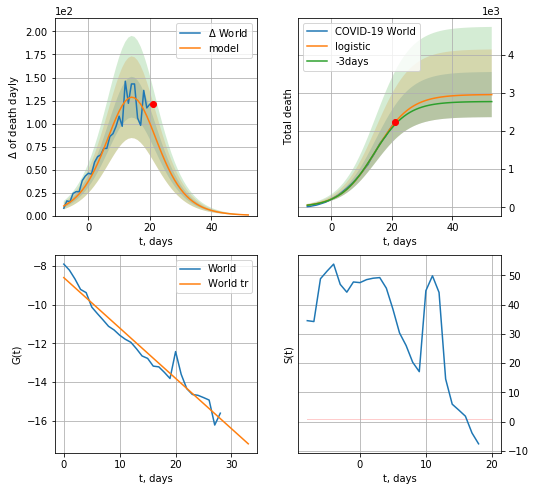

World data at: 2020-04-28
+3 day model MAPE: 0.02922470086968507
model: logistic
coeffs:  [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.20032621918861032
forecast at the end of period: +32 days
	 total death:  2952 ± 591
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


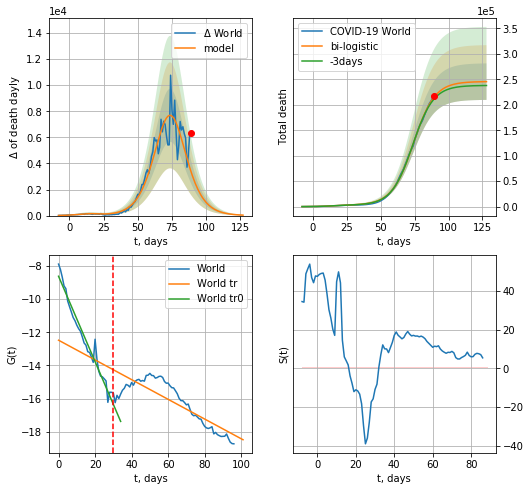

World data at: 2020-04-28
+3 day model MAPE: 0.01790207974488613
model: bi-logistic
coeffs:  [2.42742778e+05 1.26742135e-01 7.40979765e+01] [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.14604629971770614
forecast at the end of period: +39 days
	 deltaDaydeath:  35
	 total death:  245437 ± 35845
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.722029
 intercept: -12.480449
 slope: -0.059330


In [102]:
vL = 30
vL1=52
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [85]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


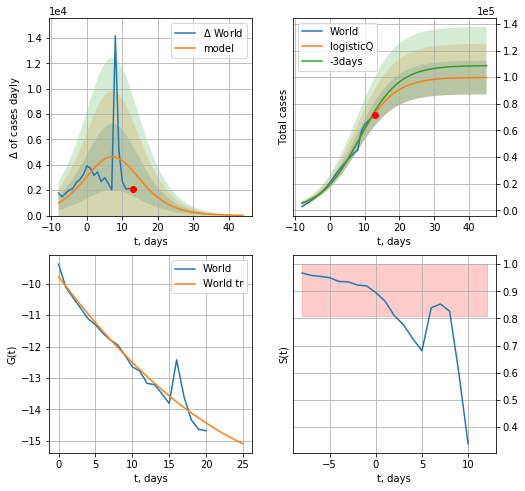

World data at: 2020-04-28
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +32 days
	 deltaDaycases: 19
	 total cases: 99770 ± 12666
	 total death: 6929 ± 2639
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


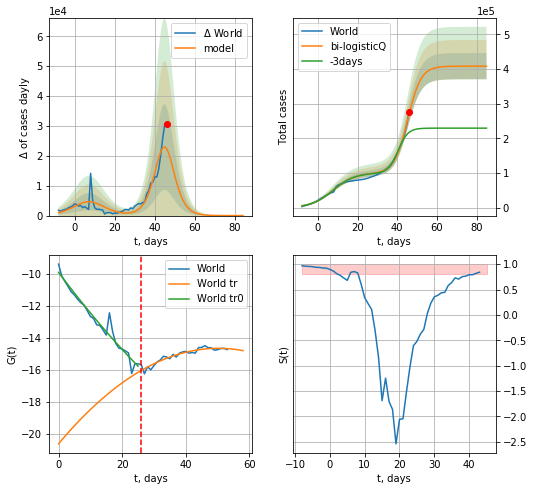

World data at: 2020-04-28
+3 day model MAPE: 0.32239919190977434
model: bi-logisticQ
coeffs:  [ 3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03] [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev:  0.09256127184297237
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  408413 ± 37803
	 total death:  28365 ± 7876
bi-logistic approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


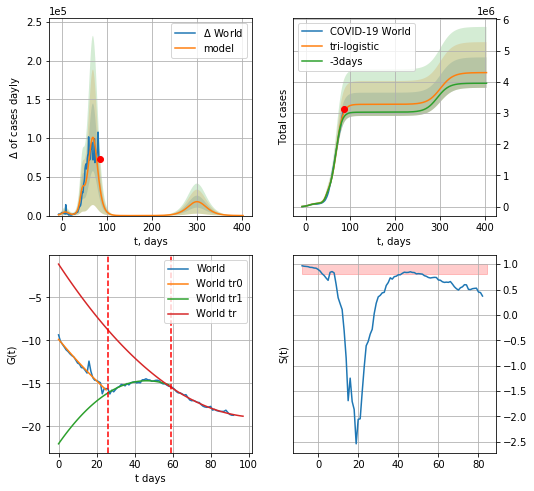

World data at: 2020-04-28
+3 day model MAPE: 0.053286501845953224
model: tri-logistic
coeffs:  [ 2.86888920e+06  2.88350313e-06  6.90430809e+01 -4.87828354e+04] [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04
  3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03]
scenario coeffs:  [0.35416971, 0.02606324, 4.35859408, 19.30413219]
forecast rational stdev:  0.11363237961052429
forecast at the end of period: +319 days
	 deltaDaycases:  50
	 total cases:  4292690 ± 487788
	 total death:  298139 ± 101634
tri-logistic approximation splitting points: 26,59
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.874764
 intercept_: -22.035447570025077
 coeffs_: [ 0.          0.31660897 -0.00341999]
trend coefficient of determination: 0.987233
 intercept_: -1.1509846564233293
 coeffs_: [ 0.         -0.33554928  0.00158073]


In [517]:
vL=30 - 4
vL1=59
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [442]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


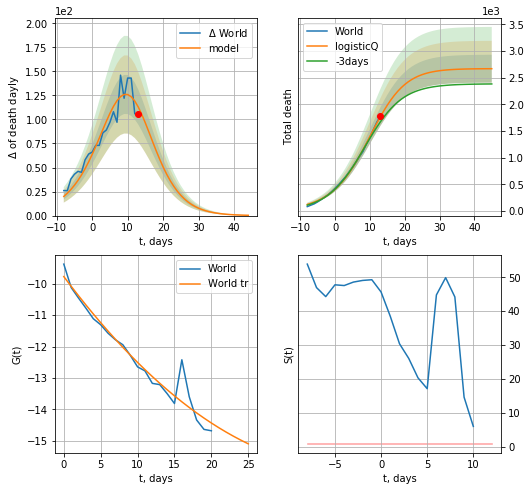

World data at: 2020-04-28
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +32 days
	 total death: 2669 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


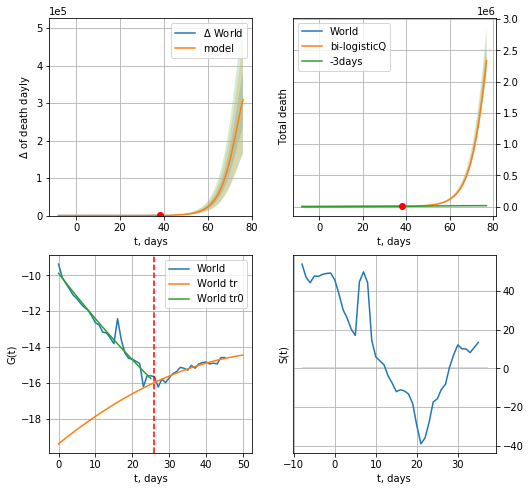

World data at: 2020-04-28
+3 day model MAPE: 0.10565529103719425
model: bi-logisticQ
coeffs:  [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02] [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev:  0.07659002399997471
forecast at the end of period: +39 days
	 deltaDaydeath:  309860
	 total death:  2339130 ± 179154
bi-logistic approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:375: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


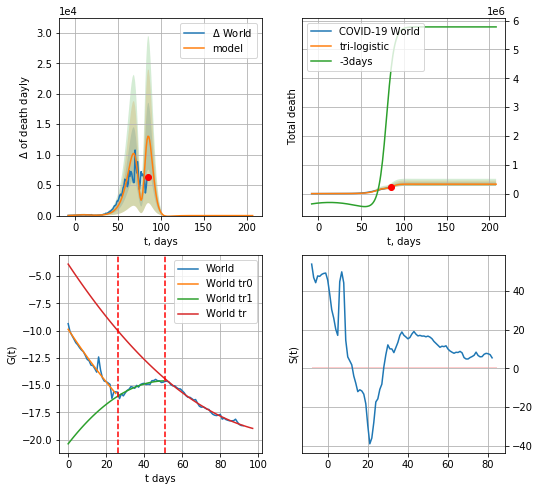

World data at: 2020-04-28
+3 day model MAPE: 0.9470573871883177
model: tri-logistic
coeffs:  [-6.09706464e+06  1.26083291e-04  7.96099337e+01 -1.73484793e+03] [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02
  6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
forecast rational stdev:  0.18938372003960524
forecast at the end of period: +123 days
	 deltaDaydeath:  0
	 total death:  327646 ± 62050
tri-logistic approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.991091
 intercept_: -3.9162806514286466
 coeffs_: [ 0.         -0.26283479  0.00110978]


In [501]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


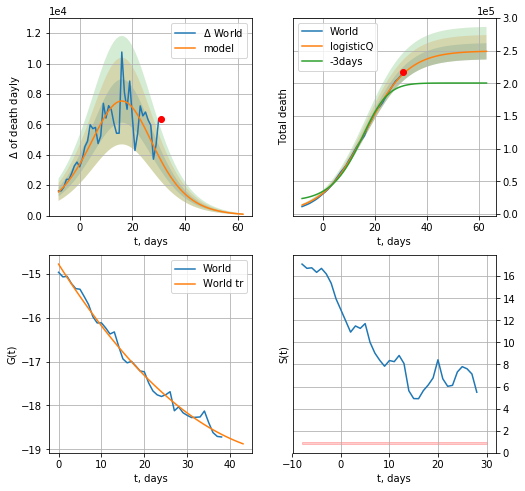

World data at: 2020-04-28
+3 day model MAPE: 0.106856
model: logisticQ
coeffs: [ 2.49536060e+05  1.32667838e-04  1.62143688e+01 -8.95117693e+02]
rational stdev: 0.050108
forecast at the end of period: +32 days
	 total death: 248885 ± 12471
trend coefficient of determination: 0.990419
 intercept_: -14.78009752445729
 coeffs_: [ 0.         -0.15425707  0.00137306]


In [433]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [89]:
#trend(dfSP,'SP',10)

In [90]:
#np.log(np.diff(dfFR["cases"].values)[:]/dfFR["cases"].values[1:]**2)

In [91]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

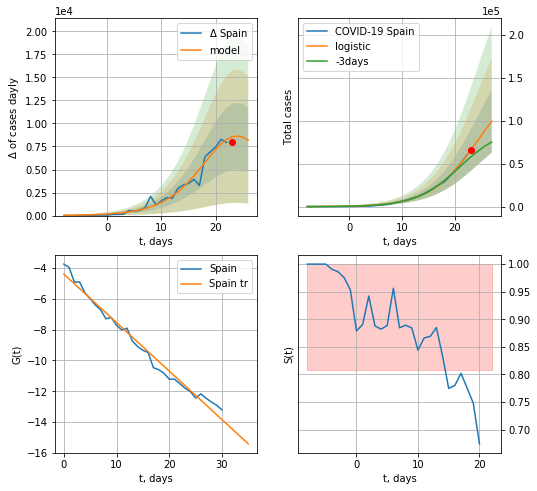

Spain data at: 2020-04-28
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +4 days
	 deltaDaycases:  8193
	 total cases:  99470 ± 36632
	 total death:  10208 ± 11278
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


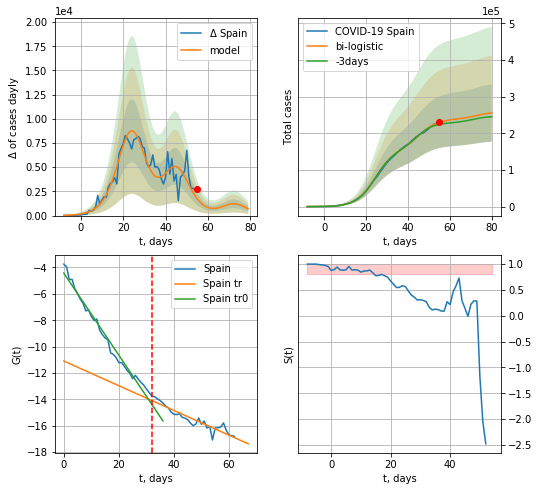

Spain data at: 2020-04-28
+3 day model MAPE: 0.028401111739375286
model: bi-logistic
coeffs:  [8.27250899e+04 2.30194868e-01 4.55432624e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.30590235661202836
forecast at the end of period: +25 days
	 deltaDaycases:  706
	 total cases:  255816 ± 78254
	 total death:  26253 ± 24092
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.874223
 intercept: -11.091651
 slope: -0.093689


In [130]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,5*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
59 2020-04-24  219764  104885  23120.0
60 2020-04-25  223759  105149  23487.0
61 2020-04-26  226629   85712  23867.0
62 2020-04-27  229422   85069  24198.0
63 2020-04-28  232128   84403  23822.0


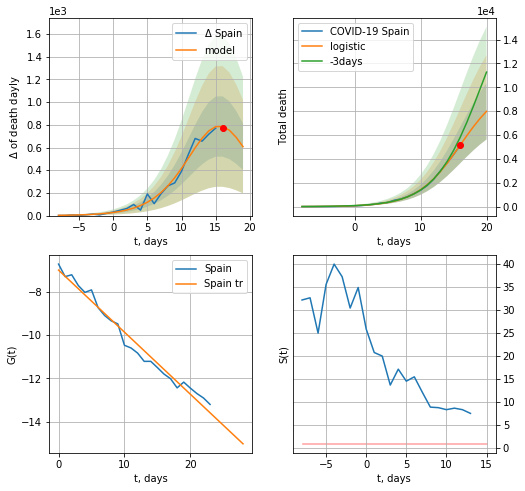

Spain data at: 2020-04-28
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +4 days
	 total death:  7986 ± 2359
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


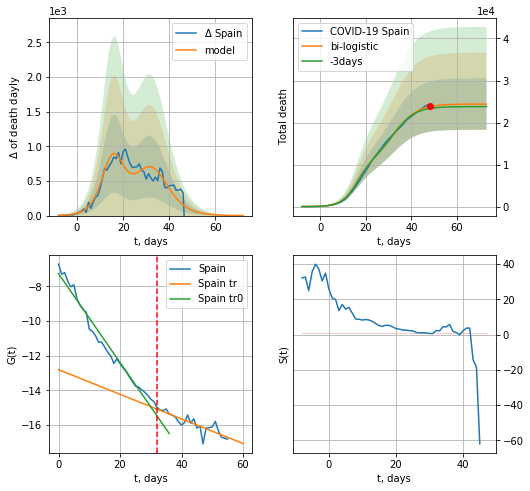

Spain data at: 2020-04-28
+3 day model MAPE: 0.019442954177959153
model: bi-logistic
coeffs:  [1.40128315e+04 1.95396978e-01 3.24403941e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.2508793926226265
forecast at the end of period: +25 days
	 deltaDaydeath:  1
	 total death:  24395 ± 6120
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.747615
 intercept: -12.802846
 slope: -0.070935


In [131]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,5*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


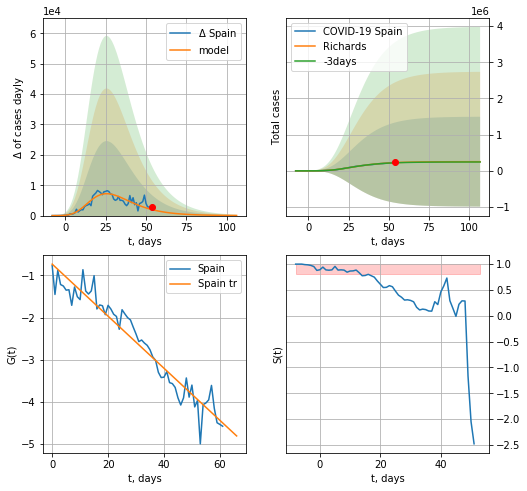

Spain data at: 2020-04-28
+3 day model MAPE: 0.01981990446553446
model: Richards
coeffs:  [ 2.53096103e+05  7.61317395e+00 -3.27568518e+01  1.02226352e-02]
rational stdev:  4.912870845162527
forecast at the end of period: +53 days
	 deltaDaycases:  37
	 total cases:  252628 ± 1241132
	 total death:  25925 ± 382098
trend coefficient of determination: 0.931201
 intercept: -0.733619
 slope: -0.061733


In [132]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide


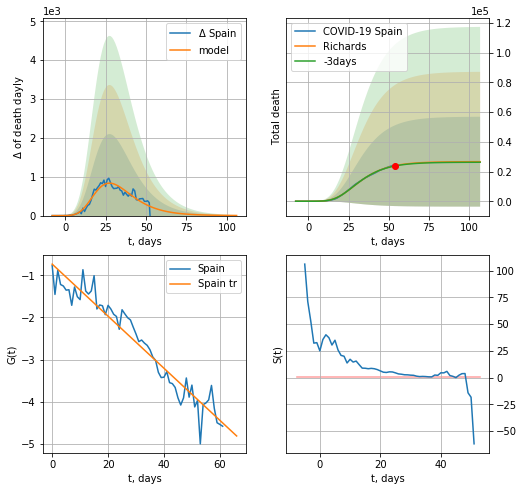

Spain data at: 2020-04-28
+3 day model MAPE: 0.008458146108950267
model: Richards
coeffs:  [ 2.66485827e+04  8.21203343e+00 -2.53875669e+01  1.04255071e-02]
rational stdev:  1.1354585777633508
forecast at the end of period: +53 days
	 total death:  26618 ± 30223
trend coefficient of determination: 0.931299
 intercept: -0.734792
 slope: -0.061761


In [133]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


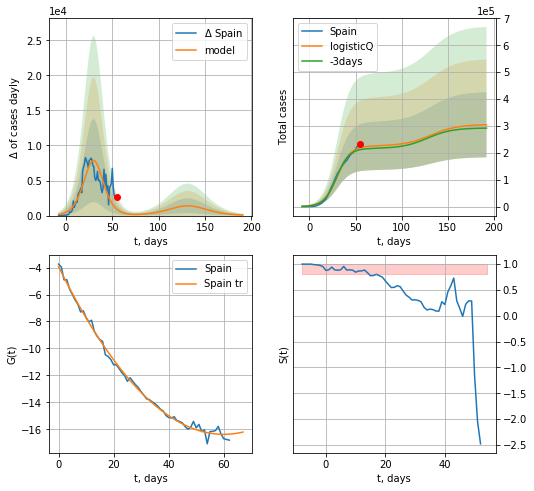

Spain data at: 2020-04-28
+3 day model MAPE: 0.035662
model: logisticQ
coeffs: [ 2.25583024e+05  1.11983823e-06  3.01929226e+01 -1.24321653e+05]
scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398702
forecast at the end of period: +137 days
	 deltaDaycases: 81
	 total cases: 304333 ± 121338
	 total death: 31232 ± 37356
trend coefficient of determination: 0.995809
 intercept_: -3.9257555089069456
 coeffs_: [ 0.         -0.41500929  0.00345887]


In [514]:
x = forecastRRR('Spain',dfSP[:],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


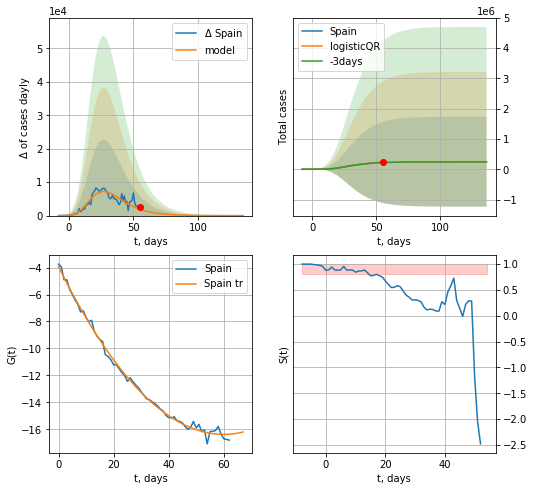

Spain data at: 2020-04-28
+3 day model MAPE: 0.020873883993804094
model: logisticQR
coeffs:  [ 2.50331872e+05  3.85484692e-02 -5.97513683e+01 -9.13899954e+02
  1.97936104e-03]
rational stdev:  5.919135064983799
forecast at the end of period: +81 days
	 deltaDaycases:  1
	 total cases:  250312 ± 1481632
	 total death:  25688 ± 456152
trend coefficient of determination: 0.995809
 intercept_: -3.9257555089069456
 coeffs_: [ 0.         -0.41500929  0.00345887]


In [135]:
x = forecastQR('Spain',dfSP[:],d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,3.,1])

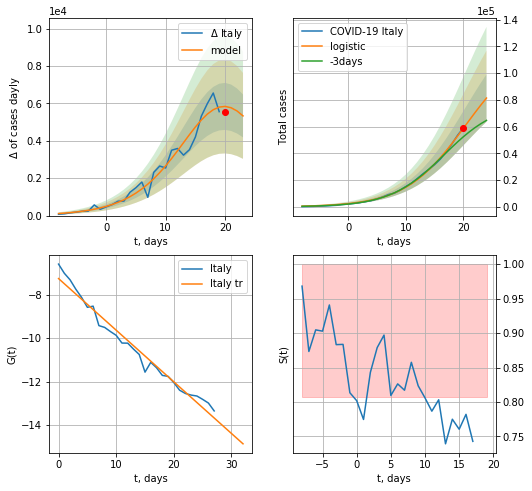

Italy data at: 2020-04-28
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +4 days
	 deltaDaycases:  5332
	 total cases:  81332 ± 17730
	 total death:  11042 ± 7221
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


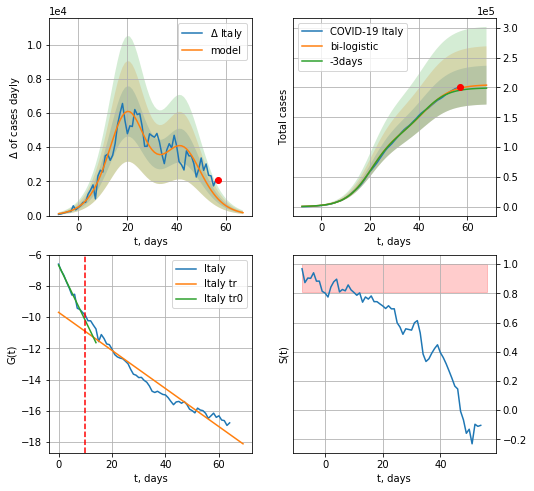

Italy data at: 2020-04-28
+3 day model MAPE: 0.018629171886780895
model: bi-logistic
coeffs:  [8.32338066e+04 1.81116494e-01 4.28666526e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.15969873732383416
forecast at the end of period: +11 days
	 deltaDaycases:  172
	 total cases:  203845 ± 32553
	 total death:  27676 ± 13259
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.943386
 intercept: -9.687365
 slope: -0.122320


In [136]:
x = forecast('Italy',dfIT[:-6-dT],d1,5*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

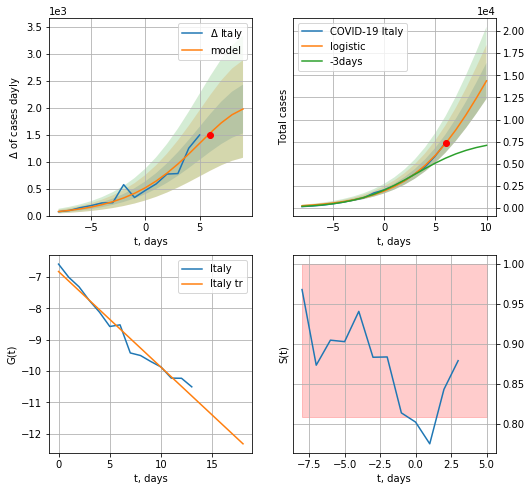

Italy data at: 2020-04-28
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +4 days
	 deltaDaycases:  1972
	 total cases:  14377 ± 2031
	 total death:  1952 ± 827
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


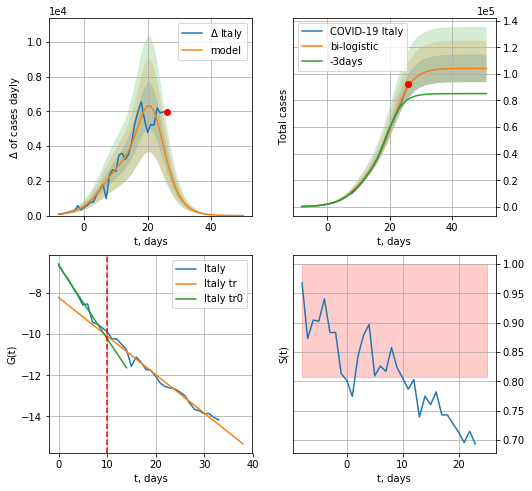

Italy data at: 2020-04-28
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +25 days
	 deltaDaycases:  2
	 total cases:  104173 ± 10388
	 total death:  14144 ± 4231
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


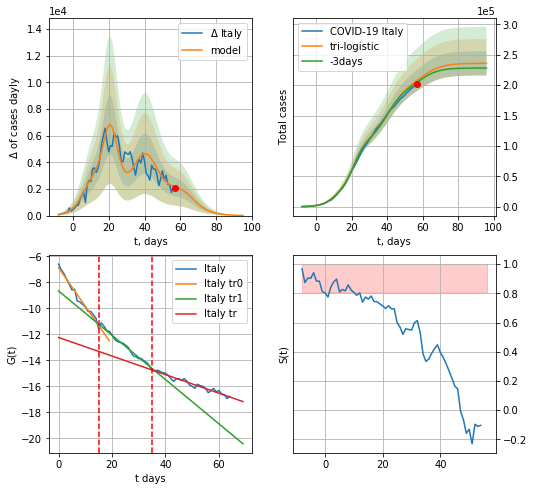

Italy data at: 2020-04-28
+3 day model MAPE: 0.016339329533235497
model: tri-logistic
coeffs:  [9.76448027e+04 1.82732950e-01 4.06429808e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.0847115295204337
forecast at the end of period: +39 days
	 deltaDaycases:  12
	 total cases:  235939 ± 19986
	 total death:  32034 ± 8140
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.953591
 intercept: -12.238888
 slope: -0.071550


In [137]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,5*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

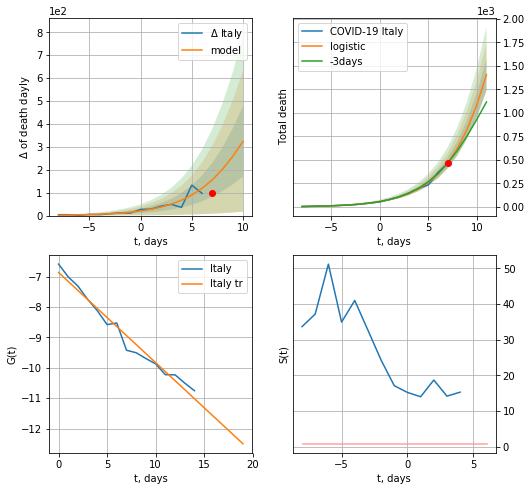

Italy data at: 2020-04-28
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +4 days
	 total death:  1407 ± 169
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


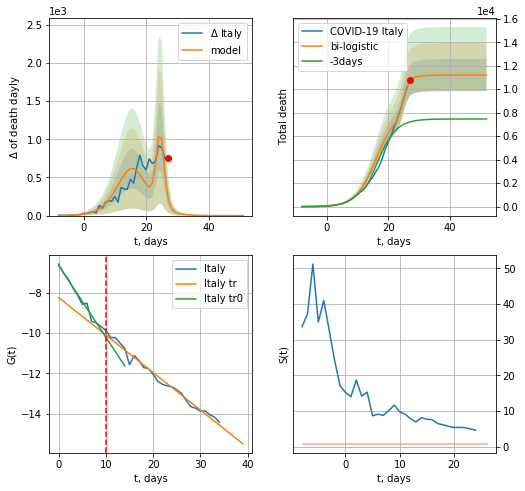

Italy data at: 2020-04-28
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +25 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


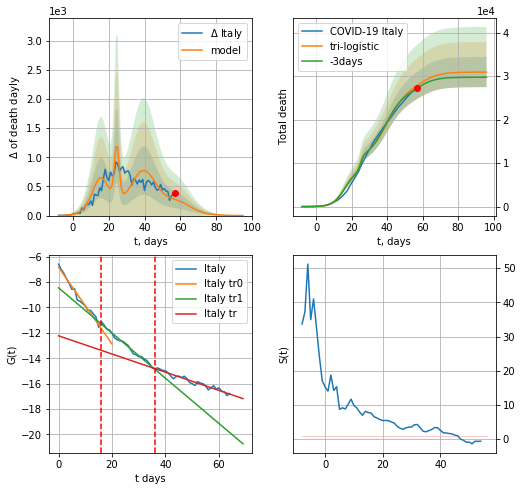

Italy data at: 2020-04-28
+3 day model MAPE: 0.02278941667011946
model: tri-logistic
coeffs:  [1.57907126e+04 1.91551960e-01 3.98242441e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.11198707048773887
forecast at the end of period: +39 days
	 deltaDaydeath:  0
	 total death:  30945 ± 3465
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.948991
 intercept: -12.234555
 slope: -0.071629


In [138]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,5*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


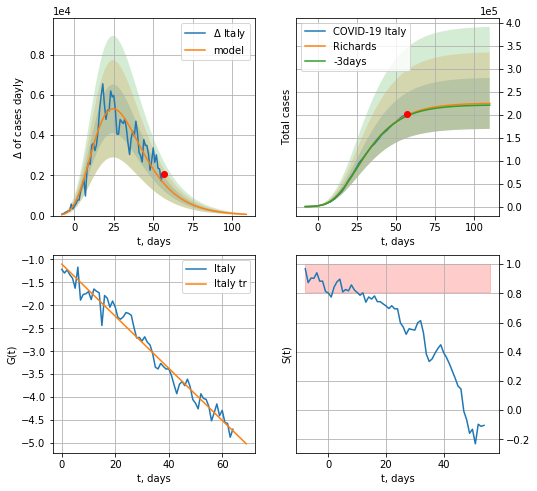

Italy data at: 2020-04-28
+3 day model MAPE: 0.009179112081794541
model: Richards
coeffs:  [ 2.25252555e+05  6.02846552e+00 -4.53026610e+01  1.07037542e-02]
rational stdev:  0.24695684027022002
forecast at the end of period: +53 days
	 deltaDaycases:  62
	 total cases:  224319 ± 55397
	 total death:  30456 ± 22563
trend coefficient of determination: 0.971400
 intercept: -1.101862
 slope: -0.056734


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


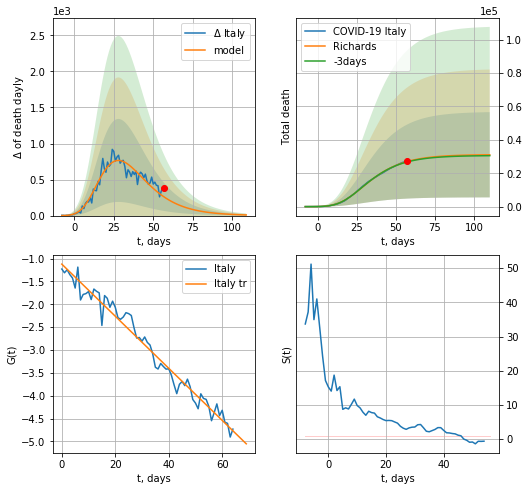

Italy data at: 2020-04-28
+3 day model MAPE: 0.00930471206798173
model: Richards
coeffs:  [ 3.11858185e+04  5.05475274e+00 -3.59387317e+01  1.32870667e-02]
rational stdev:  0.822144157922439
forecast at the end of period: +53 days
	 total death:  31056 ± 25532
trend coefficient of determination: 0.971778
 intercept: -1.121419
 slope: -0.056970


In [139]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


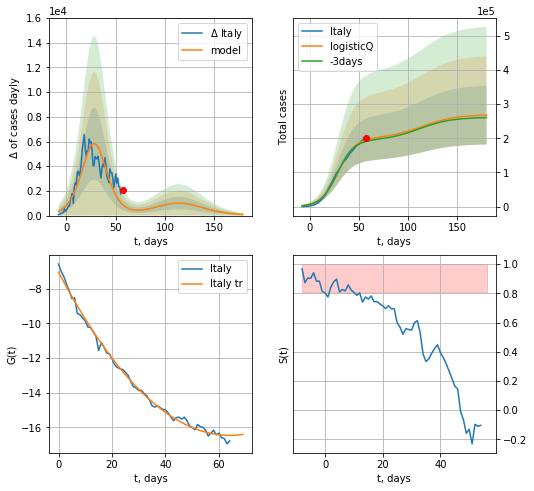

Italy data at: 2020-04-28
+3 day model MAPE: 0.022794
model: logisticQ
coeffs: [ 1.99450285e+05  9.60689193e-07  2.85623618e+01 -1.21139969e+05]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.321036
forecast at the end of period: +123 days
	 deltaDaycases: 86
	 total cases: 267776 ± 85965
	 total death: 36356 ± 35014
trend coefficient of determination: 0.995114
 intercept_: -7.050665993081514
 coeffs_: [ 0.         -0.29378132  0.00229326]


In [141]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=[.35,.5,4.,1])

In [142]:
dT

31

FR
          date     cases  active    death
69 2020-04-24  182728.0   94090  22245.0
70 2020-04-25  184373.0   94280  22614.0
71 2020-04-26  186033.0   94341  22856.0
72 2020-04-27  189775.0   97036  23293.0
73 2020-04-28  192413.0   95365  23660.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


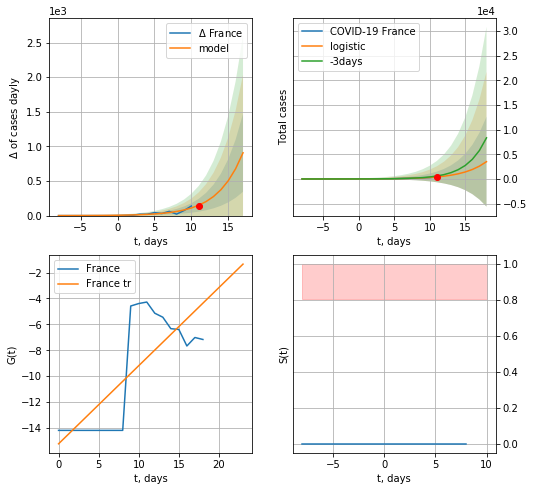

France data at: 2020-04-28
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +7 days
	 deltaDaycases:  906
	 total cases:  3502 ± 9103
	 total death:  499 ± 3890
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


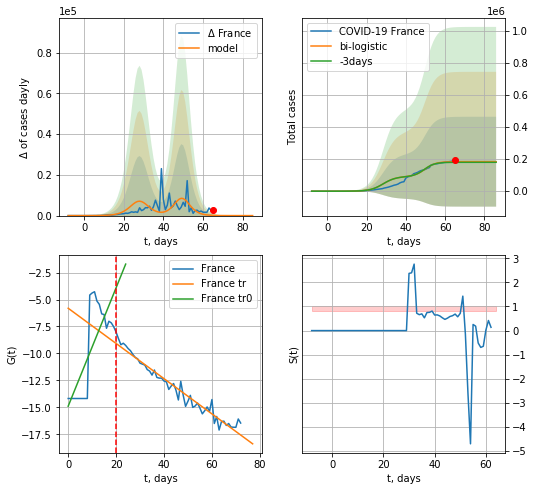

France data at: 2020-04-28
+3 day model MAPE: 0.021028294190378733
model: bi-logistic
coeffs:  [9.30514973e+04 3.65060184e-01 4.97759906e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.5214344331662235
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  184427 ± 280593
	 total death:  26300 ± 120041
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.957019
 intercept: -5.809454
 slope: -0.163286


In [144]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,6*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [145]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

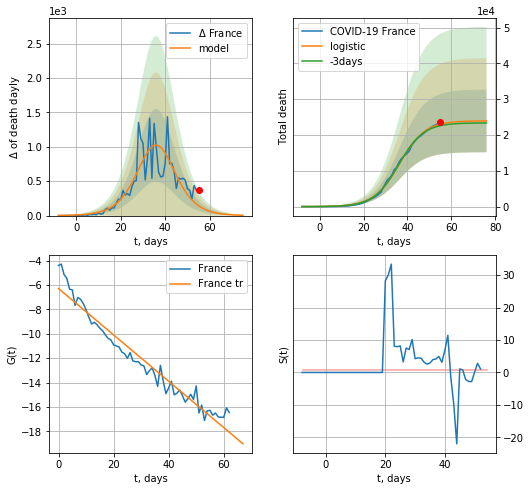

France data at: 2020-04-28
+3 day model MAPE: 0.019281884365753423
model: logistic
coeffs:  [2.39547804e+04 1.71419985e-01 3.63592188e+01]
rational stdev:  0.3656761967969241
forecast at the end of period: +21 days
	 total death:  23928 ± 8749
trend coefficient of determination: 0.948756
 intercept: -6.285946
 slope: -0.190141


In [146]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


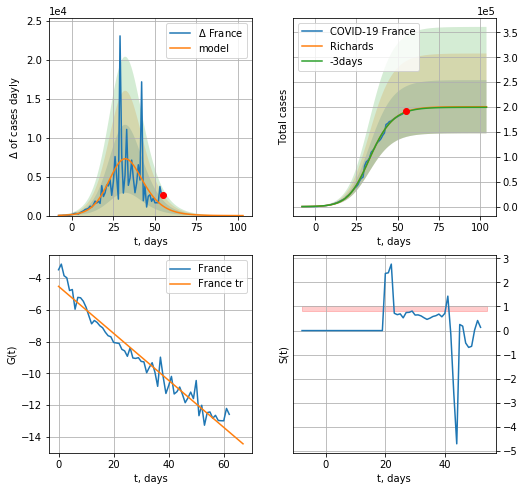

France data at: 2020-04-28
+3 day model MAPE: 0.0032324638450845202
model: Richards
coeffs:  [2.00641481e+05 1.92571463e-01 2.96735117e+01 6.80965433e-01]
rational stdev:  0.26641462452447806
forecast at the end of period: +49 days
	 deltaDaycases:  2
	 total cases:  200624 ± 53449
	 total death:  28610 ± 22866
trend coefficient of determination: 0.954800
 intercept: -4.519205
 slope: -0.147918


In [147]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


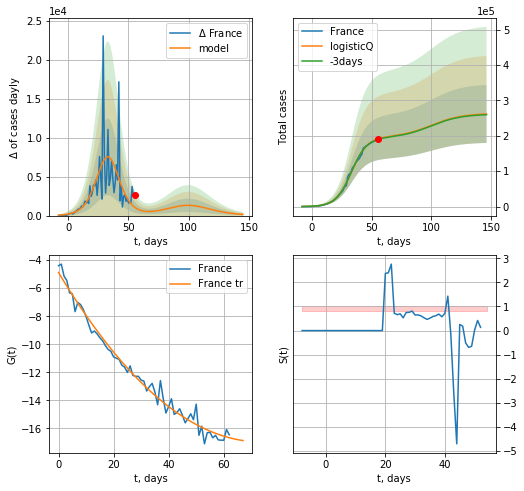

France data at: 2020-04-28
+3 day model MAPE: 0.007494
model: logisticQ
coeffs: [ 1.95378162e+05  4.75566468e-06  3.32743129e+01 -3.23358711e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1.0]
rational stdev: 0.312927
forecast at the end of period: +91 days
	 deltaDaycases: 146
	 total cases: 261881 ± 81949
	 total death: 37346 ± 35059
trend coefficient of determination: 0.983377
 intercept_: -4.880559750694394
 coeffs_: [ 0.         -0.32840769  0.00223037]


In [148]:
x = forecastRRR('France',dfFR[10:],d1,18*7-dT-4,1.0,addpred=True,xcoef=[.35,.5,3.,1.])

In [149]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [150]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

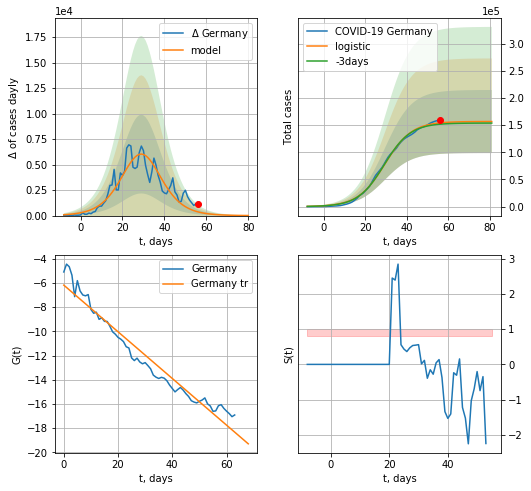

Germany data at: 2020-04-28
+3 day model MAPE: 0.016234697320796833
model: logistic
coeffs:  [1.56824641e+05 1.53853670e-01 2.94347754e+01]
rational stdev:  0.3707098279641675
forecast at the end of period: +25 days
	 deltaDaycases:  9
	 total cases:  156768 ± 58115
	 total death:  6189 ± 6882
trend coefficient of determination: 0.951367
 intercept: -6.175379
 slope: -0.193010


In [151]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


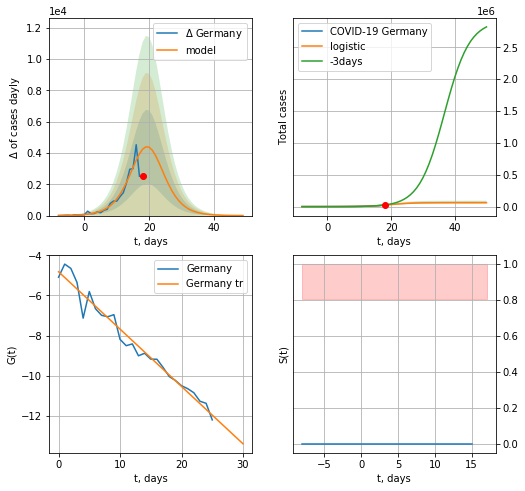

Germany data at: 2020-04-28
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +32 days
	 deltaDaycases:  3
	 total cases:  61628 ± 10510
	 total death:  2433 ± 1244
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


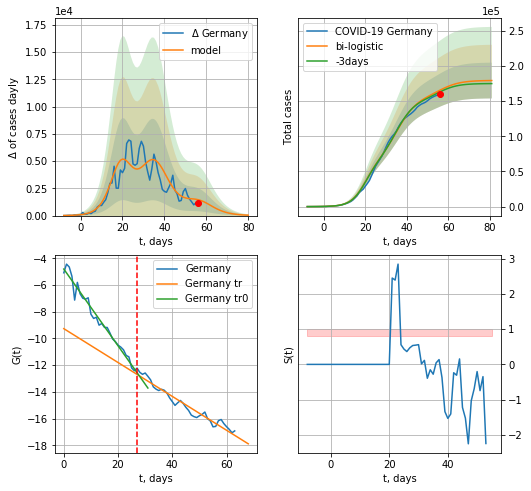

Germany data at: 2020-04-28
+3 day model MAPE: 0.0151255017971407
model: bi-logistic
coeffs:  [9.42757397e+04 2.07047927e-01 3.54189705e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.1417966372527151
forecast at the end of period: +25 days
	 deltaDaycases:  36
	 total cases:  179324 ± 25427
	 total death:  7080 ± 3011
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.951805
 intercept: -9.265680
 slope: -0.126693


In [152]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
60 2020-04-24  154999   39439  5760.0
61 2020-04-25  156513   40836  5877.0
62 2020-04-26  157770   37294  5976.0
63 2020-04-27  158758   38132  6126.0
64 2020-04-28  159912   33198  6314.0


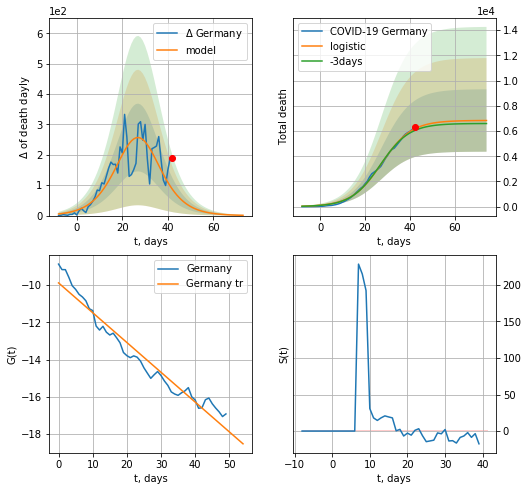

Germany data at: 2020-04-28
+3 day model MAPE: 0.023069431837732763
model: logistic
coeffs:  [6.84030871e+03 1.50346594e-01 2.73184465e+01]
rational stdev:  0.36222460419987884
forecast at the end of period: +32 days
	 total death:  6834 ± 2475
trend coefficient of determination: 0.951400
 intercept: -9.886808
 slope: -0.159809


In [153]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


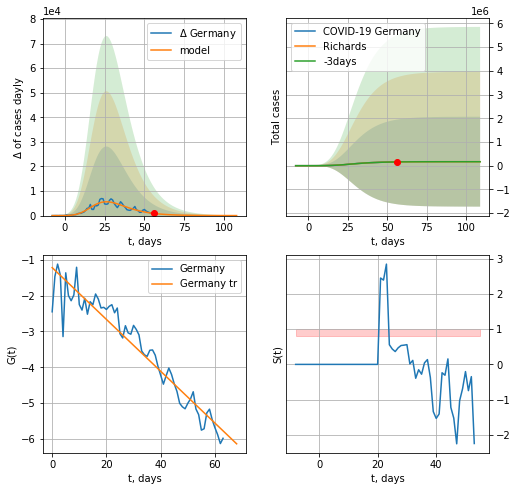

Germany data at: 2020-04-28
+3 day model MAPE: 0.0067610264560520866
model: Richards
coeffs:  [1.68806554e+05 1.07683372e+00 7.64345825e-01 8.76554992e-02]
rational stdev:  11.222575262344531
forecast at the end of period: +53 days
	 deltaDaycases:  6
	 total cases:  168736 ± 1893654
	 total death:  6662 ± 224294
trend coefficient of determination: 0.918847
 intercept: -1.217298
 slope: -0.072337


In [154]:
x = forecastRR('Germany',dfGR[:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


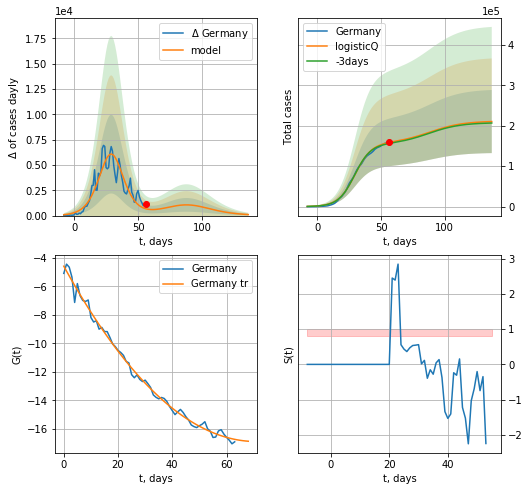

Germany data at: 2020-04-28
+3 day model MAPE: 0.016108
model: logisticQ
coeffs: [ 1.56816985e+05  1.57933662e-06  2.94345223e+01 -9.73696260e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.370829
forecast at the end of period: +81 days
	 deltaDaycases: 98
	 total cases: 210441 ± 78037
	 total death: 8309 ± 9243
trend coefficient of determination: 0.993249
 intercept_: -4.582099252643748
 coeffs_: [ 0.         -0.34723042  0.0024482 ]


In [155]:
x = forecastRRR('Germany',dfGR[:],d1,16*7-dT,1.0,addpred=True,xcoef=[0.35,.5,3.0,1])

In [156]:
#x = forecast('USA',dfUS[:],d1,28*3-dT,1.0)

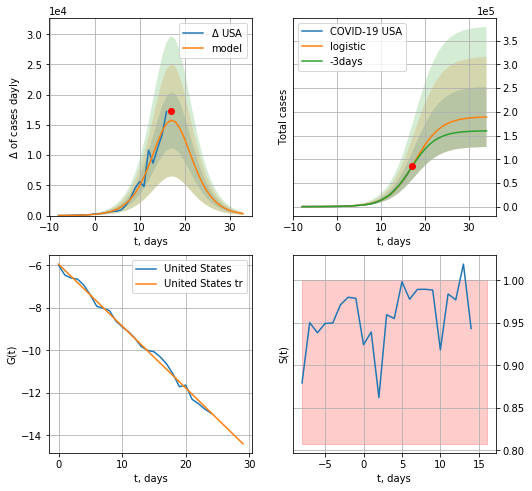

USA data at: 2020-04-28
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +17 days
	 deltaDaycases:  320
	 total cases:  189185 ± 63375
	 total death:  10825 ± 10878
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


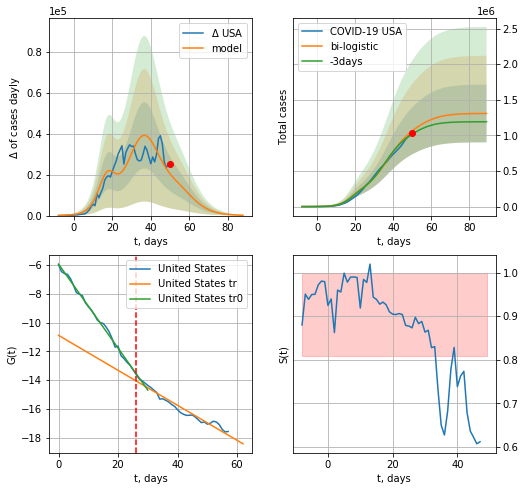

USA data at: 2020-04-28
+3 day model MAPE: 0.04774974831253238
model: bi-logistic
coeffs:  [8.95227603e+05 1.67928323e-01 3.67366182e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.30973115941366225
forecast at the end of period: +39 days
	 deltaDaycases:  162
	 total cases:  1308143 ± 405172
	 total death:  74851 ± 69551
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.955379
 intercept: -10.888877
 slope: -0.121535


In [157]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

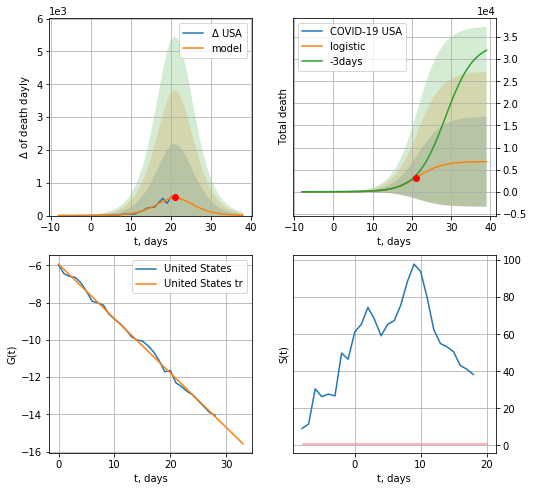

USA data at: 2020-04-28
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +18 days
	 total death:  6807 ± 10162
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


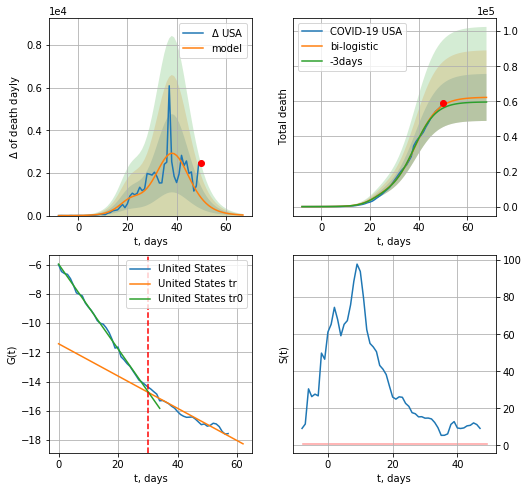

USA data at: 2020-04-28
+3 day model MAPE: 0.030291236788315096
model: bi-logistic
coeffs:  [5.55075901e+04 2.10371007e-01 3.86852827e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.21525917783314874
forecast at the end of period: +18 days
	 deltaDaydeath:  27
	 total death:  62225 ± 13394
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.949349
 intercept: -11.409936
 slope: -0.110565


In [158]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


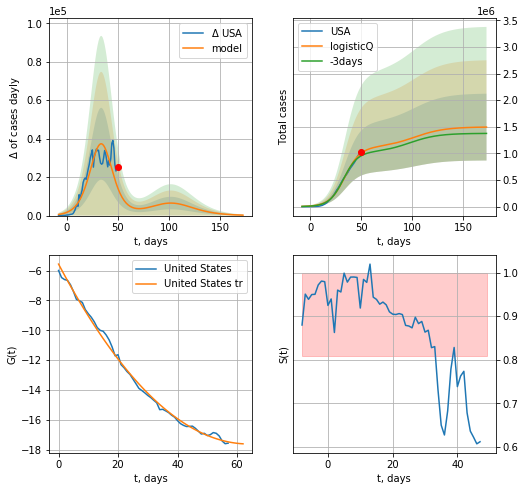

USA data at: 2020-04-28
+3 day model MAPE: 0.054206
model: logisticQ
coeffs: [ 1.10965023e+06  1.74961339e-06  3.40441551e+01 -7.63913057e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1.0]
rational stdev: 0.420024
forecast at the end of period: +123 days
	 deltaDaycases: 229
	 total cases: 1494685 ± 627804
	 total death: 85525 ± 107767
trend coefficient of determination: 0.996310
 intercept_: -5.564356534889976
 coeffs_: [ 0.         -0.37696489  0.00294681]


In [160]:
x = forecastRRR('USA',dfUS[:],d1,7*22-dT,1.0,addpred=True,xcoef=[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


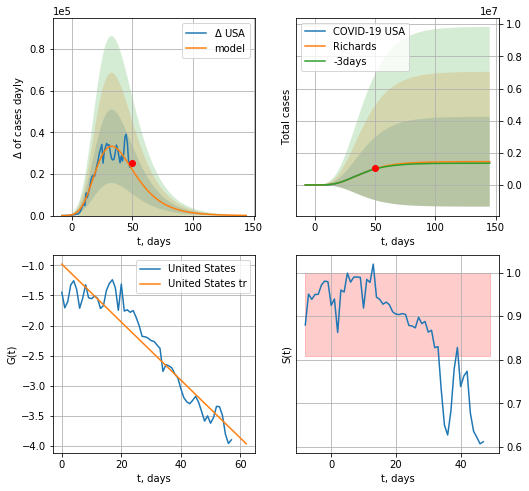

USA data at: 2020-04-28
+3 day model MAPE: 0.023515837634873304
model: Richards
coeffs:  [ 1.45176097e+06  4.71780902e+00 -3.53428800e+01  1.33045848e-02]
rational stdev:  1.9263441767031242
forecast at the end of period: +95 days
	 deltaDaycases:  85
	 total cases:  1450438 ± 2794042
	 total death:  82993 ± 479619
trend coefficient of determination: 0.904125
 intercept: -0.980874
 slope: -0.048118


In [161]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


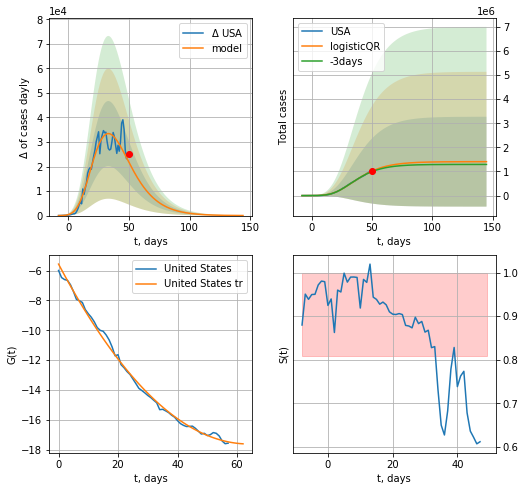

USA data at: 2020-04-28
+3 day model MAPE: 0.02664114176634351
model: logisticQR
coeffs:  [ 1.40685599e+06  2.24771264e-02 -6.65072805e+01 -6.68684335e+02
  3.59069218e-03]
rational stdev:  1.3249729262438066
forecast at the end of period: +95 days
	 deltaDaycases:  31
	 total cases:  1406492 ± 1863564
	 total death:  80478 ± 319893
trend coefficient of determination: 0.996310
 intercept_: -5.564356534889976
 coeffs_: [ 0.         -0.37696489  0.00294681]


In [162]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

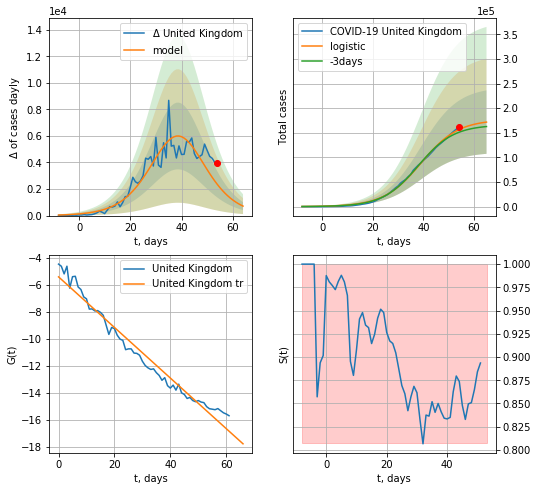

United Kingdom data at: 2020-04-28
+3 day model MAPE: 0.03845279720537127
model: logistic
coeffs:  [1.76829561e+05 1.35788029e-01 3.90708414e+01]
rational stdev:  0.37542881171300313
forecast at the end of period: +11 days
	 deltaDaycases:  714
	 total cases:  171750 ± 64479
	 total death:  23104 ± 26021
trend coefficient of determination: 0.968584
 intercept: -5.392252
 slope: -0.187551


In [163]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

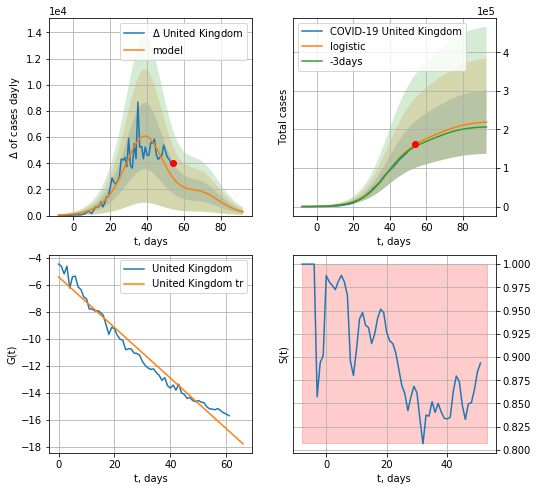

United Kingdom data at: 2020-04-28
+3 day model MAPE: 0.034527264105732806
model: logistic
coeffs:  [1.76829561e+05 1.35788029e-01 3.90708414e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37542881171300313
forecast at the end of period: +39 days
	 deltaDaycases:  285
	 total cases:  218975 ± 82209
	 total death:  29457 ± 33177
trend coefficient of determination: 0.968584
 intercept: -5.392252
 slope: -0.187551


In [164]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:130: RuntimeWarning: divide by zero encountered in true_divide


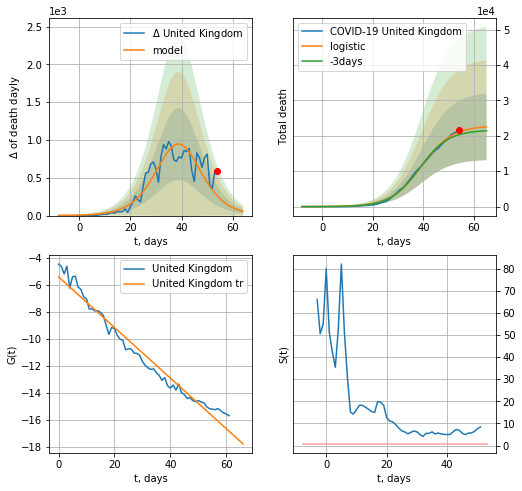

United Kingdom data at: 2020-04-28
+3 day model MAPE: 0.03843156107335143
model: logistic
coeffs:  [2.28443975e+04 1.65956081e-01 3.92792211e+01]
rational stdev:  0.4177137297780206
forecast at the end of period: +11 days
	 total death:  22528 ± 9410
trend coefficient of determination: 0.968584
 intercept: -5.392252
 slope: -0.187551


In [165]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


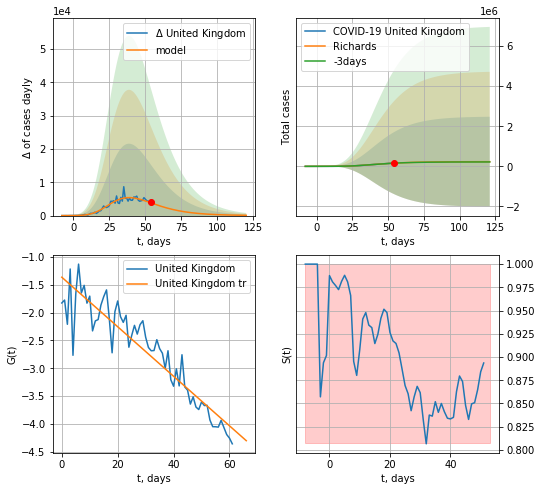

United Kingdom data at: 2020-04-28
+3 day model MAPE: 0.011825753254427869
model: Richards
coeffs:  [ 2.34235350e+05  1.17205128e+00 -5.84750298e+00  5.50433687e-02]
rational stdev:  9.621329777009258
forecast at the end of period: +67 days
	 deltaDaycases:  78
	 total cases:  233050 ± 2242252
	 total death:  31351 ± 904914
trend coefficient of determination: 0.862599
 intercept: -1.363665
 slope: -0.044500


In [166]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


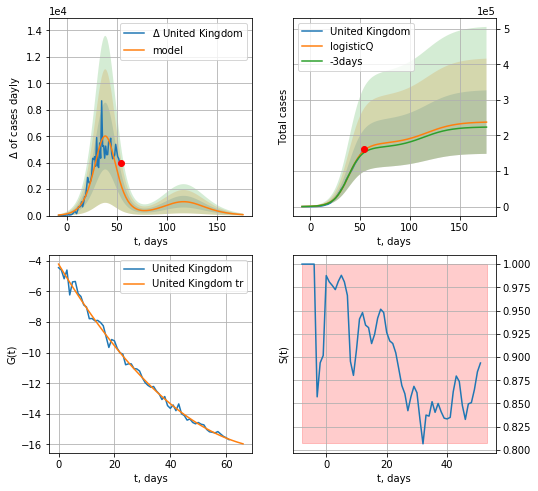

United Kingdom data at: 2020-04-28
+3 day model MAPE: 0.038633
model: logisticQ
coeffs: [ 1.76774527e+05  2.91020706e-06  3.90661816e+01 -4.66287451e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.375605
forecast at the end of period: +123 days
	 deltaDaycases: 71
	 total cases: 237609 ± 89247
	 total death: 31964 ± 36017
trend coefficient of determination: 0.994943
 intercept_: -4.21538148349892
 coeffs_: [ 0.         -0.30526948  0.00193006]


In [167]:
x = forecastRRR('United Kingdom',dfGB[:],d1,22*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1])

In [168]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [173]:
dT

31

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


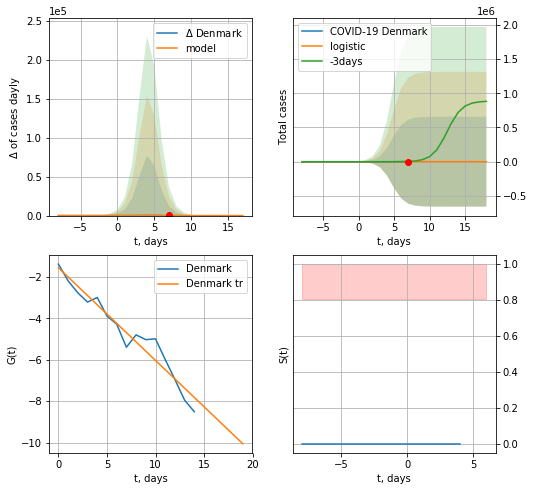

Denmark data at: 2020-04-28
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  849 ± 655795
	 total death:  41 ± 94991
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


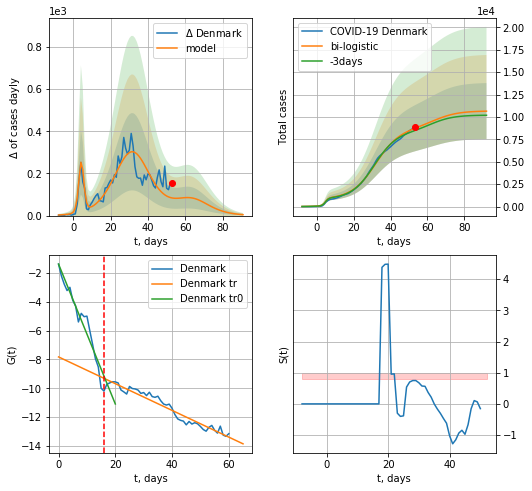

Denmark data at: 2020-04-28
+3 day model MAPE: 0.029567898463768026
model: bi-logistic
coeffs:  [7.86299808e+03 1.53251999e-01 3.19406396e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.294254130134768
forecast at the end of period: +39 days
	 deltaDaycases:  4
	 total cases:  10651 ± 3134
	 total death:  522 ± 460
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.938411
 intercept: -7.821370
 slope: -0.092734


In [174]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


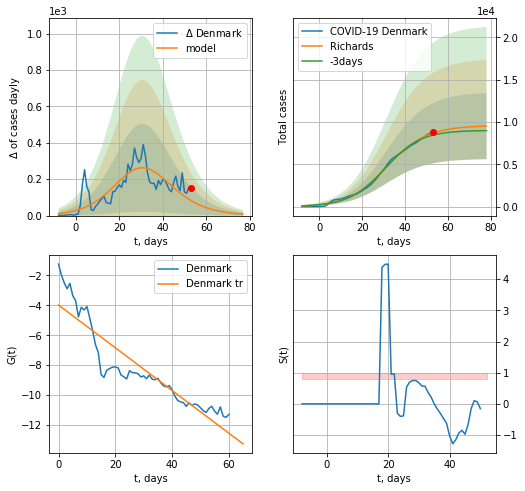

Denmark data at: 2020-04-28
+3 day model MAPE: 0.02915853692274912
model: Richards
coeffs:  [9.58479133e+03 1.29032697e-01 2.88820749e+01 7.96790591e-01]
rational stdev:  0.41052423982773356
forecast at the end of period: +25 days
	 deltaDaycases:  8
	 total cases:  9508 ± 3903
	 total death:  466 ± 573
trend coefficient of determination: 0.839331
 intercept: -3.982278
 slope: -0.142651


In [175]:
x = forecastRR('Denmark',dfDK[:],d1,8*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


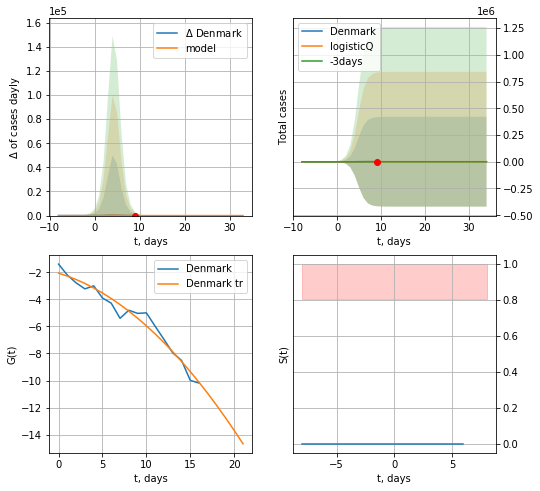

Denmark data at: 2020-04-28
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +25 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


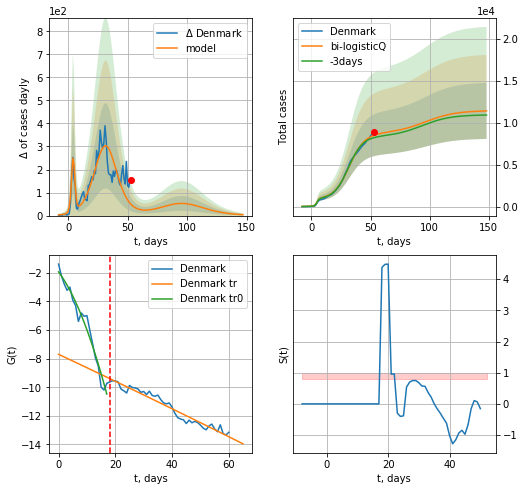

Denmark data at: 2020-04-28
+3 day model MAPE: 0.03571221180373407
model: bi-logisticQ
coeffs:  [ 7.84184638e+03  1.76025831e-06  3.19531141e+01 -8.74216186e+04] [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.2927676390949047
forecast at the end of period: +95 days
	 deltaDaycases:  3
	 total cases:  11400 ± 3337
	 total death:  559 ± 490
bi-logistic approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.950419
 intercept_: -7.693706044127282
 coeffs_: [ 0.0000000e+00 -9.3331360e-02 -4.5478786e-05]


In [176]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,18*7-dT,x,addpred=True,xcoef=[0.35,0.5,3.,1.],vL=18)

NG
          date  cases  active  death
58 2020-04-24   7663    7232  199.0
59 2020-04-25   7699    7266  201.0
60 2020-04-26   7727    7294  201.0
61 2020-04-27   7799    7362  205.0
62 2020-04-28   7860    7422  206.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


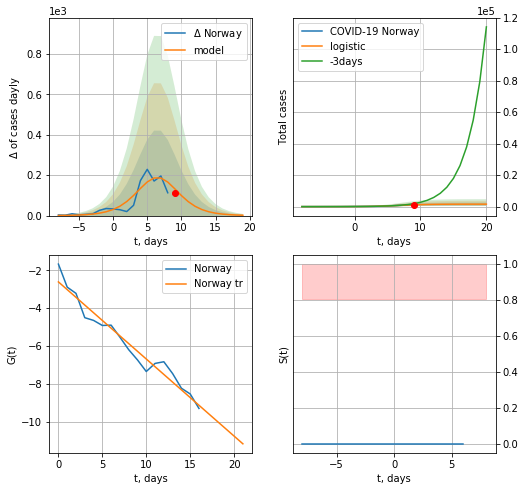

Norway data at: 2020-04-28
+3 day model MAPE: 0.5348429787153592
model: logistic
coeffs:  [1.56406229e+03 4.85480863e-01 6.99183762e+00]
rational stdev:  0.6758109663871038
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  1561 ± 1055
	 total death:  41 ± 83
trend coefficient of determination: 0.955453
 intercept: -2.613584
 slope: -0.407106


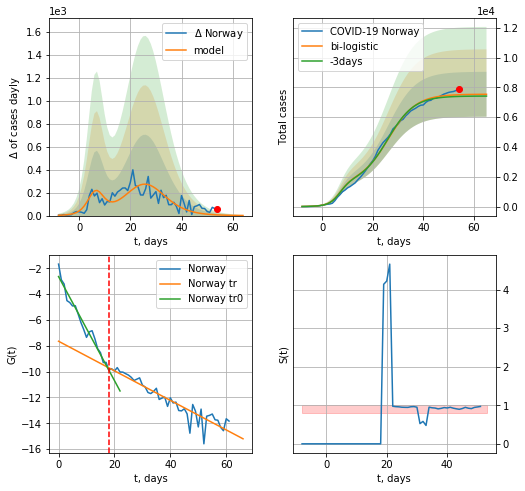

Norway data at: 2020-04-28
+3 day model MAPE: 0.015436701181785365
model: bi-logistic
coeffs:  [5.97883465e+03 1.83527606e-01 2.61621941e+01] [1.56406229e+03 4.85480863e-01 6.99183762e+00]
rational stdev:  0.19994052916030502
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  7538 ± 1507
	 total death:  202 ± 121
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.960814
 intercept: -2.637298
 slope: -0.402660
trend coefficient of determination: 0.877424
 intercept: -7.646118
 slope: -0.114443


In [178]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=18
x = forecast('Norway',dfNG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

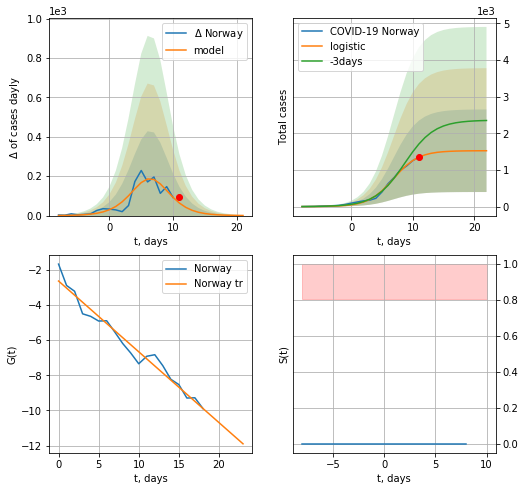

Norway data at: 2020-04-28
+3 day model MAPE: 0.2502281799322165
model: logistic
coeffs:  [1.52640478e+03 4.94422485e-01 6.88129606e+00]
rational stdev:  0.7387731713654421
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1525 ± 1127
	 total death:  41 ± 90
trend coefficient of determination: 0.966509
 intercept: -2.636780
 slope: -0.402751


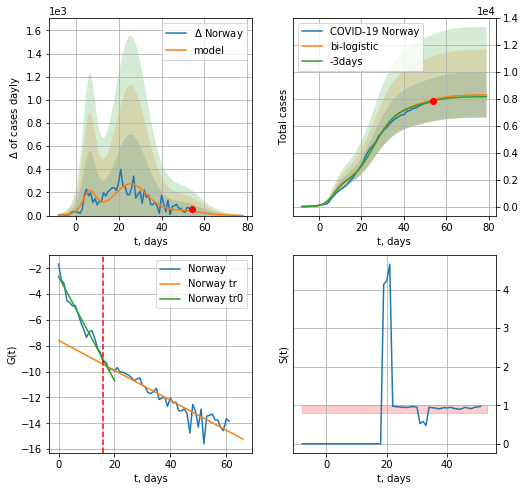

Norway data at: 2020-04-28
+3 day model MAPE: 0.012355950501560674
model: bi-logistic
coeffs:  [6.01849406e+03 1.82422257e-01 2.60830501e+01] [1.52640478e+03 4.94422485e-01 6.88129606e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.20292708049374766
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  8291 ± 1682
	 total death:  222 ± 135
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.946549
 intercept: -2.634554
 slope: -0.402912
trend coefficient of determination: 0.892479
 intercept: -7.584216
 slope: -0.115773


In [179]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


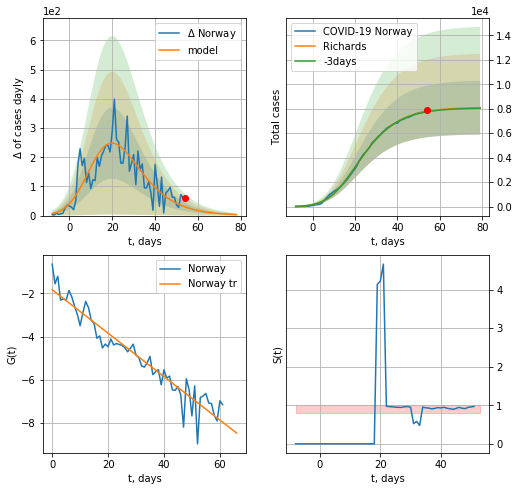

Norway data at: 2020-04-28
+3 day model MAPE: 0.00448244301432249
model: Richards
coeffs:  [8.12378803e+03 3.65564441e-01 5.88163160e+00 2.56036684e-01]
rational stdev:  0.2717907520779272
forecast at the end of period: +25 days
	 deltaDaycases:  3
	 total cases:  8090 ± 2198
	 total death:  217 ± 176
trend coefficient of determination: 0.916569
 intercept: -1.832866
 slope: -0.100628


In [180]:
x = forecastRR('Norway',dfNG[:],d1,8*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


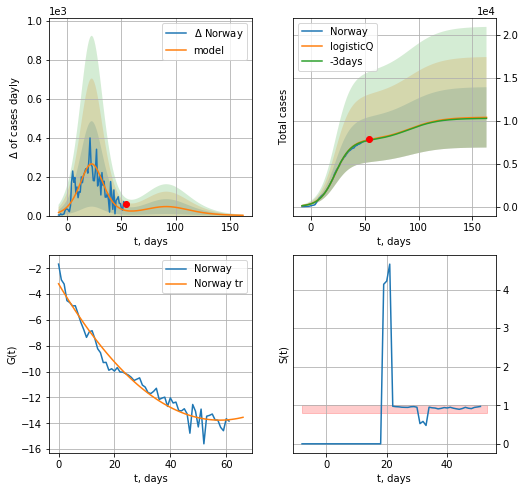

Norway data at: 2020-04-28
+3 day model MAPE: 0.009950
model: logisticQ
coeffs: [ 7.71545778e+03  1.52286165e-06  2.29623333e+01 -8.99300288e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.337963
forecast at the end of period: +109 days
	 deltaDaycases: 1
	 total cases: 10395 ± 3513
	 total death: 279 ± 282
trend coefficient of determination: 0.967120
 intercept_: -3.1975236933691686
 coeffs_: [ 0.         -0.36600528  0.00317231]


In [183]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.,1])

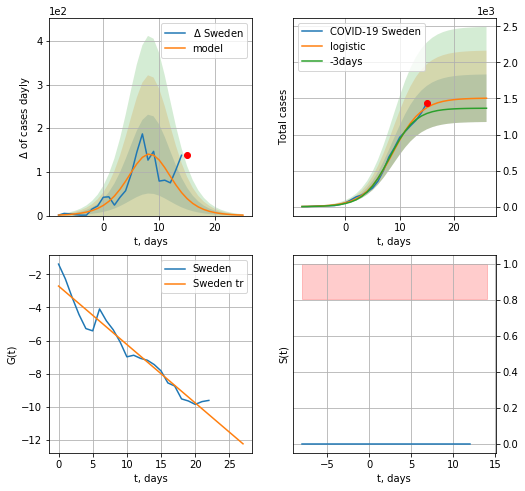

Sweden data at: 2020-04-28
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  1502 ± 329
	 total death:  180 ± 118
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


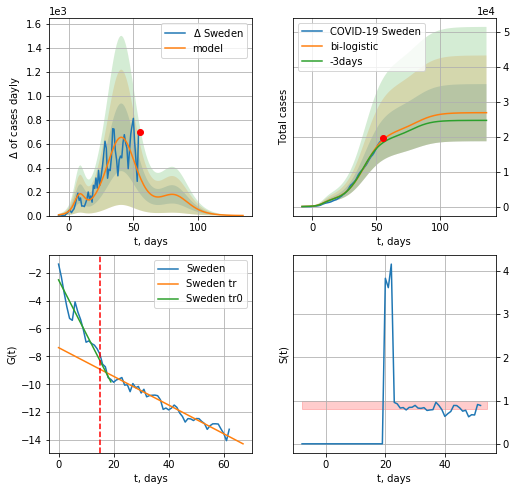

Sweden data at: 2020-04-28
+3 day model MAPE: 0.047273407029600464
model: bi-logistic
coeffs:  [2.03408054e+04 1.28010877e-01 4.10188338e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30439687050782305
forecast at the end of period: +81 days
	 deltaDaycases:  0
	 total cases:  26925 ± 8196
	 total death:  3231 ± 2950
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.952470
 intercept: -7.372640
 slope: -0.102898


In [184]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
59 2020-04-24  17567   14410  2152.0
60 2020-04-25  18177   14980  2192.0
61 2020-04-26  18640   15441  2194.0
62 2020-04-27  18926   15647  2274.0
63 2020-04-28  19621   16261  2355.0


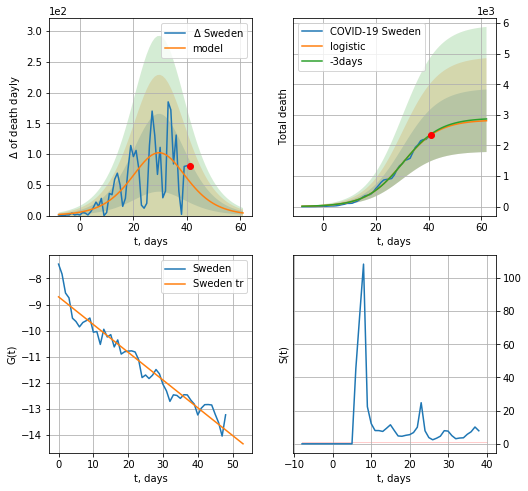

Sweden data at: 2020-04-28
+3 day model MAPE: 0.011236985477427335
model: logistic
coeffs:  [2.83545770e+03 1.44379049e-01 3.01039833e+01]
rational stdev:  0.3642975945610211
forecast at the end of period: +21 days
	 total death:  2807 ± 1022
trend coefficient of determination: 0.943906
 intercept: -8.705466
 slope: -0.106231


In [185]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


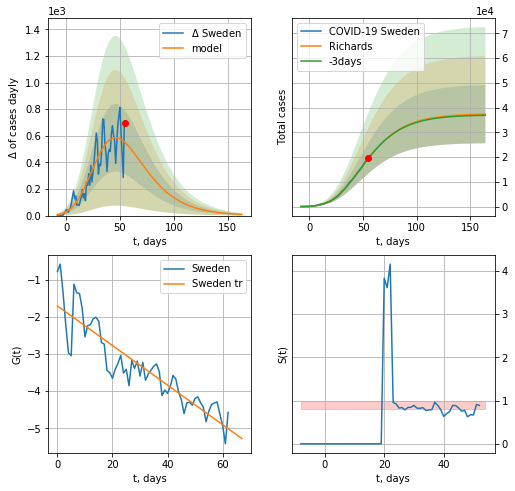

Sweden data at: 2020-04-28
+3 day model MAPE: 0.0016432572937153907
model: Richards
coeffs:  [3.75676853e+04 3.61023492e-01 2.85452947e-02 1.24559359e-01]
rational stdev:  0.3145946724327177
forecast at the end of period: +109 days
	 deltaDaycases:  8
	 total cases:  37378 ± 11759
	 total death:  4486 ± 4233
trend coefficient of determination: 0.814752
 intercept: -1.705852
 slope: -0.053294


In [186]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


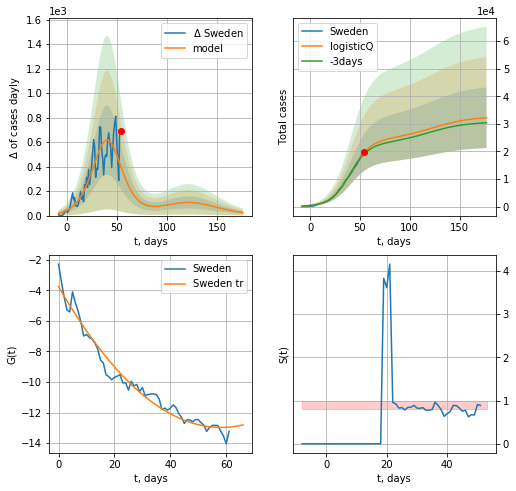

Sweden data at: 2020-04-28
+3 day model MAPE: 0.028118
model: logisticQ
coeffs: [ 2.42424475e+04  2.42446081e-06  4.07806621e+01 -4.15440124e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.340573
forecast at the end of period: +123 days
	 deltaDaycases: 24
	 total cases: 32224 ± 10974
	 total death: 3867 ± 3950
trend coefficient of determination: 0.967423
 intercept_: -3.7523988741159524
 coeffs_: [ 0.         -0.31703026  0.00272613]


In [187]:
#trend3(dfCN[:-1],dfKR,dfSG[:],'CN','KR','SG',40,40,40)
x = forecastRRR('Sweden',dfSW[1:],d1,22*7-dT,1.0,addpred=True,xcoef=[.35,.5,3.,1])

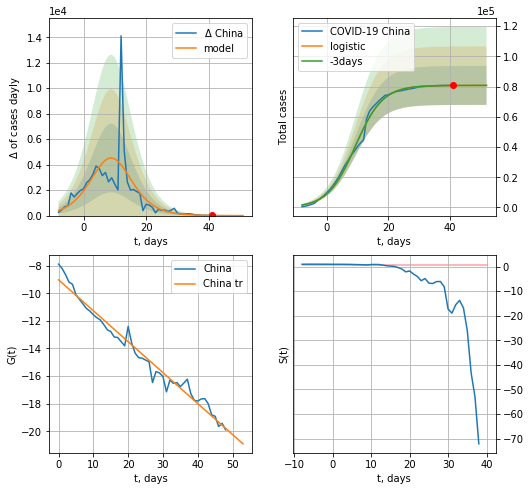

China data at: 2020-04-28
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  80804 ± 12905
	 total death:  4518 ± 2164
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


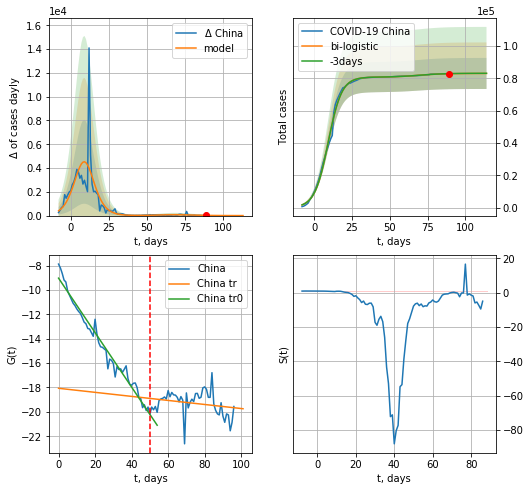

China data at: 2020-04-28
+3 day model MAPE: 0.0007521068655279922
model: bi-logistic
coeffs:  [2.30924368e+03 1.20264226e-01 6.89108823e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11572527596318719
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  83109 ± 9617
	 total death:  4647 ± 1613
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.051387
 intercept: -18.066164
 slope: -0.016587


In [188]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [189]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

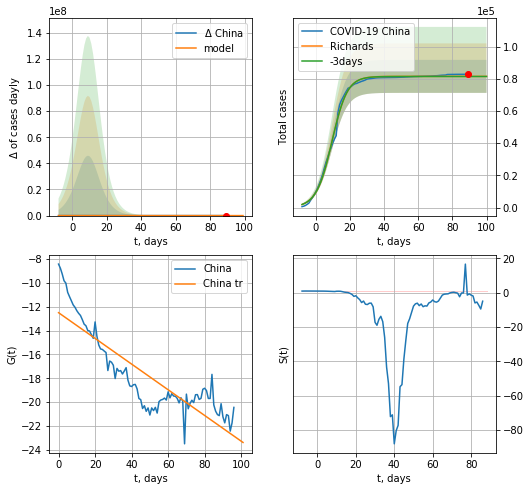

China data at: 2020-04-28
+3 day model MAPE: 0.0008735290058114092
model: Richards
coeffs:  [8.15413427e+04 2.09607336e-01 9.92268905e+00 1.07841929e+00]
rational stdev:  0.12570336979394098
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  81541 ± 10250
	 total death:  4559 ± 1719
trend coefficient of determination: 0.754628
 intercept: -12.492319
 slope: -0.107909


In [190]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

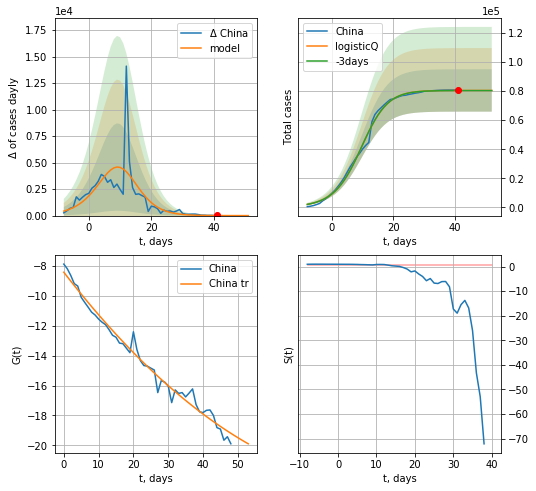

China data at: 2020-04-28
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 80416 ± 14556
	 total death: 4496 ± 2441
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


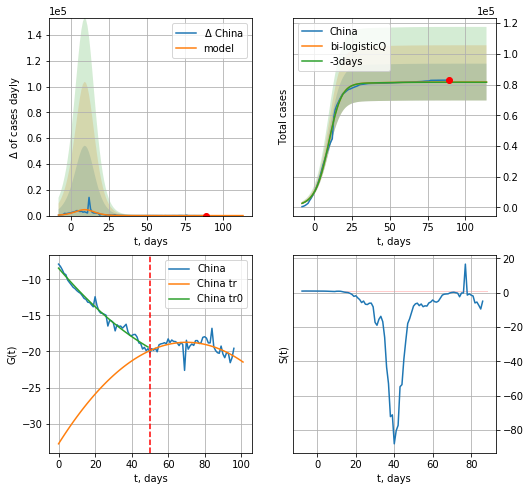

China data at: 2020-04-28
+3 day model MAPE: 0.0010420700547349368
model: bi-logisticQ
coeffs:  [1.17439008e+03 9.23009237e-04 2.50444627e+01 7.81234459e-03] [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev:  0.1466618713706715
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  81591 ± 11966
	 total death:  4562 ± 2007
bi-logistic approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.283826
 intercept_: -32.797230562937266
 coeffs_: [ 0.          0.40148746 -0.00286384]


In [191]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [192]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date    cases  active  death
69 2020-04-24  10718.0  1843.0  240.0
70 2020-04-25  10728.0  1769.0  242.0
71 2020-04-26  10738.0  1731.0  243.0
72 2020-04-27  10752.0  1654.0  244.0
73 2020-04-28  10761.0  1593.0  246.0


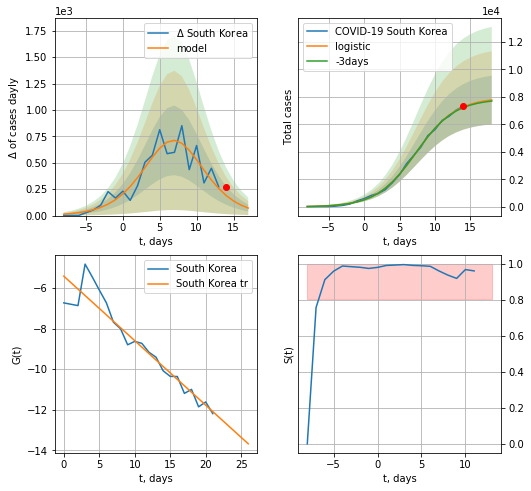

South Korea data at: 2020-04-28
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +4 days
	 deltaDaycases:  71
	 total cases:  7771 ± 1768
	 total death:  177 ± 120
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


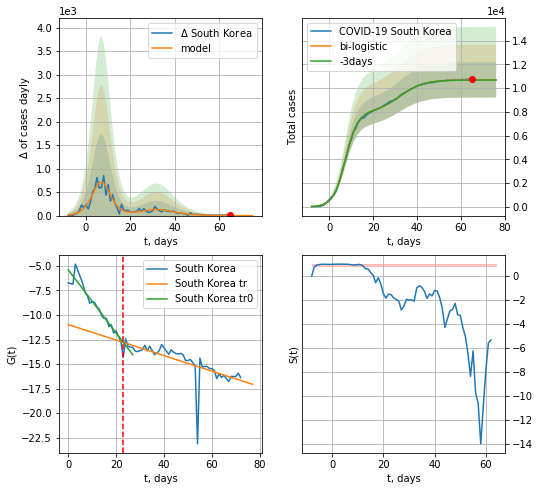

South Korea data at: 2020-04-28
+3 day model MAPE: 0.0014773859065537376
model: bi-logistic
coeffs:  [2.75354359e+03 1.85807075e-01 3.21697335e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13890629017442163
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  10693 ± 1485
	 total death:  244 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.468183
 intercept: -10.974943
 slope: -0.079007


In [193]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,5*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,6*7-dT,x,1.0,vL=23)

In [194]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

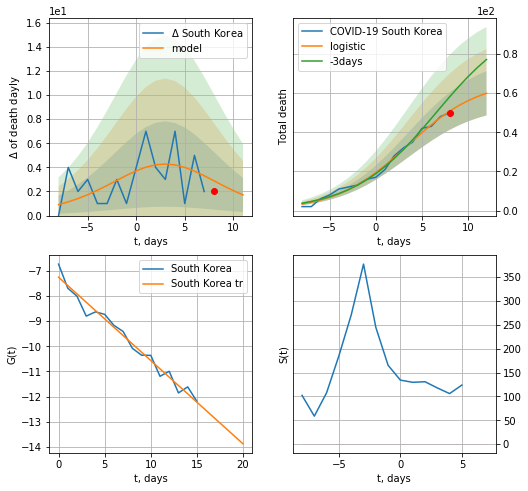

South Korea data at: 2020-04-28
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +4 days
	 total death:  59 ± 11
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


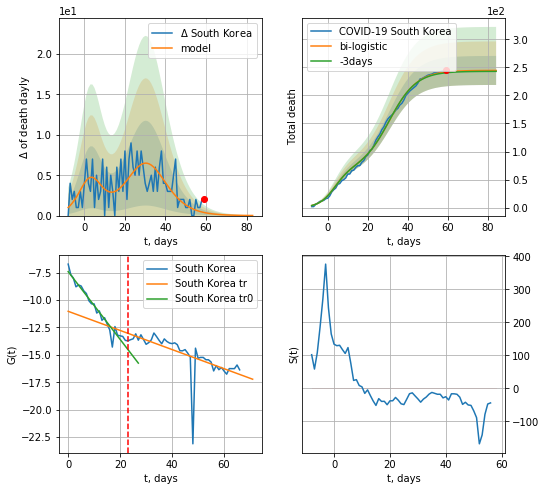

South Korea data at: 2020-04-28
+3 day model MAPE: 0.005913072199758003
model: bi-logistic
coeffs:  [1.77967383e+02 1.45822704e-01 3.08242195e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10569477819272495
forecast at the end of period: +25 days
	 deltaDaydeath:  0
	 total death:  244 ± 25
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.433865
 intercept: -11.033781
 slope: -0.087184


In [195]:
x = forecast('South Korea',dfKR[6:23],d1,5*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


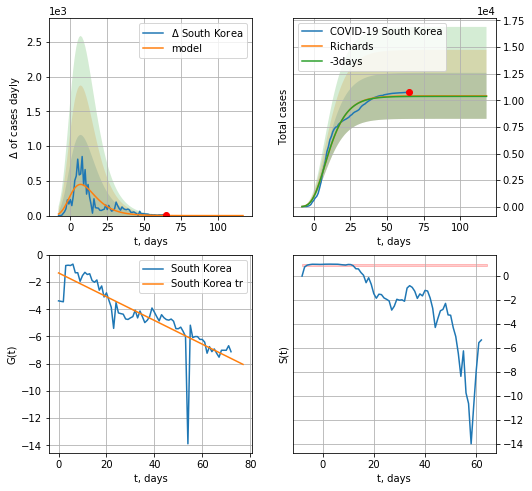

South Korea data at: 2020-04-28
+3 day model MAPE: 0.004680867111583181
model: Richards
coeffs:  [ 1.04168854e+04  3.00463177e+01 -3.97313967e+01  3.91286876e-03]
rational stdev:  0.20706290364448224
forecast at the end of period: +53 days
	 deltaDaycases:  0
	 total cases:  10416 ± 2156
	 total death:  238 ± 147
trend coefficient of determination: 0.711462
 intercept: -1.326422
 slope: -0.087352


In [196]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


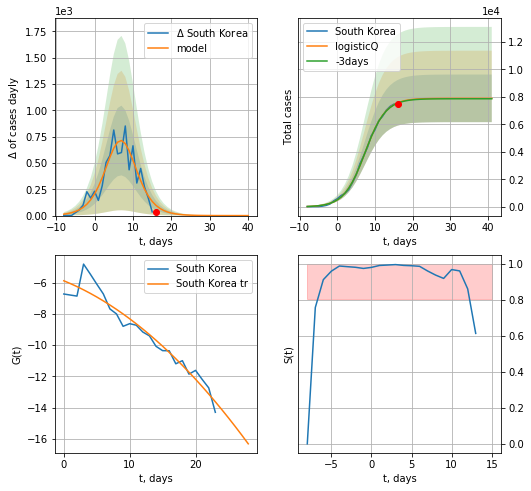

South Korea data at: 2020-04-28
+3 day model MAPE: 0.003361
model: logisticQ
coeffs: [ 7.90013984e+03  8.06152941e-05  7.33800031e+00 -4.48711989e+03]
rational stdev: 0.219238
forecast at the end of period: +25 days
	 deltaDaycases: 0
	 total cases: 7900 ± 1732
	 total death: 180 ± 118
trend coefficient of determination: 0.934689
 intercept_: -5.890495861491463
 coeffs_: [ 0.         -0.17096071 -0.00718004]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


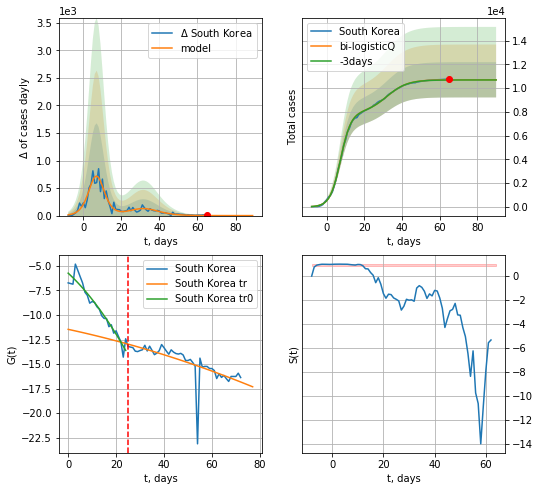

South Korea data at: 2020-04-28
+3 day model MAPE: 0.0014223834120417542
model: bi-logisticQ
coeffs:  [ 2.79799025e+03  2.10109543e-06  3.19833647e+01 -8.66199555e+04] [ 7.90013984e+03  8.06152941e-05  7.33800031e+00 -4.48711989e+03]
rational stdev:  0.13859882573251778
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  10698 ± 1482
	 total death:  244 ± 101
bi-logistic approximation splitting point: 25
trend coefficient of determination: 0.925965
 intercept_: -5.745633553515705
 coeffs_: [ 0.         -0.22458651 -0.00428776]
trend coefficient of determination: 0.465762
 intercept_: -11.464503182093653
 coeffs_: [ 0.         -0.05255548 -0.0003032 ]


In [197]:
vL=25
x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


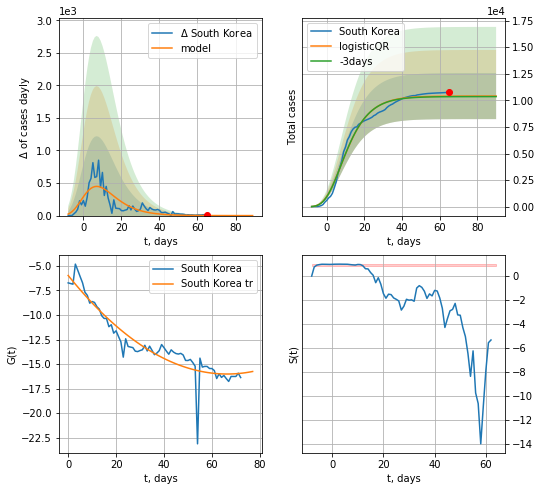

South Korea data at: 2020-04-28
+3 day model MAPE: 0.00473320664891718
model: logisticQR
coeffs:  [ 1.04089341e+04  1.71609805e-01 -6.43442058e+01 -2.30986716e+03
  2.85946881e-04]
rational stdev:  0.20814073782087114
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  10408 ± 2166
	 total death:  237 ± 147
trend coefficient of determination: 0.868580
 intercept_: -5.97951821807411
 coeffs_: [ 0.         -0.30235526  0.00227834]


In [198]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
          date  cases  active  death
92 2020-04-24  12075   11107   12.0
93 2020-04-25  12693   11679   12.0
94 2020-04-26  13624   12552   12.0
95 2020-04-27  14423   13314   14.0
96 2020-04-28  14951   13809   14.0


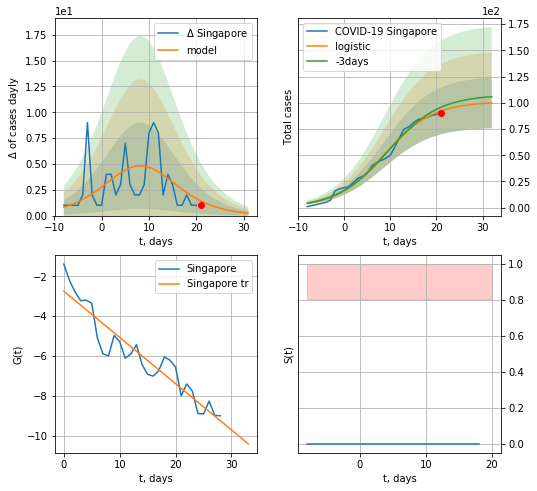

Singapore data at: 2020-04-28
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  99 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


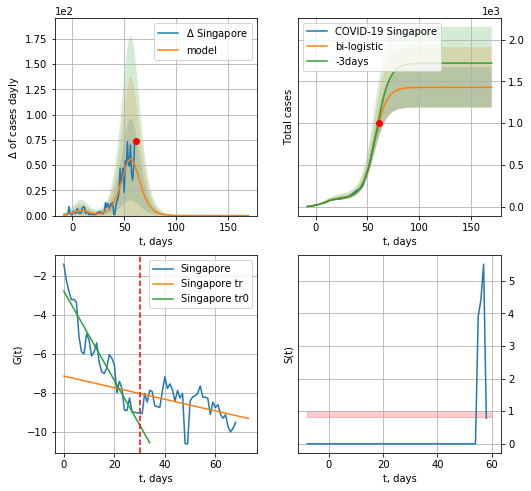

Singapore data at: 2020-04-28
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +109 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


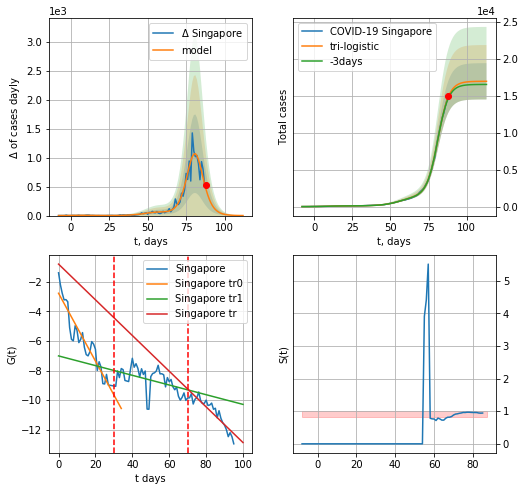

Singapore data at: 2020-04-28
+3 day model MAPE: 0.015637536711565564
model: tri-logistic
coeffs:  [1.55571365e+04 2.74537293e-01 8.11913697e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14473461343981978
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  16982 ± 2457
	 total death:  15 ± 6
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.846808
 intercept: -0.799862
 slope: -0.120718


In [199]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


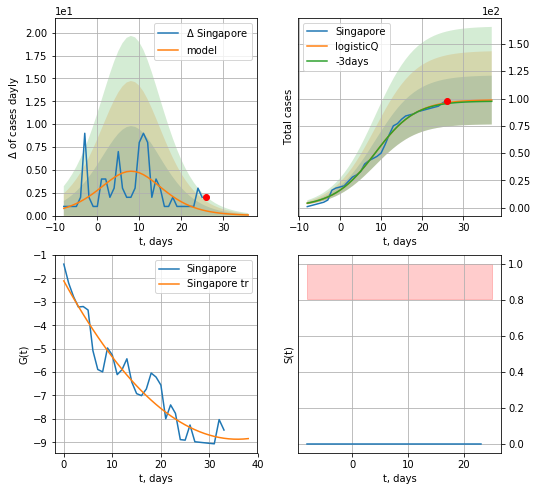

Singapore data at: 2020-04-28
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp


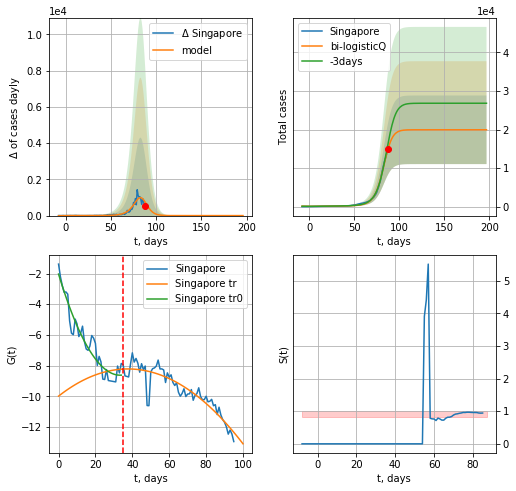

Singapore data at: 2020-04-28
+3 day model MAPE: 0.11284785207617222
model: bi-logisticQ
coeffs:  [ 1.98290371e+04  1.57402520e-03  8.22588942e+01 -4.42152737e+01] [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.44642730920395773
forecast at the end of period: +109 days
	 deltaDaycases:  0
	 total cases:  19927 ± 8896
	 total death:  18 ± 24
bi-logistic approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.828586
 intercept_: -9.99432840339151
 coeffs_: [ 0.          0.09429894 -0.00125376]


In [200]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [201]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


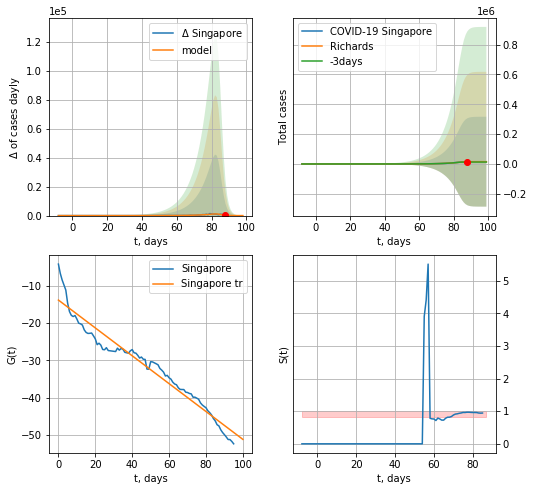

Singapore data at: 2020-04-28
+3 day model MAPE: 0.17067003385825694
model: Richards
coeffs:  [1.52640087e+04 1.26243810e-01 8.53405107e+01 5.09910531e+00]
rational stdev:  19.724006125699233
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  15263 ± 301058
	 total death:  14 ± 828
trend coefficient of determination: 0.945326
 intercept: -13.858328
 slope: -0.373142


In [202]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

In [179]:
#trend3(dfLT,dfES,dfLV[:],'LT','ES','LV',40,40,40)
#x = forecastRRR('Singapore',dfSG[35:],d1,6*7-dT,1.0)

In [180]:
#+1932/2944.#2020-04-03
#shift = 1.0#1+1849/1900.#2020-04-02
#shift = 1.+3288./2809
#x =forecast('Lithuania',dfLT[:],d1,8*7-dT,shift,addpred=True,xcoef=[0.25,1.,3.])
#xx =forecast2('Lithuania',dfLT[:],d1,3*7-dT,x)

In [181]:
#x =forecastR('Lithuania',dfLT[:],d1,7*6-dT,shift)

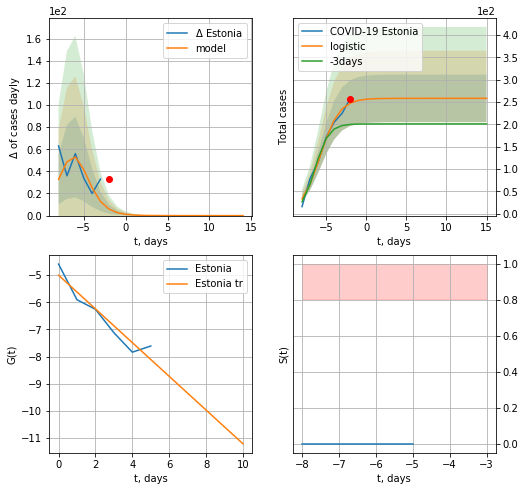

Estonia data at: 2020-04-28
+3 day model MAPE: 0.26329059885154926
model: logistic
coeffs:  [258.51169182   0.83984365  -5.73516243]
rational stdev:  0.20630354623999803
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  258 ± 53
	 total death:  7 ± 4
trend coefficient of determination: 0.908255
 intercept: -5.002820
 slope: -0.620580


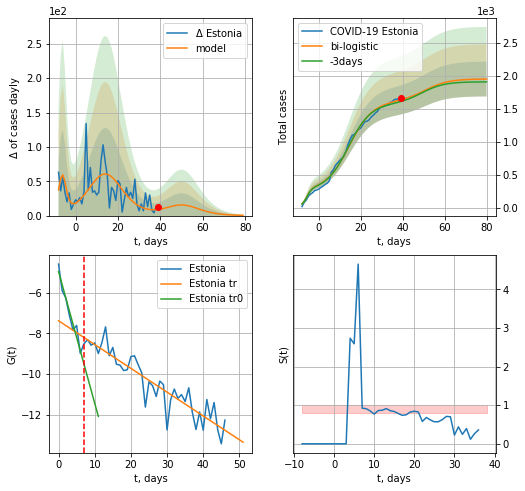

Estonia data at: 2020-04-28
+3 day model MAPE: 0.015265633441200842
model: bi-logistic
coeffs:  [1.35324815e+03 1.79182100e-01 1.45002502e+01] [258.51169182   0.83984365  -5.73516243]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.13513420563044384
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1948 ± 263
	 total death:  58 ± 23
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.942621
 intercept: -4.958003
 slope: -0.647470
trend coefficient of determination: 0.832174
 intercept: -7.379626
 slope: -0.116979


In [203]:
shift = 1.0
x = forecast('Estonia',dfES[:7],d1,17,1.)
xx = forecast2('Estonia',dfES[:],d1,12*6-dT,x,1.,addpred=True,xcoef=[0.25,1.,3.5],vL=7)

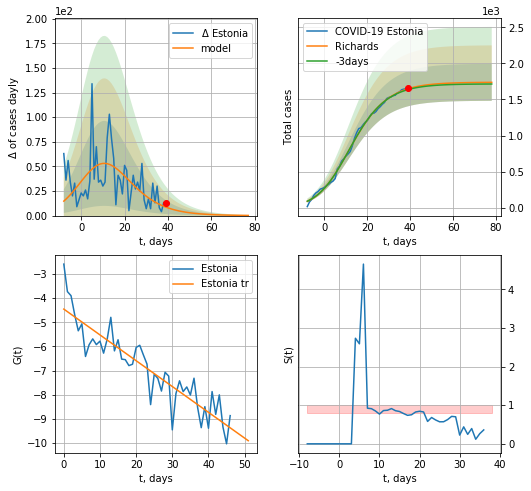

Estonia data at: 2020-04-28
+3 day model MAPE: 0.007401107439514446
model: Richards
coeffs:  [1.73881562e+03 1.93313281e-01 5.25516076e+00 5.41279260e-01]
rational stdev:  0.14737135483995198
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  1737 ± 256
	 total death:  52 ± 22
trend coefficient of determination: 0.816748
 intercept: -4.453230
 slope: -0.106817


In [204]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


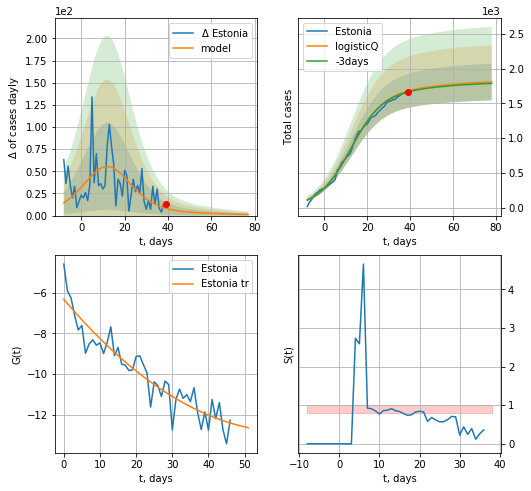

Estonia data at: 2020-04-28
+3 day model MAPE: 0.008906
model: logisticQ
coeffs: [ 1.68007615e+03  3.78105491e-06  1.24097894e+01 -3.44659670e+04]
scenario coeffs: [0.0875, 0.5, 4.0, 1]
rational stdev: 0.145952
forecast at the end of period: +39 days
	 deltaDaycases: 1
	 total cases: 1806 ± 263
	 total death: 54 ± 23
trend coefficient of determination: 0.876657
 intercept_: -6.324950630761978
 coeffs_: [ 0.         -0.2098436   0.00168983]


In [205]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
48 2020-04-24  784.0   505.0   12.0
49 2020-04-25  804.0   525.0   12.0
50 2020-04-26  812.0   533.0   12.0
51 2020-04-27  818.0   538.0   13.0
52 2020-04-28  836.0   556.0   13.0


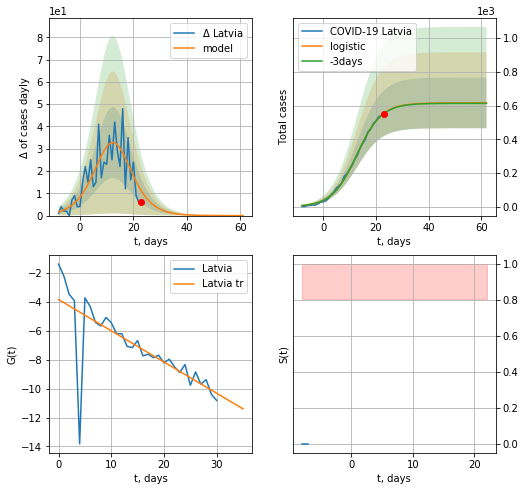

Latvia data at: 2020-04-28
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  9 ± 6
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


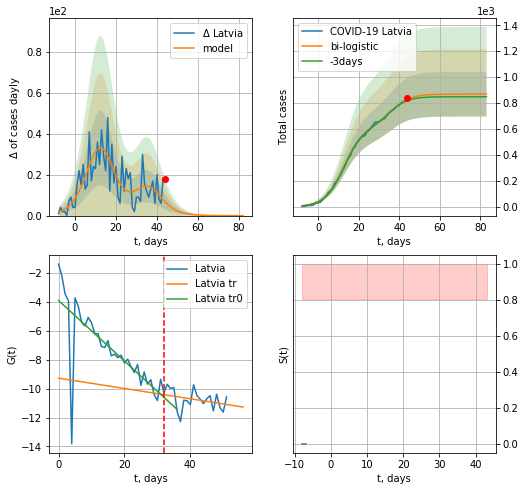

Latvia data at: 2020-04-28
+3 day model MAPE: 0.0128353896108942
model: bi-logistic
coeffs:  [2.52560800e+02 2.14831432e-01 3.60969749e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.19904571514361558
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  868 ± 172
	 total death:  13 ± 7
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.094795
 intercept: -9.274326
 slope: -0.035645


In [206]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


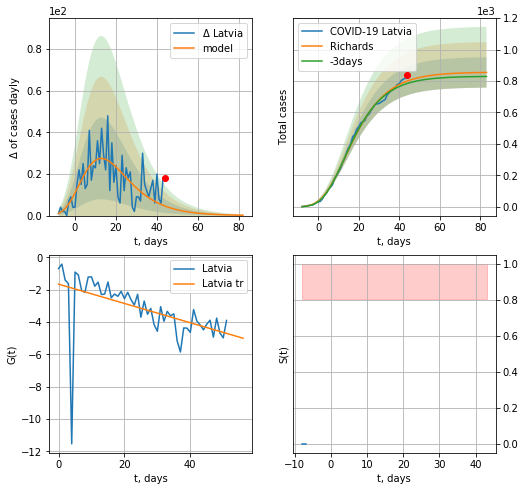

Latvia data at: 2020-04-28
+3 day model MAPE: 0.020573160147303718
model: Richards
coeffs:  [ 8.56547791e+02  8.70553979e+00 -3.91222421e+01  1.00732993e-02]
rational stdev:  0.11303570659478426
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  854 ± 96
	 total death:  13 ± 4
trend coefficient of determination: 0.264309
 intercept: -1.662725
 slope: -0.059688


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


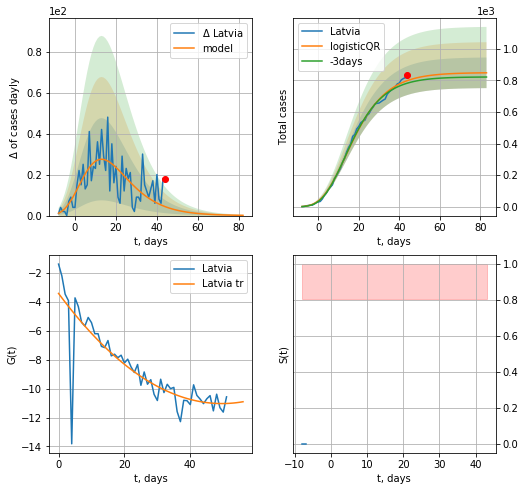

Latvia data at: 2020-04-28
+3 day model MAPE: 0.0216564382765251
model: logisticQR
coeffs:  [ 8.49528303e+02  4.65077318e-02 -6.38521865e+01 -8.86266516e+02
  1.93790796e-03]
rational stdev:  0.11423098328421753
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  848 ± 96
	 total death:  13 ± 4
trend coefficient of determination: 0.723471
 intercept_: -3.414653960497228
 coeffs_: [ 0.         -0.30701881  0.00309379]


In [207]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


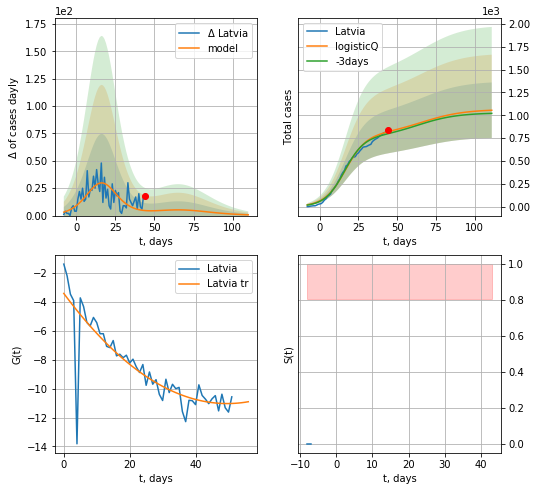

Latvia data at: 2020-04-28
+3 day model MAPE: 0.026551
model: logisticQ
coeffs: [ 7.88357794e+02  1.12091472e-06  1.65981372e+01 -1.33091696e+05]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.287996
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 1054 ± 303
	 total death: 16 ± 13
trend coefficient of determination: 0.723471
 intercept_: -3.414653960497228
 coeffs_: [ 0.         -0.30701881  0.00309379]


In [208]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=[.35,.5,4.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


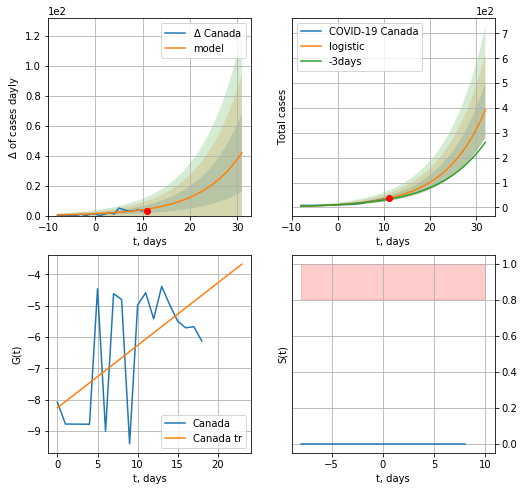

Canada data at: 2020-04-28
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  22 ± 18
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


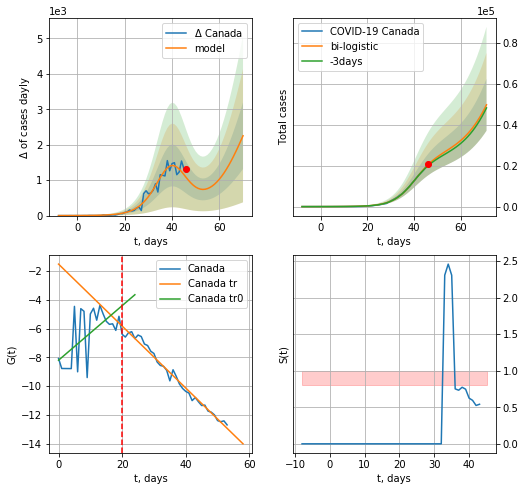

Canada data at: 2020-04-28
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +25 days
	 deltaDaycases:  2253
	 total cases:  49839 ± 12705
	 total death:  2848 ± 2178
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


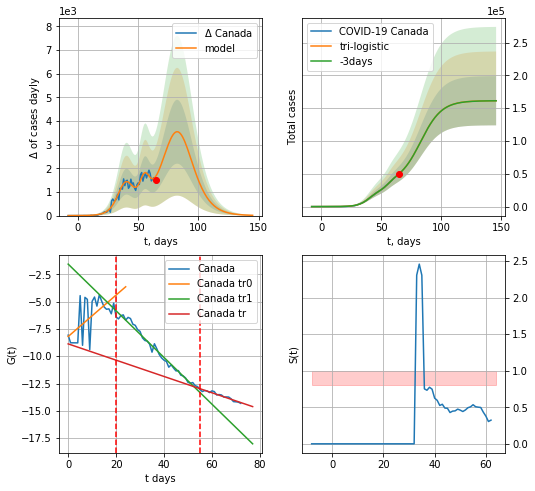

Canada data at: 2020-04-28
+3 day model MAPE: 0.001524877984003851
model: tri-logistic
coeffs:  [1.20574560e+04 3.45555148e-01 5.59012778e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.23238867020360263
forecast at the end of period: +81 days
	 deltaDaycases:  11
	 total cases:  161314 ± 37487
	 total death:  9219 ± 6427
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.937269
 intercept: -8.871392
 slope: -0.074522


In [209]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
69 2020-04-24  43888.0   26117  2302.0
70 2020-04-25  45354.0   26464  2465.0
71 2020-04-26  46895.0   27014  2560.0
72 2020-04-27  48500.0   27525  2707.0
73 2020-04-28  50026.0   27977  2859.0


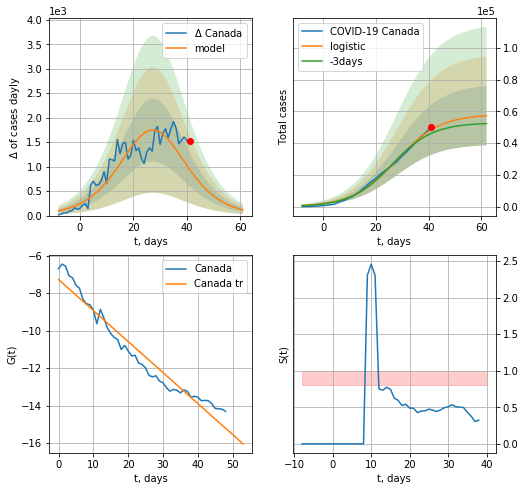

Canada data at: 2020-04-28
+3 day model MAPE: 0.05213086694535271
model: logistic
coeffs:  [5.82139042e+04 1.20218151e-01 2.77835268e+01]
rational stdev:  0.325047360117236
forecast at the end of period: +21 days
	 deltaDaycases:  117
	 total cases:  57277 ± 18617
	 total death:  3273 ± 3191
trend coefficient of determination: 0.947913
 intercept: -7.270556
 slope: -0.165553


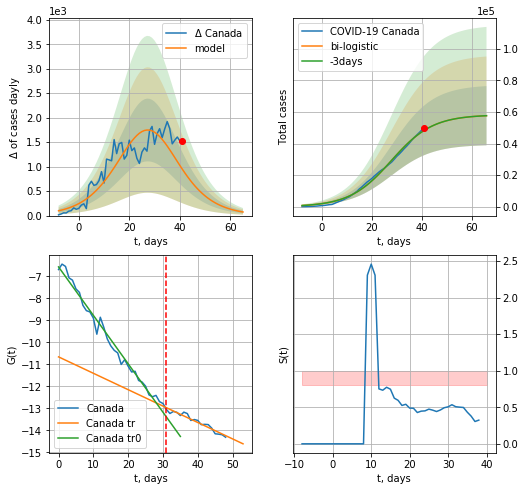

Canada data at: 2020-04-28
+3 day model MAPE: 0.0
model: bi-logistic
coeffs:  [177.66962481  -1.02359225 -40.46040389] [5.82139042e+04 1.20218151e-01 2.77835268e+01]
rational stdev:  0.325047360117236
forecast at the end of period: +25 days
	 deltaDaycases:  73
	 total cases:  57631 ± 18732
	 total death:  3293 ± 3211
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.937269
 intercept: -10.659921
 slope: -0.074522


In [210]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,3*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,8*7-dT,x,1.,vL=31,cases='cases')

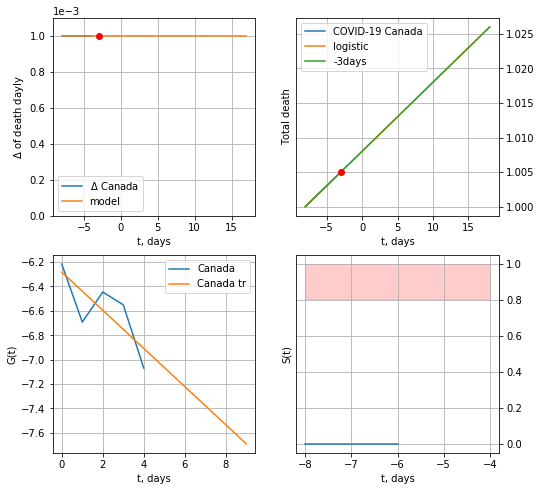

Canada data at: 2020-04-28
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


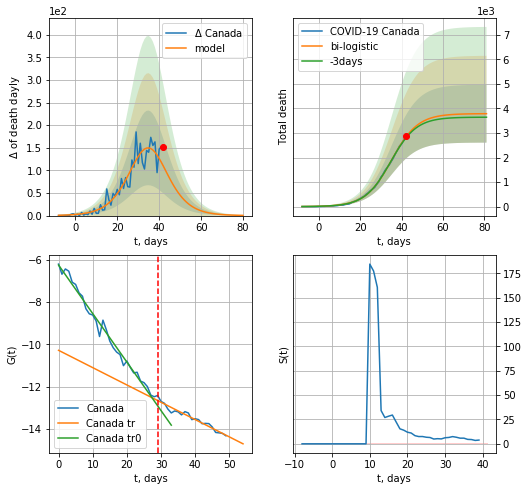

Canada data at: 2020-04-28
+3 day model MAPE: 0.016207330468619795
model: bi-logistic
coeffs:  [3.78918111e+03 1.58179675e-01 3.52112712e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3112933021081304
forecast at the end of period: +39 days
	 deltaDaydeath:  0
	 total death:  3787 ± 1179
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.950194
 intercept: -10.280714
 slope: -0.081623


In [211]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


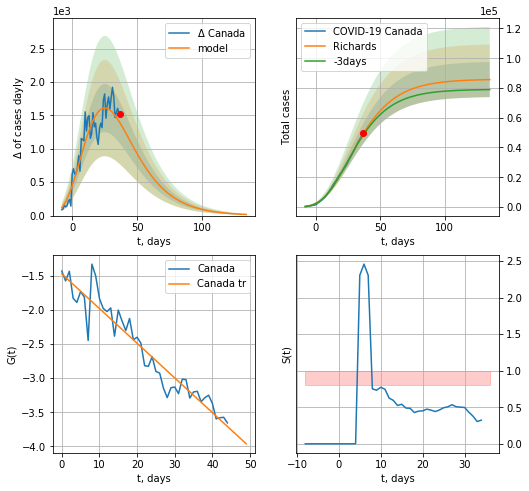

Canada data at: 2020-04-28
+3 day model MAPE: 0.020658906527699944
model: Richards
coeffs:  [ 8.59598106e+04  3.37100688e+00 -5.60587693e+01  1.52094764e-02]
rational stdev:  0.13783830628591046
forecast at the end of period: +98 days
	 deltaDaycases:  16
	 total cases:  85645 ± 11805
	 total death:  4894 ± 2023
trend coefficient of determination: 0.915096
 intercept: -1.473411
 slope: -0.050762


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


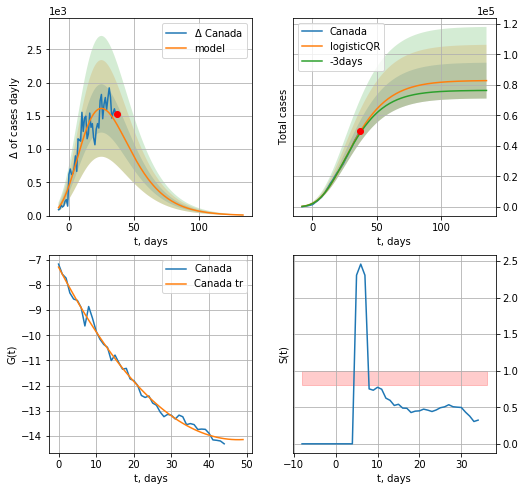

Canada data at: 2020-04-28
+3 day model MAPE: 0.021427032142275537
model: logisticQR
coeffs:  [ 8.29335464e+04  1.35166719e-02 -9.44875360e+01 -9.01688493e+02
  3.74174655e-03]
rational stdev:  0.1417142824686548
forecast at the end of period: +98 days
	 deltaDaycases:  8
	 total cases:  82801 ± 11734
	 total death:  4732 ± 2011
trend coefficient of determination: 0.992788
 intercept_: -7.292257162561566
 coeffs_: [ 0.         -0.28738173  0.0030123 ]


In [212]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


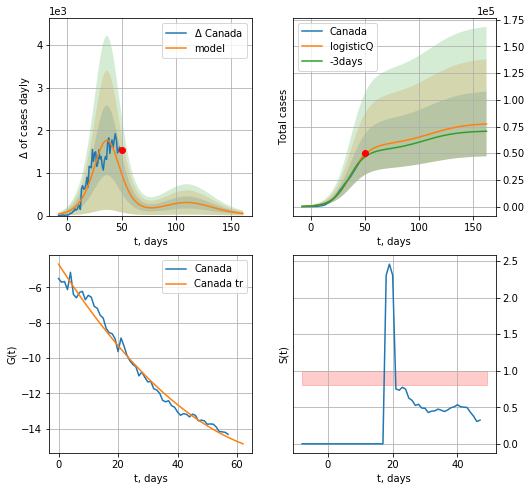

Canada data at: 2020-04-28
+3 day model MAPE: 0.052196
model: logisticQ
coeffs: [ 5.79579713e+04  1.88299514e-06  3.66957160e+01 -6.41732922e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.391171
forecast at the end of period: +112 days
	 deltaDaycases: 50
	 total cases: 77405 ± 30278
	 total death: 4423 ± 5190
trend coefficient of determination: 0.984111
 intercept_: -4.6804717091743315
 coeffs_: [ 0.         -0.26229339  0.00158553]


In [213]:
x = forecastRRR('Canada',dfCA[15:],d1,7*16,1.,addpred=True,xcoef=[0.35,.5,3,1])

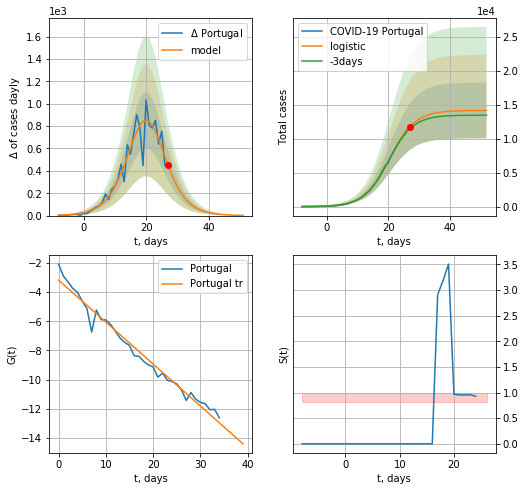

Portugal data at: 2020-04-28
+3 day model MAPE: 0.02892624169663467
model: logistic
coeffs:  [1.41442510e+04 2.41786786e-01 2.05224861e+01]
rational stdev:  0.2898390257045352
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  14137 ± 4097
	 total death:  551 ± 479
trend coefficient of determination: 0.976589
 intercept: -3.176863
 slope: -0.287805


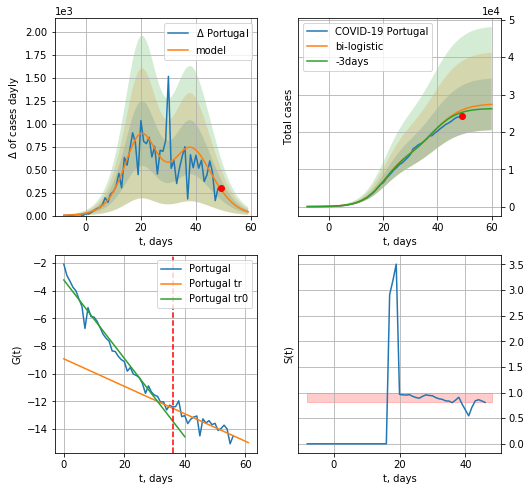

Portugal data at: 2020-04-28
+3 day model MAPE: 0.027558815283351266
model: bi-logistic
coeffs:  [1.07079901e+04 2.32513287e-01 3.81717272e+01] [1.41442510e+04 2.41786786e-01 2.05224861e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.2526683674964289
forecast at the end of period: +11 days
	 deltaDaycases:  41
	 total cases:  27366 ± 6914
	 total death:  1066 ± 808
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975280
 intercept: -3.225895
 slope: -0.283479
trend coefficient of determination: 0.687511
 intercept: -8.931869
 slope: -0.099314


In [214]:
vL = 36
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


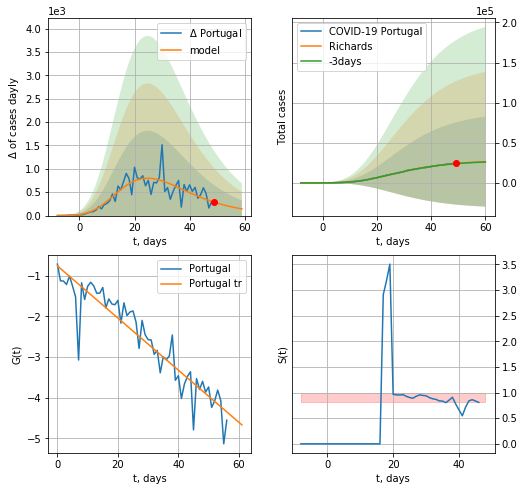

Portugal data at: 2020-04-28
+3 day model MAPE: 0.01097158103275643
model: Richards
coeffs:  [ 2.82451728e+04  5.59895487e+00 -3.00473338e+01  1.38335545e-02]
rational stdev:  2.1219234910881966
forecast at the end of period: +11 days
	 deltaDaycases:  143
	 total cases:  26399 ± 56016
	 total death:  1028 ± 6544
trend coefficient of determination: 0.866449
 intercept: -0.757470
 slope: -0.064102


In [215]:
x = forecastRR('Portugal',dfPT[:],d1,6*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


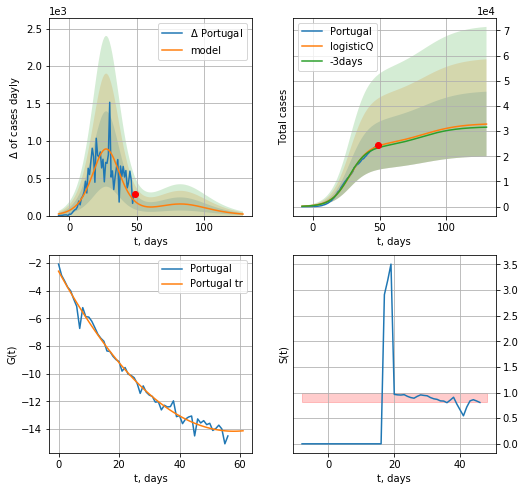

Portugal data at: 2020-04-28
+3 day model MAPE: 0.030426
model: logisticQ
coeffs: [ 2.44901106e+04  1.62759820e-06  2.77645453e+01 -8.84392899e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.392554
forecast at the end of period: +81 days
	 deltaDaycases: 20
	 total cases: 32775 ± 12866
	 total death: 1277 ± 1503
trend coefficient of determination: 0.988998
 intercept_: -2.5930313956396036
 coeffs_: [ 0.         -0.39951861  0.00344673]


In [216]:
x = forecastRRR('Portugal',dfPT[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1])

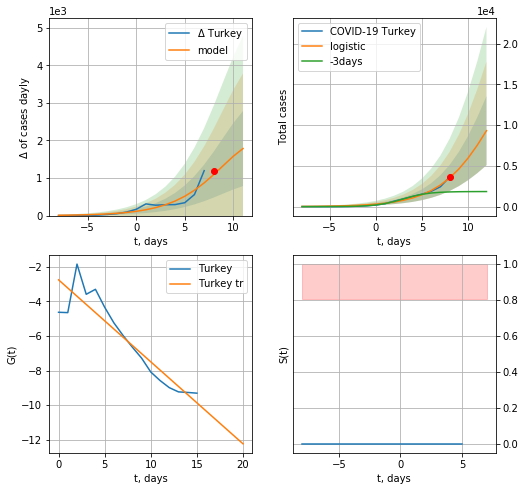

Turkey data at: 2020-04-28
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +4 days
	 deltaDaycases:  1785
	 total cases:  9315 ± 4240
	 total death:  243 ± 331
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


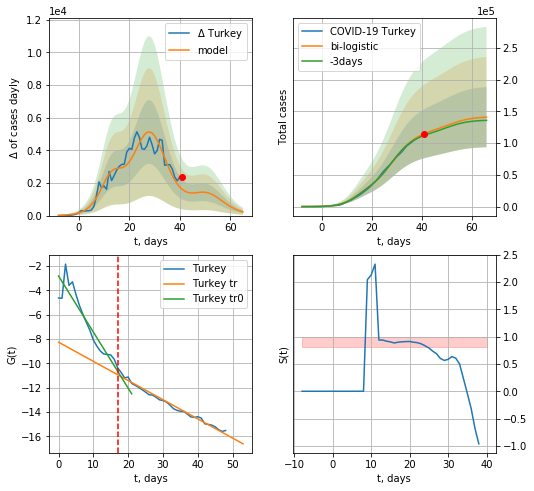

Turkey data at: 2020-04-28
+3 day model MAPE: 0.024875360726124413
model: bi-logistic
coeffs:  [9.41622078e+04 2.13984350e-01 2.84499573e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.33625759981680764
forecast at the end of period: +25 days
	 deltaDaycases:  223
	 total cases:  140985 ± 47407
	 total death:  3679 ± 3711
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.984103
 intercept: -8.256251
 slope: -0.157696


In [217]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,5*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


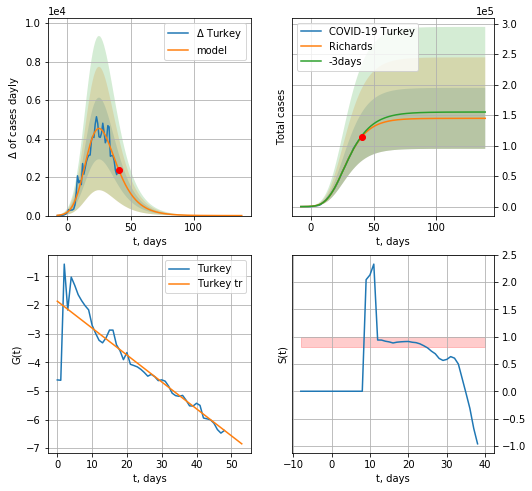

Turkey data at: 2020-04-28
+3 day model MAPE: 0.01718063727192416
model: Richards
coeffs:  [1.44752571e+05 4.36158215e-01 9.16871866e+00 2.15740233e-01]
rational stdev:  0.34527733314220194
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  144749 ± 49978
	 total death:  3777 ± 3912
trend coefficient of determination: 0.796217
 intercept: -1.869483
 slope: -0.093917


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


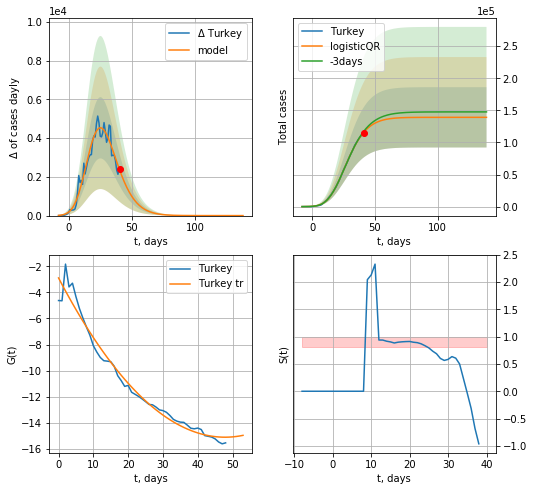

Turkey data at: 2020-04-28
+3 day model MAPE: 0.015221721696399649
model: logisticQR
coeffs:  [ 1.39110729e+05  2.00516740e-02 -5.68769701e+01 -5.68691694e+01
  2.74190639e-02]
rational stdev:  0.3376390613703389
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  139110 ± 46969
	 total death:  3630 ± 3676
trend coefficient of determination: 0.974402
 intercept_: -2.8969309807929626
 coeffs_: [ 0.         -0.50966789  0.00532729]


In [218]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


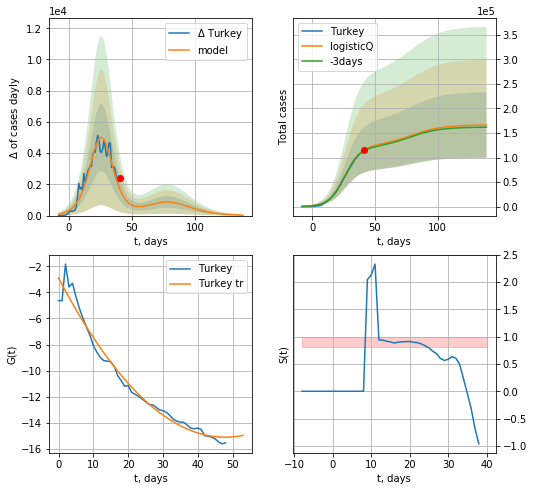

Turkey data at: 2020-04-28
+3 day model MAPE: 0.017739
model: logisticQ
coeffs: [ 1.23370048e+05  3.89240485e-06  2.62414851e+01 -4.13059926e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.401158
forecast at the end of period: +98 days
	 deltaDaycases: 27
	 total cases: 166218 ± 66679
	 total death: 4337 ± 5219
trend coefficient of determination: 0.974402
 intercept_: -2.8969309807929626
 coeffs_: [ 0.         -0.50966789  0.00532729]


In [219]:
x = forecastRRR('Turkey',dfTR[:],d1,14*7,1.,addpred=True,xcoef=[0.35,.5,3,1])

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [220]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.01555023923444976

In [221]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

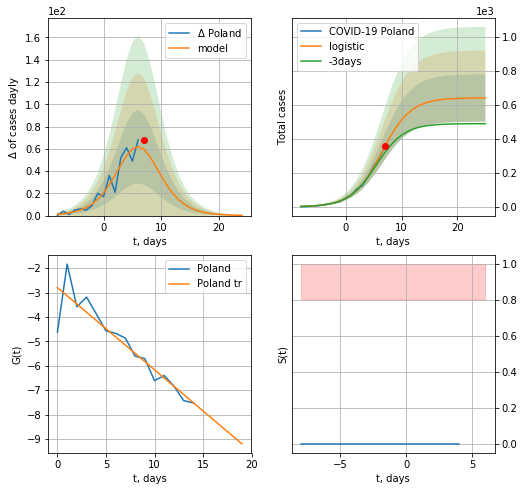

Poland data at: 2020-04-28
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  640 ± 139
	 total death:  31 ± 20
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


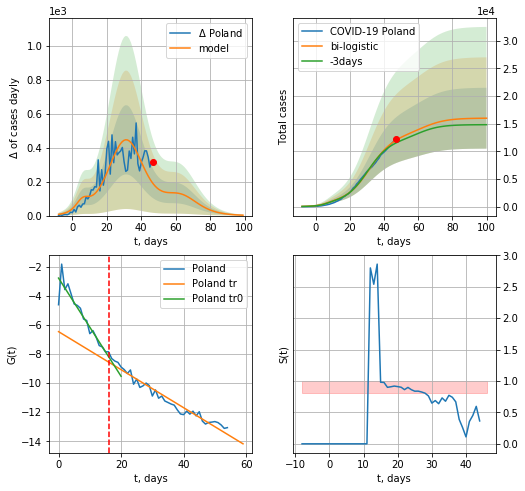

Poland data at: 2020-04-28
+3 day model MAPE: 0.04489801447664953
model: bi-logistic
coeffs:  [1.22941891e+04 1.43730000e-01 3.15716847e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34428057547146007
forecast at the end of period: +53 days
	 deltaDaycases:  2
	 total cases:  15992 ± 5506
	 total death:  780 ± 805
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.954217
 intercept: -6.473072
 slope: -0.130562


In [222]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


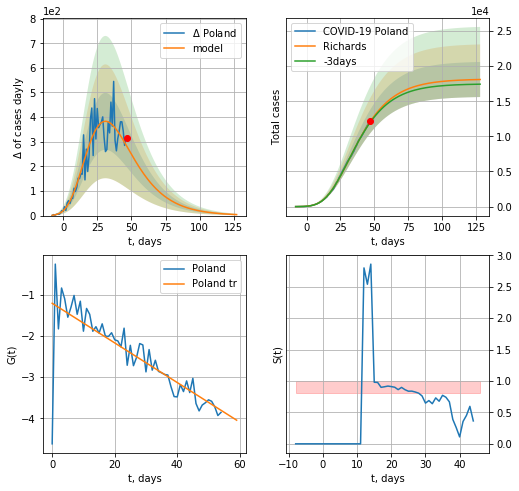

Poland data at: 2020-04-28
+3 day model MAPE: 0.010877408619278916
model: Richards
coeffs:  [ 1.81658137e+04  2.74808131e+00 -3.51755719e+01  2.10798938e-02]
rational stdev:  0.13792104478728254
forecast at the end of period: +81 days
	 deltaDaycases:  4
	 total cases:  18098 ± 2496
	 total death:  882 ± 364
trend coefficient of determination: 0.667131
 intercept: -1.208809
 slope: -0.048030


In [223]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


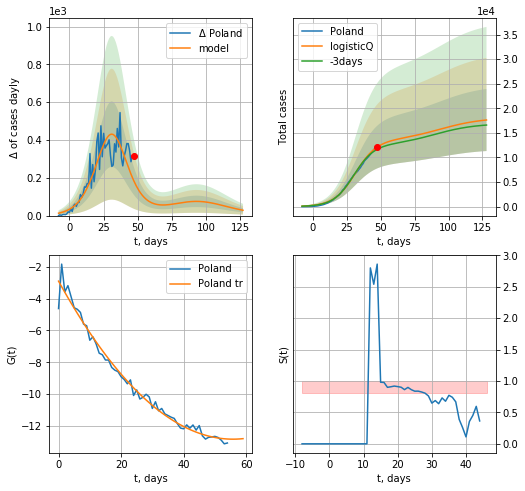

Poland data at: 2020-04-28
+3 day model MAPE: 0.040507
model: logisticQ
coeffs: [ 1.34051782e+04  2.41227820e-06  3.12986878e+01 -5.26185496e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.358197
forecast at the end of period: +81 days
	 deltaDaycases: 28
	 total cases: 17615 ± 6310
	 total death: 859 ± 923
trend coefficient of determination: 0.983104
 intercept_: -2.9047367484775197
 coeffs_: [ 0.         -0.35552079  0.00318526]


In [224]:
x =  forecastRRR('Poland',dfPL[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

IS
          date    cases  active  death
62 2020-04-24  15058.0    8861  194.0
63 2020-04-25  15298.0    8664  199.0
64 2020-04-26  15443.0    8511  201.0
65 2020-04-27  15589.0    8006  208.0
66 2020-04-28  15728.0    7772  210.0


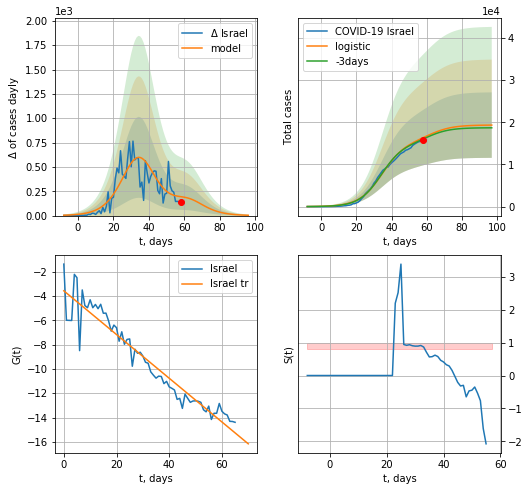

Israel data at: 2020-04-28
+3 day model MAPE: 0.020327951087975596
model: logistic
coeffs:  [1.54697769e+04 1.52644195e-01 3.46470607e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40170456513693403
forecast at the end of period: +39 days
	 deltaDaycases:  3
	 total cases:  19316 ± 7759
	 total death:  257 ± 309
trend coefficient of determination: 0.916313
 intercept: -3.581524
 slope: -0.179703


In [225]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


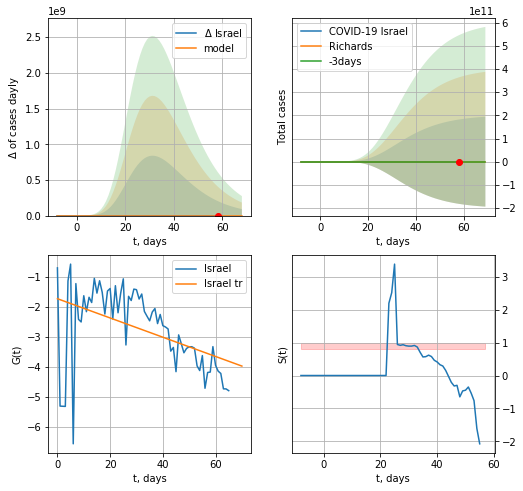

Israel data at: 2020-04-28
+3 day model MAPE: 0.012083979317942115
model: Richards
coeffs:  [ 1.71877210e+04  1.30416522e+01 -2.63340148e+01  6.62961344e-03]
rational stdev:  11742193.064178756
forecast at the end of period: +11 days
	 deltaDaycases:  59
	 total cases:  16518 ± 193967752153
	 total death:  220 ± 7749847422
trend coefficient of determination: 0.212097
 intercept: -1.726324
 slope: -0.032095


In [226]:
x = forecastRR('Israel',dfIS[:],d1,6*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


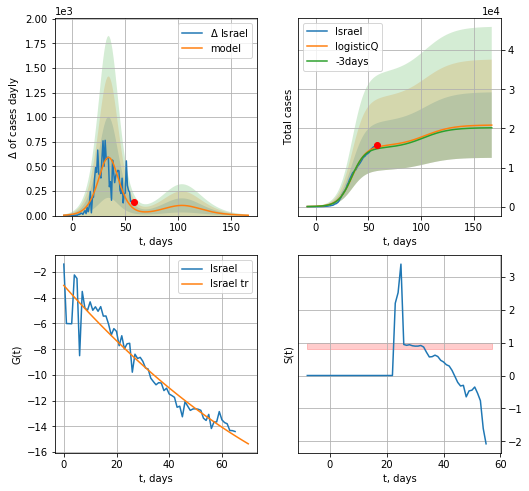

Israel data at: 2020-04-28
+3 day model MAPE: 0.028789
model: logisticQ
coeffs: [ 1.54689811e+04  1.25025916e-06  3.46466663e+01 -1.22025004e+05]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.401840
forecast at the end of period: +109 days
	 deltaDaycases: 3
	 total cases: 20839 ± 8374
	 total death: 278 ± 335
trend coefficient of determination: 0.921329
 intercept_: -3.042127477508121
 coeffs_: [ 0.         -0.23029105  0.00077843]


In [228]:
x = forecastRRR('Israel',dfIS[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


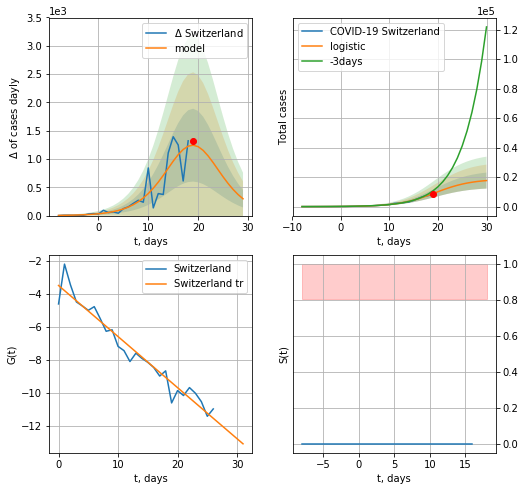

Switzerland data at: 2020-04-28
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +11 days
	 deltaDaycases:  296
	 total cases:  17658 ± 5404
	 total death:  1025 ± 941
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


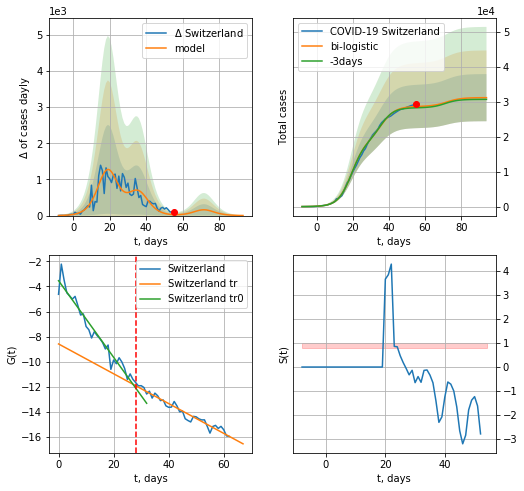

Switzerland data at: 2020-04-28
+3 day model MAPE: 0.013142791820538142
model: bi-logistic
coeffs:  [1.00134208e+04 2.57459740e-01 3.60163562e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.21651207984916265
forecast at the end of period: +39 days
	 deltaDaycases:  2
	 total cases:  31214 ± 6758
	 total death:  1812 ± 1176
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.953151
 intercept: -8.586897
 slope: -0.118964


In [229]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


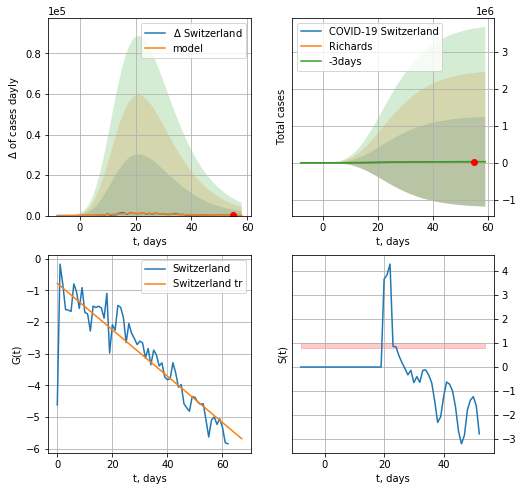

Switzerland data at: 2020-04-28
+3 day model MAPE: 0.001247341160431881
model: Richards
coeffs:  [ 3.03093911e+04  6.05184529e+00 -2.04704898e+01  1.62119747e-02]
rational stdev:  41.12280257012401
forecast at the end of period: +4 days
	 deltaDaycases:  77
	 total cases:  29550 ± 1215215
	 total death:  1715 ± 211576
trend coefficient of determination: 0.813037
 intercept: -0.777971
 slope: -0.073252


In [230]:
x = forecastRR('Switzerland',dfSZ[:],d1,7*5-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


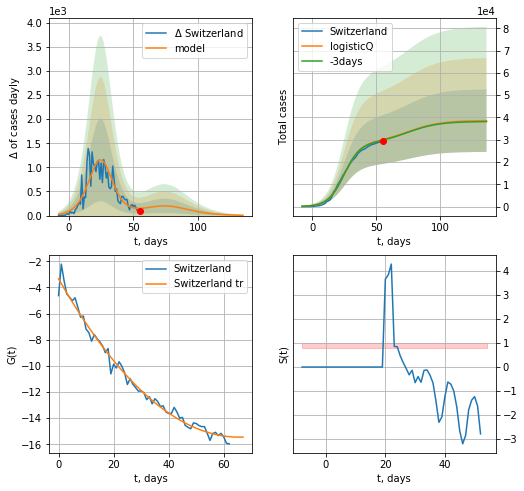

Switzerland data at: 2020-04-28
+3 day model MAPE: 0.009476
model: logisticQ
coeffs: [ 2.86259702e+04  1.35322349e-06  2.49635403e+01 -1.18107393e+05]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.363621
forecast at the end of period: +81 days
	 deltaDaycases: 6
	 total cases: 38570 ± 14024
	 total death: 2239 ± 2442
trend coefficient of determination: 0.986449
 intercept_: -3.3391259620110194
 coeffs_: [ 0.         -0.36923862  0.00281366]


In [231]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*16-dT,addpred=True,xcoef=[0.35,.5,3,1])

In [232]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date   cases  active  death
45 2020-04-24  7647.0    6853  193.0
46 2020-04-25  8125.0    7142  201.0
47 2020-04-26  8617.0    7568  209.0
48 2020-04-27  9410.0    8179  239.0
49 2020-04-28  9866.0    8513  250.0


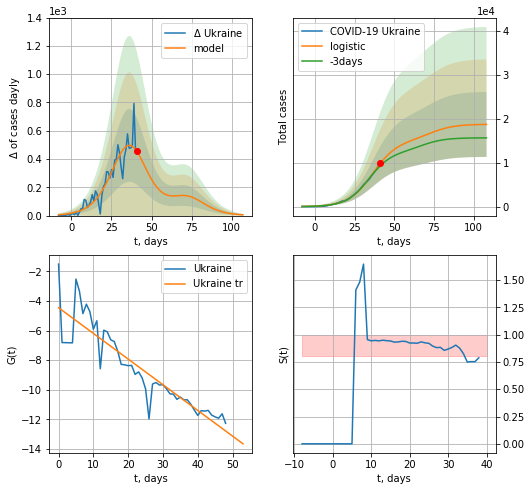

Ukraine data at: 2020-04-28
+3 day model MAPE: 0.06414437911264222
model: logistic
coeffs:  [1.50025692e+04 1.31468237e-01 3.64695522e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3953192302515975
forecast at the end of period: +67 days
	 deltaDaycases:  5
	 total cases:  18714 ± 7398
	 total death:  475 ± 563
trend coefficient of determination: 0.823210
 intercept: -4.452561
 slope: -0.173638


In [238]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:130: RuntimeWarning: invalid value encountered in true_divide


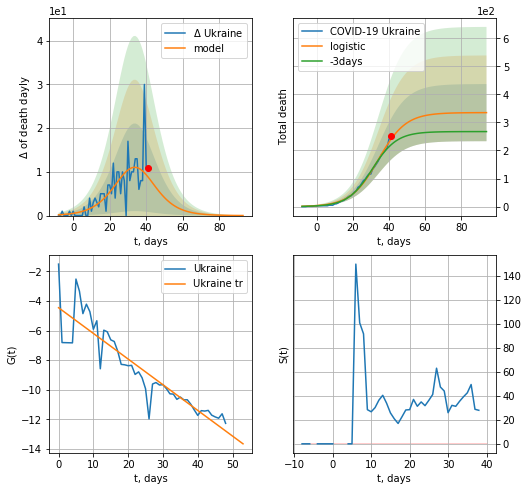

Ukraine data at: 2020-04-28
+3 day model MAPE: 0.09987635774869501
model: logistic
coeffs:  [3.35039491e+02 1.31992756e-01 3.41834678e+01]
rational stdev:  0.3040967703208334
forecast at the end of period: +53 days
	 total death:  334 ± 101
trend coefficient of determination: 0.823210
 intercept: -4.452561
 slope: -0.173638


In [239]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


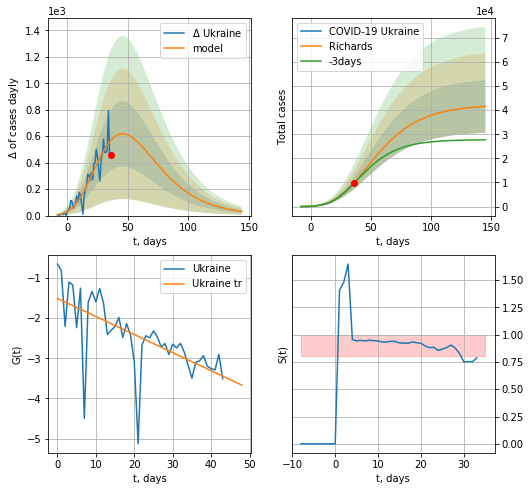

Ukraine data at: 2020-04-28
+3 day model MAPE: 0.02356958875802965
model: Richards
coeffs:  [ 4.23309289e+04  8.60480612e-01 -2.89902814e+01  4.72099633e-02]
rational stdev:  0.26402408205312516
forecast at the end of period: +109 days
	 deltaDaycases:  31
	 total cases:  41574 ± 10976
	 total death:  1055 ± 835
trend coefficient of determination: 0.418618
 intercept: -1.512774
 slope: -0.044922


In [240]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


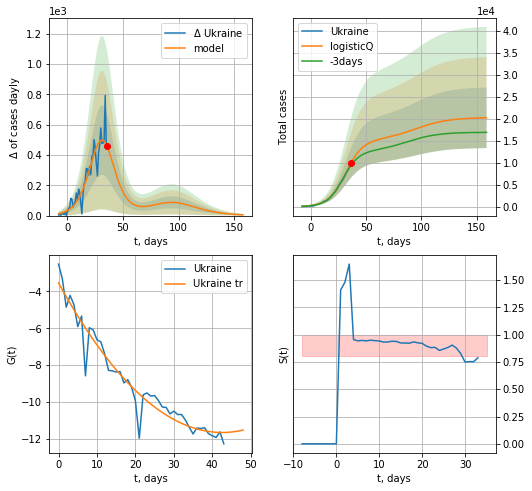

Ukraine data at: 2020-04-28
+3 day model MAPE: 0.064472
model: logisticQ
coeffs: [ 1.50210925e+04  8.37762650e-06  3.14904002e+01 -1.56526076e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.341074
forecast at the end of period: +123 days
	 deltaDaycases: 4
	 total cases: 20206 ± 6891
	 total death: 513 ± 524
trend coefficient of determination: 0.934590
 intercept_: -3.53630218403855
 coeffs_: [ 0.         -0.38155699  0.00448192]


In [243]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*22-dT,addpred=True,xcoef=[0.35,.5,3,1])

In [244]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

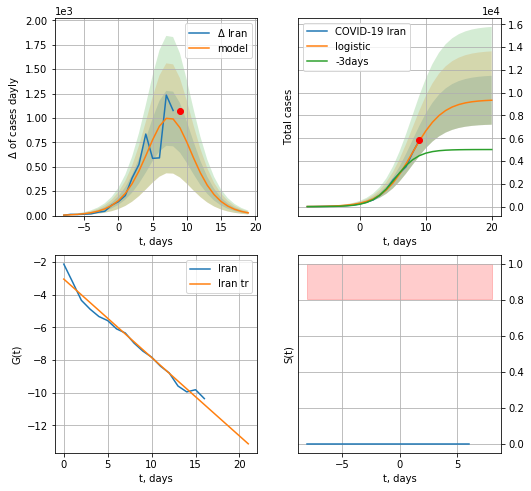

Iran data at: 2020-04-28
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +11 days
	 deltaDaycases:  27
	 total cases:  9333 ± 2144
	 total death:  592 ± 408
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


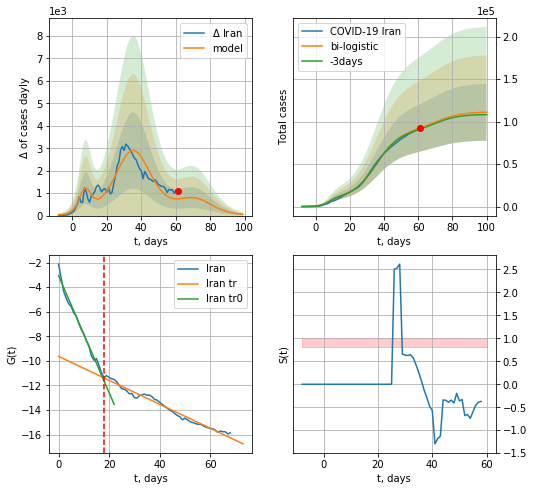

Iran data at: 2020-04-28
+3 day model MAPE: 0.017361245732565242
model: bi-logistic
coeffs:  [8.15664480e+04 1.41423716e-01 3.56859005e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30183186887742314
forecast at the end of period: +39 days
	 deltaDaycases:  53
	 total cases:  110984 ± 33498
	 total death:  7045 ± 6379
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.978727
 intercept: -9.631350
 slope: -0.097587


In [245]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


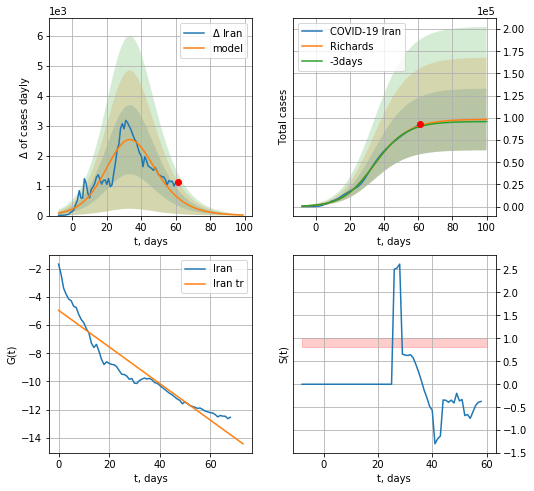

Iran data at: 2020-04-28
+3 day model MAPE: 0.012620330421585184
model: Richards
coeffs:  [9.84042755e+04 1.32336041e-01 3.02118180e+01 7.10743719e-01]
rational stdev:  0.35376852709413503
forecast at the end of period: +39 days
	 deltaDaycases:  19
	 total cases:  98209 ± 34743
	 total death:  6234 ± 6616
trend coefficient of determination: 0.879765
 intercept: -4.938893
 slope: -0.130087


In [246]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


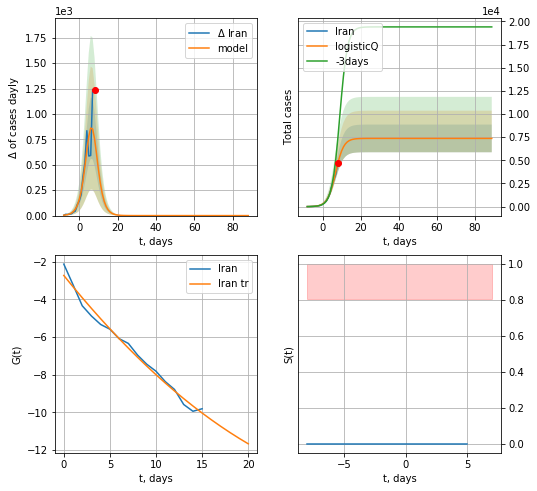

Iran data at: 2020-04-28
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 467 ± 284
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


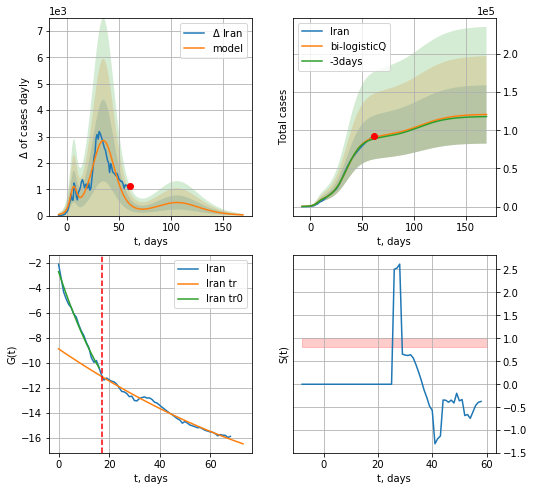

Iran data at: 2020-04-28
+3 day model MAPE: 0.019376250786912016
model: bi-logisticQ
coeffs:  [ 8.42636016e+04  1.59920309e-06  3.53853659e+01 -8.41039340e+04] [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3165520418428866
forecast at the end of period: +109 days
	 deltaDaycases:  27
	 total cases:  120730 ± 38217
	 total death:  7663 ± 7277
bi-logistic approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.983236
 intercept_: -8.87727615358714
 coeffs_: [ 0.         -0.1369109   0.00045453]


In [247]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date    cases  active  death
55 2020-04-24  68622.0   62439  615.0
56 2020-04-25  74588.0   67657  681.0
57 2020-04-26  80949.0   73435  747.0
58 2020-04-27  87147.0   79007  794.0
59 2020-04-28  93558.0   84235  867.0


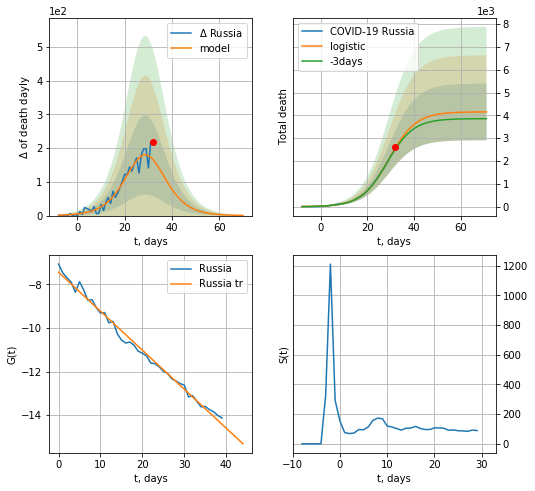

Russia data at: 2020-04-28
+3 day model MAPE: 0.025924359728612695
model: logistic
coeffs:  [4.15326015e+03 1.73551563e-01 2.91597184e+01]
rational stdev:  0.2990562321935785
forecast at the end of period: +39 days
	 total death:  4150 ± 1241
trend coefficient of determination: 0.991260
 intercept: -7.450590
 slope: -0.178695


In [248]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

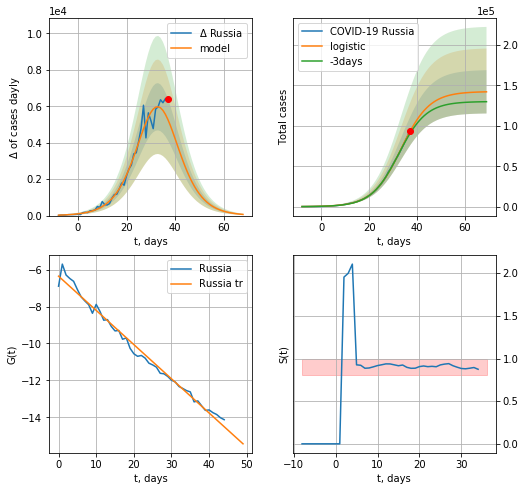

Russia data at: 2020-04-28
+3 day model MAPE: 0.0331693471468031
model: logistic
coeffs:  [1.42405770e+05 1.68015640e-01 3.32959331e+01]
rational stdev:  0.18844766091431792
forecast at the end of period: +32 days
	 deltaDaycases:  64
	 total cases:  142053 ± 26769
	 total death:  1316 ± 743
trend coefficient of determination: 0.987204
 intercept: -6.356698
 slope: -0.185224


In [249]:
x = forecast('Russia',dfRS[14:],d1,9*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


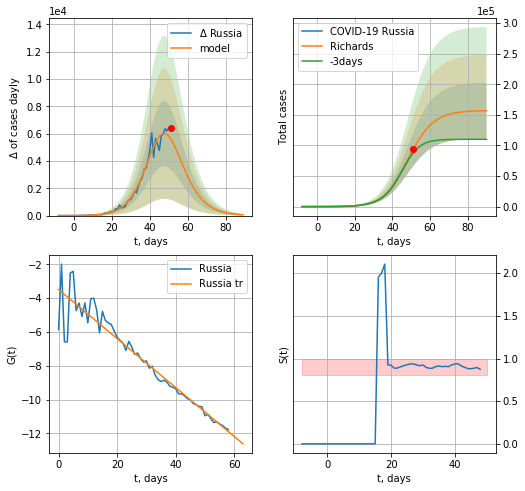

Russia data at: 2020-04-28
+3 day model MAPE: 0.07908265365445225
model: Richards
coeffs:  [1.57251297e+05 1.80044181e-01 4.64191794e+01 7.95352390e-01]
rational stdev:  0.2911951704114106
forecast at the end of period: +39 days
	 deltaDaycases:  59
	 total cases:  156866 ± 45678
	 total death:  1453 ± 1269
trend coefficient of determination: 0.908892
 intercept: -3.490592
 slope: -0.144974


In [250]:
x = forecastRR('Russia',dfRS[:],d1,10*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


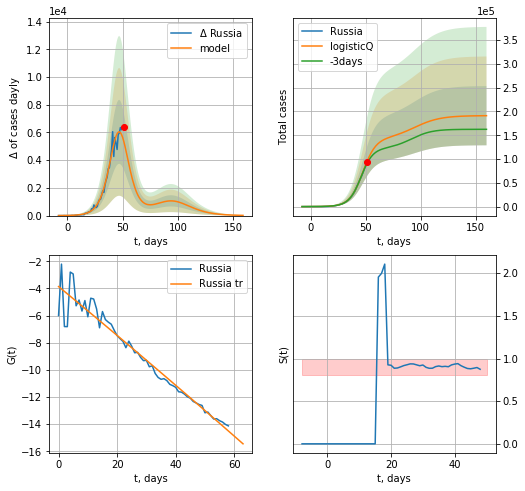

Russia data at: 2020-04-28
+3 day model MAPE: 0.051702
model: logisticQ
coeffs: [ 1.41701375e+05  3.08923580e-05  4.72350370e+01 -5.41649734e+03]
scenario coeffs: [0.35, 0.5, 2.0, 1]
rational stdev: 0.325572
forecast at the end of period: +109 days
	 deltaDaycases: 15
	 total cases: 191122 ± 62223
	 total death: 1771 ± 1729
trend coefficient of determination: 0.943206
 intercept_: -3.8611463616571937
 coeffs_: [ 0.00000000e+00 -1.78180573e-01 -9.14231183e-05]


In [251]:
x = forecastRRR('Russia',dfRS[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,2.,1])

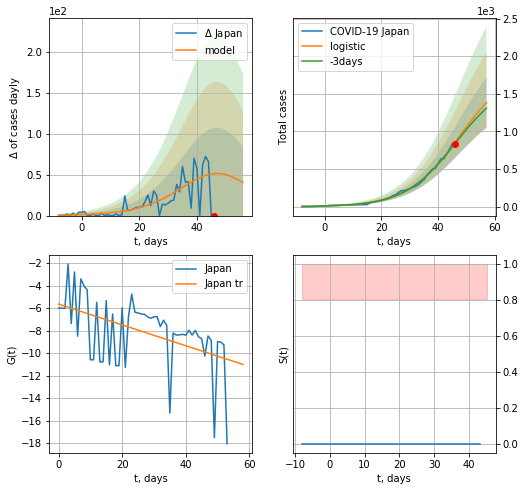

Japan data at: 2020-04-28
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +11 days
	 deltaDaycases:  40
	 total cases:  1384 ± 334
	 total death:  39 ± 28
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


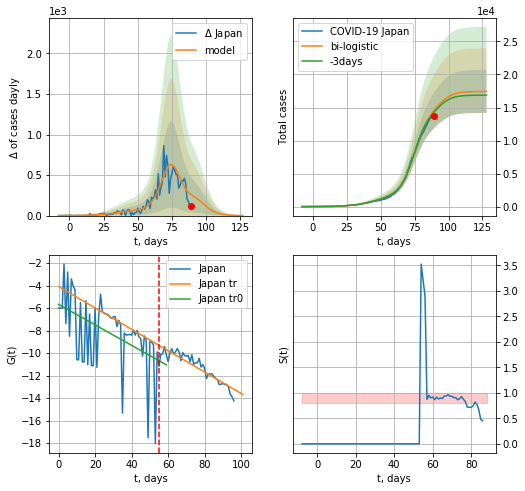

Japan data at: 2020-04-28
+3 day model MAPE: 0.020579532226509666
model: bi-logistic
coeffs:  [1.24628309e+04 1.93972954e-01 7.48066648e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18653608629254653
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  17440 ± 3253
	 total death:  500 ± 279
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.816162
 intercept: -4.086349
 slope: -0.095089


In [252]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

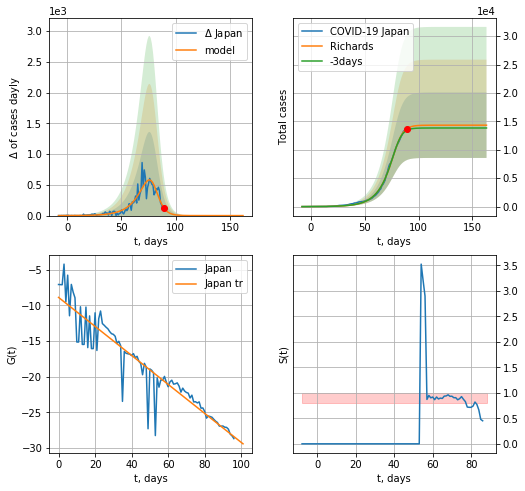

Japan data at: 2020-04-28
+3 day model MAPE: 0.022818686566525956
model: Richards
coeffs:  [1.43271330e+04 9.33539641e-02 8.01253894e+01 2.51676765e+00]
rational stdev:  0.402274953035493
forecast at the end of period: +74 days
	 deltaDaycases:  0
	 total cases:  14327 ± 5763
	 total death:  410 ± 494
trend coefficient of determination: 0.877723
 intercept: -8.871825
 slope: -0.203614


In [253]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

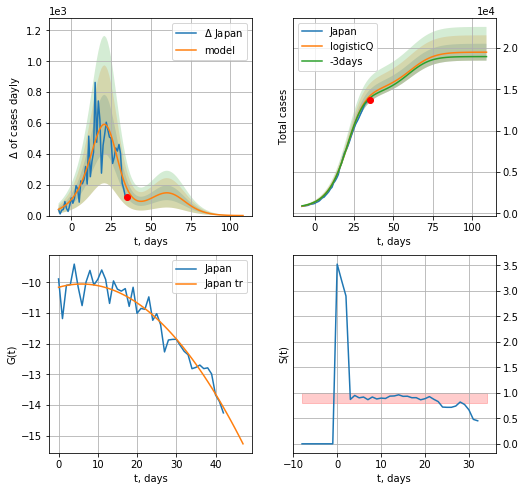

Japan data at: 2020-04-28
+3 day model MAPE: 0.018850
model: logisticQ
coeffs: [ 1.44299043e+04  1.82973846e-03  1.94782298e+01 -6.68933884e+01]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.052328
forecast at the end of period: +74 days
	 deltaDaycases: 0
	 total cases: 19478 ± 1019
	 total death: 558 ± 87
trend coefficient of determination: 0.925192
 intercept_: -10.164633086536895
 coeffs_: [ 0.          0.03630038 -0.00307779]


In [254]:
x = forecastRRR('Japan',dfJP[54:],d1,15*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


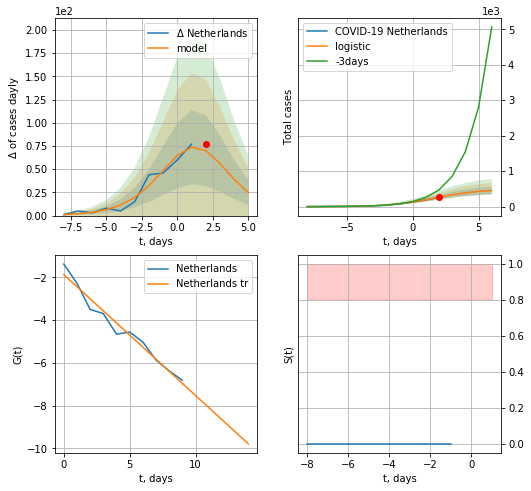

Netherlands data at: 2020-04-28
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +4 days
	 deltaDaycases:  24
	 total cases:  454 ± 108
	 total death:  54 ± 38
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


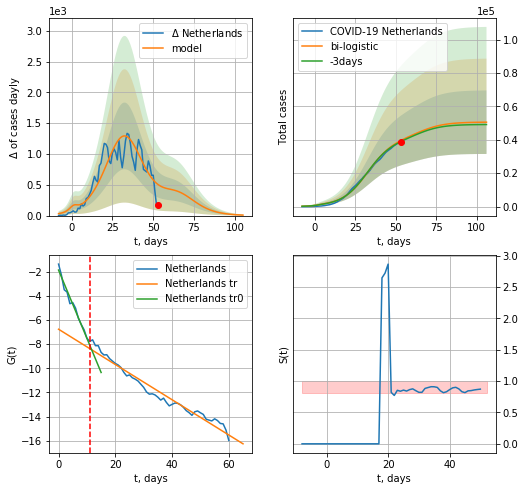

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.015987463796026457
model: bi-logistic
coeffs:  [4.00784118e+04 1.27261942e-01 3.26630210e+01] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37624411276798647
forecast at the end of period: +53 days
	 deltaDaycases:  8
	 total cases:  50525 ± 19010
	 total death:  6005 ± 6778
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.963879
 intercept: -6.770610
 slope: -0.145801


In [255]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
57 2020-04-24  36535   31996  4289.0
58 2020-04-25  37190   32531  4409.0
59 2020-04-26  37845   33120  4475.0
60 2020-04-27  38245   33477  4518.0
61 2020-04-28  38416   33600  4566.0


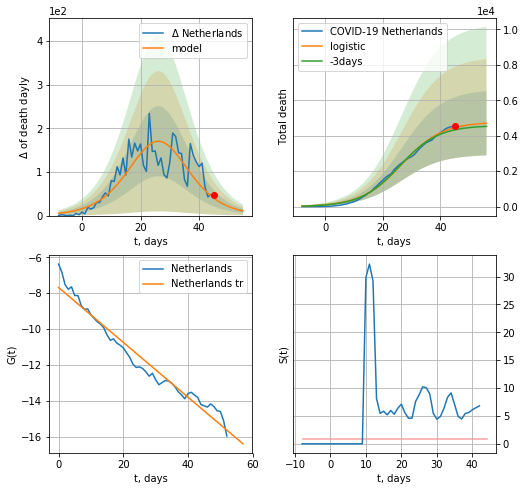

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.0296467573707133
model: logistic
coeffs:  [4.77574262e+03 1.42729981e-01 2.65800981e+01]
rational stdev:  0.38520878402667025
forecast at the end of period: +11 days
	 total death:  4705 ± 1812
trend coefficient of determination: 0.960444
 intercept: -7.683147
 slope: -0.152999


In [256]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


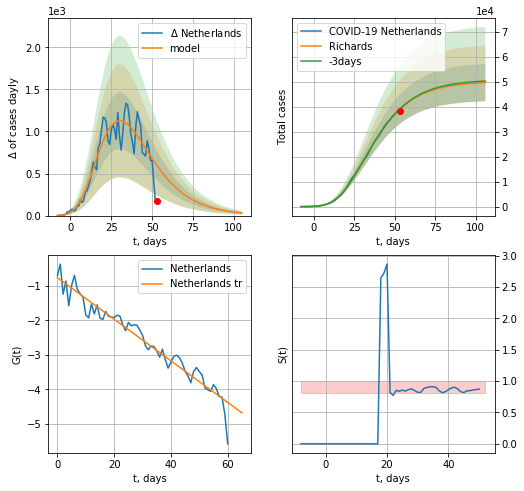

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.004792116681977593
model: Richards
coeffs:  [ 5.02325882e+04  3.86728813e+00 -3.66004144e+01  1.58963959e-02]
rational stdev:  0.14979529556258525
forecast at the end of period: +53 days
	 deltaDaycases:  30
	 total cases:  49742 ± 7451
	 total death:  5912 ± 2656
trend coefficient of determination: 0.939944
 intercept: -0.762150
 slope: -0.060311


In [257]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


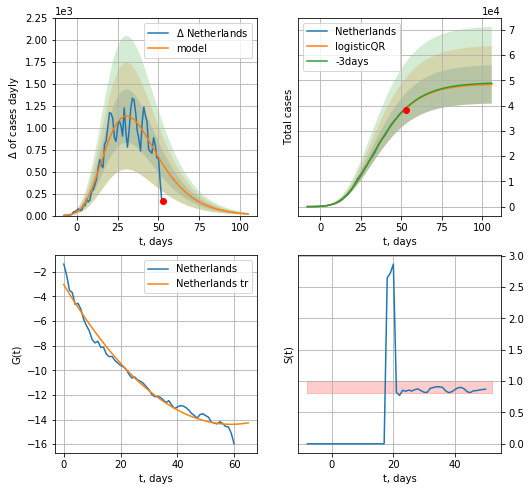

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.003463957646980639
model: logisticQR
coeffs:  [ 4.86019785e+04  2.28546786e-02 -7.18963566e+01 -5.16887708e+02
  4.27490057e-03]
rational stdev:  0.15686172990725594
forecast at the end of period: +53 days
	 deltaDaycases:  18
	 total cases:  48376 ± 7588
	 total death:  5749 ± 2705
trend coefficient of determination: 0.981167
 intercept_: -3.048727985810899
 coeffs_: [ 0.         -0.38459796  0.00326159]


In [258]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


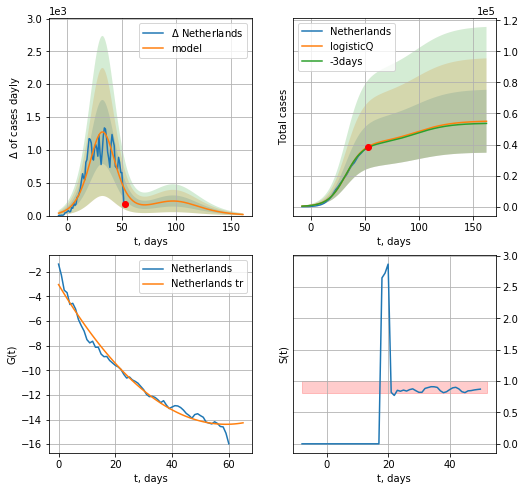

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.017387
model: logisticQ
coeffs: [ 4.09318359e+04  1.69015174e-06  3.25933572e+01 -7.27437719e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.368620
forecast at the end of period: +109 days
	 deltaDaycases: 16
	 total cases: 54989 ± 20270
	 total death: 6535 ± 7226
trend coefficient of determination: 0.981167
 intercept_: -3.048727985810899
 coeffs_: [ 0.         -0.38459796  0.00326159]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:179: RuntimeWarning: invalid value encountered in true_divide


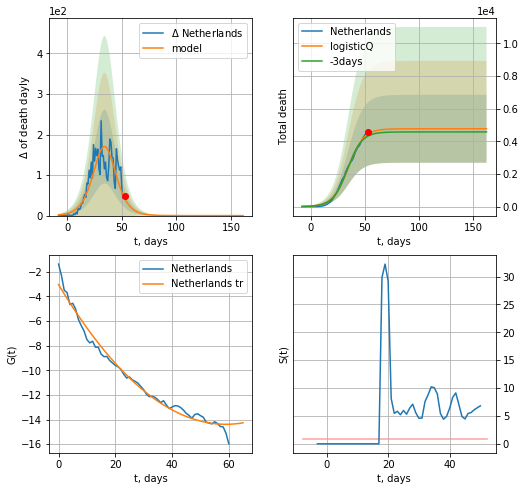

Netherlands data at: 2020-04-28
+3 day model MAPE: 0.029700
model: logisticQ
coeffs: [ 4.77247154e+03  2.12928856e-06  3.45683694e+01 -6.70746194e+04]
rational stdev: 0.436126
forecast at the end of period: +109 days
	 total death: 4772 ± 2081
trend coefficient of determination: 0.981167
 intercept_: -3.048727985810899
 coeffs_: [ 0.         -0.38459796  0.00326159]


In [259]:
x = forecastRRR('Netherlands',dfNL[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])
x = forecastRRR('Netherlands',dfNL[:],d1,20*7-dT,addpred=False,xcoef=[0.35,.5,3.,1],cases='death')

In [260]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:117: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


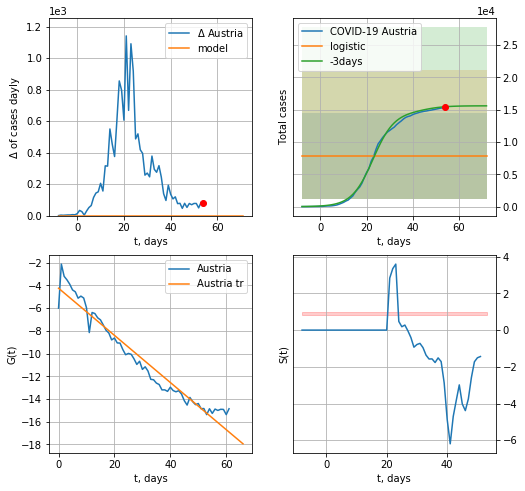

Austria data at: 2020-04-28
+3 day model MAPE: 0.4937060435747038
model: logistic
coeffs:  [ 7.37184144e+03 -2.72180398e+00  1.03583202e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.8495894689747285
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  7832 ± 6654
	 total death:  290 ± 739
trend coefficient of determination: 0.945540
 intercept: -4.245847
 slope: -0.207592


In [266]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


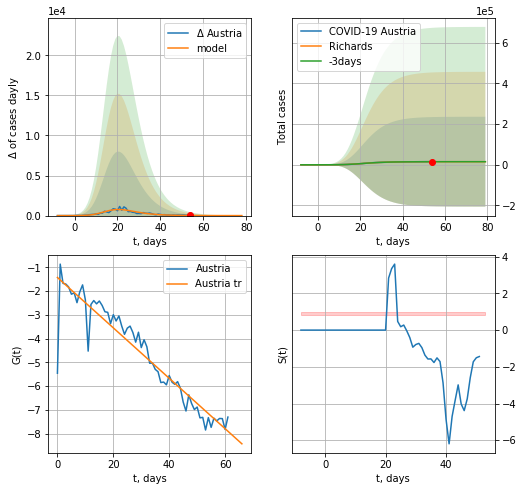

Austria data at: 2020-04-28
+3 day model MAPE: 0.007102106729041216
model: Richards
coeffs:  [1.51639748e+04 6.98888355e-01 1.07203527e+01 2.15712933e-01]
rational stdev:  14.555442166226225
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  15161 ± 220683
	 total death:  561 ± 24496
trend coefficient of determination: 0.883953
 intercept: -1.423433
 slope: -0.106092


In [267]:
x = forecastRR('Austria',dfAT[:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


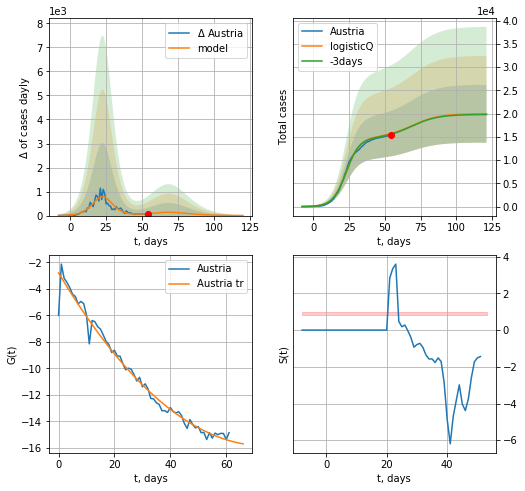

Austria data at: 2020-04-28
+3 day model MAPE: 0.008291
model: logisticQ
coeffs: [ 1.48052889e+04  1.93505314e-06  2.29316460e+01 -1.09620686e+05]
scenario coeffs: [0.35, 0.5, 3.0, 1.0]
rational stdev: 0.311548
forecast at the end of period: +67 days
	 deltaDaycases: 2
	 total cases: 19966 ± 6220
	 total death: 739 ± 690
trend coefficient of determination: 0.977776
 intercept_: -2.7876509560304736
 coeffs_: [ 0.         -0.35344844  0.00239138]


In [268]:
x = forecastRRR('Austria',dfAT[:],d1,14*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

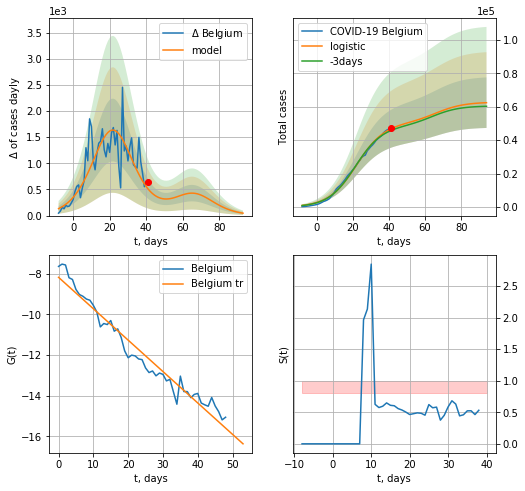

Belgium data at: 2020-04-28
+3 day model MAPE: 0.023112812553291288
model: logistic
coeffs:  [5.02170201e+04 1.30008993e-01 2.21278040e+01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.24206153336895217
forecast at the end of period: +53 days
	 deltaDaycases:  45
	 total cases:  62429 ± 15111
	 total death:  9669 ± 7021
trend coefficient of determination: 0.957793
 intercept: -8.184242
 slope: -0.154328


In [269]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
54 2020-04-24  44293   27492  6679.0
55 2020-04-25  45325   27991  6917.0
56 2020-04-26  46134   28255  7094.0
57 2020-04-27  46687   28602  7207.0
58 2020-04-28  47334   29060  7331.0


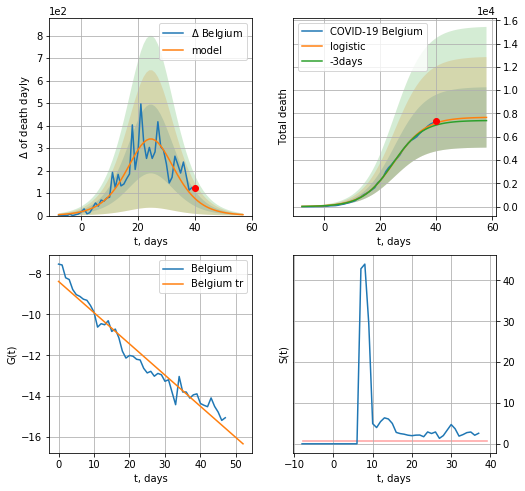

Belgium data at: 2020-04-28
+3 day model MAPE: 0.02671392477175757
model: logistic
coeffs:  [7.68118864e+03 1.77628395e-01 2.49867814e+01]
rational stdev:  0.33830879020697935
forecast at the end of period: +18 days
	 total death:  7659 ± 2591
trend coefficient of determination: 0.955739
 intercept: -8.383204
 slope: -0.152904


In [270]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


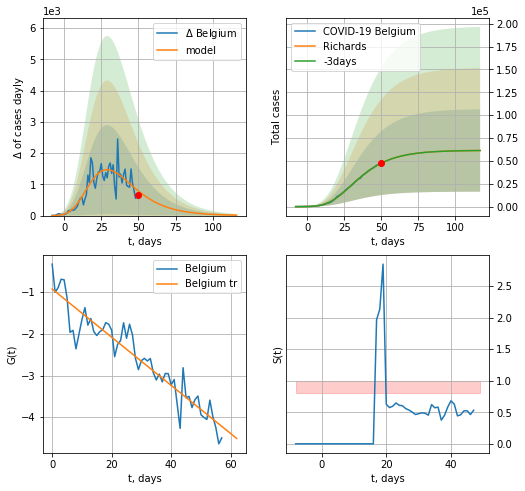

Belgium data at: 2020-04-28
+3 day model MAPE: 0.0005922451863467564
model: Richards
coeffs:  [ 6.15825012e+04  3.46603732e+00 -3.12153465e+01  1.88842376e-02]
rational stdev:  0.7342297147368471
forecast at the end of period: +67 days
	 deltaDaycases:  13
	 total cases:  61383 ± 45069
	 total death:  9506 ± 20938
trend coefficient of determination: 0.890763
 intercept: -0.925107
 slope: -0.057801


In [271]:
x = forecastRR('Belgium',dfBG[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


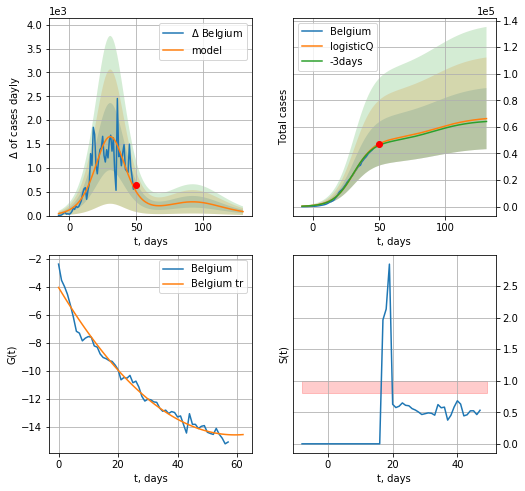

Belgium data at: 2020-04-28
+3 day model MAPE: 0.024786
model: logisticQ
coeffs: [ 5.00648647e+04  1.99858383e-06  3.10697641e+01 -6.54434245e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1.0]
rational stdev: 0.347335
forecast at the end of period: +81 days
	 deltaDaycases: 84
	 total cases: 66228 ± 23003
	 total death: 10257 ± 10687
trend coefficient of determination: 0.978505
 intercept_: -4.031645639892782
 coeffs_: [ 0.         -0.35468241  0.00298996]


In [272]:
x = forecastRRR('Belgium',dfBG[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

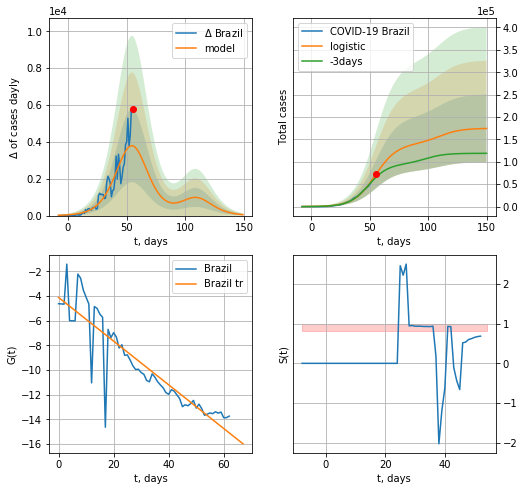

Brazil data at: 2020-04-28
+3 day model MAPE: 0.11087365973844127
model: logistic
coeffs:  [1.39881901e+05 1.08233429e-01 5.48246195e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.43352975839371427
forecast at the end of period: +95 days
	 deltaDaycases:  49
	 total cases:  174409 ± 75611
	 total death:  12105 ± 15743
trend coefficient of determination: 0.815130
 intercept: -4.117594
 slope: -0.177113


In [273]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


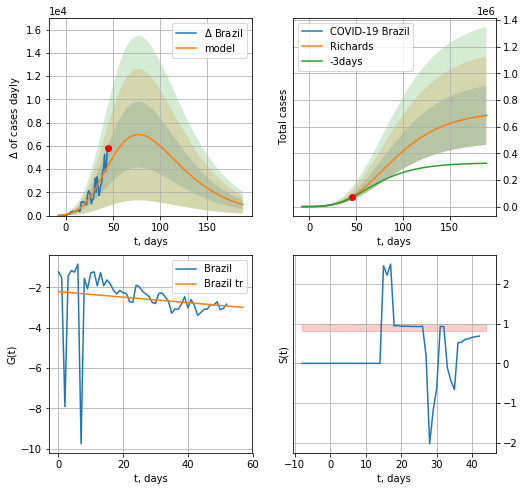

Brazil data at: 2020-04-28
+3 day model MAPE: 0.06208993898044336
model: Richards
coeffs:  [ 7.19637613e+05  1.02633604e+00 -5.91812494e+01  2.60008309e-02]
rational stdev:  0.3234761624184944
forecast at the end of period: +144 days
	 deltaDaycases:  943
	 total cases:  683785 ± 221188
	 total death:  47459 ± 46055
trend coefficient of determination: 0.022157
 intercept: -2.206278
 slope: -0.013735


In [274]:
x = forecastRR('Brazil',dfBZ[10:],d1,25*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


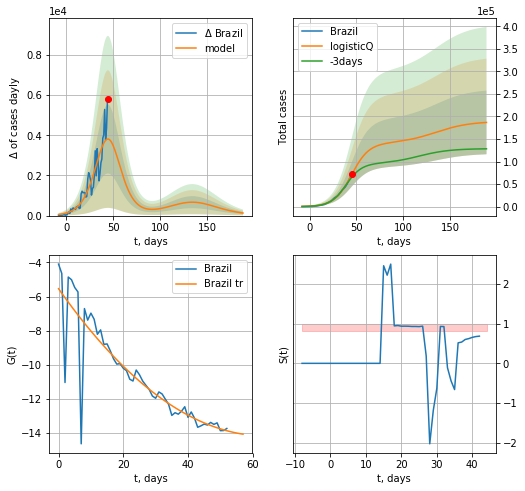

Brazil data at: 2020-04-28
+3 day model MAPE: 0.110303
model: logisticQ
coeffs: [ 1.40103982e+05  6.06389059e-06  4.48496304e+01 -1.78054634e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.378328
forecast at the end of period: +144 days
	 deltaDaycases: 127
	 total cases: 186749 ± 70652
	 total death: 12961 ± 14710
trend coefficient of determination: 0.774289
 intercept_: -5.539337528418693
 coeffs_: [ 0.         -0.26952528  0.00210166]


In [275]:
x = forecastRRR('Brazil',dfBZ[10:],d1,25*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

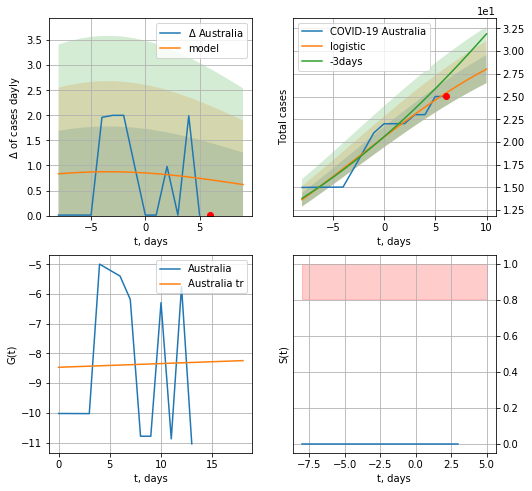

Australia data at: 2020-04-28
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


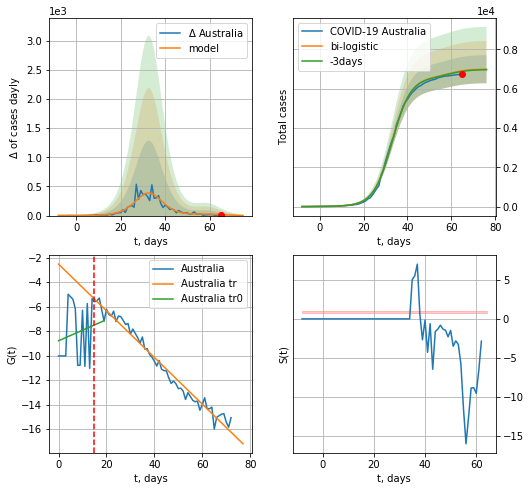

Australia data at: 2020-04-28
+3 day model MAPE: 0.004162625427995587
model: bi-logistic
coeffs:  [6.55700921e+03 2.37249307e-01 3.30536223e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.10224883974567091
forecast at the end of period: +11 days
	 deltaDaycases:  2
	 total cases:  6994 ± 715
	 total death:  91 ± 27
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.976299
 intercept: -2.531094
 slope: -0.190469


In [276]:
x = forecast('Australia',dfAS[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


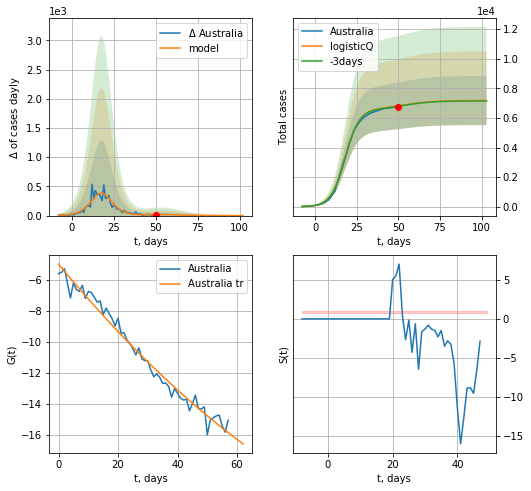

Australia data at: 2020-04-28
+3 day model MAPE: 0.004051
model: logisticQ
coeffs: [ 6.59800656e+03  3.37799176e-06  1.80024597e+01 -6.93165063e+04]
scenario coeffs: [0.0875, 0.5, 3, 1]
rational stdev: 0.230885
forecast at the end of period: +53 days
	 deltaDaycases: 0
	 total cases: 7173 ± 1656
	 total death: 93 ± 64
trend coefficient of determination: 0.979522
 intercept_: -5.001496792239251
 coeffs_: [ 0.         -0.23192235  0.00072751]


In [277]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=[0.35/4,.5,3,1])

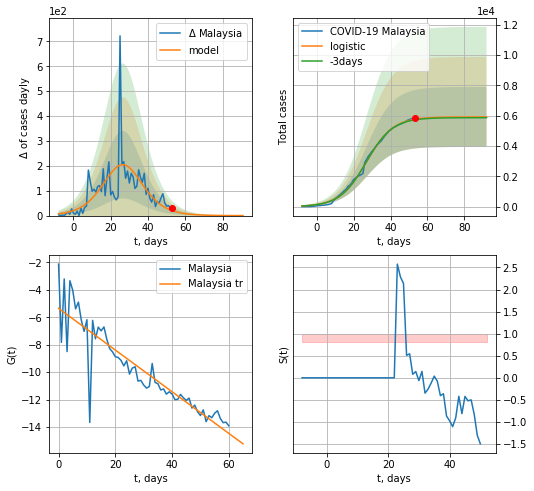

Malaysia data at: 2020-04-28
+3 day model MAPE: 0.007197046409654417
model: logistic
coeffs:  [5.92106683e+03 1.38289532e-01 2.69475557e+01]
rational stdev:  0.33455695583692696
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  5920 ± 1980
	 total death:  101 ± 101
trend coefficient of determination: 0.807103
 intercept: -5.348299
 slope: -0.152014


In [278]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

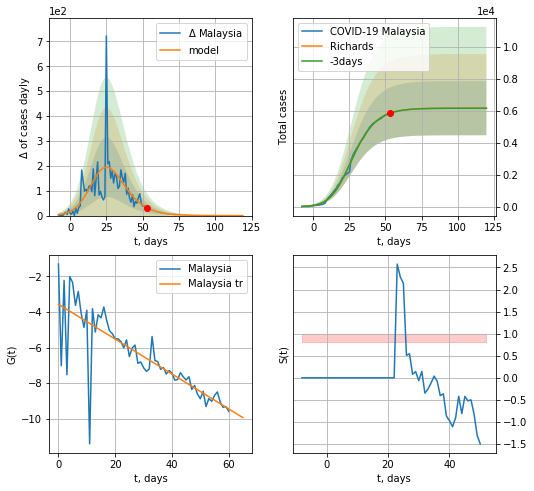

Malaysia data at: 2020-04-28
+3 day model MAPE: 0.00029655216815185475
model: Richards
coeffs:  [6.17106230e+03 2.13205831e-01 1.90989596e+01 4.99802041e-01]
rational stdev:  0.27500752795733535
forecast at the end of period: +67 days
	 deltaDaycases:  0
	 total cases:  6170 ± 1697
	 total death:  105 ± 86
trend coefficient of determination: 0.648988
 intercept: -3.565188
 slope: -0.097971


In [279]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


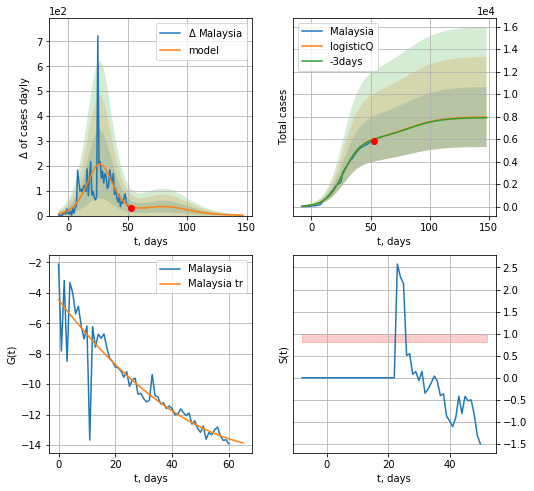

Malaysia data at: 2020-04-28
+3 day model MAPE: 0.006788
model: logisticQ
coeffs: [ 5.92033328e+03  2.70660725e-06  2.69463253e+01 -5.10652871e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.334702
forecast at the end of period: +95 days
	 deltaDaycases: 1
	 total cases: 7972 ± 2668
	 total death: 136 ± 136
trend coefficient of determination: 0.826635
 intercept_: -4.4641846547164565
 coeffs_: [ 0.         -0.24195034  0.00149915]


In [281]:
x = forecastRRR('Malaysia',dfML[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

ZL
          date   cases  active  death
56 2020-04-24  1461.0     325   18.0
57 2020-04-25  1470.0     310   18.0
58 2020-04-26  1470.5     270   19.0
59 2020-04-27  1472.0     239   19.0
60 2020-04-28  1474.0     226   19.0


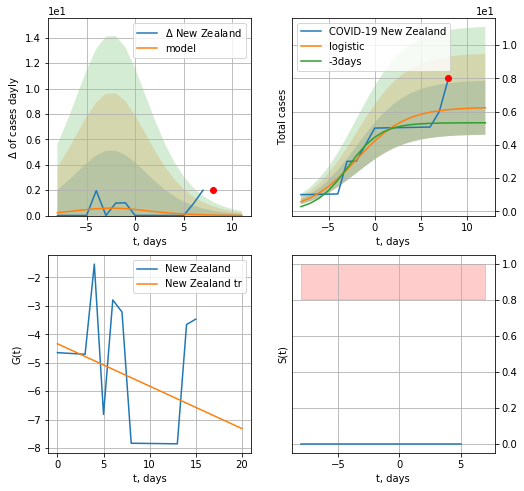

New Zealand data at: 2020-04-28
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


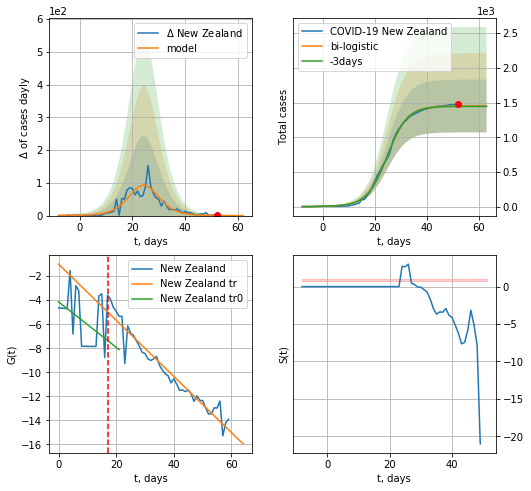

New Zealand data at: 2020-04-28
+3 day model MAPE: 0.004311175165163344
model: bi-logistic
coeffs:  [1.44465589e+03 2.57614186e-01 2.47892964e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26179260499842066
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1450 ± 379
	 total death:  18 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.936637
 intercept: -1.000299
 slope: -0.233537


In [282]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

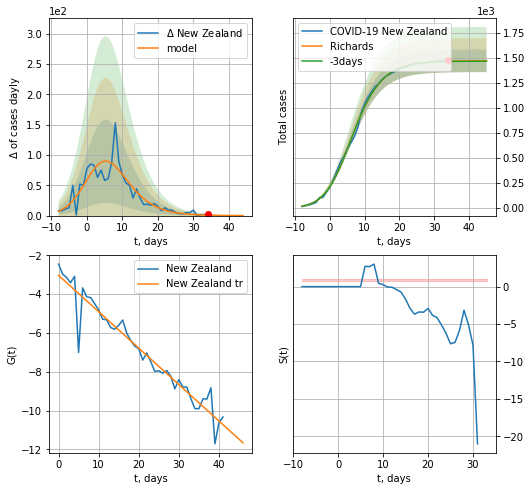

New Zealand data at: 2020-04-28
+3 day model MAPE: 0.002684338798907603
model: Richards
coeffs:  [1.46838289e+03 4.07120261e-01 2.53187398e+00 5.11331507e-01]
rational stdev:  0.07680747757545019
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1467 ± 112
	 total death:  18 ± 4
trend coefficient of determination: 0.928030
 intercept: -3.024134
 slope: -0.187828


In [283]:
x = forecastRR('New Zealand',dfZL[18:],d1,6*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


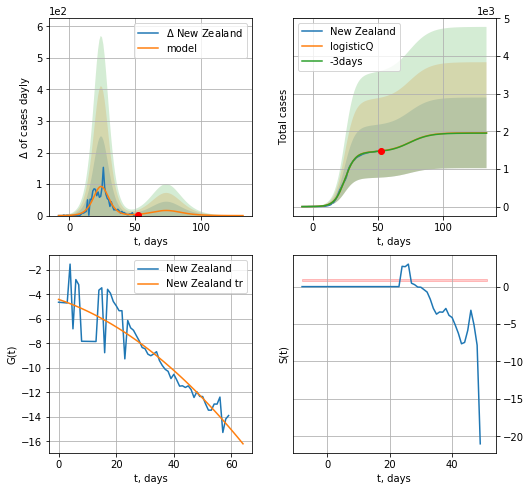

New Zealand data at: 2020-04-28
+3 day model MAPE: 0.004286
model: logisticQ
coeffs: [ 1.45194194e+03  5.34632348e-06  2.47490725e+01 -4.76330241e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.478579
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 1959 ± 937
	 total death: 25 ± 35
trend coefficient of determination: 0.829222
 intercept_: -4.4129531630312355
 coeffs_: [ 0.         -0.0797447  -0.00163332]


In [284]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

BR
          date    cases  active  death
56 2020-04-24   8773.0    7590   63.0
57 2020-04-25   9590.0    7950   67.0
58 2020-04-26  10463.0    8696   72.0
59 2020-04-27  11289.0    9474   75.0
60 2020-04-28  12208.0   10136   79.0


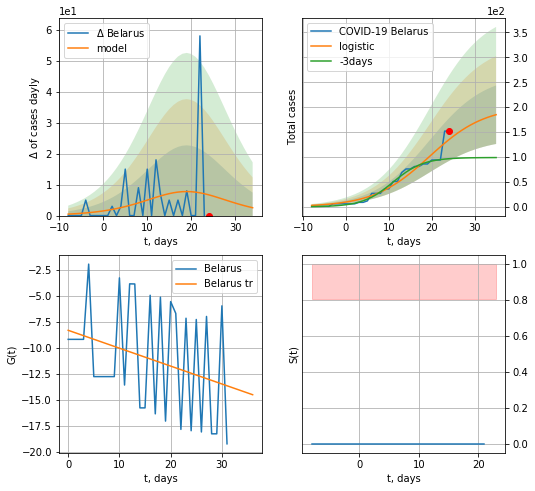

Belarus data at: 2020-04-28
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +11 days
	 deltaDaycases:  2
	 total cases:  184 ± 58
	 total death:  1 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


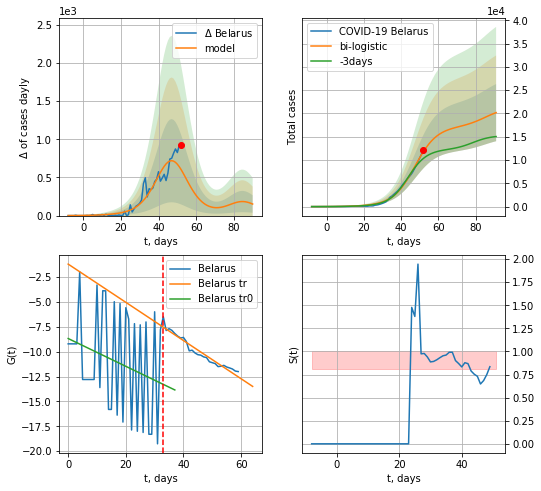

Belarus data at: 2020-04-28
+3 day model MAPE: 0.16440028607256985
model: bi-logistic
coeffs:  [1.69227753e+04 1.69812421e-01 4.74222644e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.30405834754261374
forecast at the end of period: +39 days
	 deltaDaycases:  151
	 total cases:  20171 ± 6133
	 total death:  130 ± 118
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.940843
 intercept: -1.195865
 slope: -0.192047


In [285]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
56 2020-04-24   8773.0    7590   63.0
57 2020-04-25   9590.0    7950   67.0
58 2020-04-26  10463.0    8696   72.0
59 2020-04-27  11289.0    9474   75.0
60 2020-04-28  12208.0   10136   79.0


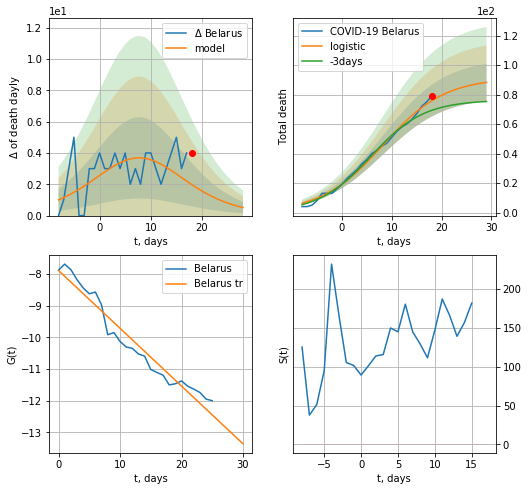

Belarus data at: 2020-04-28
+3 day model MAPE: 0.10487400007898853
model: logistic
coeffs:  [91.32175979  0.16170531  8.21012185]
rational stdev:  0.14199264720041843
forecast at the end of period: +11 days
	 total death:  88 ± 12
trend coefficient of determination: 0.950729
 intercept: -7.886697
 slope: -0.182372


In [286]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[34:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


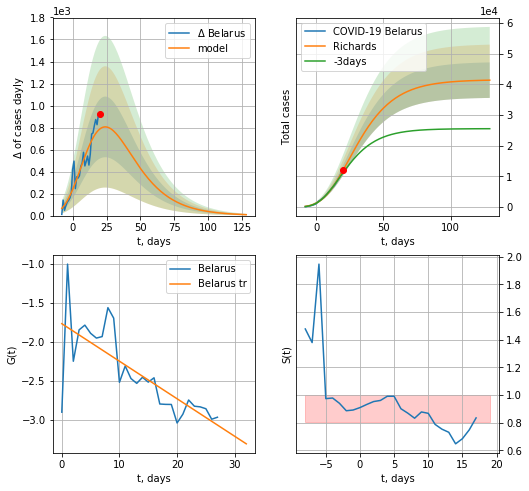

Belarus data at: 2020-04-28
+3 day model MAPE: 0.082252590352028
model: Richards
coeffs:  [ 4.15480680e+04  1.33158078e+00 -3.50963690e+01  4.04052661e-02]
rational stdev:  0.13988551644336306
forecast at the end of period: +109 days
	 deltaDaycases:  8
	 total cases:  41397 ± 5790
	 total death:  267 ± 112
trend coefficient of determination: 0.573456
 intercept: -1.764566
 slope: -0.048237


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


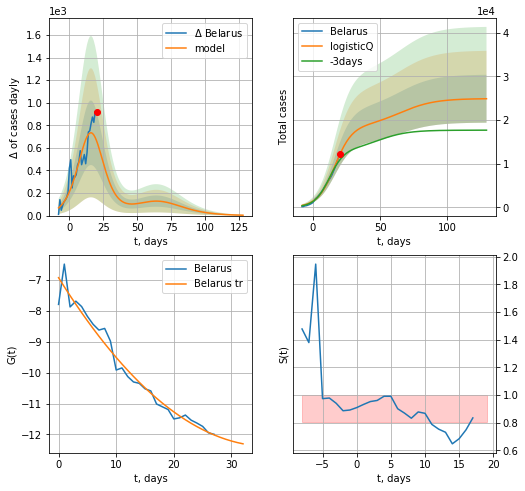

Belarus data at: 2020-04-28
+3 day model MAPE: 0.132508
model: logisticQ
coeffs: [ 1.84389953e+04  7.59463463e-06  1.62499706e+01 -2.06573934e+04]
scenario coeffs: [0.35, 0.5, 4, 1]
rational stdev: 0.220645
forecast at the end of period: +109 days
	 deltaDaycases: 3
	 total cases: 24851 ± 5483
	 total death: 160 ± 105
trend coefficient of determination: 0.966550
 intercept_: -6.9247082547488965
 coeffs_: [ 0.         -0.29924397  0.00409902]


In [288]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4,1])

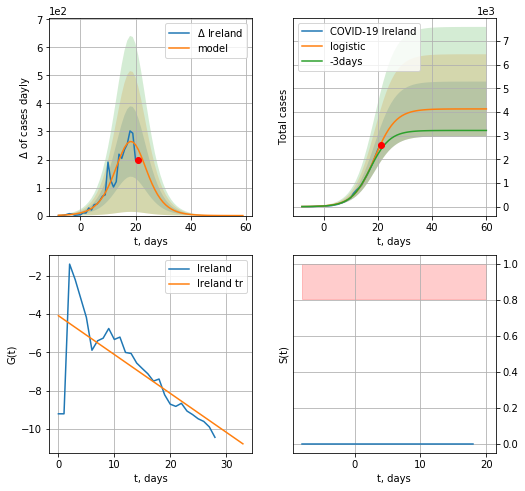

Ireland data at: 2020-04-28
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  240 ± 201
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


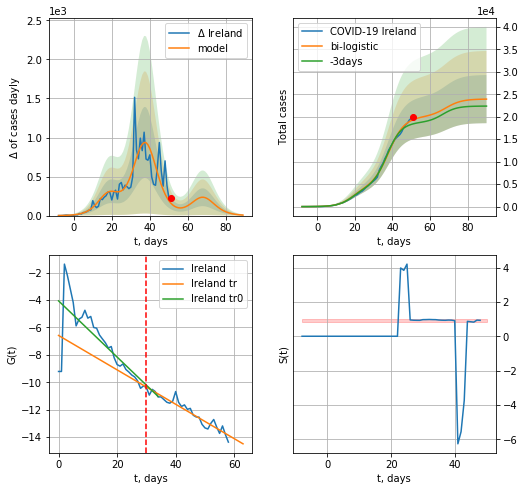

Ireland data at: 2020-04-28
+3 day model MAPE: 0.05318180792728673
model: bi-logistic
coeffs:  [1.58473927e+04 2.35002727e-01 3.79808623e+01] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.2239448308206107
forecast at the end of period: +39 days
	 deltaDaycases:  6
	 total cases:  23912 ± 5354
	 total death:  1394 ± 936
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.916997
 intercept: -6.586096
 slope: -0.125367


In [289]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


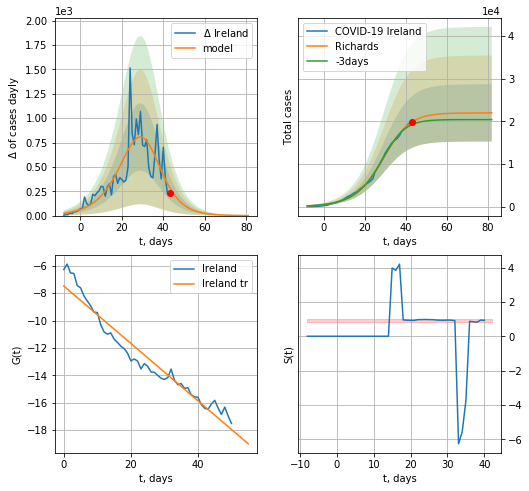

Ireland data at: 2020-04-28
+3 day model MAPE: 0.035573836258614606
model: Richards
coeffs:  [2.19604006e+04 1.22348609e-01 3.11273737e+01 1.31950614e+00]
rational stdev:  0.3054582559486465
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  21955 ± 6706
	 total death:  1280 ± 1172
trend coefficient of determination: 0.942925
 intercept: -7.482520
 slope: -0.209648


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


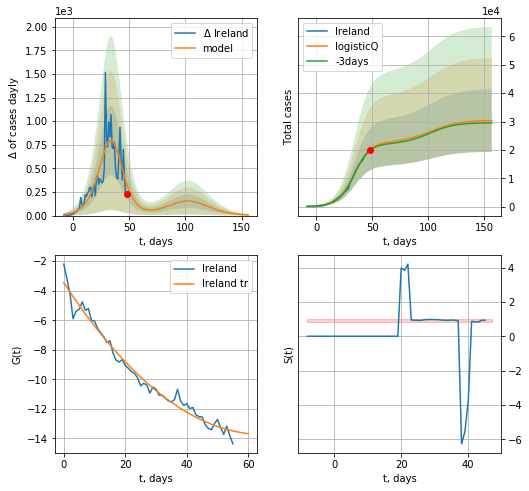

Ireland data at: 2020-04-28
+3 day model MAPE: 0.013121
model: logisticQ
coeffs: [ 2.25139300e+04  2.37730900e-04  3.39662175e+01 -5.58329512e+02]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.363323
forecast at the end of period: +109 days
	 deltaDaycases: 6
	 total cases: 30321 ± 11016
	 total death: 1768 ± 1927
trend coefficient of determination: 0.977395
 intercept_: -3.4609098555992137
 coeffs_: [ 0.         -0.31645039  0.0024382 ]


In [290]:
x = forecastRR('Ireland',dfIR[8:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

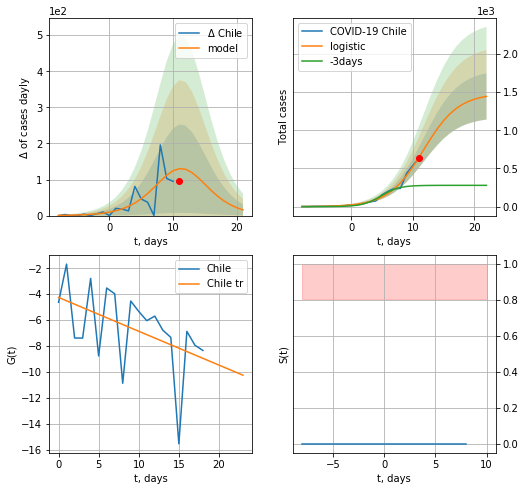

Chile data at: 2020-04-28
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +11 days
	 deltaDaycases:  15
	 total cases:  1443 ± 303
	 total death:  20 ± 12
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


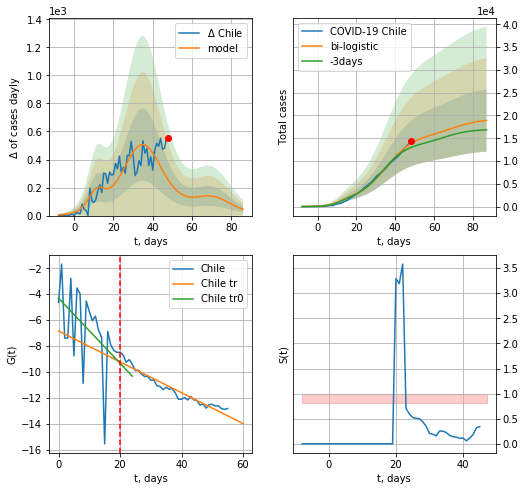

Chile data at: 2020-04-28
+3 day model MAPE: 0.07131839354058359
model: bi-logistic
coeffs:  [1.41935323e+04 1.42008295e-01 3.52915418e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3620932391257652
forecast at the end of period: +39 days
	 deltaDaycases:  44
	 total cases:  18900 ± 6843
	 total death:  272 ± 295
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.931551
 intercept: -6.840923
 slope: -0.119098


In [291]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


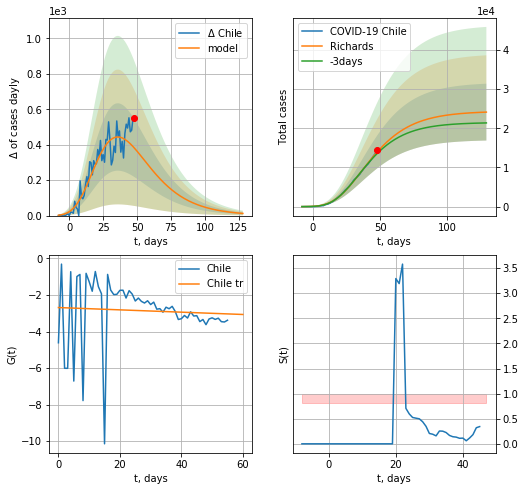

Chile data at: 2020-04-28
+3 day model MAPE: 0.032106289794258634
model: Richards
coeffs:  [ 2.43621389e+04  3.89618677e+00 -5.12487651e+01  1.27875702e-02]
rational stdev:  0.3005488969608427
forecast at the end of period: +81 days
	 deltaDaycases:  12
	 total cases:  24123 ± 7250
	 total death:  347 ± 312
trend coefficient of determination: 0.003522
 intercept: -2.686757
 slope: -0.006326


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


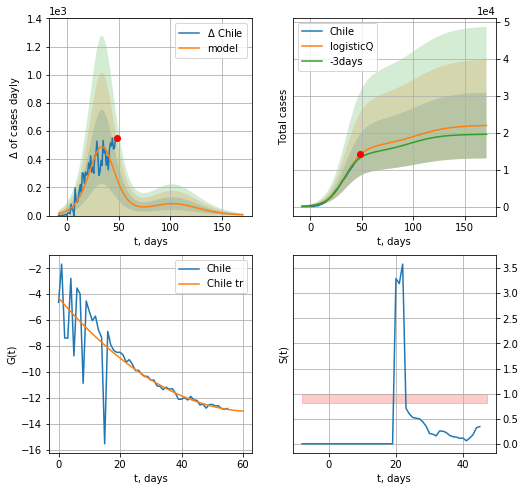

Chile data at: 2020-04-28
+3 day model MAPE: 0.063821
model: logisticQ
coeffs: [ 1.63510857e+04  1.97802713e-06  3.42400789e+01 -5.97273468e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.405096
forecast at the end of period: +123 days
	 deltaDaycases: 5
	 total cases: 21975 ± 8902
	 total death: 316 ± 384
trend coefficient of determination: 0.728043
 intercept_: -4.285365924021854
 coeffs_: [ 0.         -0.27539674  0.00216135]


In [294]:
x = forecastRR('Chile',dfCL[:],d1,16*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,22*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

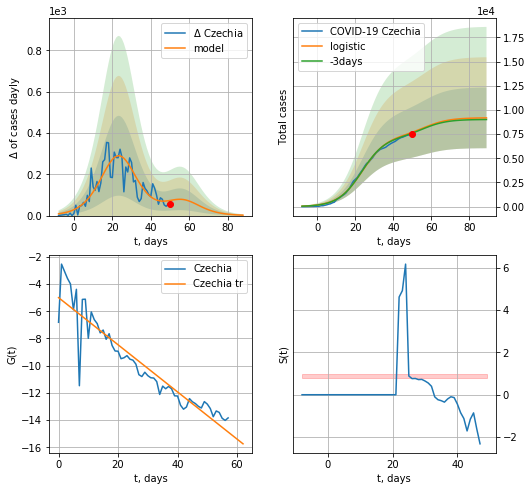

Czechia data at: 2020-04-28
+3 day model MAPE: 0.011785692600079549
model: logistic
coeffs:  [7.34852749e+03 1.56922912e-01 2.37255733e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3417355959080644
forecast at the end of period: +39 days
	 deltaDaycases:  2
	 total cases:  9173 ± 3134
	 total death:  277 ± 283
trend coefficient of determination: 0.868295
 intercept: -4.995049
 slope: -0.173389


In [295]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


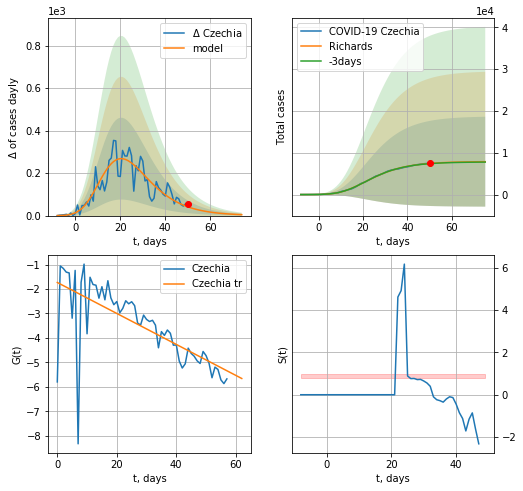

Czechia data at: 2020-04-28
+3 day model MAPE: 0.007368937767257809
model: Richards
coeffs:  [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev:  1.366945089229952
forecast at the end of period: +25 days
	 deltaDaycases:  4
	 total cases:  7863 ± 10749
	 total death:  237 ± 971
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


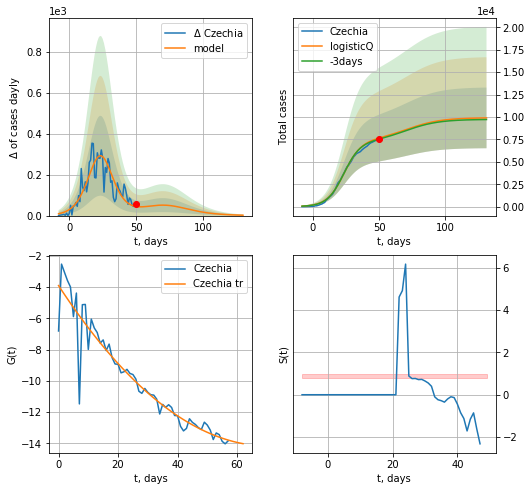

Czechia data at: 2020-04-28
+3 day model MAPE: 0.015345
model: logisticQ
coeffs: [ 7.34815645e+03  1.75623424e-06  2.37253388e+01 -8.93112535e+04]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.341857
forecast at the end of period: +81 days
	 deltaDaycases: 1
	 total cases: 9896 ± 3383
	 total death: 299 ± 306
trend coefficient of determination: 0.895688
 intercept_: -3.9032820919608273
 coeffs_: [ 0.         -0.29040092  0.00205315]


In [296]:
x = forecastRR('Czechia',dfCH[:],d1,8*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

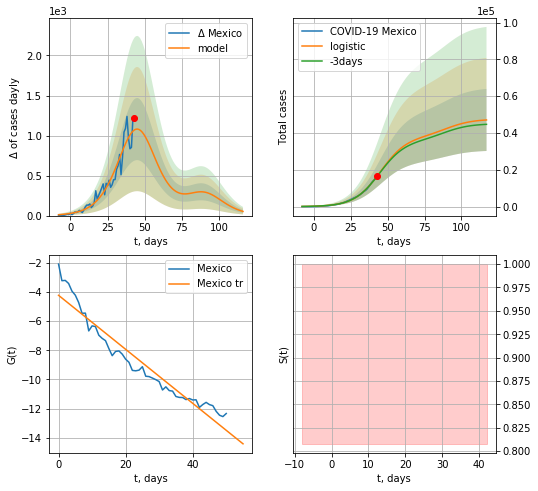

Mexico data at: 2020-04-28
+3 day model MAPE: 0.010496374704773447
model: logistic
coeffs:  [3.80379672e+04 1.13039987e-01 4.51927197e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35794572866593255
forecast at the end of period: +74 days
	 deltaDaycases:  52
	 total cases:  47088 ± 16855
	 total death:  4410 ± 4735
trend coefficient of determination: 0.929674
 intercept: -4.221572
 slope: -0.185496


In [297]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


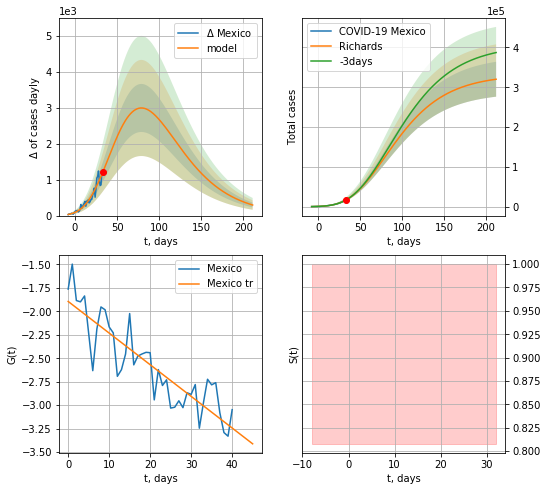

Mexico data at: 2020-04-28
+3 day model MAPE: 0.0051730989412413055
model: Richards
coeffs:  [ 3.32056856e+05  5.64902577e-01 -4.52476439e+01  4.42730278e-02]
rational stdev:  0.1368918324941317
forecast at the end of period: +179 days
	 deltaDaycases:  293
	 total cases:  320233 ± 43837
	 total death:  29993 ± 12317
trend coefficient of determination: 0.772438
 intercept: -1.894685
 slope: -0.033701


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


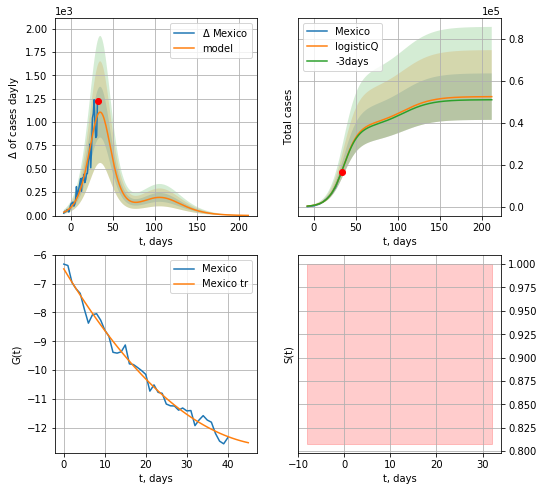

Mexico data at: 2020-04-28
+3 day model MAPE: 0.004850
model: logisticQ
coeffs: [ 3.88722600e+04  1.60840140e-05  3.55246844e+01 -6.95845928e+03]
scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.211031
forecast at the end of period: +179 days
	 deltaDaycases: 1
	 total cases: 52446 ± 11067
	 total death: 4912 ± 3109
trend coefficient of determination: 0.986637
 intercept_: -6.488669771674511
 coeffs_: [ 0.         -0.23640547  0.00227755]


In [298]:
x = forecastRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=True,xcoef=[0.35,.5,3,1])#

LT
          date  cases  active  death     tests
46 2020-04-24   1426     925   41.0   98948.0
47 2020-04-25   1438     930   41.2  104488.0
48 2020-04-26   1449     934   41.3  106775.0
49 2020-04-27   1454     931   41.4  111806.0
50 2020-04-28   1485     764   44.0  118201.0


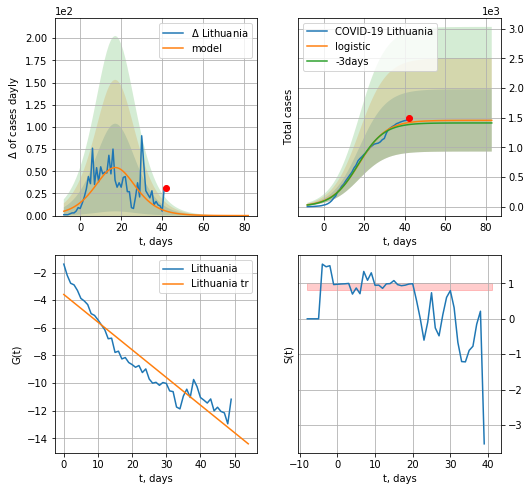

Lithuania data at: 2020-04-28
+3 day model MAPE: 0.025270393738106148
model: logistic
coeffs:  [1.45322293e+03 1.49250664e-01 1.75905403e+01]
rational stdev:  0.36113772192247706
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1453 ± 524
	 total death:  47 ± 50
trend coefficient of determination: 0.897689
 intercept: -3.586875
 slope: -0.200294


In [504]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [505]:
#np.diff(dfLT["cases"])

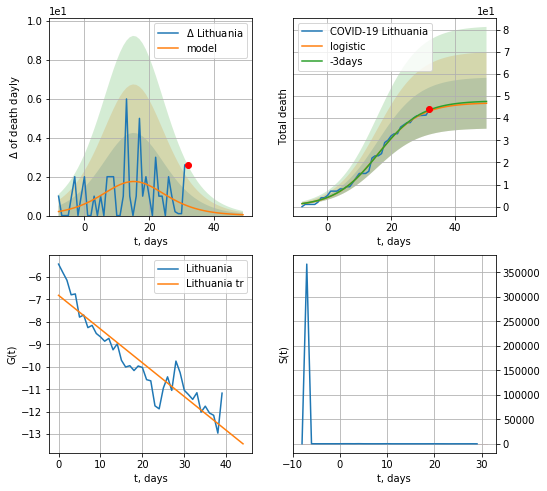

Lithuania data at: 2020-04-28
+3 day model MAPE: 0.011960761707860364
model: logistic
coeffs:  [47.04215022  0.14930036 15.70169453]
rational stdev:  0.24632595566456608
forecast at the end of period: +18 days
	 total death:  46 ± 11
trend coefficient of determination: 0.867170
 intercept: -6.814193
 slope: -0.150347


In [506]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


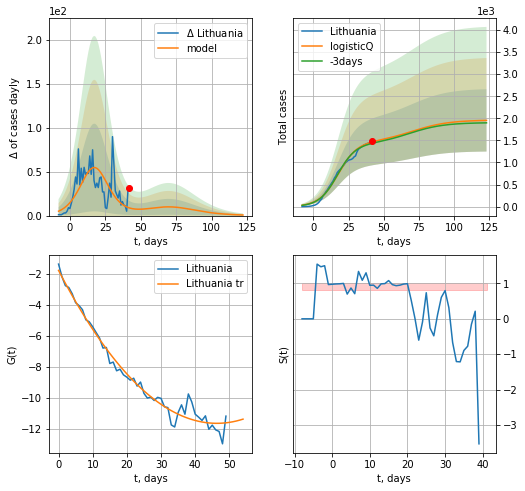

Lithuania data at: 2020-04-28
+3 day model MAPE: 0.022493
model: logisticQ
coeffs: [ 1.45315354e+03  1.13497082e-06  1.75902987e+01 -1.31453498e+05]
scenario coeffs: [0.35, 0.52, 4.0, 1.0]
rational stdev: 0.361196
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 1953 ± 705
	 total death: 63 ± 68
trend coefficient of determination: 0.976352
 intercept_: -1.790794388529906
 coeffs_: [ 0.         -0.42488876  0.00458439]


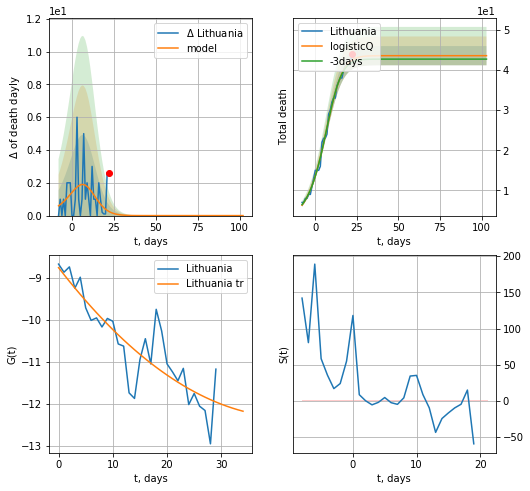

Lithuania data at: 2020-04-28
+3 day model MAPE: 0.013985
model: logisticQ
coeffs: [ 4.35591969e+01  2.54031364e-03  4.98635623e+00 -6.18113550e+01]
rational stdev: 0.054856
forecast at the end of period: +81 days
	 total death: 43 ± 2
trend coefficient of determination: 0.763696
 intercept_: -8.749625617310993
 coeffs_: [ 0.         -0.16737978  0.00195843]


In [508]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.52,4.,1.])
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


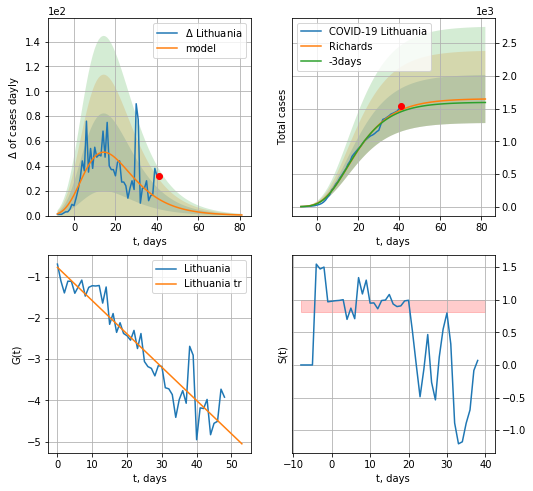

Lithuania data at: 2020-04-27
+3 day model MAPE: 0.01911561345345385
model: Richards
coeffs:  [ 1.65056451e+03  1.09497592e+01 -4.28109260e+01  7.70980472e-03]
rational stdev:  0.2232844720962344
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1644 ± 367
	 total death:  46 ± 30
trend coefficient of determination: 0.881334
 intercept: -0.776546
 slope: -0.080740


In [378]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


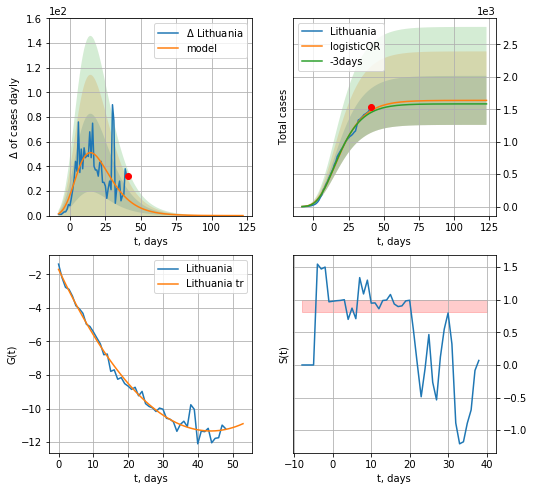

Lithuania data at: 2020-04-27
+3 day model MAPE: 0.019688498372089063
model: logisticQR
coeffs:  [ 1.63621870e+03  5.46982976e-02 -6.94589691e+01 -1.09294586e+03
  1.30290437e-03]
rational stdev:  0.23050330508627698
forecast at the end of period: +82 days
	 deltaDaycases:  0
	 total cases:  1636 ± 377
	 total death:  46 ± 31
trend coefficient of determination: 0.983808
 intercept_: -1.6995570992685884
 coeffs_: [ 0.         -0.44099896  0.00504402]


In [379]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
48 2020-04-24  3695.0     603   85.0
49 2020-04-25  3711.0     538   85.0
50 2020-04-26  3723.0     531   88.0
51 2020-04-27  3729.0     518   88.0
52 2020-04-28  3741.0     529   89.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


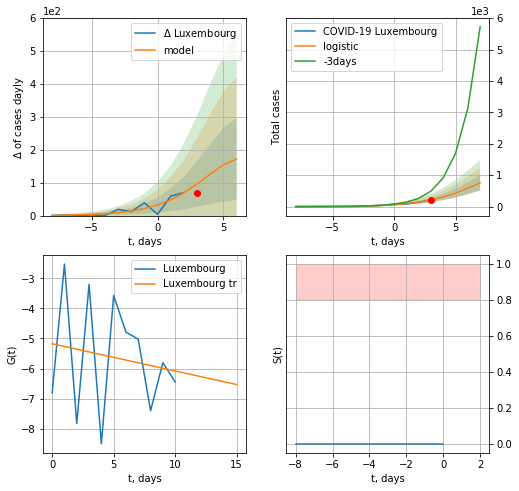

Luxembourg data at: 2020-04-28
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +4 days
	 deltaDaycases:  172
	 total cases:  757 ± 243
	 total death:  18 ± 17
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


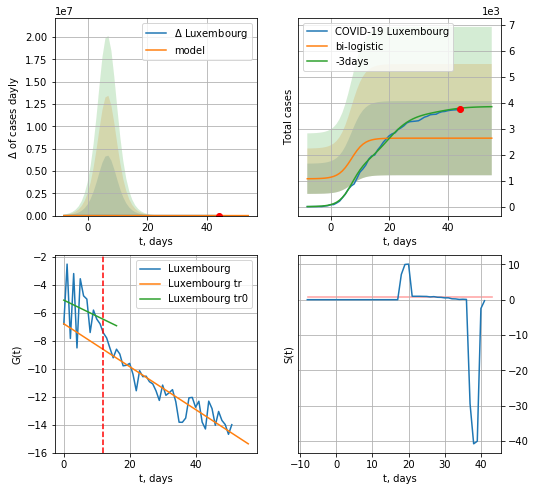

Luxembourg data at: 2020-04-28
+3 day model MAPE: 0.3058503207495535
model: bi-logistic
coeffs:  [ 9.54263894e+02 -2.94370895e-01  2.66668635e+02] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5412199546334423
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  2636 ± 1426
	 total death:  62 ± 100
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.862559
 intercept: -6.781552
 slope: -0.152699


In [300]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,5*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


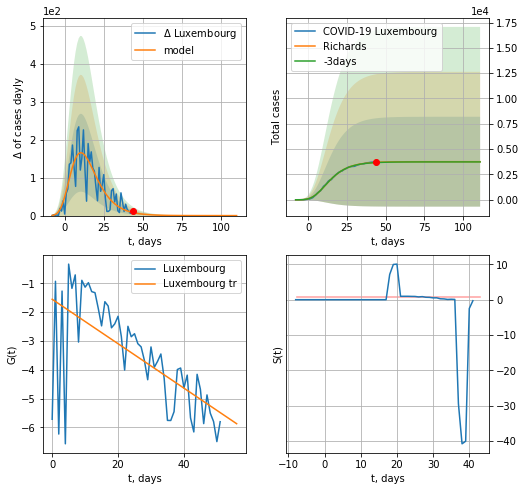

Luxembourg data at: 2020-04-28
+3 day model MAPE: 0.005164857626089286
model: Richards
coeffs:  [ 3.76161411e+03  1.72204085e+01 -3.03995639e+01  6.98719041e-03]
rational stdev:  1.179144669500014
forecast at the end of period: +67 days
	 deltaDaycases:  0
	 total cases:  3761 ± 4435
	 total death:  89 ± 314
trend coefficient of determination: 0.422777
 intercept: -1.556052
 slope: -0.077014


In [301]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


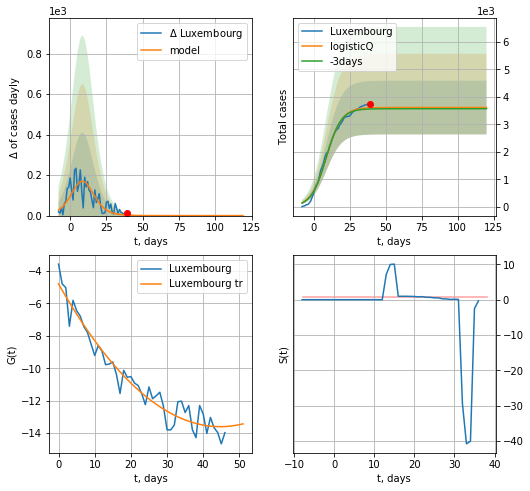

Luxembourg data at: 2020-04-28
+3 day model MAPE: 0.011695
model: logisticQ
coeffs: [ 3.61453541e+03  1.62169129e-06 -1.16305865e+05  8.93042824e+00]
rational stdev: 0.270704
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 3614 ± 978
	 total death: 85 ± 69
trend coefficient of determination: 0.942140
 intercept_: -4.79537436447572
 coeffs_: [ 0.         -0.39377711  0.00440363]


In [302]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

ED
          date    cases   active  death
55 2020-04-24  22719.0  20777.0  576.0
56 2020-04-25  22719.1  20777.1  576.1
57 2020-04-26  22719.2  20777.2  576.2
58 2020-04-27  23240.0  21020.0  663.0
59 2020-04-28  24258.0  21830.0  871.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


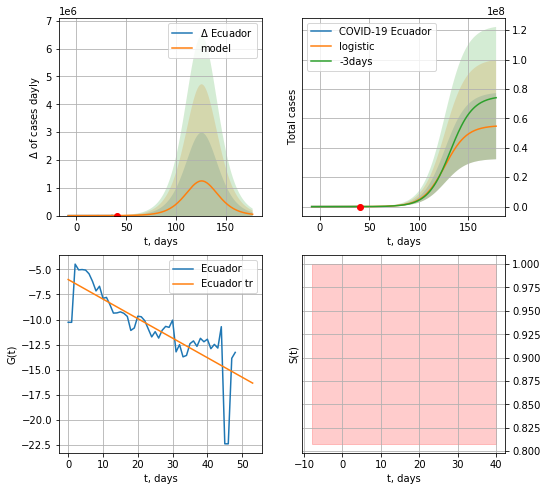

Ecuador data at: 2020-04-28
+3 day model MAPE: 0.026557159350090342
model: logistic
coeffs:  [5.52382099e+07 9.01943671e-02 1.26332950e+02]
rational stdev:  0.41122731861823164
forecast at the end of period: +137 days
	 deltaDaycases:  48388
	 total cases:  54720242 ± 22502458
	 total death:  1964767 ± 2423897
trend coefficient of determination: 0.629373
 intercept: -6.018398
 slope: -0.194431


In [303]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


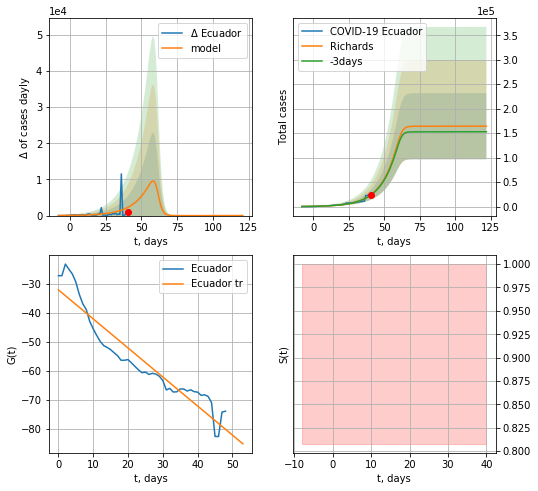

Ecuador data at: 2020-04-28
+3 day model MAPE: 0.026488661169935174
model: Richards
coeffs:  [1.64127162e+05 9.01760909e-02 6.18266900e+01 7.00369954e+00]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.4111629102597201
forecast at the end of period: +81 days
	 deltaDaycases:  8
	 total cases:  164329 ± 67566
	 total death:  5900 ± 7277
trend coefficient of determination: 0.891231
 intercept: -32.168942
 slope: -0.998794


In [304]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


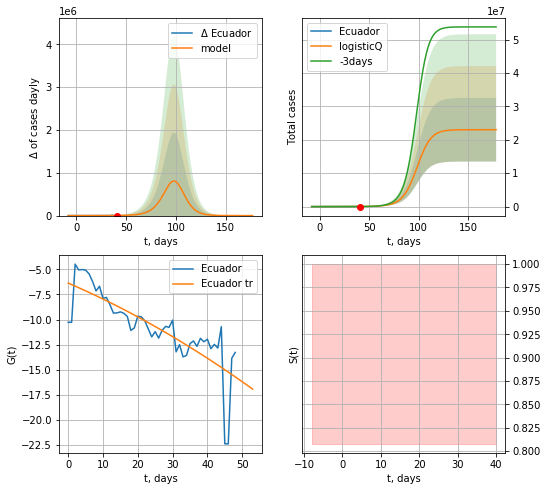

Ecuador data at: 2020-04-28
+3 day model MAPE: 0.040285
model: logisticQ
coeffs: [ 2.30206156e+07  3.67090627e-04  9.79669380e+01 -2.84160998e+02]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.413746
forecast at the end of period: +137 days
	 deltaDaycases: 6
	 total cases: 23020586 ± 9524668
	 total death: 826569 ± 1025968
trend coefficient of determination: 0.631677
 intercept_: -6.370361770958308
 coeffs_: [ 0.         -0.14953095 -0.0009351 ]


In [305]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

FI
          date   cases  active  death
59 2020-04-24  4395.0    1718  177.0
60 2020-04-25  4475.0    1789  186.0
61 2020-04-26  4576.0    1886  190.0
62 2020-04-27  4695.0    2002  193.0
63 2020-04-28  4740.0    1741  199.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


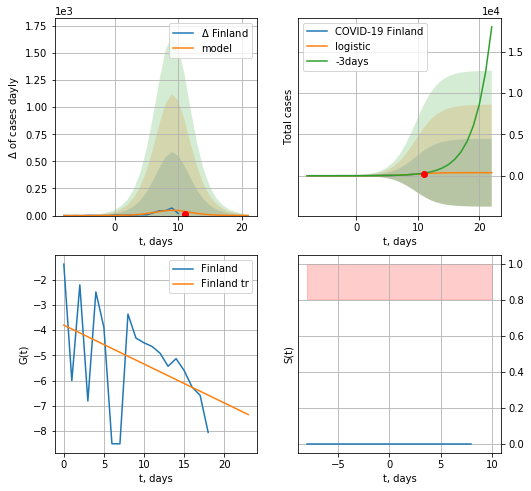

Finland data at: 2020-04-28
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  372 ± 4110
	 total death:  15 ± 496
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


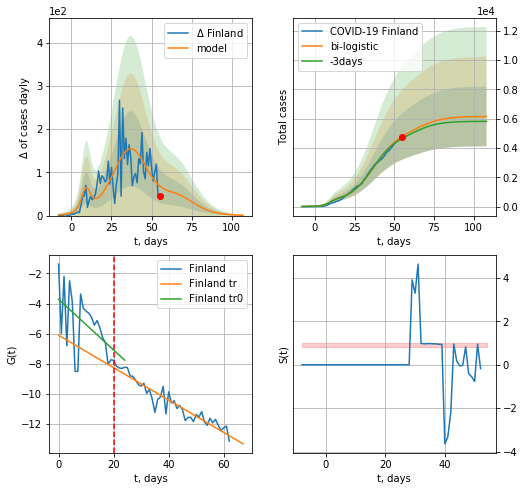

Finland data at: 2020-04-28
+3 day model MAPE: 0.030047013199349052
model: bi-logistic
coeffs:  [4.6279753e+03 1.3143411e-01 3.7227822e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3314857174094165
forecast at the end of period: +53 days
	 deltaDaycases:  0
	 total cases:  6152 ± 2039
	 total death:  258 ± 256
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.907022
 intercept: -6.105484
 slope: -0.107425


In [306]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


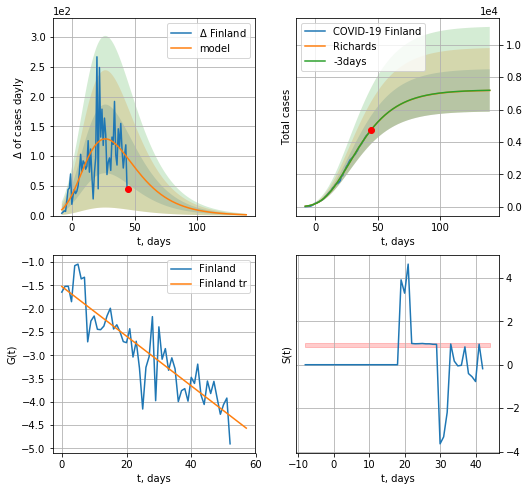

Finland data at: 2020-04-28
+3 day model MAPE: 0.0002602583216802173
model: Richards
coeffs:  [ 7.20732295e+03  1.71537715e+00 -4.46910006e+01  2.87711106e-02]
rational stdev:  0.18207320585076223
forecast at the end of period: +95 days
	 deltaDaycases:  1
	 total cases:  7179 ± 1307
	 total death:  301 ± 164
trend coefficient of determination: 0.795902
 intercept: -1.522598
 slope: -0.053351


In [307]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


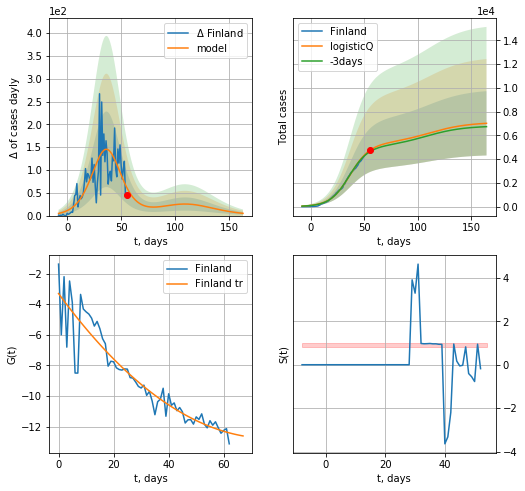

Finland data at: 2020-04-28
+3 day model MAPE: 0.025327
model: logisticQ
coeffs: [ 5.26492941e+03  1.90568501e-06  3.67154989e+01 -5.72309255e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1.0]
rational stdev: 0.385796
forecast at the end of period: +109 days
	 deltaDaycases: 4
	 total cases: 7015 ± 2706
	 total death: 294 ± 340
trend coefficient of determination: 0.868338
 intercept_: -3.309033480788714
 coeffs_: [ 0.         -0.24542082  0.00159187]


In [308]:
x = forecastRRR("Finland",dfFI[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

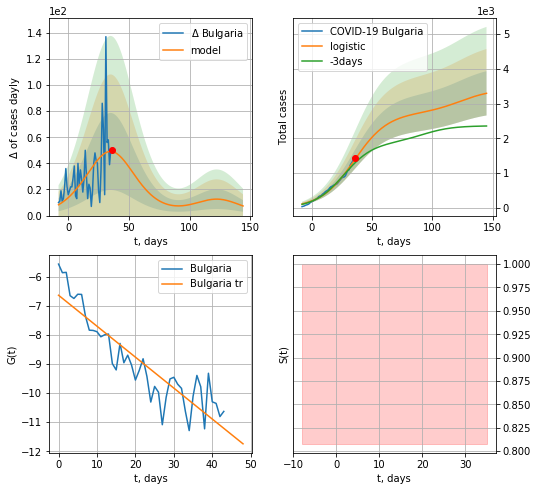

Bulgaria data at: 2020-04-28
+3 day model MAPE: 0.0877167444534759
model: logistic
coeffs:  [2.73267722e+03 7.17784976e-02 3.53036966e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.19297829068699765
forecast at the end of period: +109 days
	 deltaDaycases:  7
	 total cases:  3294 ± 635
	 total death:  139 ± 80
trend coefficient of determination: 0.810206
 intercept: -6.632268
 slope: -0.106490


In [309]:
x = forecast('Bulgaria',dfBL[5:],d1,20*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


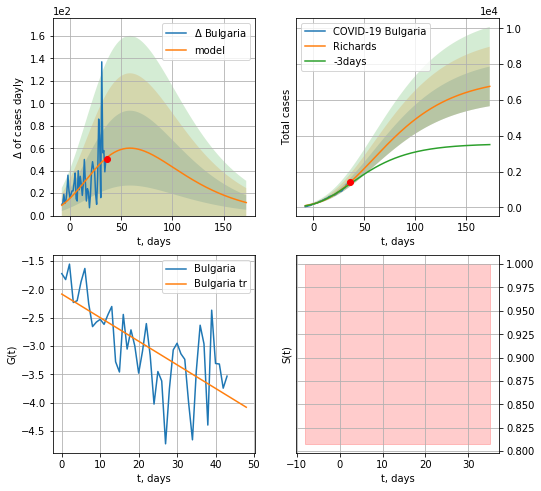

Bulgaria data at: 2020-04-28
+3 day model MAPE: 0.07097658304571279
model: Richards
coeffs:  [ 7.28370093e+03  9.54790517e-01 -1.05785474e+02  2.37738271e-02]
rational stdev:  0.16386766549646983
forecast at the end of period: +137 days
	 deltaDaycases:  11
	 total cases:  6757 ± 1107
	 total death:  286 ± 140
trend coefficient of determination: 0.485442
 intercept: -2.083505
 slope: -0.041589


In [310]:
x = forecastRR('Bulgaria',dfBL[5:],d1,24*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


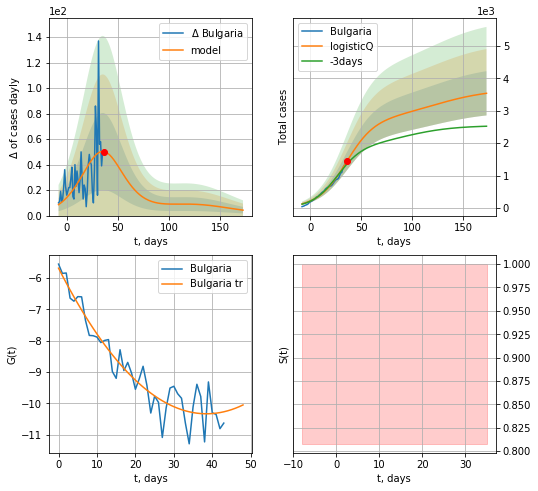

Bulgaria data at: 2020-04-28
+3 day model MAPE: 0.072313
model: logisticQ
coeffs: [ 2.72390175e+03  2.91841858e-06  3.52152935e+01 -2.46158031e+04]
scenario coeffs: [0.35, 0.5, 3.5, 1]
rational stdev: 0.193072
forecast at the end of period: +137 days
	 deltaDaycases: 4
	 total cases: 3541 ± 683
	 total death: 150 ± 86
trend coefficient of determination: 0.901020
 intercept_: -5.6908306192052365
 coeffs_: [ 0.         -0.24105172  0.00313013]


In [311]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,24*7-dT,shift=1.0,addpred=True,xcoef=[0.35,.5,3.5,1])

TH
          date  cases  active  death
57 2020-04-24   2854   314.0   50.0
58 2020-04-25   2907   309.0   51.0
59 2020-04-26   2931   270.0   52.0
60 2020-04-27   2938   232.0   54.0
61 2020-04-28   2947   228.0   54.0


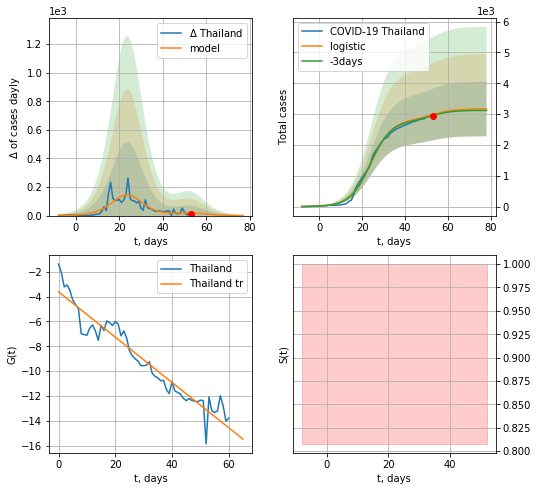

Thailand data at: 2020-04-28
+3 day model MAPE: 0.011291599078845192
model: logistic
coeffs:  [2.81746324e+03 2.05613278e-01 2.40833733e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.27991453953721834
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  3167 ± 886
	 total death:  58 ± 48
trend coefficient of determination: 0.921742
 intercept: -3.614685
 slope: -0.182478


In [312]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [313]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


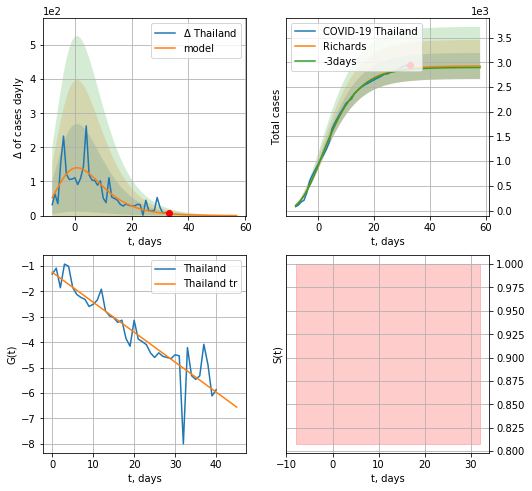

Thailand data at: 2020-04-28
+3 day model MAPE: 0.009115666412038686
model: Richards
coeffs:  [ 2.92616162e+03  1.36347632e+01 -3.41664530e+01  9.61807506e-03]
rational stdev:  0.09014939991709617
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  2924 ± 263
	 total death:  53 ± 14
trend coefficient of determination: 0.829852
 intercept: -1.243416
 slope: -0.118022


In [314]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


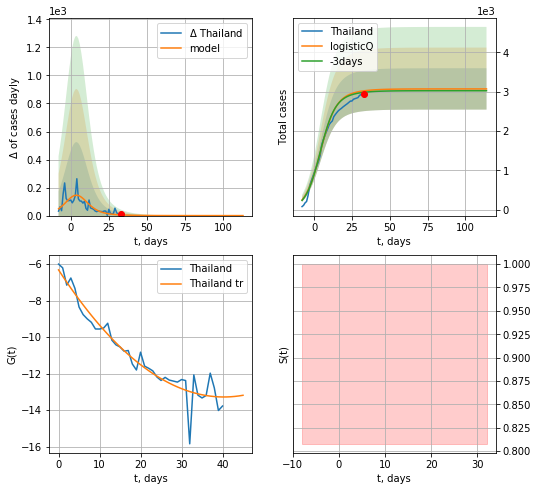

Thailand data at: 2020-04-28
+3 day model MAPE: 0.013009
model: logisticQ
coeffs: [ 2.82691452e+03  2.04508220e-06  4.09971438e+00 -9.77306149e+04]
scenario coeffs: [0.0875, 0.5, 4, 1]
rational stdev: 0.170918
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 3074 ± 525
	 total death: 56 ± 28
trend coefficient of determination: 0.922391
 intercept_: -6.324036007431511
 coeffs_: [ 0.         -0.34519233  0.00427949]


In [315]:
x = forecastRRR("Thailand",dfTH[20:],d1,16*7-dT,addpred=True,xcoef=[0.35/4,.5,4,1])

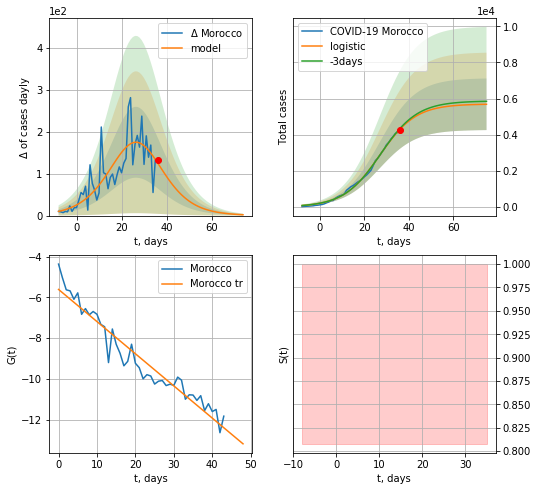

Morocco data at: 2020-04-28
+3 day model MAPE: 0.011240104344936275
model: logistic
coeffs:  [5.69786132e+03 1.22744101e-01 2.68984542e+01]
rational stdev:  0.251308094028612
forecast at the end of period: +39 days
	 deltaDaycases:  2
	 total cases:  5682 ± 1428
	 total death:  220 ± 165
trend coefficient of determination: 0.931906
 intercept: -5.605048
 slope: -0.157915


In [316]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


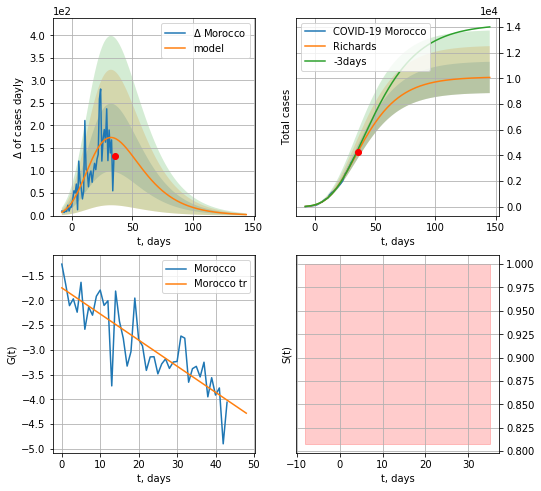

Morocco data at: 2020-04-28
+3 day model MAPE: 0.04060867977015156
model: Richards
coeffs:  [ 1.01274753e+04  6.85871273e-01 -2.21349868e+01  7.02398621e-02]
rational stdev:  0.12093667369527211
forecast at the end of period: +109 days
	 deltaDaycases:  2
	 total cases:  10081 ± 1219
	 total death:  391 ± 141
trend coefficient of determination: 0.724741
 intercept: -1.744434
 slope: -0.052838


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


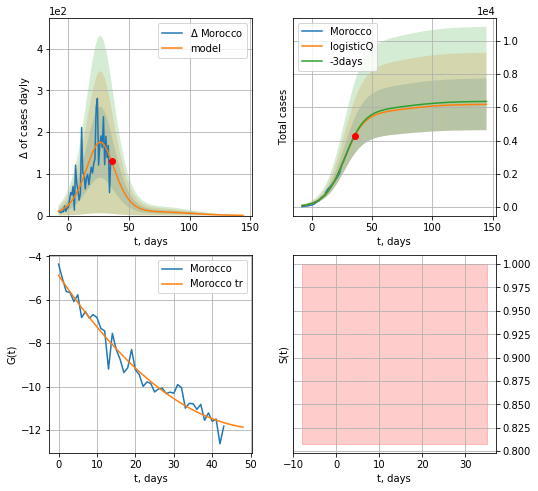

Morocco data at: 2020-04-28
+3 day model MAPE: 0.010893
model: logisticQ
coeffs: [ 5.68987193e+03  7.03095291e-06  2.68746762e+01 -1.74541965e+04]
scenario coeffs: [0.0875, 0.5, 3, 1]
rational stdev: 0.251709
forecast at the end of period: +109 days
	 deltaDaycases: 0
	 total cases: 6178 ± 1555
	 total death: 239 ± 180
trend coefficient of determination: 0.960481
 intercept_: -4.876144976809595
 coeffs_: [ 0.         -0.26212099  0.00242424]


In [318]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=True,xcoef=[0.35/4,.5,3,1])

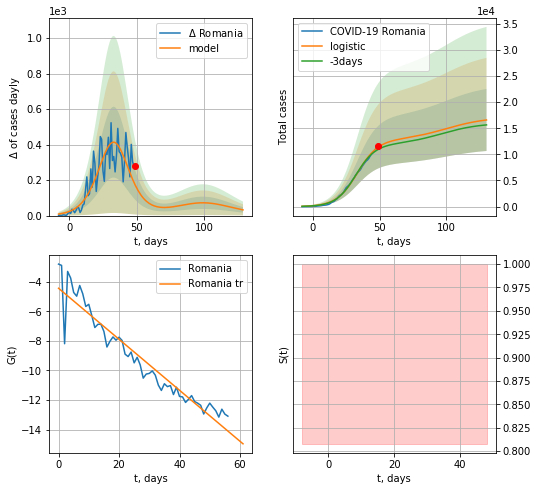

Romania data at: 2020-04-28
+3 day model MAPE: 0.04138301887467617
model: logistic
coeffs:  [1.26955915e+04 1.29162368e-01 3.33068589e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3579616299510078
forecast at the end of period: +81 days
	 deltaDaycases:  32
	 total cases:  16581 ± 5935
	 total death:  946 ± 1015
trend coefficient of determination: 0.916868
 intercept: -4.436876
 slope: -0.172633


In [319]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


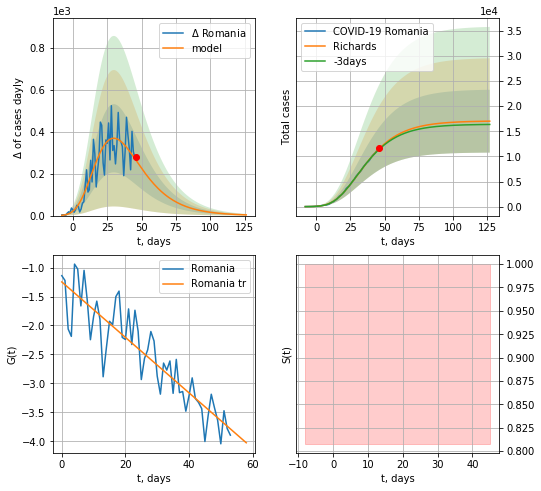

Romania data at: 2020-04-28
+3 day model MAPE: 0.011760208756041604
model: Richards
coeffs:  [ 1.70678310e+04  3.49133069e+00 -3.86733399e+01  1.69429525e-02]
rational stdev:  0.3677543045343233
forecast at the end of period: +81 days
	 deltaDaycases:  3
	 total cases:  17012 ± 6256
	 total death:  970 ± 1070
trend coefficient of determination: 0.805062
 intercept: -1.247136
 slope: -0.047917


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


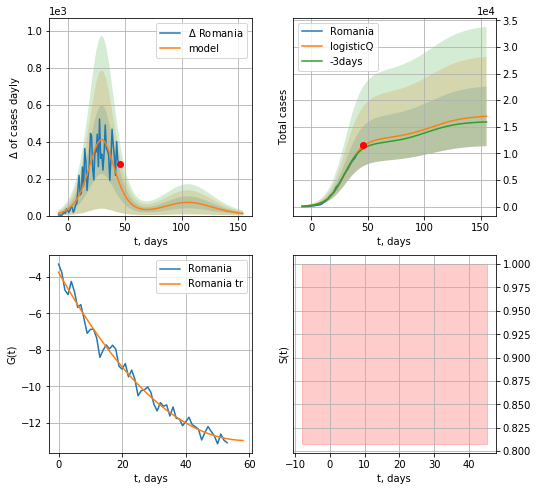

Romania data at: 2020-04-28
+3 day model MAPE: 0.041499
model: logisticQ
coeffs: [ 1.26989032e+04  2.26556971e-06  3.03129734e+01 -5.69358260e+04]
scenario coeffs: [0.35, 0.5, 3.5, 1]
rational stdev: 0.329859
forecast at the end of period: +109 days
	 deltaDaycases: 11
	 total cases: 16963 ± 5595
	 total death: 968 ± 957
trend coefficient of determination: 0.984231
 intercept_: -3.746305401278608
 coeffs_: [ 0.         -0.31253551  0.00264505]


In [320]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.5,1])

In [321]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date   cases  active     death
76 2020-04-24  942909  485986   94668.0
77 2020-04-25  957003  489973   96532.0
78 2020-04-26  968497  470100   97780.0
79 2020-04-27  980633  474133   99402.0
80 2020-04-28  989757  467363  101085.0


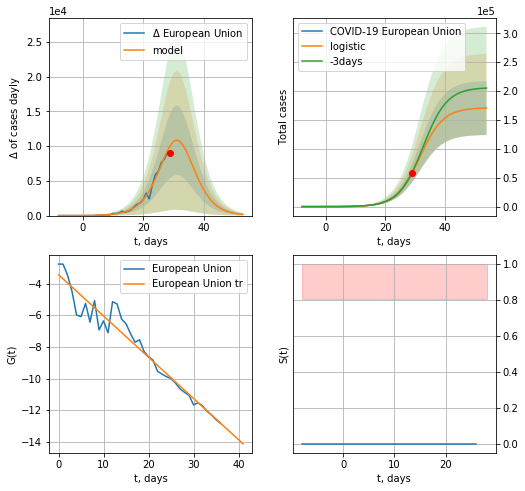

European Union data at: 2020-04-28
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +25 days
	 deltaDaycases:  165
	 total cases:  170630 ± 46772
	 total death:  17426 ± 14330
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


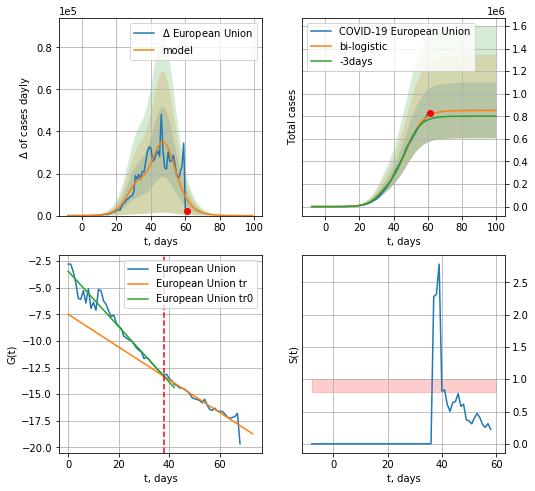

European Union data at: 2020-04-28
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +39 days
	 deltaDaycases:  3
	 total cases:  851736 ± 246596
	 total death:  86988 ± 75554
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


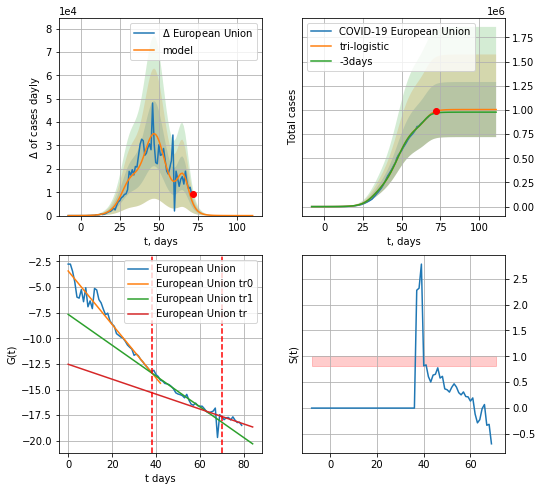

European Union data at: 2020-04-28
+3 day model MAPE: 0.021152856457669914
model: tri-logistic
coeffs:  [1.52161503e+05 3.87362396e-01 6.59627562e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.28381126779805294
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  1003913 ± 284922
	 total death:  102530 ± 87297
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.645235
 intercept: -12.536108
 slope: -0.072791


In [322]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


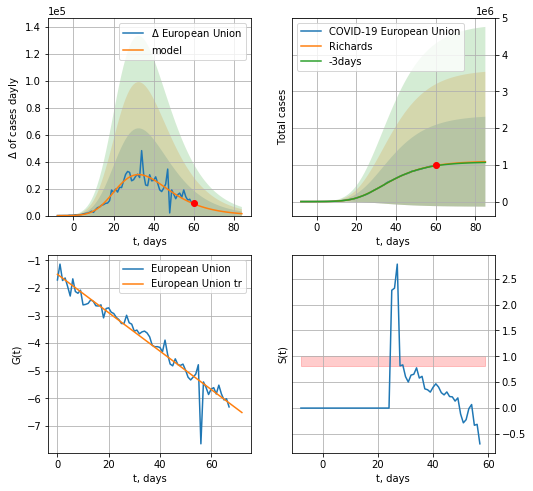

European Union data at: 2020-04-28
+3 day model MAPE: 0.00892085777283988
model: Richards
coeffs:  [1.10345558e+06 6.74949910e-01 5.97023934e+00 1.17474937e-01]
rational stdev:  1.1270104022844394
forecast at the end of period: +25 days
	 deltaDaycases:  1444
	 total cases:  1085774 ± 1223679
	 total death:  110891 ± 374925
trend coefficient of determination: 0.942129
 intercept: -1.504462
 slope: -0.069537


In [323]:
x = forecastRR("European Union",dfEU[12:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


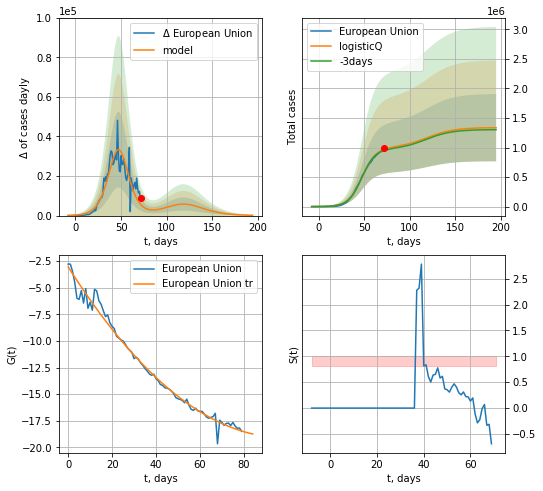

European Union data at: 2020-04-28
+3 day model MAPE: 0.021043
model: logisticQ
coeffs: [ 9.90707002e+05  1.75295075e-06  4.75043849e+01 -7.63695934e+04]
scenario coeffs: [0.35, 0.5, 2.5, 1.0]
rational stdev: 0.425626
forecast at the end of period: +123 days
	 deltaDaycases: 142
	 total cases: 1335386 ± 568375
	 total death: 136384 ± 174145
trend coefficient of determination: 0.985405
 intercept_: -3.0317701145714437
 coeffs_: [ 0.         -0.32645628  0.00165886]


In [326]:
x = forecastRRR("European Union",dfEU[:],d1,22*7-dT,addpred=True,xcoef=[0.35,.5,2.5,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app


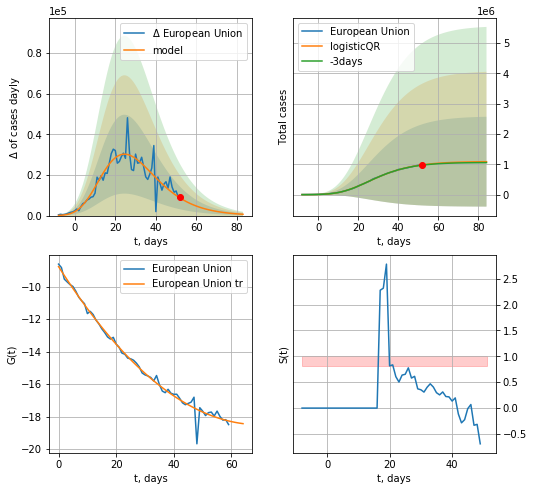

European Union data at: 2020-04-28
+3 day model MAPE: 0.010614742076431899
model: logisticQR
coeffs:  [ 1.09333109e+06  1.40052000e-02 -4.50005589e+01 -3.53411237e+02
  1.20728327e-02]
rational stdev:  1.3647054124712448
forecast at the end of period: +32 days
	 deltaDaycases:  648
	 total cases:  1086842 ± 1483219
	 total death:  111000 ± 454446
trend coefficient of determination: 0.987226
 intercept_: -8.774608252159663
 coeffs_: [ 0.         -0.27873347  0.00199711]


In [327]:
x = forecastQR("European Union",dfEU[20:],d1,9*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [390]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [463]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [391]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [253]:
#dfIC[:]

IC
          date   cases  active  death
54 2020-04-24  1789.5     237  10.00
55 2020-04-25  1790.0     210  10.00
56 2020-04-26  1792.0     174  10.00
57 2020-04-27  1792.5     158  10.01
58 2020-04-28  1795.0     149  10.00


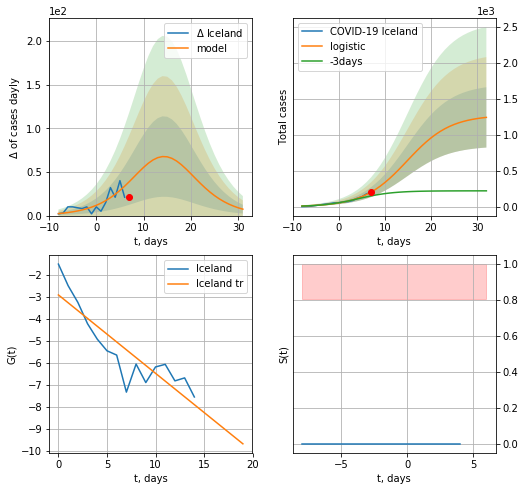

Iceland data at: 2020-04-28
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +25 days
	 deltaDaycases:  7
	 total cases:  1240 ± 418
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


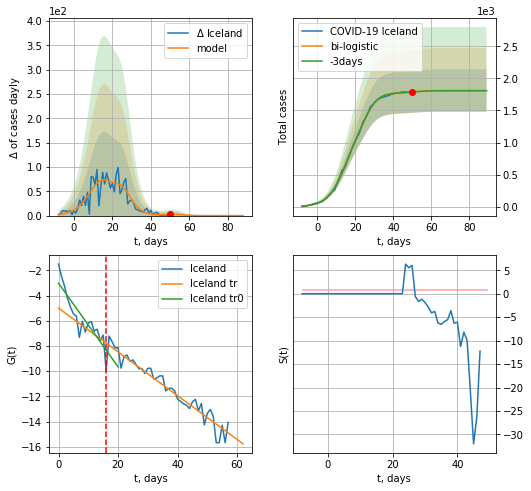

Iceland data at: 2020-04-28
+3 day model MAPE: 0.002491700575997877
model: bi-logistic
coeffs:  [5.07882117e+02 3.00903314e-01 2.59365187e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.1823310685005903
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  1811 ± 330
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.914713
 intercept: -4.997085
 slope: -0.173694


In [328]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


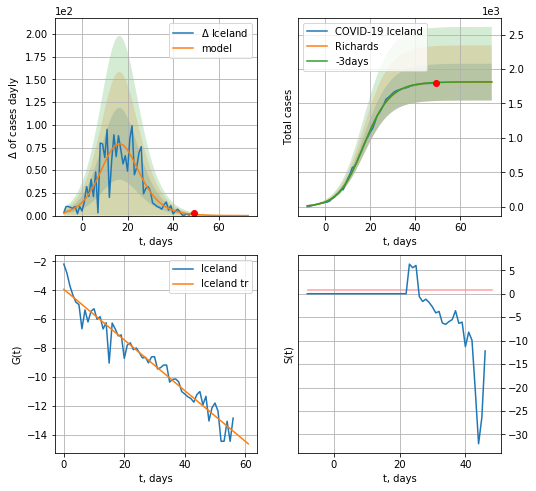

Iceland data at: 2020-04-28
+3 day model MAPE: 0.001457891188893847
model: Richards
coeffs:  [1.80990162e+03 1.98850776e-01 1.58298302e+01 8.36312604e-01]
rational stdev:  0.14755947698504282
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  1809 ± 267
	 total death:  10 ± 4
trend coefficient of determination: 0.944544
 intercept: -3.932794
 slope: -0.175248


In [329]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


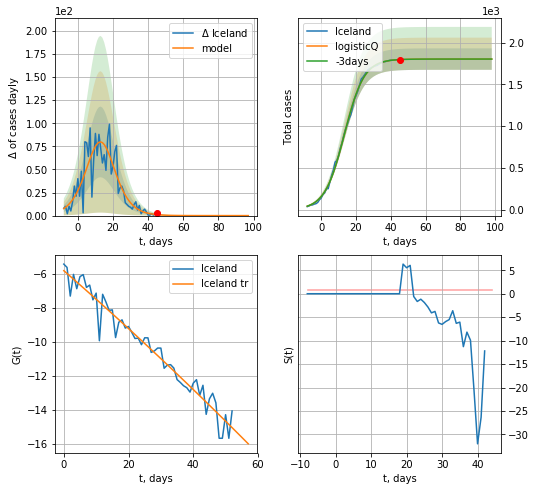

Iceland data at: 2020-04-28
+3 day model MAPE: 0.000174
model: logisticQ
coeffs: [ 1.80206899e+03  9.85156612e-06  1.33204581e+01 -1.79826356e+04]
rational stdev: 0.071287
forecast at the end of period: +53 days
	 deltaDaycases: 0
	 total cases: 1802 ± 128
	 total death: 10 ± 2
trend coefficient of determination: 0.950216
 intercept_: -5.829014520570061
 coeffs_: [ 0.         -0.16543667 -0.00022782]


In [331]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

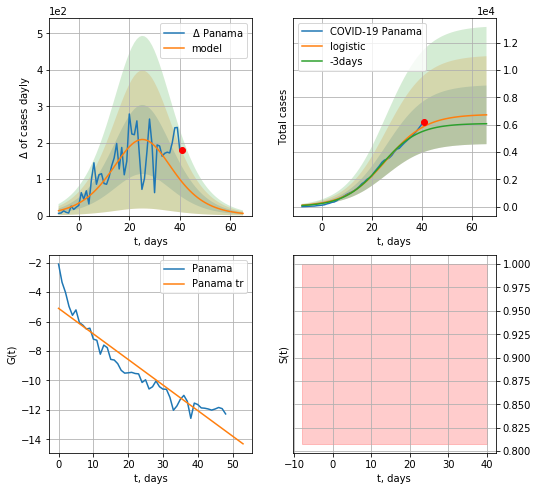

Panama data at: 2020-04-28
+3 day model MAPE: 0.0635269602233699
model: logistic
coeffs:  [6.76859007e+03 1.23563047e-01 2.56945233e+01]
rational stdev:  0.31944059481835607
forecast at the end of period: +25 days
	 deltaDaycases:  6
	 total cases:  6722 ± 2147
	 total death:  190 ± 182
trend coefficient of determination: 0.890138
 intercept: -5.104474
 slope: -0.173646


In [332]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


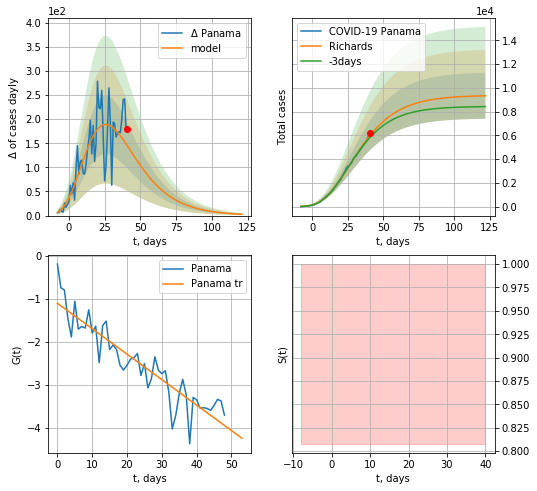

Panama data at: 2020-04-28
+3 day model MAPE: 0.031245662548203348
model: Richards
coeffs:  [ 9.38333273e+03  3.10843816e+00 -4.66304116e+01  1.77840809e-02]
rational stdev:  0.20707775921315164
forecast at the end of period: +81 days
	 deltaDaycases:  2
	 total cases:  9336 ± 1933
	 total death:  265 ± 164
trend coefficient of determination: 0.834390
 intercept: -1.098468
 slope: -0.059170


In [333]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


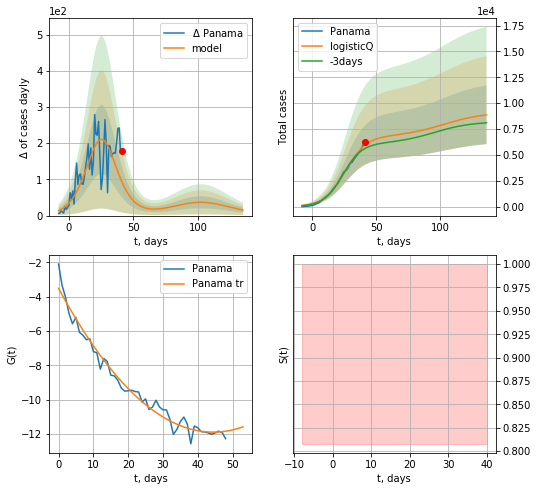

Panama data at: 2020-04-28
+3 day model MAPE: 0.062253
model: logisticQ
coeffs: [ 6.76660219e+03  2.08923063e-06  2.56896276e+01 -5.91254720e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.319522
forecast at the end of period: +95 days
	 deltaDaycases: 15
	 total cases: 8866 ± 2833
	 total death: 251 ± 240
trend coefficient of determination: 0.975594
 intercept_: -3.5094175688630127
 coeffs_: [ 0.         -0.3773501   0.00424463]


In [334]:
x = forecastRRR("Panama",dfPM[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

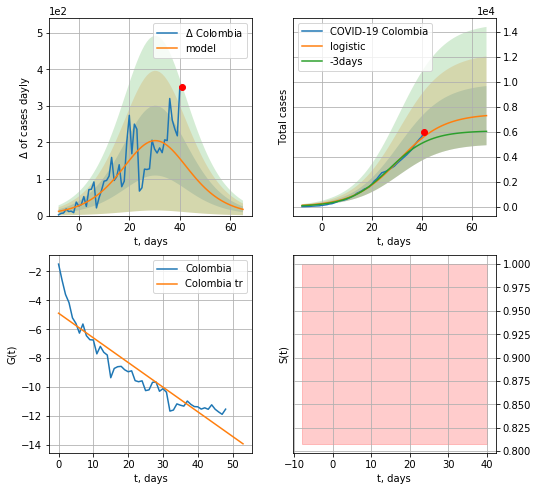

Colombia data at: 2020-04-28
+3 day model MAPE: 0.0960394177268118
model: logistic
coeffs:  [7.42978963e+03 1.10368643e-01 3.07953625e+01]
rational stdev:  0.32506930590779937
forecast at the end of period: +25 days
	 deltaDaycases:  17
	 total cases:  7280 ± 2366
	 total death:  329 ± 320
trend coefficient of determination: 0.860205
 intercept: -4.893526
 slope: -0.170154


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


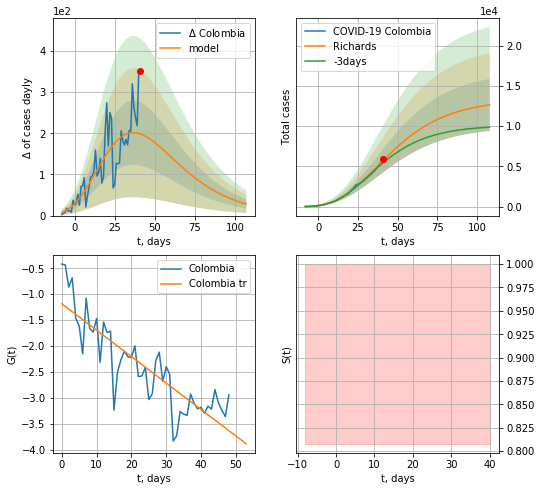

Colombia data at: 2020-04-28
+3 day model MAPE: 0.05381988375651358
model: Richards
coeffs:  [ 1.33218282e+04  2.99501170e+00 -6.63574496e+01  1.38156795e-02]
rational stdev:  0.2555496135244059
forecast at the end of period: +67 days
	 deltaDaycases:  28
	 total cases:  12631 ± 3227
	 total death:  571 ± 437
trend coefficient of determination: 0.729703
 intercept: -1.186429
 slope: -0.050985


In [335]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


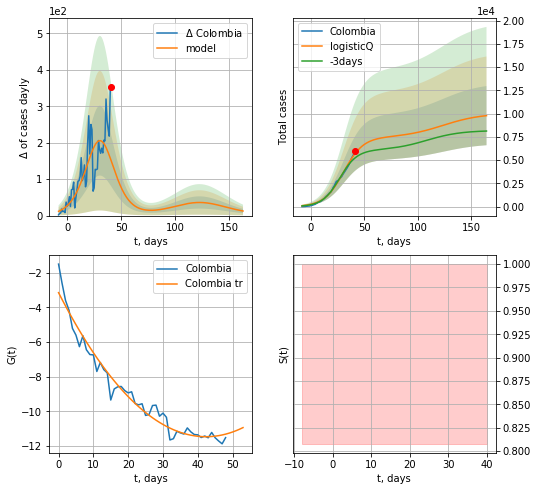

Colombia data at: 2020-04-28
+3 day model MAPE: 0.094687
model: logisticQ
coeffs: [ 7.42309716e+03  3.55842134e-06  3.07783583e+01 -3.10041807e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.325176
forecast at the end of period: +123 days
	 deltaDaycases: 12
	 total cases: 9777 ± 3179
	 total death: 442 ± 431
trend coefficient of determination: 0.962720
 intercept_: -3.1518319251612574
 coeffs_: [ 0.         -0.39258092  0.00463472]


In [336]:
x = forecastRRR("Colombia",dfCB[:],d1,22*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

AR
          date   cases  active  death
51 2020-04-24  3127.0  1304.0  415.0
52 2020-04-25  3256.0  1358.0  419.0
53 2020-04-26  3382.0  1449.0  425.0
54 2020-04-27  3517.0  1527.0  432.0
55 2020-04-28  3649.0  1561.0  437.0


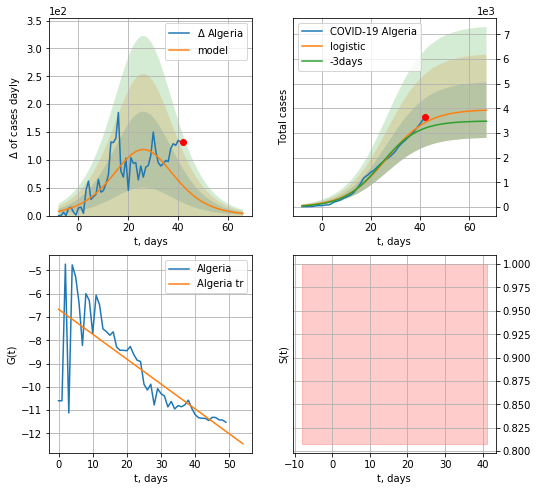

Algeria data at: 2020-04-28
+3 day model MAPE: 0.07575833092027767
model: logistic
coeffs:  [3.96136936e+03 1.19815144e-01 2.65024275e+01]
rational stdev:  0.28628569028491524
forecast at the end of period: +25 days
	 deltaDaycases:  3
	 total cases:  3930 ± 1125
	 total death:  470 ± 403
trend coefficient of determination: 0.601330
 intercept: -6.667592
 slope: -0.107019


In [337]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


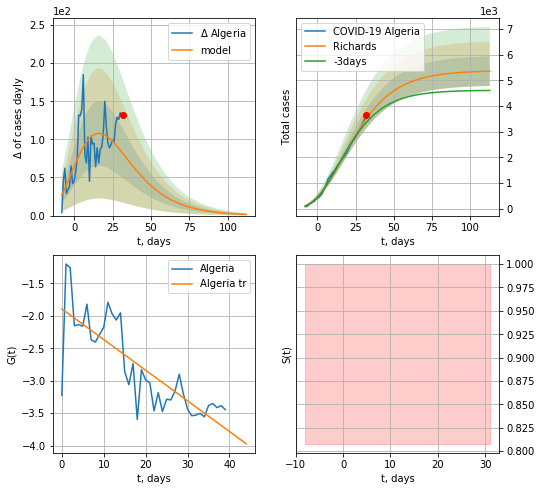

Algeria data at: 2020-04-28
+3 day model MAPE: 0.047089292970884315
model: Richards
coeffs:  [ 5.38284971e+03  3.58944952e+00 -5.95734957e+01  1.52857350e-02]
rational stdev:  0.10714636567550297
forecast at the end of period: +81 days
	 deltaDaycases:  1
	 total cases:  5355 ± 573
	 total death:  641 ± 206
trend coefficient of determination: 0.651678
 intercept: -1.893649
 slope: -0.047245


In [338]:
x = forecastRR("Algeria",dfAR[15:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


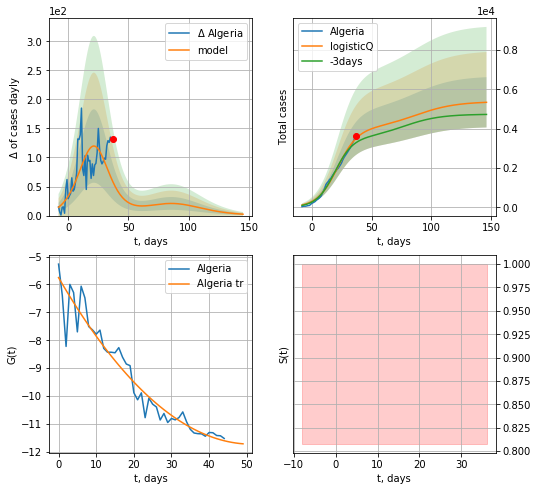

Algeria data at: 2020-04-28
+3 day model MAPE: 0.069452
model: logisticQ
coeffs: [ 3.98961152e+03  2.08775583e-06  2.16500542e+01 -5.67070004e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.239307
forecast at the end of period: +109 days
	 deltaDaycases: 2
	 total cases: 5346 ± 1279
	 total death: 640 ± 459
trend coefficient of determination: 0.931912
 intercept_: -5.753158888010743
 coeffs_: [ 0.         -0.23260698  0.00226436]


In [339]:
x = forecastRRR("Algeria",dfAR[10:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

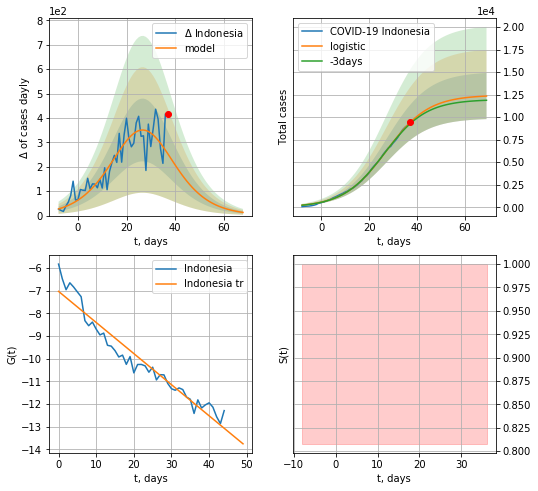

Indonesia data at: 2020-04-28
+3 day model MAPE: 0.016568188718743555
model: logistic
coeffs:  [1.24571047e+04 1.12718591e-01 2.71095572e+01]
rational stdev:  0.20737961222561796
forecast at the end of period: +32 days
	 deltaDaycases:  12
	 total cases:  12347 ± 2560
	 total death:  1003 ± 624
trend coefficient of determination: 0.936166
 intercept: -7.034905
 slope: -0.137172


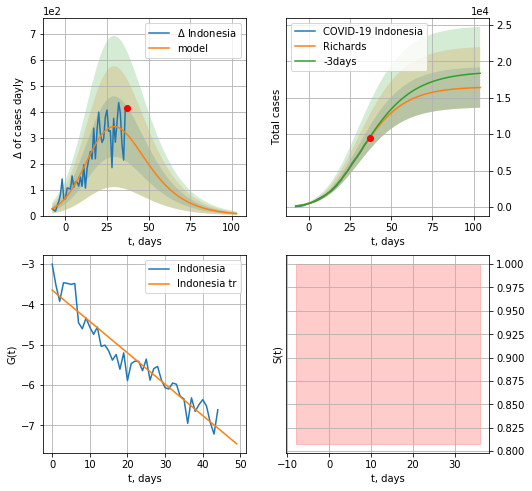

Indonesia data at: 2020-04-28
+3 day model MAPE: 0.011513034233792447
model: Richards
coeffs:  [1.65099364e+04 1.76236062e-01 1.52915218e+01 3.80034551e-01]
rational stdev:  0.16891490757964764
forecast at the end of period: +67 days
	 deltaDaycases:  7
	 total cases:  16396 ± 2769
	 total death:  1332 ± 674
trend coefficient of determination: 0.911259
 intercept: -3.648669
 slope: -0.077699


In [340]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


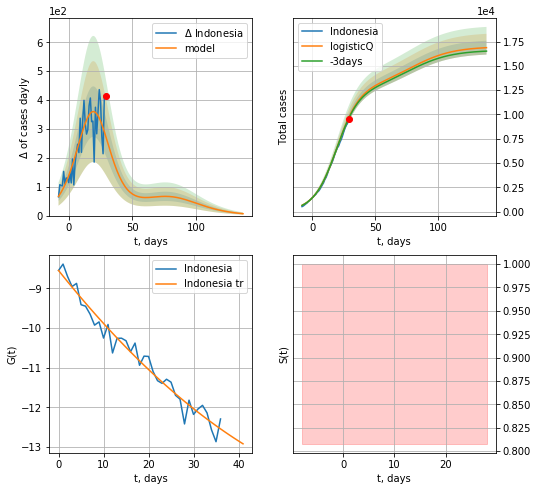

Indonesia data at: 2020-04-28
+3 day model MAPE: 0.008269
model: logisticQ
coeffs: [ 1.25756957e+04  1.03640808e-04  1.93437946e+01 -1.05941415e+03]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.042223
forecast at the end of period: +109 days
	 deltaDaycases: 6
	 total cases: 16877 ± 712
	 total death: 1371 ± 173
trend coefficient of determination: 0.966087
 intercept_: -8.549666116315645
 coeffs_: [ 0.         -0.14215468  0.00086833]


In [341]:
x = forecastRRR("Indonesia",dfIE[13:],d1,20*7-dT,addpred=True,xcoef=[.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


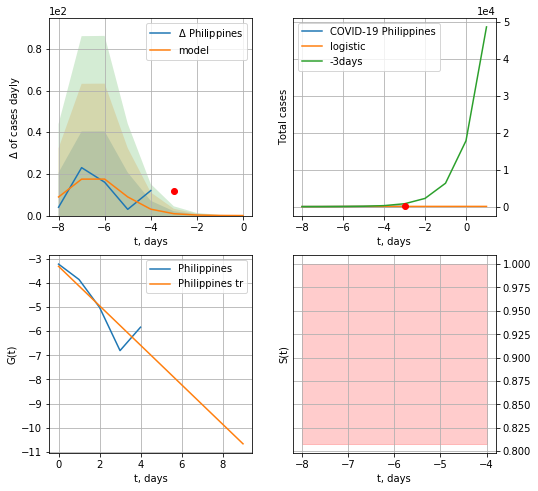

Philippines data at: 2020-04-28
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


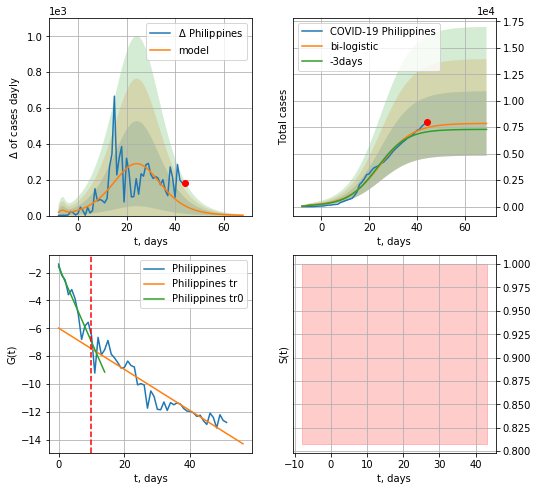

Philippines data at: 2020-04-28
+3 day model MAPE: 0.057957711953561634
model: bi-logistic
coeffs:  [7.80376904e+03 1.48674191e-01 2.47194787e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3868359661554816
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  7854 ± 3038
	 total death:  523 ± 606
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.867254
 intercept: -5.984375
 slope: -0.148573


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:303: RuntimeWarning: overflow encountered in exp


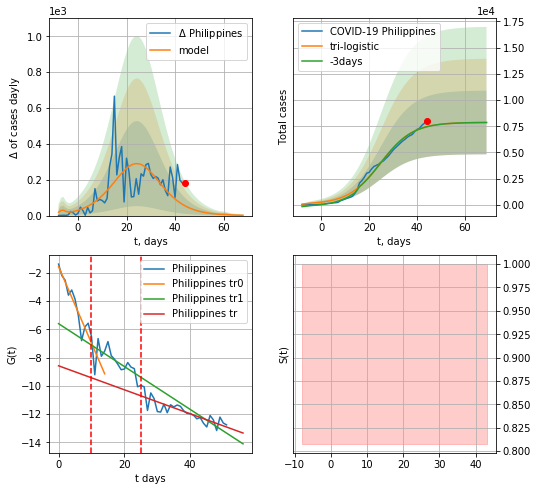

Philippines data at: 2020-04-28
+3 day model MAPE: 5.1777085782925935e-14
model: tri-logistic
coeffs:  [ 3.69874707  1.41520617 61.23653414] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  7.80376904e+03
  1.48674191e-01  2.47194787e+01]
forecast rational stdev:  0.3868359661554813
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  7858 ± 3039
	 total death:  523 ± 606
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.722040
 intercept: -8.583379
 slope: -0.084970


In [342]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,5*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


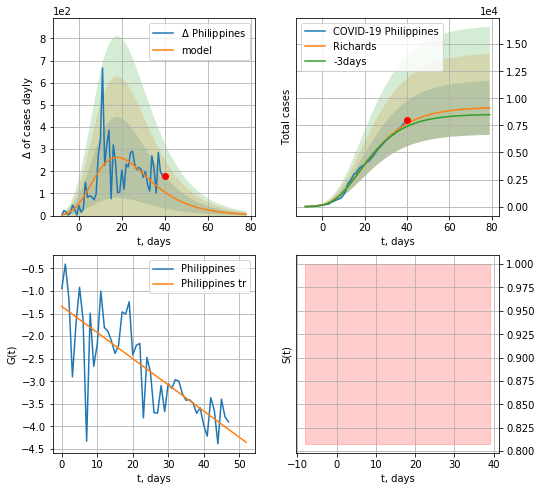

Philippines data at: 2020-04-28
+3 day model MAPE: 0.036205116200648806
model: Richards
coeffs:  [ 9.20049462e+03  6.03617764e+00 -3.72735725e+01  1.29570161e-02]
rational stdev:  0.27311643115801476
forecast at the end of period: +39 days
	 deltaDaycases:  6
	 total cases:  9121 ± 2491
	 total death:  607 ± 497
trend coefficient of determination: 0.606982
 intercept: -1.343092
 slope: -0.057889


In [343]:
x = forecastRR("Philippines",dfPH[4:],d1,10*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


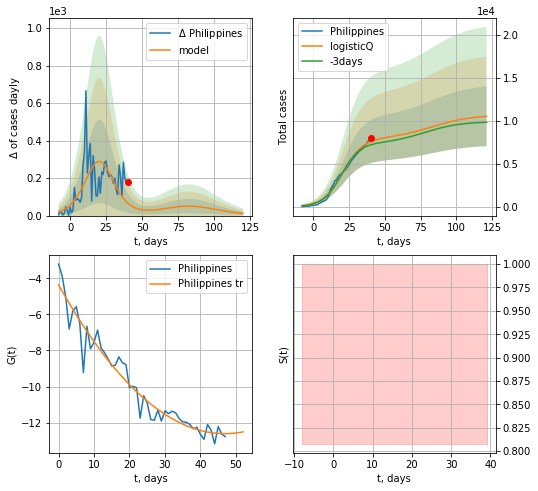

Philippines data at: 2020-04-28
+3 day model MAPE: 0.054403
model: logisticQ
coeffs: [ 7.91953554e+03  1.77460548e-06  2.07026681e+01 -8.16191472e+04]
scenario coeffs: [0.35, 0.5, 4, 1.0]
rational stdev: 0.330370
forecast at the end of period: +81 days
	 deltaDaycases: 11
	 total cases: 10527 ± 3478
	 total death: 701 ± 694
trend coefficient of determination: 0.939560
 intercept_: -4.362813922704585
 coeffs_: [ 0.         -0.35137171  0.00374591]


In [344]:
x = forecastRRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=True,xcoef=[0.35,0.5,4,1.])

GC
          date  cases  active  death
55 2020-04-24   2490    1783  130.0
56 2020-04-25   2506    1799  130.0
57 2020-04-26   2517    1806  134.0
58 2020-04-27   2534    1821  136.0
59 2020-04-28   2566    1851  138.0


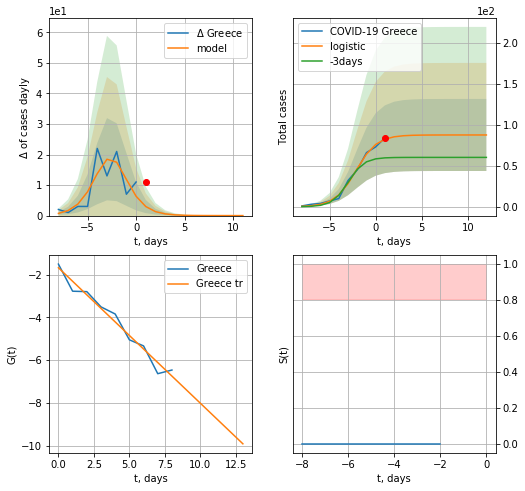

Greece data at: 2020-04-28
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


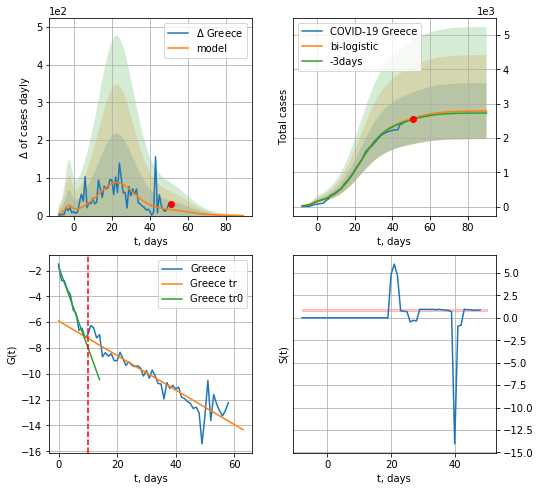

Greece data at: 2020-04-28
+3 day model MAPE: 0.014402511314119964
model: bi-logistic
coeffs:  [2.40004383e+03 1.45334372e-01 2.29402338e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.29341933444484564
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  2786 ± 817
	 total death:  149 ± 131
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.859148
 intercept: -5.910978
 slope: -0.133620


In [345]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

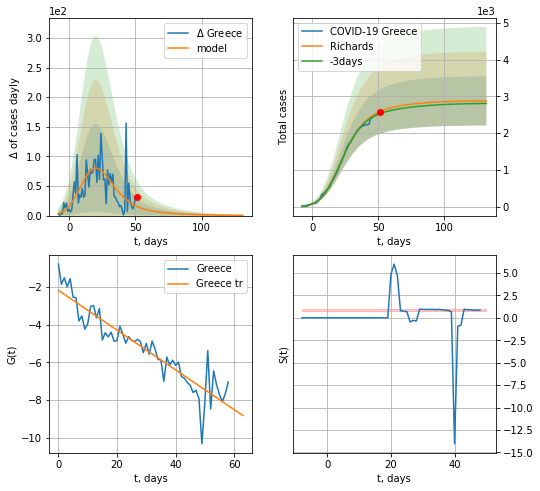

Greece data at: 2020-04-28
+3 day model MAPE: 0.022783115593303916
model: Richards
coeffs:  [2.65699529e+03 2.79210803e-01 9.08500130e+00 3.39506438e-01]
scenario coeffs:  [0.0875, 0.5, 4, 1]
rational stdev:  0.232836458140539
forecast at the end of period: +81 days
	 deltaDaycases:  0
	 total cases:  2882 ± 671
	 total death:  155 ± 108
trend coefficient of determination: 0.851024
 intercept: -2.173106
 slope: -0.105635


In [346]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=True,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


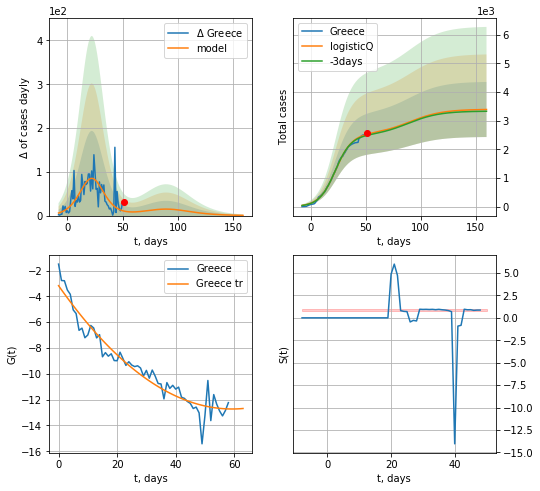

Greece data at: 2020-04-28
+3 day model MAPE: 0.015390
model: logisticQ
coeffs: [ 2.51631124e+03  2.00737413e-06  2.24871723e+01 -6.68706918e+04]
scenario coeffs: [0.35, 0.5, 4, 1]
rational stdev: 0.283399
forecast at the end of period: +109 days
	 deltaDaycases: 0
	 total cases: 3389 ± 960
	 total death: 182 ± 154
trend coefficient of determination: 0.930576
 intercept_: -3.1742085775824442
 coeffs_: [ 0.         -0.32233767  0.00271909]


In [348]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=[.35,.5,4,1])

HG
          date  cases  active  death
49 2020-04-24   2383    1732  250.0
50 2020-04-25   2443    1723  262.0
51 2020-04-26   2583    1805  280.0
52 2020-04-27   2649    1842  291.0
53 2020-04-28   2727    1891  300.0


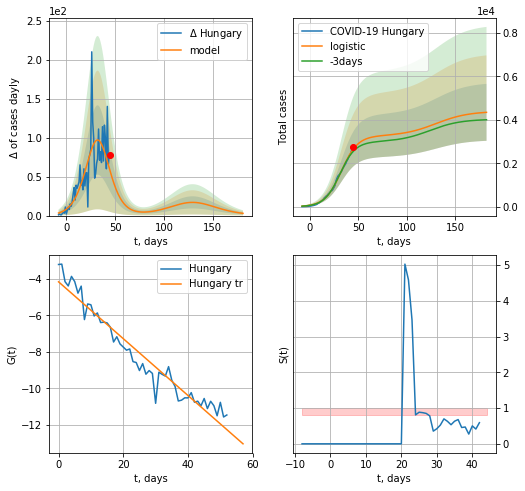

Hungary data at: 2020-04-28
+3 day model MAPE: 0.04454917270661022
model: logistic
coeffs:  [3.25469611e+03 1.18995433e-01 3.24490385e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.3018188304649272
forecast at the end of period: +137 days
	 deltaDaycases:  2
	 total cases:  4345 ± 1311
	 total death:  477 ± 431
trend coefficient of determination: 0.938770
 intercept: -4.169352
 slope: -0.155708


In [349]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


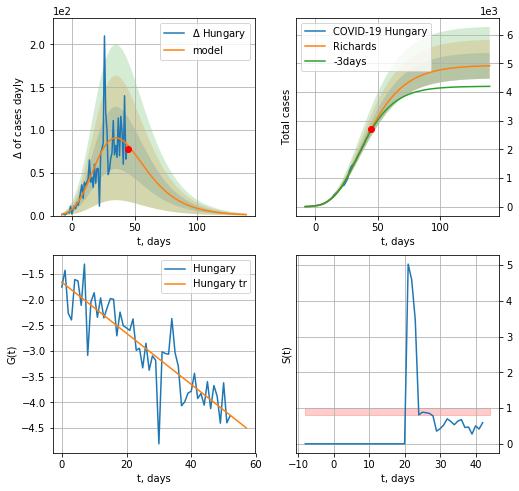

Hungary data at: 2020-04-28
+3 day model MAPE: 0.021261958541398257
model: Richards
coeffs:  [ 4.93711086e+03  5.84510857e-01 -1.06803702e+01  8.93084530e-02]
rational stdev:  0.0917837144023802
forecast at the end of period: +95 days
	 deltaDaycases:  1
	 total cases:  4915 ± 451
	 total death:  540 ± 148
trend coefficient of determination: 0.771659
 intercept: -1.657336
 slope: -0.049779


In [350]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


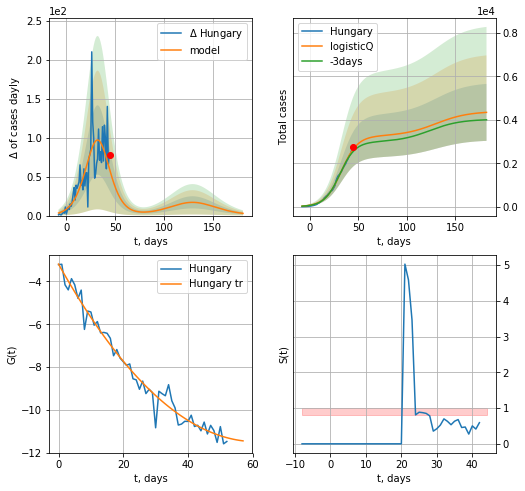

Hungary data at: 2020-04-28
+3 day model MAPE: 0.044660
model: logisticQ
coeffs: [ 3.25257751e+03  3.70689577e-06  3.24376751e+01 -3.20864037e+04]
scenario coeffs: [0.35, 0.5, 4, 1]
rational stdev: 0.302075
forecast at the end of period: +137 days
	 deltaDaycases: 2
	 total cases: 4343 ± 1311
	 total death: 477 ± 432
trend coefficient of determination: 0.974359
 intercept_: -3.1926818644074544
 coeffs_: [ 0.         -0.27065503  0.00221094]


In [351]:
x = forecastRRR("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1],cases='cases')

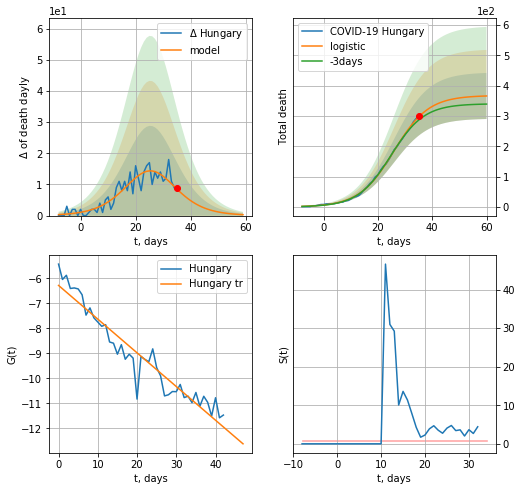

Hungary data at: 2020-04-28
+3 day model MAPE: 0.040292437545533764
model: logistic
coeffs:  [3.67721123e+02 1.56341291e-01 2.58434878e+01]
rational stdev:  0.20754022789647364
forecast at the end of period: +25 days
	 total death:  365 ± 75
trend coefficient of determination: 0.917522
 intercept: -6.278715
 slope: -0.134818


In [352]:
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
47 2020-04-24  447.0     220    4.0
48 2020-04-25  448.0     195    4.0
49 2020-04-26  448.1     162    4.0
50 2020-04-27  450.0     160    4.0
51 2020-04-28  458.0     151    4.0


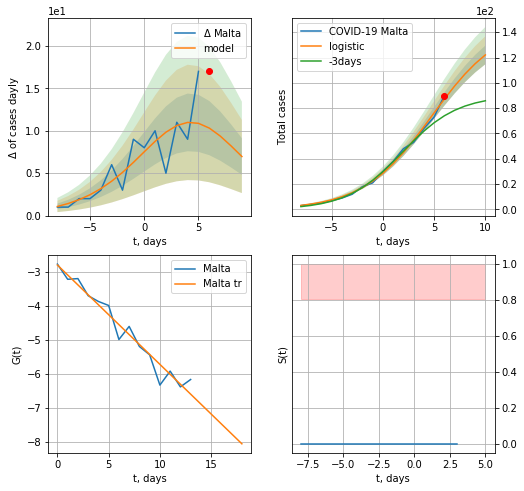

Malta data at: 2020-04-28
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +4 days
	 deltaDaycases:  6
	 total cases:  122 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


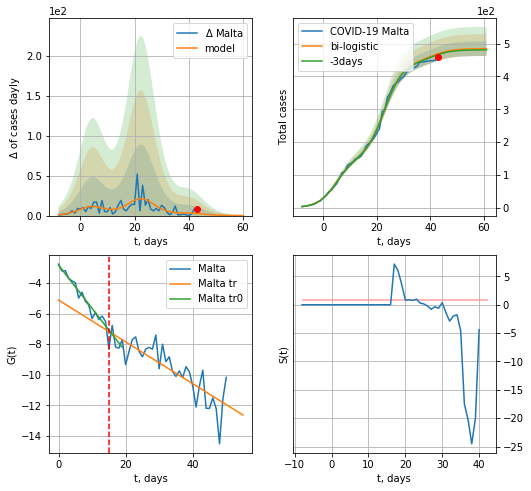

Malta data at: 2020-04-28
+3 day model MAPE: 0.006093633931761518
model: bi-logistic
coeffs:  [2.99536644e+02 2.80237461e-01 2.28742975e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04570783786586073
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  484 ± 22
	 total death:  4 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.701383
 intercept: -5.123238
 slope: -0.136561


In [353]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


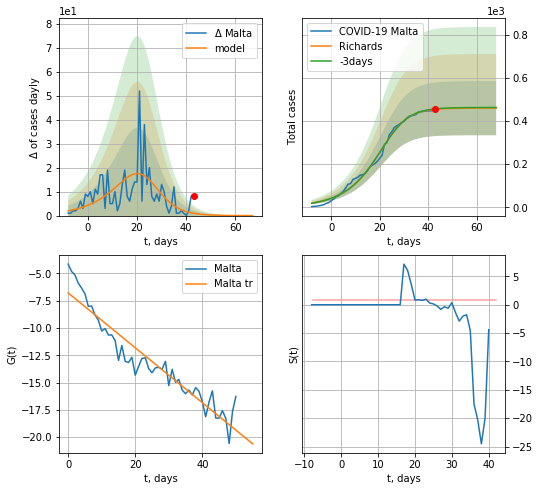

Malta data at: 2020-04-28
+3 day model MAPE: 0.00485839728861799
model: Richards
coeffs:  [4.60461255e+02 9.93034806e-02 2.41628286e+01 1.99389470e+00]
rational stdev:  0.2731683364235192
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  460 ± 125
	 total death:  4 ± 3
trend coefficient of determination: 0.900862
 intercept: -6.788361
 slope: -0.251305


In [354]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


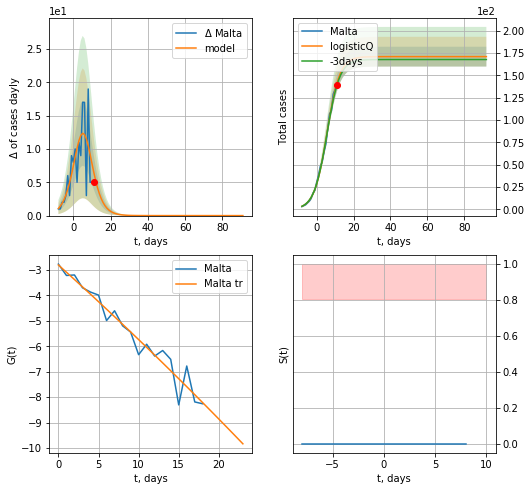

Malta data at: 2020-04-28
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


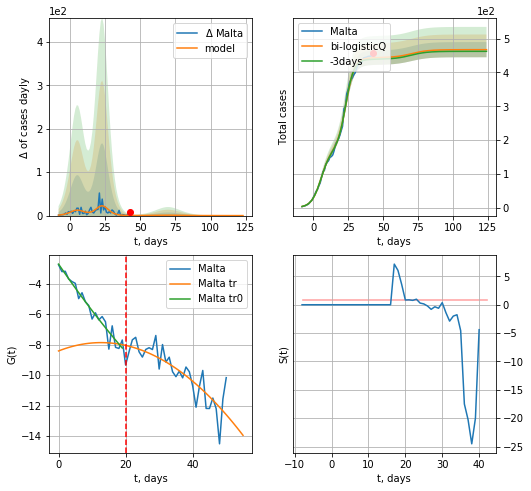

Malta data at: 2020-04-28
+3 day model MAPE: 0.010169284056818148
model: bi-logisticQ
coeffs:  [ 2.72602007e+02  3.61526882e-06  2.34165957e+01 -9.06114048e+04] [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
scenario coeffs:  [0.0875, 0.5, 3, 1.0]
rational stdev:  0.04804896299449223
forecast at the end of period: +81 days
	 deltaDaycases:  0
	 total cases:  467 ± 22
	 total death:  4 ± 0
bi-logistic approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.695772
 intercept_: -8.422544411168559
 coeffs_: [ 0.          0.0862152  -0.00339707]


In [355]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.35/4,.5,3,1.],vL=20)

SL
          date  cases  active  death
45 2020-04-24   1360   988.0  17.00
46 2020-04-25   1373   970.0  17.00
47 2020-04-26   1379   967.0  18.00
48 2020-04-27   1381   960.0  18.01
49 2020-04-28   1384   941.0  20.00


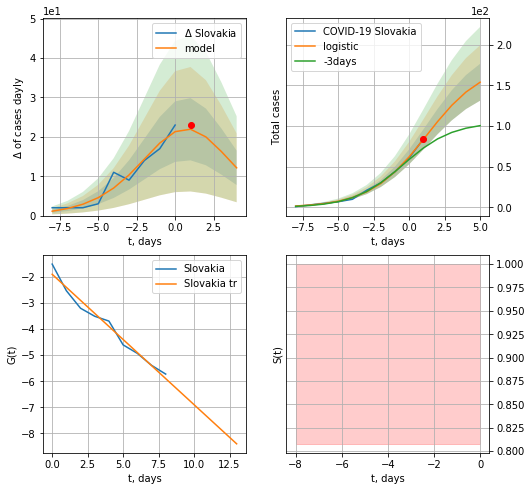

Slovakia data at: 2020-04-28
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +4 days
	 deltaDaycases:  12
	 total cases:  153 ± 22
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


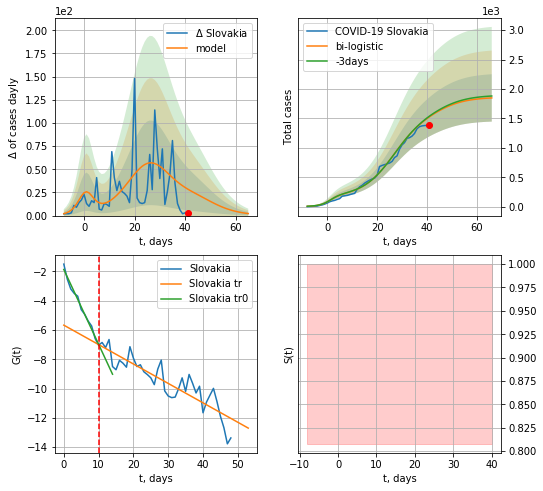

Slovakia data at: 2020-04-28
+3 day model MAPE: 0.008339987818918823
model: bi-logistic
coeffs:  [1.34751547e+03 1.61484261e-01 2.63664896e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.21770832215380642
forecast at the end of period: +25 days
	 deltaDaycases:  2
	 total cases:  1848 ± 402
	 total death:  26 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.784844
 intercept: -5.669460
 slope: -0.132559


In [356]:
dfSL = read_df(pd.DataFrame(),"SL")
x = forecast("Slovakia",dfSL[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


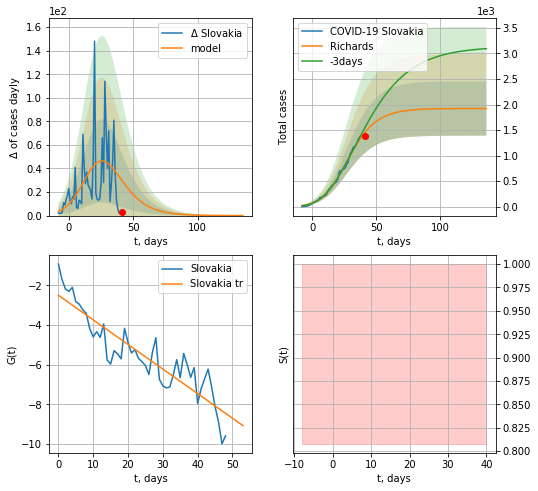

Slovakia data at: 2020-04-28
+3 day model MAPE: 0.0683184413499183
model: Richards
coeffs:  [1.92277597e+03 1.69313811e-01 1.70261184e+01 4.76474738e-01]
rational stdev:  0.2769258213052242
forecast at the end of period: +95 days
	 deltaDaycases:  0
	 total cases:  1922 ± 532
	 total death:  27 ± 22
trend coefficient of determination: 0.810134
 intercept: -2.500145
 slope: -0.123833


In [357]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


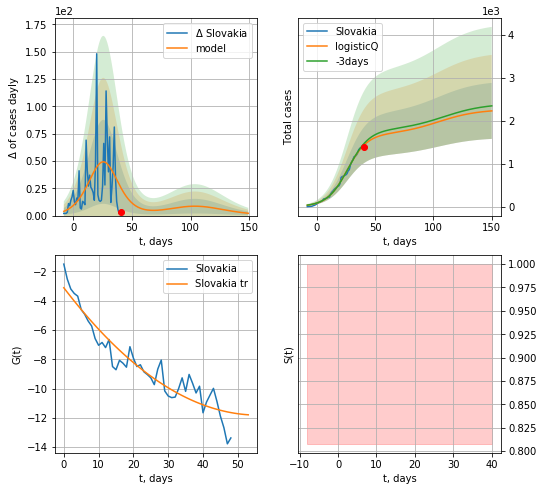

Slovakia data at: 2020-04-28
+3 day model MAPE: 0.027546
model: logisticQ
coeffs: [ 1.68232032e+03  5.76420562e-06  2.60296553e+01 -2.01188583e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.292342
forecast at the end of period: +109 days
	 deltaDaycases: 2
	 total cases: 2233 ± 652
	 total death: 32 ± 28
trend coefficient of determination: 0.891421
 intercept_: -3.1173319871518093
 coeffs_: [ 0.         -0.31090992  0.00277945]


In [358]:
x = forecastRRR("Slovakia",dfSL[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

SV
          date  cases  active  death
50 2020-04-24   1373  1082.0   80.0
51 2020-04-25   1388  1088.0   81.0
52 2020-04-26   1396  1093.0   82.0
53 2020-04-27   1402  1098.0   83.0
54 2020-04-28   1408  1099.0   86.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


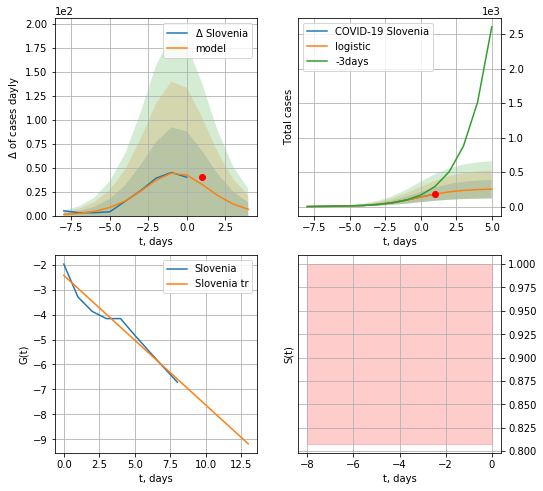

Slovenia data at: 2020-04-28
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +4 days
	 deltaDaycases:  6
	 total cases:  254 ± 135
	 total death:  15 ± 23
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


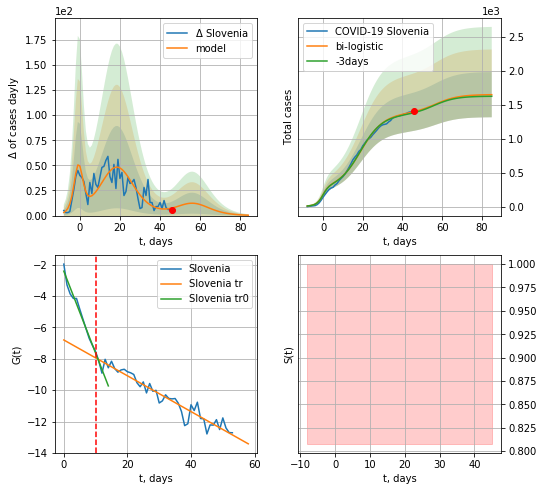

Slovenia data at: 2020-04-28
+3 day model MAPE: 0.010281553872351941
model: bi-logistic
coeffs:  [1.11179709e+03 1.73771423e-01 1.89084660e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.2017539058931803
forecast at the end of period: +39 days
	 deltaDaycases:  0
	 total cases:  1648 ± 332
	 total death:  100 ± 60
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.930430
 intercept: -6.802264
 slope: -0.113962


In [359]:
dfSV = read_df(pd.DataFrame(),"SV")
x = forecast("Slovenia",dfSV[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


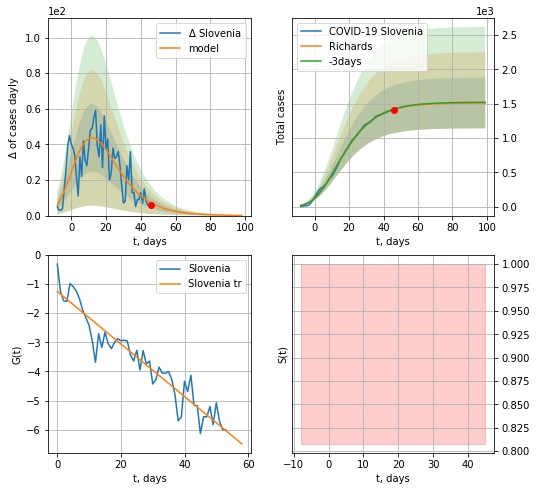

Slovenia data at: 2020-04-28
+3 day model MAPE: 0.003381135380765932
model: Richards
coeffs:  [ 1.50972575e+03  1.08178391e+00 -1.91672109e+01  7.55130731e-02]
rational stdev:  0.24467987950173387
forecast at the end of period: +53 days
	 deltaDaycases:  0
	 total cases:  1508 ± 369
	 total death:  92 ± 67
trend coefficient of determination: 0.907514
 intercept: -1.254456
 slope: -0.090148


In [360]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


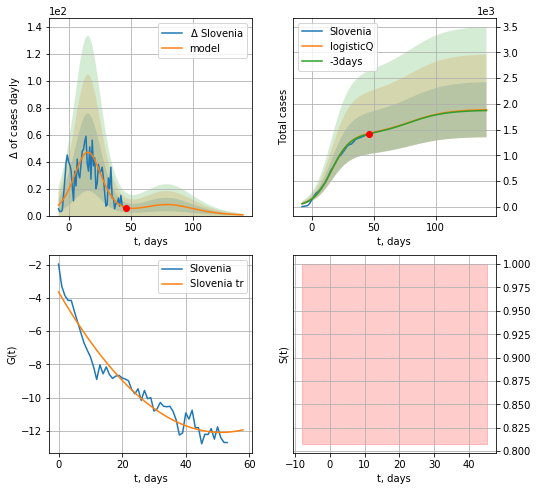

Slovenia data at: 2020-04-28
+3 day model MAPE: 0.007327
model: logisticQ
coeffs: [ 1.40350103e+03  1.67776540e-06  1.58873902e+01 -7.93172005e+04]
scenario coeffs: [0.35, 0.5, 5, 1.0]
rational stdev: 0.284332
forecast at the end of period: +95 days
	 deltaDaycases: 0
	 total cases: 1886 ± 536
	 total death: 115 ± 98
trend coefficient of determination: 0.945902
 intercept_: -3.6480096554204593
 coeffs_: [ 0.         -0.33043433  0.00323086]


In [361]:
x = forecastRRR("Slovenia",dfSV[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,5,1.])

SB
          date  cases  active  death
45 2020-04-24   7483  6245.0  144.0
46 2020-04-25   7779  6476.0  151.0
47 2020-04-26   8042  6704.0  156.0
48 2020-04-27   8275  6904.0  162.0
49 2020-04-28   8497  7069.0  168.0


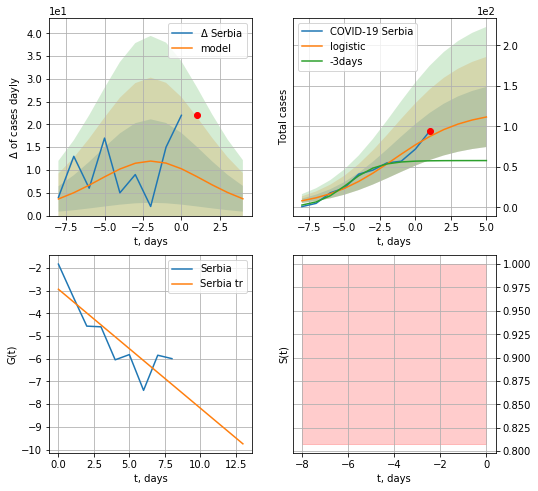

Serbia data at: 2020-04-28
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +4 days
	 deltaDaycases:  3
	 total cases:  111 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


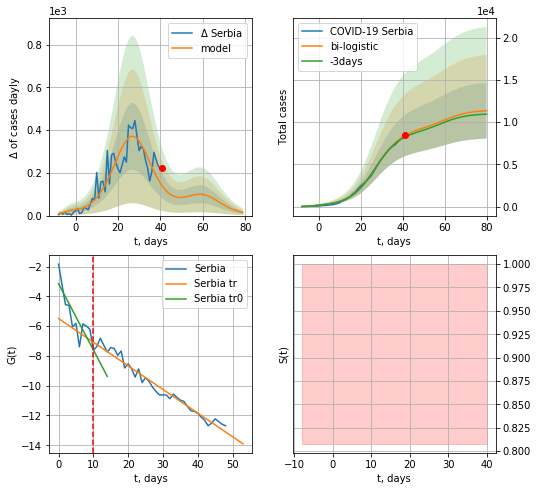

Serbia data at: 2020-04-28
+3 day model MAPE: 0.024115051149841322
model: bi-logistic
coeffs:  [9.06459736e+03 1.63248455e-01 2.73193609e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.29121385216727486
forecast at the end of period: +39 days
	 deltaDaycases:  14
	 total cases:  11364 ± 3309
	 total death:  224 ± 195
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.968458
 intercept: -5.488566
 slope: -0.158798


In [362]:
dfSB = read_df(pd.DataFrame(),"SB")
x = forecast("Serbia",dfSB[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


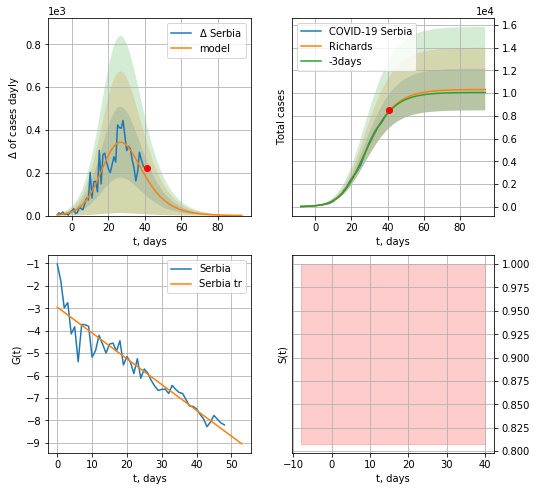

Serbia data at: 2020-04-28
+3 day model MAPE: 0.007628392914916694
model: Richards
coeffs:  [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev:  0.17809001297246044
forecast at the end of period: +53 days
	 deltaDaycases:  0
	 total cases:  10325 ± 1838
	 total death:  204 ± 108
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


In [363]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


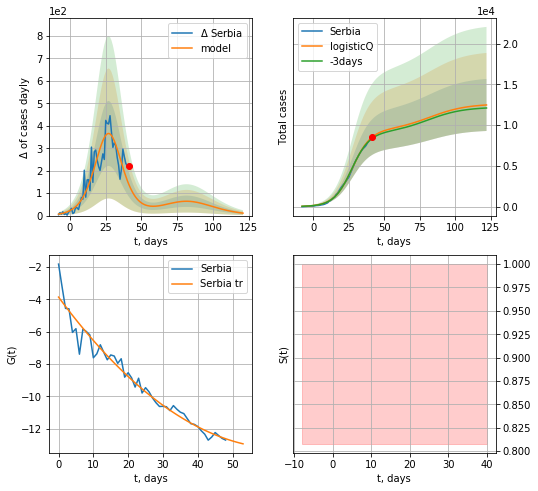

Serbia data at: 2020-04-28
+3 day model MAPE: 0.019896
model: logisticQ
coeffs: [ 9.34800041e+03  6.32532122e-06  2.73845585e+01 -2.45070349e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.255936
forecast at the end of period: +81 days
	 deltaDaycases: 10
	 total cases: 12479 ± 3193
	 total death: 246 ± 188
trend coefficient of determination: 0.959803
 intercept_: -3.868146298176905
 coeffs_: [ 0.         -0.29014905  0.00225087]


In [364]:
x = forecastRRR("Serbia",dfSB[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

CT
          date  cases  active  death
55 2020-04-24   2009   976.0   51.0
56 2020-04-25   2016   928.0   54.0
57 2020-04-26   2030   872.0   55.0
58 2020-04-27   2039   814.0   59.0
59 2020-04-28   2047   752.0   63.0


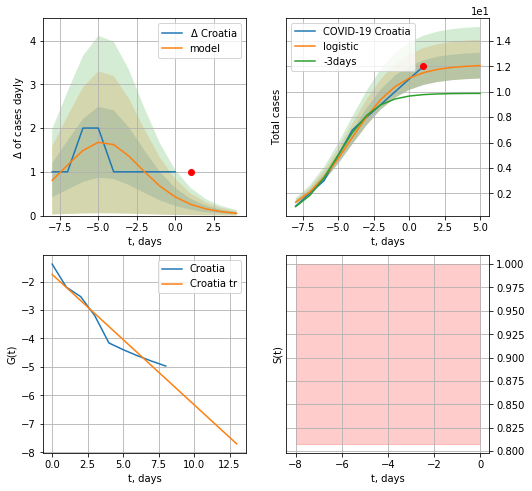

Croatia data at: 2020-04-28
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


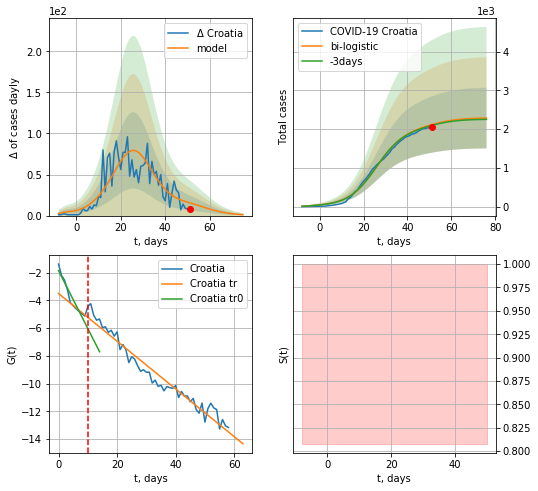

Croatia data at: 2020-04-28
+3 day model MAPE: 0.010691857750133612
model: bi-logistic
coeffs:  [2.02738804e+03 1.55523676e-01 2.59895996e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3427859323209314
forecast at the end of period: +25 days
	 deltaDaycases:  1
	 total cases:  2286 ± 783
	 total death:  70 ± 71
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.953431
 intercept: -3.507125
 slope: -0.172019


In [365]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


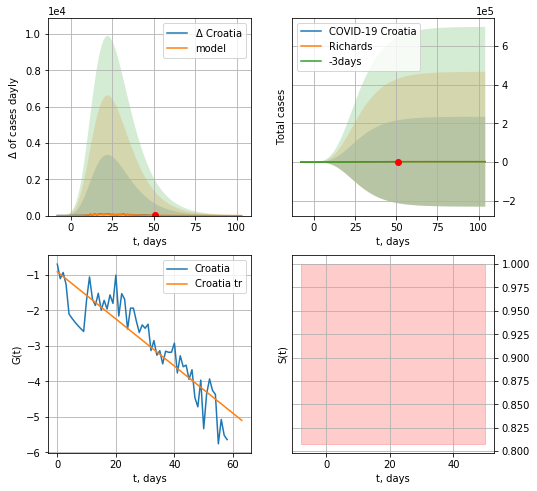

Croatia data at: 2020-04-28
+3 day model MAPE: 0.0017542099382372718
model: Richards
coeffs:  [ 2.23125760e+03  7.01703539e+00 -2.61375352e+01  1.27248175e-02]
rational stdev:  104.12721874348189
forecast at the end of period: +53 days
	 deltaDaycases:  0
	 total cases:  2229 ± 232170
	 total death:  68 ± 21241
trend coefficient of determination: 0.805645
 intercept: -0.918368
 slope: -0.066370


In [366]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


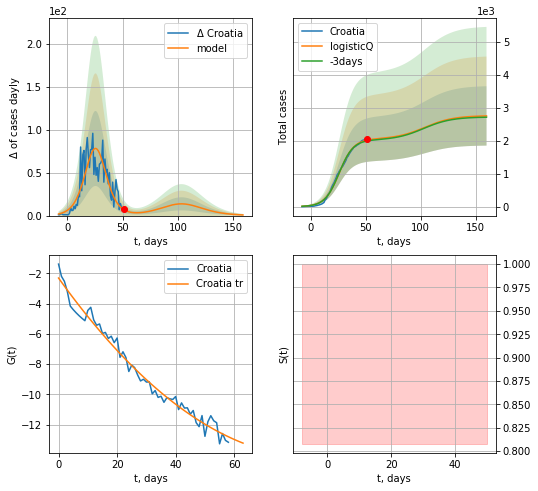

Croatia data at: 2020-04-28
+3 day model MAPE: 0.012701
model: logisticQ
coeffs: [ 2.04443209e+03  1.55950033e-06  2.59275598e+01 -9.81835364e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.326971
forecast at the end of period: +109 days
	 deltaDaycases: 0
	 total cases: 2750 ± 899
	 total death: 84 ± 82
trend coefficient of determination: 0.979356
 intercept_: -2.3075416881358706
 coeffs_: [ 0.         -0.27014997  0.00153721]


In [367]:
x = forecastRRR("Croatia",dfCT[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1])

EG
          date  cases  active  death
49 2020-04-24   4092  2723.0  294.0
50 2020-04-25   4319  2898.0  307.0
51 2020-04-26   4534  3041.0  317.0
52 2020-04-27   4782  3209.0  337.0
53 2020-04-28   5042  3379.0  359.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


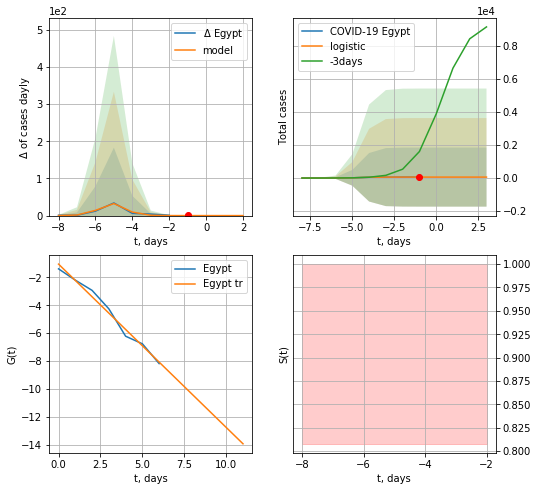

Egypt data at: 2020-04-28
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  4 ± 365
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


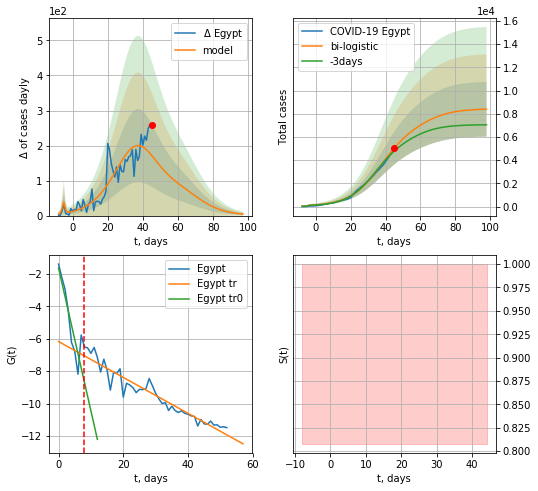

Egypt data at: 2020-04-28
+3 day model MAPE: 0.060027963651313035
model: bi-logistic
coeffs:  [6.69574128e+03 1.13824577e-01 3.69240594e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.281411649973848
forecast at the end of period: +53 days
	 deltaDaycases:  4
	 total cases:  8392 ± 2361
	 total death:  597 ± 504
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.920655
 intercept: -6.170537
 slope: -0.110854


In [368]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,5*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

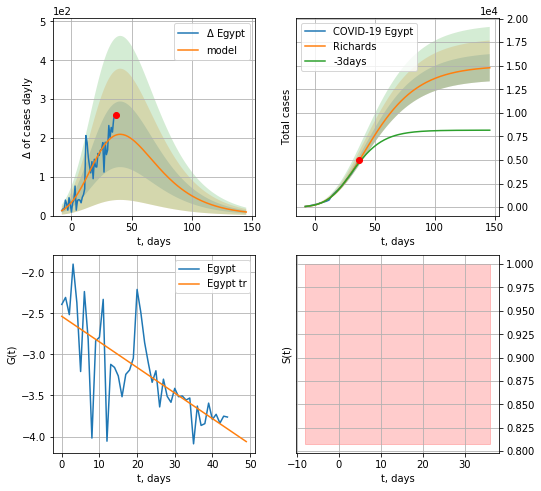

Egypt data at: 2020-04-28
+3 day model MAPE: 0.05204335078737003
model: Richards
coeffs:  [ 1.50207298e+04  4.23815140e-01 -1.88174282e+01  9.35411086e-02]
rational stdev:  0.09762947316972327
forecast at the end of period: +109 days
	 deltaDaycases:  9
	 total cases:  14789 ± 1443
	 total death:  1053 ± 308
trend coefficient of determination: 0.519701
 intercept: -2.536853
 slope: -0.031107


In [371]:
x = forecastRR("Egypt",dfEG[8:],d1,20*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


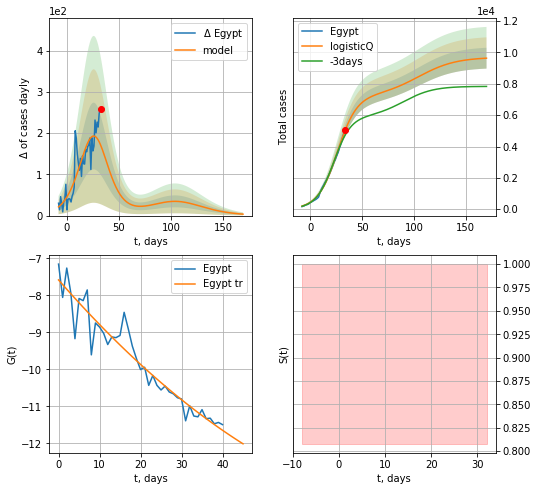

Egypt data at: 2020-04-28
+3 day model MAPE: 0.068798
model: logisticQ
coeffs: [ 7.18126520e+03  3.89737785e-05  2.59858497e+01 -2.70805394e+03]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.068997
forecast at the end of period: +137 days
	 deltaDaycases: 3
	 total cases: 9634 ± 664
	 total death: 685 ± 141
trend coefficient of determination: 0.913964
 intercept_: -7.5824506557326945
 coeffs_: [ 0.         -0.12665815  0.00062855]


In [372]:
x = forecastRRR("Egypt",dfEG[12:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,4.,1])

IQ
          date  cases  active  death
52 2020-04-24   1708   418.0   86.0
53 2020-04-25   1763   453.0   86.0
54 2020-04-26   1820   470.0   87.0
55 2020-04-27   1847   473.0   88.0
56 2020-04-28   1928   519.0   90.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


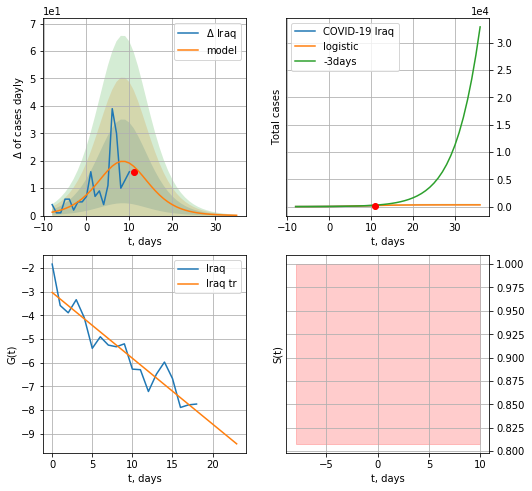

Iraq data at: 2020-04-28
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  316 ± 65
	 total death:  14 ± 8
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


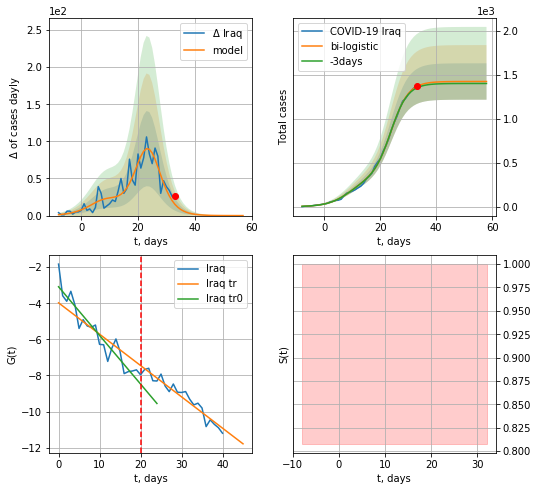

Iraq data at: 2020-04-28
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  66 ± 28
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


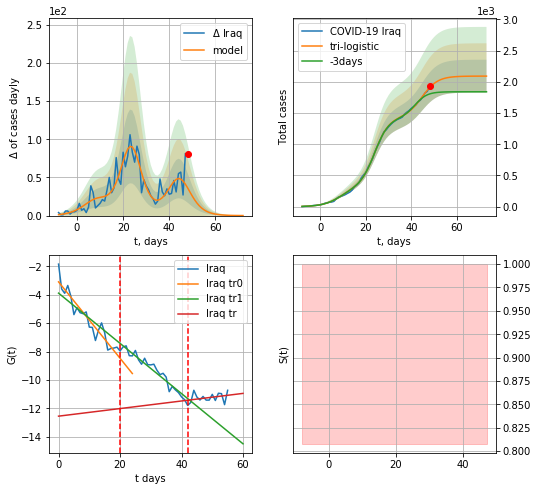

Iraq data at: 2020-04-28
+3 day model MAPE: 0.06999665086562816
model: tri-logistic
coeffs:  [6.65280200e+02 2.89994708e-01 4.46922679e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.12563190711622307
forecast at the end of period: +25 days
	 deltaDaycases:  0
	 total cases:  2090 ± 262
	 total death:  97 ± 36
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.103879
 intercept: -12.557768
 slope: 0.026758


In [373]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

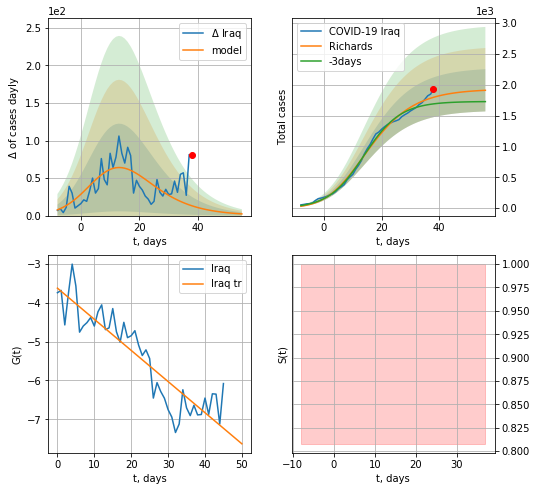

Iraq data at: 2020-04-28
+3 day model MAPE: 0.06723626368875324
model: Richards
coeffs:  [1.92886818e+03 2.78728689e-01 4.65155942e+00 3.84774459e-01]
rational stdev:  0.17927418393526487
forecast at the end of period: +18 days
	 deltaDaycases:  2
	 total cases:  1908 ± 342
	 total death:  89 ± 47
trend coefficient of determination: 0.819845
 intercept: -3.629121
 slope: -0.079991


In [374]:
x = forecastRR("Iraq",dfIQ[10:],d1,7*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


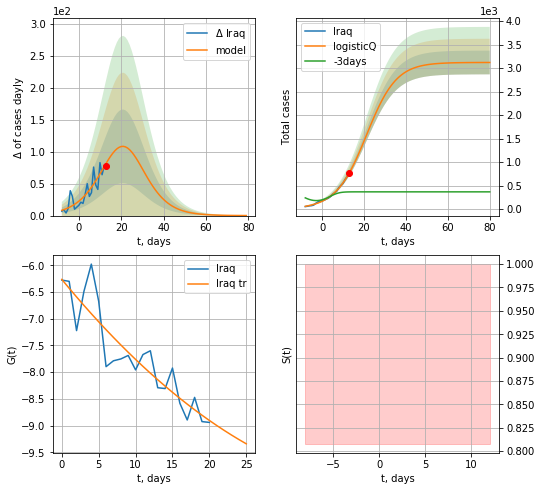

Iraq data at: 2020-04-28
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 3119 ± 252
	 total death: 145 ± 35
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


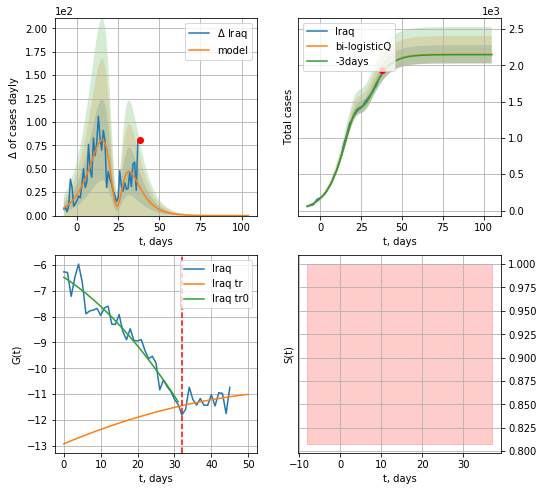

Iraq data at: 2020-04-28
+3 day model MAPE: 0.0029757556380127937
model: bi-logisticQ
coeffs:  [-9.69321621e+02  8.31882667e-06  2.42679251e+01 -4.64055388e+04] [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev:  0.05836732663717361
forecast at the end of period: +67 days
	 deltaDaycases:  0
	 total cases:  2150 ± 125
	 total death:  100 ± 17
bi-logistic approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.106772
 intercept_: -12.91618706702739
 coeffs_: [ 0.          0.05990665 -0.00043393]


In [375]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,14*7-dT,x,addpred=False,xcoef=[0.35,.5,4.,1],vL=32)

In [347]:
#len(dfAR)

AR
          date   cases  active  death
51 2020-04-24  3127.0  1304.0  415.0
52 2020-04-25  3256.0  1358.0  419.0
53 2020-04-26  3382.0  1449.0  425.0
54 2020-04-27  3517.0  1527.0  432.0
55 2020-04-28  3649.0  1561.0  437.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


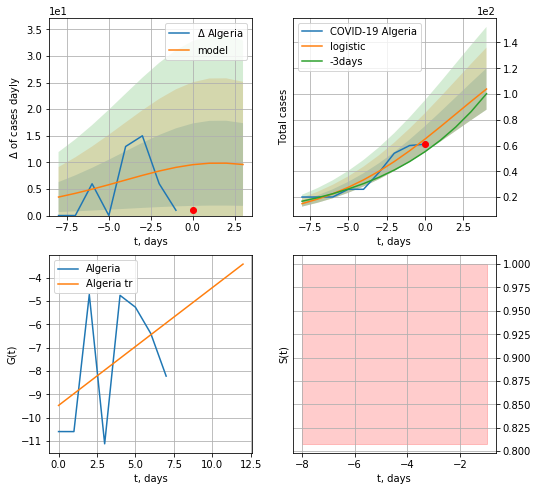

Algeria data at: 2020-04-28
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +4 days
	 deltaDaycases:  9
	 total cases:  103 ± 16
	 total death:  12 ± 5
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


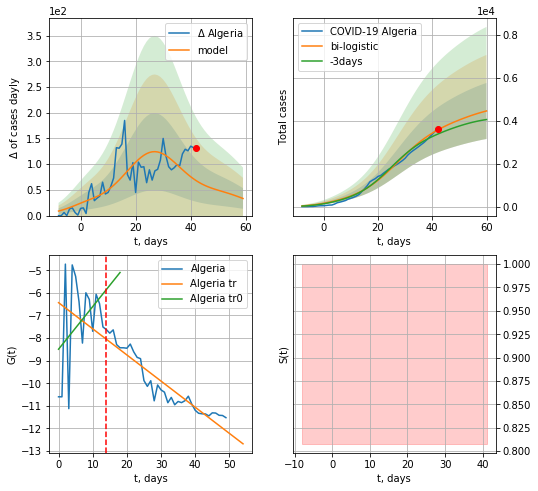

Algeria data at: 2020-04-28
+3 day model MAPE: 0.060105923210550326
model: bi-logistic
coeffs:  [3.70786305e+03 1.30317130e-01 2.69482553e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2915901734562956
forecast at the end of period: +18 days
	 deltaDaycases:  33
	 total cases:  4466 ± 1302
	 total death:  534 ± 467
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.888863
 intercept: -6.433404
 slope: -0.115643


In [376]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,5*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


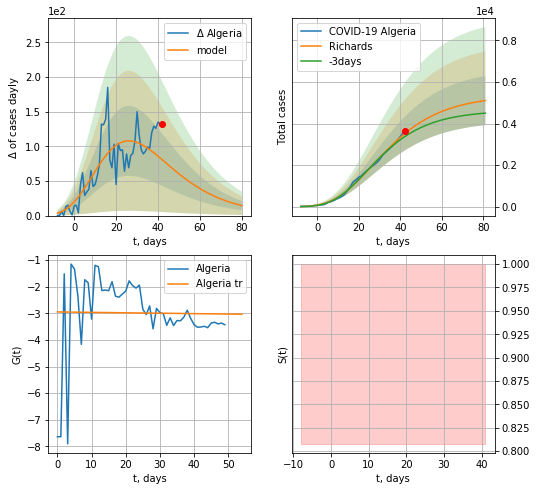

Algeria data at: 2020-04-28
+3 day model MAPE: 0.04599118906716142
model: Richards
coeffs:  [ 5.36535283e+03  4.22870499e+00 -5.23890885e+01  1.30098982e-02]
rational stdev:  0.23124866247652232
forecast at the end of period: +39 days
	 deltaDaycases:  14
	 total cases:  5103 ± 1180
	 total death:  611 ± 423
trend coefficient of determination: 0.000264
 intercept: -2.945734
 slope: -0.001594


In [377]:
x = forecastRR("Algeria",dfAR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


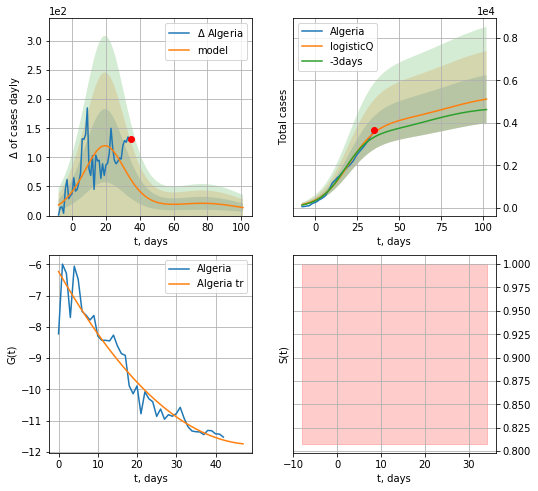

Algeria data at: 2020-04-28
+3 day model MAPE: 0.065781
model: logisticQ
coeffs: [ 4.01043570e+03  1.88972208e-06  1.97571629e+01 -6.21362392e+04]
scenario coeffs: [0.35, 0.5, 4, 1]
rational stdev: 0.221055
forecast at the end of period: +67 days
	 deltaDaycases: 13
	 total cases: 5125 ± 1132
	 total death: 613 ± 406
trend coefficient of determination: 0.920150
 intercept_: -6.2325860176356525
 coeffs_: [ 0.         -0.2210102   0.00221111]


In [378]:
x = forecastRRR("Algeria",dfAR[12:],d1,14*7-dT,addpred=True,xcoef=[0.35,.5,4,1])

CP
          date  cases  active  death
43 2020-04-24  804.0   692.0   14.0
44 2020-04-25  810.0   648.0   14.0
45 2020-04-26  817.0   655.0   14.0
46 2020-04-27  822.0   659.0   15.0
47 2020-04-28  837.0   674.0   15.0


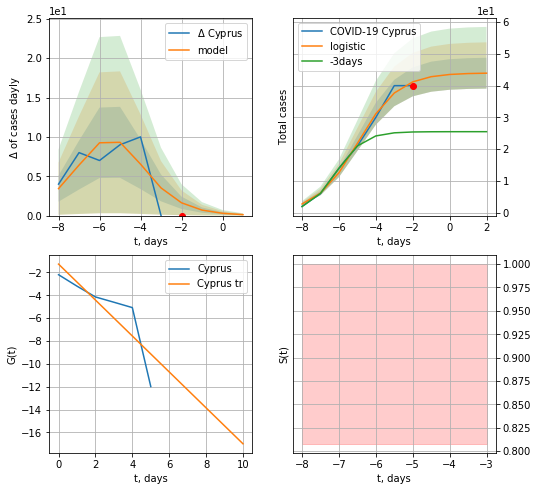

Cyprus data at: 2020-04-28
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


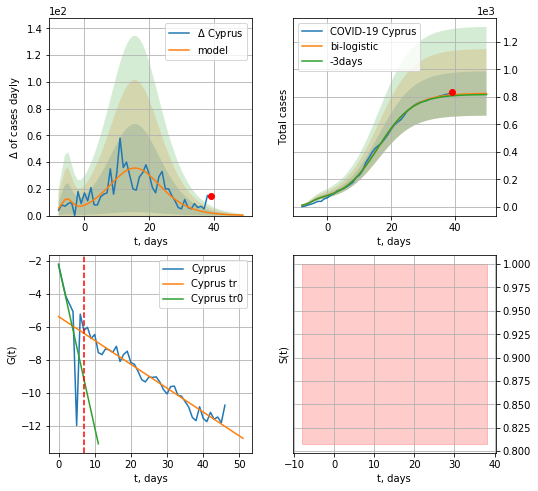

Cyprus data at: 2020-04-28
+3 day model MAPE: 0.009074642080729169
model: bi-logistic
coeffs:  [7.83003778e+02 1.81949337e-01 1.60565645e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19563373915196233
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  825 ± 161
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.945029
 intercept: -5.376580
 slope: -0.144763


In [379]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,5*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

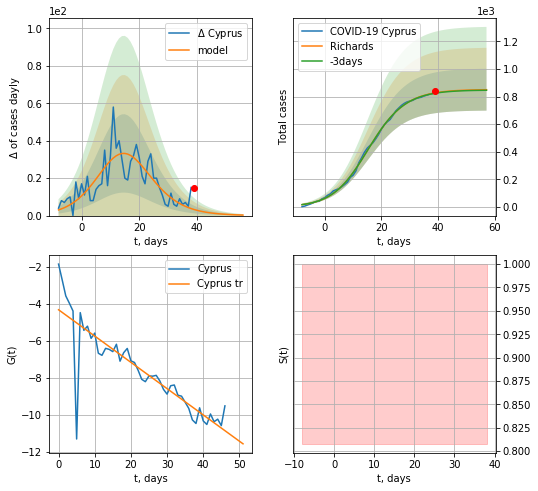

Cyprus data at: 2020-04-28
+3 day model MAPE: 0.0033209423738720955
model: Richards
coeffs:  [8.51260479e+02 1.80567704e-01 1.37068754e+01 8.16859323e-01]
rational stdev:  0.17860493631651392
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  849 ± 151
	 total death:  15 ± 8
trend coefficient of determination: 0.751528
 intercept: -4.332668
 slope: -0.141858


In [380]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


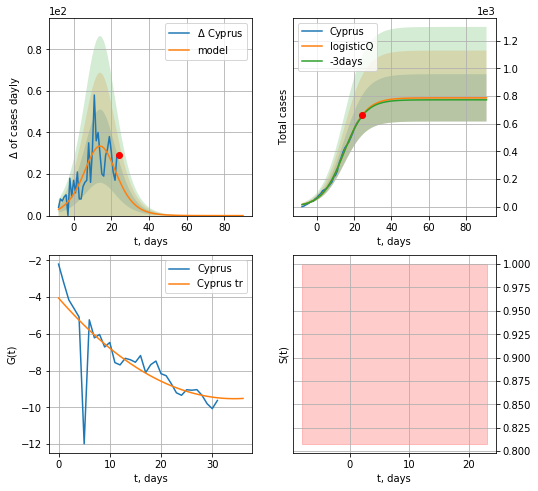

Cyprus data at: 2020-04-28
+3 day model MAPE: 0.008666
model: logisticQ
coeffs: [ 7.86933590e+02  3.03875092e-05  1.45305417e+01 -5.58419278e+03]
rational stdev: 0.216927
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 786 ± 170
	 total death: 14 ± 9
trend coefficient of determination: 0.632228
 intercept_: -4.043371209278041
 coeffs_: [ 0.         -0.3198961   0.00466577]


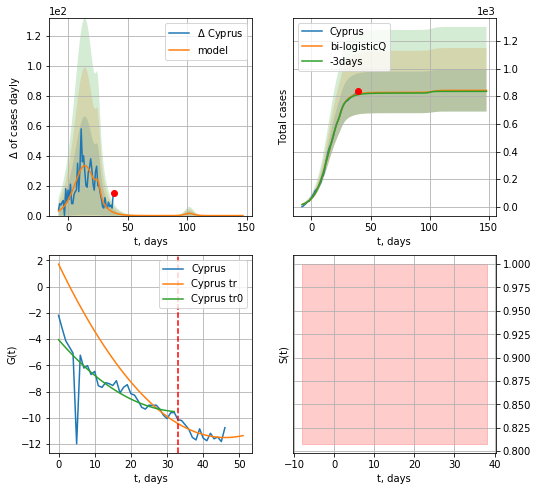

Cyprus data at: 2020-04-28
+3 day model MAPE: 0.006621742305054235
model: bi-logisticQ
coeffs:  [ 4.09240301e+01  3.00474285e-06  2.55908970e+01 -2.75507385e+05] [ 7.86933590e+02  3.03875092e-05  1.45305417e+01 -5.58419278e+03]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.18159998067557356
forecast at the end of period: +109 days
	 deltaDaycases:  0
	 total cases:  842 ± 152
	 total death:  15 ± 8
bi-logistic approximation splitting point: 33
trend coefficient of determination: 0.643220
 intercept_: -4.049645443257546
 coeffs_: [ 0.         -0.3182045   0.00459802]
trend coefficient of determination: 0.536376
 intercept_: 1.7063000801234214
 coeffs_: [ 0.         -0.57348306  0.00622315]


In [390]:
vL=33
x = forecastRRR("Cyprus",dfCP[:vL],d1,14*7-dT,addpred=False,xcoef=[0.35/4,.5,4,1])
xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active  death
48 2020-04-24  21648  13518.0  634.0
49 2020-04-25  25331  16834.0  700.0
50 2020-04-26  27517  18701.0  728.0
51 2020-04-27  28699  19492.0  782.0
52 2020-04-28  31190  21157.0  854.0


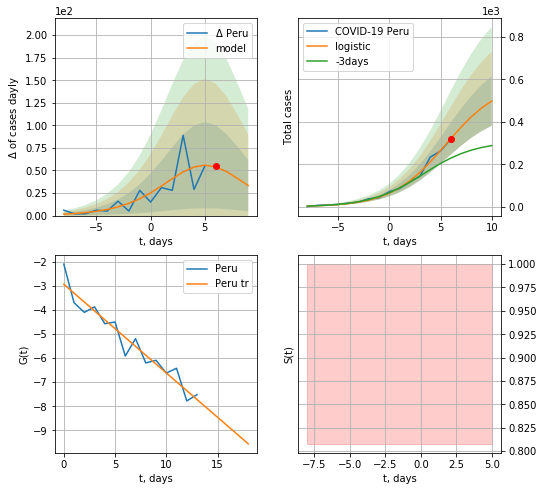

Peru data at: 2020-04-28
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +4 days
	 deltaDaycases:  33
	 total cases:  498 ± 116
	 total death:  13 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


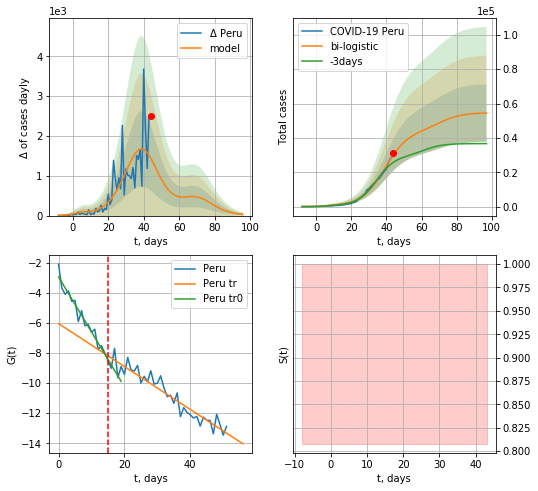

Peru data at: 2020-04-28
+3 day model MAPE: 0.19352482517951525
model: bi-logistic
coeffs:  [4.32519370e+04 1.53957127e-01 3.91524976e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3069064612986573
forecast at the end of period: +53 days
	 deltaDaycases:  30
	 total cases:  54468 ± 16716
	 total death:  1491 ± 1372
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.903657
 intercept: -6.049551
 slope: -0.142556


In [391]:
dfPU = read_df(pd.DataFrame(),"PU")
x = forecast("Peru",dfPU[:15],d1,5*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


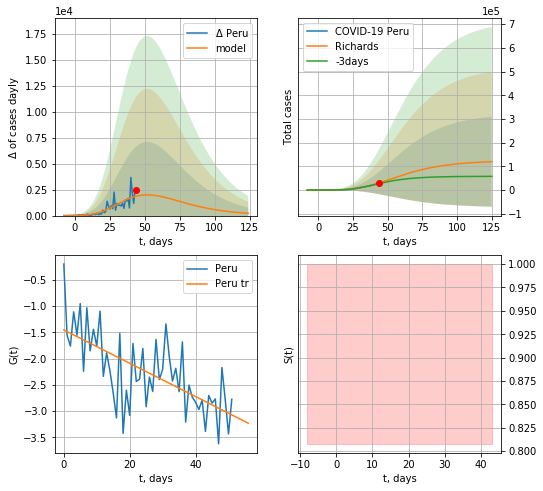

Peru data at: 2020-04-28
+3 day model MAPE: 0.10835989021491992
model: Richards
coeffs:  [ 1.24582624e+05  1.85200868e+00 -3.25629574e+01  2.38169996e-02]
rational stdev:  1.5838491886349473
forecast at the end of period: +81 days
	 deltaDaycases:  216
	 total cases:  119670 ± 189539
	 total death:  3276 ± 15566
trend coefficient of determination: 0.431109
 intercept: -1.453504
 slope: -0.031711


In [392]:
x = forecastRR("Peru",dfPU[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


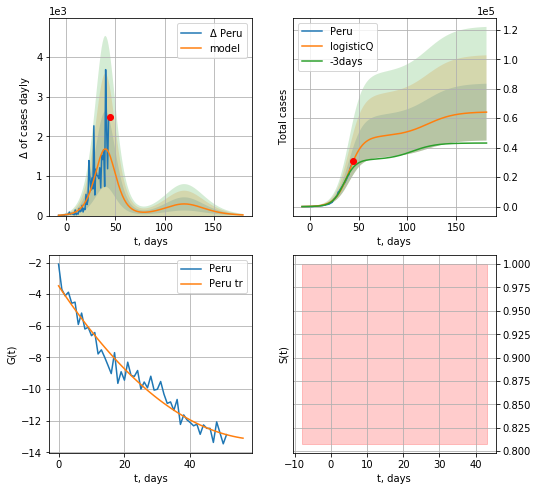

Peru data at: 2020-04-28
+3 day model MAPE: 0.173638
model: logisticQ
coeffs: [ 4.76697963e+04  5.16977220e-06  4.01778494e+01 -2.71862838e+04]
scenario coeffs: [0.35, 0.5, 3.0, 1]
rational stdev: 0.300705
forecast at the end of period: +137 days
	 deltaDaycases: 16
	 total cases: 64125 ± 19282
	 total death: 1755 ± 1583
trend coefficient of determination: 0.960105
 intercept_: -3.472902508015382
 coeffs_: [ 0.         -0.31215078  0.0025049 ]


In [395]:
x = forecastRRR("Peru",dfPU[:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

ID
          date  cases   active   death
55 2020-04-24  24530  18252.0   780.0
56 2020-04-25  26496  19732.0   825.0
57 2020-04-26  27977  20570.0   884.0
58 2020-04-27  29451  21375.0   939.0
59 2020-04-28  31332  22577.0  1008.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


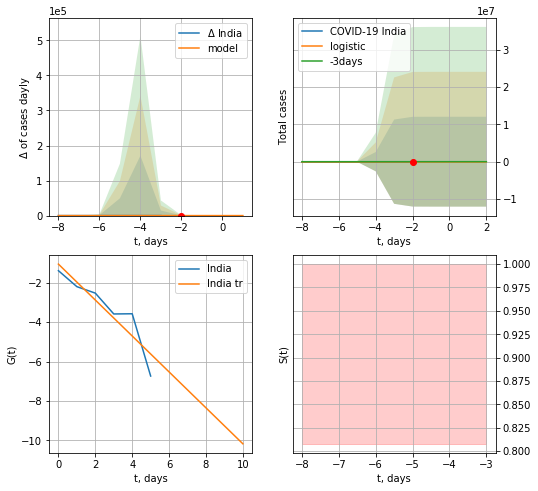

India data at: 2020-04-28
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


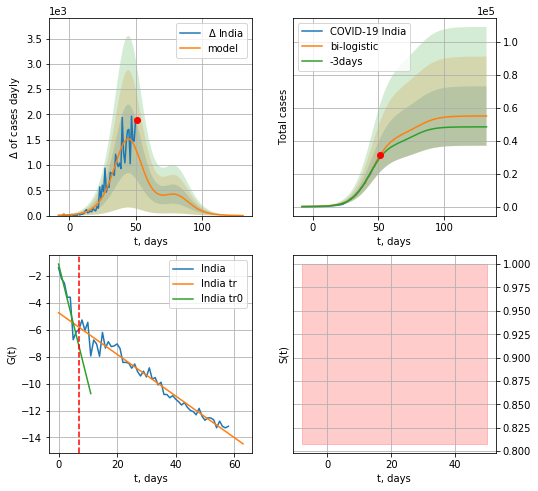

India data at: 2020-04-28
+3 day model MAPE: 0.05086971313439044
model: bi-logistic
coeffs:  [4.39259051e+04 1.37429567e-01 4.49371880e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.32771554266199526
forecast at the end of period: +81 days
	 deltaDaycases:  1
	 total cases:  54926 ± 18000
	 total death:  1767 ± 1737
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.965020
 intercept: -4.727479
 slope: -0.154651


In [396]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,5*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


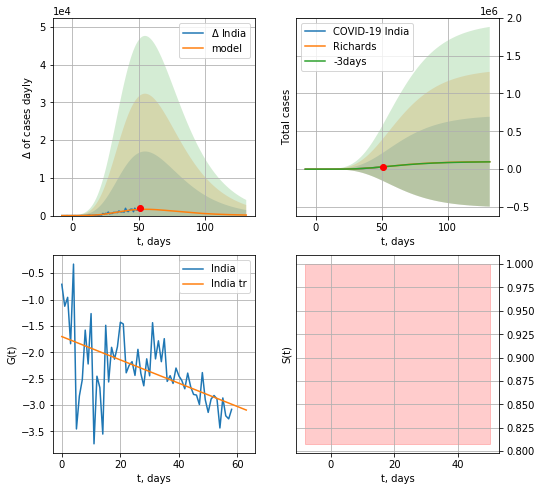

India data at: 2020-04-28
+3 day model MAPE: 0.003201918537637244
model: Richards
coeffs:  [ 1.02521475e+05  1.71731606e+00 -2.59751163e+01  2.61366074e-02]
rational stdev:  5.967924671446592
forecast at the end of period: +81 days
	 deltaDaycases:  145
	 total cases:  99307 ± 592659
	 total death:  3194 ± 57184
trend coefficient of determination: 0.293552
 intercept: -1.703030
 slope: -0.022118


In [397]:
x = forecastRR("India",dfID[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


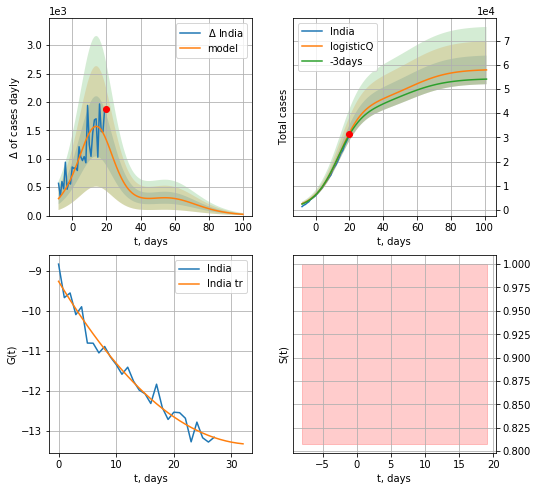

India data at: 2020-04-28
+3 day model MAPE: 0.028219
model: logisticQ
coeffs: [ 4.30207383e+04  4.86339839e-04  1.36700253e+01 -2.77369964e+02]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.102289
forecast at the end of period: +81 days
	 deltaDaycases: 22
	 total cases: 57868 ± 5919
	 total death: 1861 ± 571
trend coefficient of determination: 0.968197
 intercept_: -9.255991164026568
 coeffs_: [ 0.         -0.24096319  0.00355208]


In [398]:
x = forecastRRR("India",dfID[31:],d1,16*7-dT,addpred=True,xcoef=[.35,.5,4.0,1])

AG
          date   cases  active  death
51 2020-04-24  3607.0  2455.0  176.0
52 2020-04-25  3780.0  2565.0  185.0
53 2020-04-26  3892.0  2593.0  192.0
54 2020-04-27  4003.0  2666.0  197.0
55 2020-04-28  4127.0  2758.0  207.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


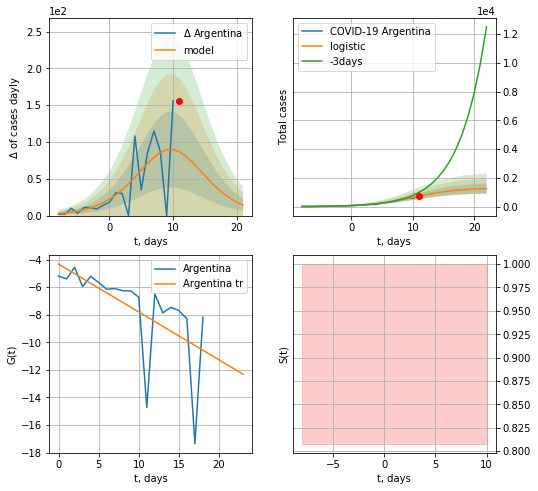

Argentina data at: 2020-04-28
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +11 days
	 deltaDaycases:  14
	 total cases:  1258 ± 349
	 total death:  63 ± 52
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


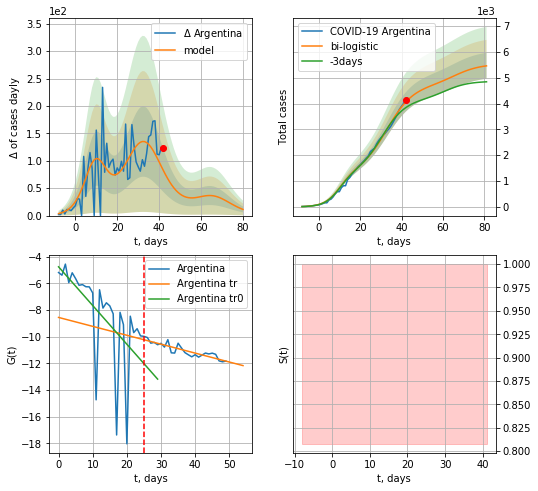

Argentina data at: 2020-04-28
+3 day model MAPE: 0.06311748900213834
model: bi-logistic
coeffs:  [3.37808258e+03 1.58653794e-01 3.29474472e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.09206081574085133
forecast at the end of period: +39 days
	 deltaDaycases:  11
	 total cases:  5456 ± 502
	 total death:  273 ± 75
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.791051
 intercept: -8.558446
 slope: -0.066803


In [399]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


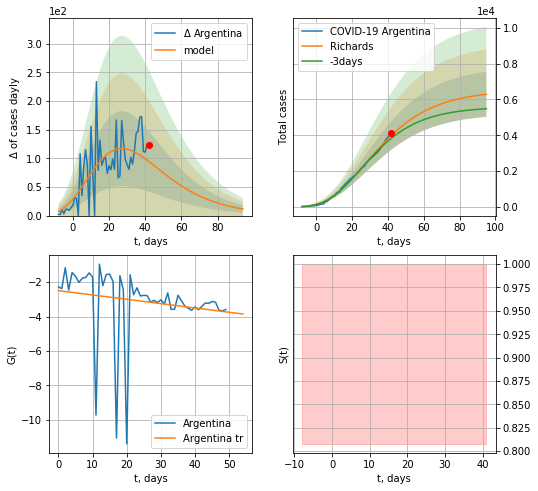

Argentina data at: 2020-04-28
+3 day model MAPE: 0.04369014501199361
model: Richards
coeffs:  [ 6.52101087e+03  4.65933605e+00 -6.52270391e+01  1.05355360e-02]
rational stdev:  0.19952933810272486
forecast at the end of period: +53 days
	 deltaDaycases:  11
	 total cases:  6287 ± 1254
	 total death:  315 ± 188
trend coefficient of determination: 0.030446
 intercept: -2.499398
 slope: -0.025084


In [400]:
x = forecastRR('Argentina',dfAG[5:],d1,12*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


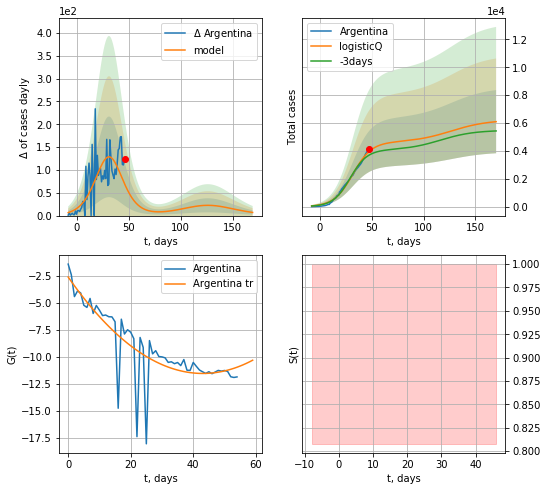

Argentina data at: 2020-04-28
+3 day model MAPE: 0.072671
model: logisticQ
coeffs: [ 4.61497270e+03  1.83448218e-06  3.16130952e+01 -6.05963636e+04]
scenario coeffs: [0.35, 0.5, 4.0, 1]
rational stdev: 0.371884
forecast at the end of period: +123 days
	 deltaDaycases: 6
	 total cases: 6099 ± 2268
	 total death: 305 ± 340
trend coefficient of determination: 0.658815
 intercept_: -2.5838253265766733
 coeffs_: [ 0.         -0.41456414  0.00481388]


In [401]:
x = forecastRRR('Argentina',dfAG[:],d1,22*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


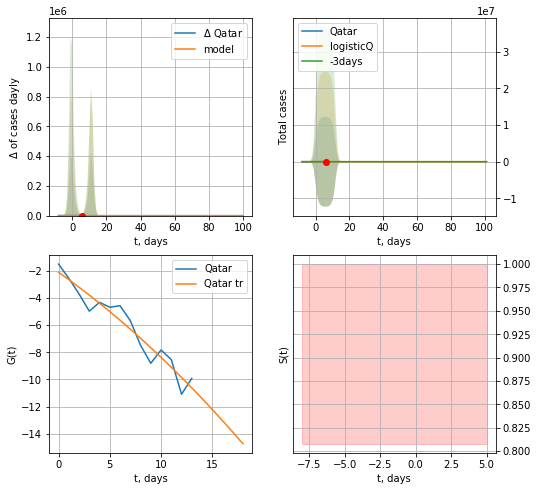

Qatar data at: 2020-04-28
+3 day model MAPE: 10.389766
model: logisticQ
coeffs: [ 4.40923501e+02 -1.12413074e-01  1.14811089e+01  1.00067900e-01]
rational stdev: 28560.888310
forecast at the end of period: +95 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.925886
 intercept_: -2.1066548119132458
 coeffs_: [ 0.         -0.53152809 -0.00944941]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:259: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


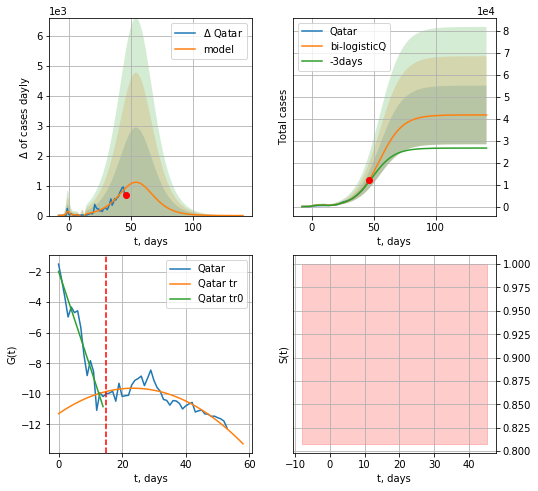

Qatar data at: 2020-04-28
+3 day model MAPE: 0.07144379278339824
model: bi-logisticQ
coeffs:  [ 4.16754010e+04  1.38770436e-05  5.45461368e+01 -7.65997559e+03] [ 4.40923501e+02 -1.12413074e-01  1.14811089e+01  1.00067900e-01]
rational stdev:  0.32003520537954505
forecast at the end of period: +95 days
	 deltaDaycases:  0
	 total cases:  41671 ± 13336
	 total death:  34 ± 32
bi-logistic approximation splitting point: 15
trend coefficient of determination: 0.929567
 intercept_: -1.9786509648817043
 coeffs_: [ 0.         -0.62175364 -0.00080828]
trend coefficient of determination: 0.765348
 intercept_: -11.30537582480243
 coeffs_: [ 0.          0.14251906 -0.00304418]


In [404]:
vL=15
x = forecastRRR('Qatar',dfQR[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:],d1,18*7-dT,x,1.0,addpred=False,xcoef=[.35,.5,4.0,1],vL=vL)

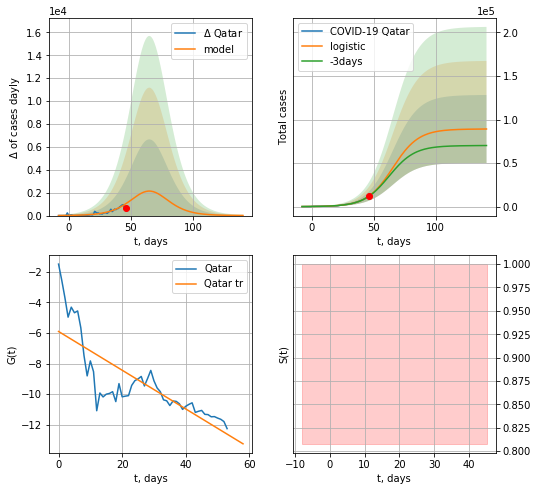

Qatar data at: 2020-04-28
+3 day model MAPE: 0.016794492546135357
model: logistic
coeffs:  [8.90683470e+04 9.62005603e-02 6.52834765e+01]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.43854470969041154
forecast at the end of period: +95 days
	 deltaDaycases:  10
	 total cases:  89103 ± 39075
	 total death:  74 ± 97
trend coefficient of determination: 0.644462
 intercept: -5.905470
 slope: -0.126555


In [405]:
x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

In [406]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [20]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457]


In [21]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"879,970",North America,\nNorth America\n,,"+1,515",148,"16,562",,"1,120,629","64,412","176,247",,
1,"733,553",Europe,\nEurope\n,,116,12,"24,627",,"1,322,822","126,434","462,835",,
2,"230,933",Asia,\nAsia\n,,358,17,"5,832",,"495,132","17,927","246,272",,
3,"93,708",South America,\nSouth America\n,,389,22,"9,775",,"155,592","7,590","54,294",,
4,"1,274",Australia/Oceania,\nOceania\n,,2,,45,,"8,314",107,"6,933",,
5,"22,400",Africa,\nAfrica\n,,121,1,120,,"35,799","1,528","11,871",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"1,961,899",All,World,28.0,"+2,501",200,"56,965",,"3,139,009","218,013","959,097",,403
8,"834,261",North America,USA,179,,,"15,298","17,885","1,035,765","59,266","142,238","5,919,847","3,129"
9,"84,403",Europe,Spain,510,,,"7,764","28,779","232,128","23,822","123,903","1,345,560","4,965"


In [22]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"879,970",North America,\nNorth America\n,,"+1,515",148,"16,562",,"1,120,629","64,412","176,247",,
1,"733,553",Europe,\nEurope\n,,116,12,"24,627",,"1,322,822","126,434","462,835",,
2,"230,933",Asia,\nAsia\n,,358,17,"5,832",,"495,132","17,927","246,272",,
3,"93,708",South America,\nSouth America\n,,389,22,"9,775",,"155,592","7,590","54,294",,
4,"1,274",Australia/Oceania,\nOceania\n,,2,,45,,"8,314",107,"6,933",,


In [23]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
88,764,Europe,Lithuania,16,,,17,"41,072","1,344",44,536,"111,809",494
318,764,Europe,Lithuania,16,,3,17,"41,072","1,344",44,536,"111,809",494


In [24]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

228


In [28]:
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"879,970",North America,\nNorth America\n,,"+1,515",148,"16,562",,"1,120,629","64,412","176,247",,
1,"733,553",Europe,\nEurope\n,,116,12,"24,627",,"1,322,822","126,434","462,835",,
2,"230,933",Asia,\nAsia\n,,358,17,"5,832",,"495,132","17,927","246,272",,
3,"93,708",South America,\nSouth America\n,,389,22,"9,775",,"155,592","7,590","54,294",,
4,"1,274",Australia/Oceania,\nOceania\n,,2,,45,,"8,314",107,"6,933",,
5,"22,400",Africa,\nAfrica\n,,121,1,120,,"35,799","1,528","11,871",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"1,961,899",All,World,28.0,"+2,501",200,"56,965",,"3,139,009","218,013","959,097",,403
8,"834,261",North America,USA,179,,,"15,298","17,885","1,035,765","59,266","142,238","5,919,847","3,129"
9,"84,403",Europe,Spain,510,,,"7,764","28,779","232,128","23,822","123,903","1,345,560","4,965"


In [27]:
df.at[12, 'TotalRecovered'] = 0
df.at[20, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"879,970",North America,\nNorth America\n,,"+1,515",148,"16,562",,"1,120,629","64,412","176,247",,
1,"733,553",Europe,\nEurope\n,,116,12,"24,627",,"1,322,822","126,434","462,835",,
2,"230,933",Asia,\nAsia\n,,358,17,"5,832",,"495,132","17,927","246,272",,
3,"93,708",South America,\nSouth America\n,,389,22,"9,775",,"155,592","7,590","54,294",,
4,"1,274",Australia/Oceania,\nOceania\n,,2,,45,,"8,314",107,"6,933",,
5,"22,400",Africa,\nAfrica\n,,121,1,120,,"35,799","1,528","11,871",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"1,961,899",All,World,28.0,"+2,501",200,"56,965",,"3,139,009","218,013","959,097",,403
8,"834,261",North America,USA,179,,,"15,298","17,885","1,035,765","59,266","142,238","5,919,847","3,129"
9,"84,403",Europe,Spain,510,,,"7,764","28,779","232,128","23,822","123,903","1,345,560","4,965"


In [29]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,\nNorth America\n,NaN,1515.0,148.0,16562.0,NaN,1120629,64412.0,176247.0,NaN,NaN
1,733553,Europe,\nEurope\n,NaN,116.0,12.0,24627.0,NaN,1322822,126434.0,462835.0,NaN,NaN
2,230933,Asia,\nAsia\n,NaN,358.0,17.0,5832.0,NaN,495132,17927.0,246272.0,NaN,NaN
3,93708,South America,\nSouth America\n,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
4,1274,Australia/Oceania,\nOceania\n,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN
5,22400,Africa,\nAfrica\n,NaN,121.0,1.0,120.0,NaN,35799,1528.0,11871.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,1961899,All,World,28.0,2501.0,200.0,56965.0,NaN,3139009,218013.0,959097.0,NaN,403.0
8,834261,North America,USA,179.0,NaN,NaN,15298.0,17885.0,1035765,59266.0,142238.0,5919847.0,3129.0
9,84403,Europe,Spain,510.0,NaN,NaN,7764.0,28779.0,232128,23822.0,123903.0,1345560.0,4965.0


In [30]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
223,93708,South America,Total:,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
224,1274,Australia/Oceania,Total:,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN
225,22400,Africa,Total:,NaN,121.0,1.0,120.0,NaN,35799,1528.0,11871.0,NaN,NaN
226,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
227,467363,Europe,European Union,227.029496,116.0,12.0,19976.0,19478.362691,989757,101085.0,421059.0,8672751.0,2222.921634


In [31]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,North America,NaN,1515.0,148.0,16562.0,NaN,1120629,64412.0,176247.0,NaN,NaN
1,733553,Europe,Europe,NaN,116.0,12.0,24627.0,NaN,1322822,126434.0,462835.0,NaN,NaN
2,230933,Asia,Asia,NaN,358.0,17.0,5832.0,NaN,495132,17927.0,246272.0,NaN,NaN
3,93708,South America,South America,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
4,1274,Australia/Oceania,Oceania,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN


In [32]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [33]:
#df

In [34]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,879970,North America,North America,NaN,1515.0,148.0,16562.0,NaN,1120629,64412.0,176247.0,NaN,NaN
1,733553,Europe,Europe,NaN,116.0,12.0,24627.0,NaN,1322822,126434.0,462835.0,NaN,NaN
2,230933,Asia,Asia,NaN,358.0,17.0,5832.0,NaN,495132,17927.0,246272.0,NaN,NaN
3,93708,South America,South America,NaN,389.0,22.0,9775.0,NaN,155592,7590.0,54294.0,NaN,NaN
4,1274,Australia/Oceania,Oceania,NaN,2.0,NaN,45.0,NaN,8314,107.0,6933.0,NaN,NaN
5,22400,Africa,Africa,NaN,121.0,1.0,120.0,NaN,35799,1528.0,11871.0,NaN,NaN
7,1961899,All,World,28.0,2501.0,200.0,56965.0,NaN,3139009,218013.0,959097.0,NaN,403.0
8,834261,North America,USA,179.0,NaN,NaN,15298.0,17885.0,1035765,59266.0,142238.0,5919847.0,3129.0
9,84403,Europe,Spain,510.0,NaN,NaN,7764.0,28779.0,232128,23822.0,123903.0,1345560.0,4965.0
10,105205,Europe,Italy,453.0,NaN,NaN,1863.0,30547.0,201505,27359.0,68941.0,1846934.0,3333.0


In [35]:
df.to_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [36]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Lithuania LT
Malta MT
Norway NG
Qatar QR
Spain SP
Belgium BG
Australia AS
World World
Thailand TH
Finland FI
Germany GR
Brazil BZ
Sweden SW
China CN
Ukraine Ukr
Israel IS
Egypt EG
Estonia ES
Turkey TR
Cyprus CP
Latvia LV
Slovakia SL
Ireland IR
India ID
Luxembourg LX
Switzerland SZ
Chile CL
Russia RS
Czechia CH
Bulgaria BL
New Zealand ZL
European Union EU
Peru PU
Romania RM
Slovenia SV
Croatia CT
Japan JP
France FR
S. Korea KR
Canada CA
Austria AT
Greece GC
Italy IT
Ecuador ED
Morocco MR
Hungary HG
Portugal PT
Poland PL
Iceland IC
Argentina AG
Philippines PH
Pakistan PK
Serbia SB
Belarus BR
Denmark DK
Colombia CB
USA US
Algeria AR
UK GB
Singapore SG
Indonesia IE
Netherlands NL
Mexico MX
Iran IN
Malaysia ML
Iraq IQ
Panama PM


In [37]:
df = pd.read_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-04-28,1120629,879970,64412.0
Europe
Europe 2020-04-28,1322822,733553,126434.0
Asia
Asia 2020-04-28,495132,230933,17927.0
South America
South America 2020-04-28,155592,93708,7590.0
Oceania
Oceania 2020-04-28,8314,1274,107.0
Africa
Africa 2020-04-28,35799,22400,1528.0
World
World 2020-04-28,3139009,1961899,218013.0
USA
USA 2020-04-28,1035765,834261,59266.0
Spain
Spain 2020-04-28,232128,84403,23822.0
Italy
Italy 2020-04-28,201505,105205,27359.0
France
France 2020-04-28,165911,95365,23660.0
UK
UK 2020-04-28,161145,139123,21678.0
Germany
Germany 2020-04-28,159912,33198,6314.0
Turkey
Turkey 2020-04-28,114653,72852,2992.0
Russia
Russia 2020-04-28,93558,84235,867.0
Iran
Iran 2020-04-28,92584,14268,5877.0
Brazil
Brazil 2020-04-28,73235,35608,5083.0
Canada
Canada 2020-04-28,50026,27977,2859.0
Belgium
Belgium 2020-04-28,47334,29060,7331.0
Netherlands
Netherlands 2020-04-28,38416,33600,4566.0
India
India 2020-04-28,31332,22577,1008.0
Peru
Peru 2020-04-28,31190,2115

Sao Tome and Principe
Sao Tome and Principe 2020-04-28,8,4,nan
Mauritania
Mauritania 2020-04-28,7,0,1.0
Bhutan
Bhutan 2020-04-28,7,2,nan
British Virgin Islands
British Virgin Islands 2020-04-28,6,2,1.0
St. Barth
St. Barth 2020-04-28,6,0,nan
Western Sahara
Western Sahara 2020-04-28,6,1,nan
Caribbean Netherlands
Caribbean Netherlands 2020-04-28,5,5,nan
Anguilla
Anguilla 2020-04-28,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-04-28,1,1,nan
Yemen
Yemen 2020-04-28,1,0,nan
China
China 2020-04-28,82858,647,4633.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
Total:
Total: 2020-04-28,1120629,879970,64412.0
European Union
European Union 2020-04-28,989757,467363,101085.0


In [38]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [39]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("corona%sOneRaw.csv"%(c),'r')
    fff = open("/home/algiz/Desktop/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append /home/algiz/Desktop/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append /home/algiz/Desktop/coronaLT.csv 2020-04-28,1344,764,44.0

append /home/algiz/Desktop/coronaMT.csv 2020-04-28,458,151,4.0

append /home/algiz/Desktop/coronaNG.csv 2020-04-28,7660,7422,206.0

append /home/algiz/Desktop/coronaQR.csv 2020-04-28,11921,10777,10.0

append /home/algiz/Desktop/coronaSP.csv 2020-04-28,232128,84403,23822.0

append /home/algiz/Desktop/coronaBG.csv 2020-04-28,47334,29060,7331.0

append /home/algiz/Desktop/coronaAS.csv 2020-04-28,6738,1024,88.0

append /home/algiz/Desktop/coronaWorld.csv 2020-04-28,3139009,1961899,218013.0

append /home/algiz/Desktop/coronaTH.csv 2020-04-28,2947,228,54.0

append /home/algiz/Desktop/coronaFI.csv 2020-04-28,4740,1741,199.0

append /home/algiz/Desktop/coronaGR.csv 2020-04-28,159912,33198,6314.0

append /home/algiz/Desktop/coronaBZ.csv 2020-04-28,73235,35608,5083.0

append /home/algiz/Desktop/coronaSW.csv 2020-04-28,19621,16261,2355.0

append /home/algiz/Desktop/coronaCN.csv 2020-04-28,82858,647,4633.0

append /home/algiz/Deskto

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [323]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

13905339.0 1787.8701656037852


In [309]:
TT/7.7776e3

2344.341827813207

In [335]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [502]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445

19489.32808988764

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [469]:
#dfAll

In [503]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/7.777e3

3892.938150957953